In [1]:
%pylab inline

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from sklearn.metrics.cluster import mutual_info_score
from sklearn.cluster import KMeans
from scipy.stats import entropy
import copy
import math
import os
import numpy as np
import matplotlib.pyplot as plt


## Model

In [4]:
class TransformerModel(nn.Module):
    def __init__(self, ntokens, emsize, nhead, d_hid, nlayers, dropout=0.5):
        super(TransformerModel, self).__init__()
        self.model_type = 'Transformer'
        self.src_mask = None
        self.pos_encoder = PositionalEncoding(emsize, dropout)
        encoder_layers = nn.TransformerEncoderLayer(emsize, nhead, d_hid, dropout)
        self.transformer_encoder = nn.TransformerEncoder(encoder_layers, nlayers)
        self.encoder = nn.Embedding(ntokens, emsize)
        self.emsize = emsize
        self.decoder = nn.Linear(emsize, ntokens)
        self.ntokens=ntokens
        self.init_weights()

    def _generate_square_subsequent_mask(self, sz):
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask

    def init_weights(self):
        initrange = 0.1
        self.encoder.weight.data.uniform_(-initrange, initrange)
        self.decoder.bias.data.zero_()
        self.decoder.weight.data.uniform_(-initrange, initrange)

    def forward(self, src,verbose=False):
        if self.src_mask is None or self.src_mask.size(0) != len(src):
            device = src.device
            mask = self._generate_square_subsequent_mask(len(src)).to(device)
            self.src_mask = mask

        src = self.encoder(src) * math.sqrt(self.emsize)
        src = self.pos_encoder(src)
        output = self.transformer_encoder(src, self.src_mask)
        self.store=output.detach().numpy().copy()
        if verbose:
            print(output.shape)
        output = self.decoder(output)
        return output

class PositionalEncoding(nn.Module):
    def __init__(self, d_model, dropout=0.1, max_len=5000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)

        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * -(math.log(10000.0) / d_model))
        pe = torch.zeros(max_len, 1, d_model)
        pe[:, 0, 0::2] = torch.sin(position * div_term)
        pe[:, 0, 1::2] = torch.cos(position * div_term)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + self.pe[:x.size(0)]
        return self.dropout(x)

# Parameters
ntokens = 8  # size of vocabulary
emsize = 20  # embedding dimension
nhead = 4  # number of heads in the nn.MultiheadAttention
d_hid = 20  # dimension of the feedforward network model in nn.TransformerEncoder
nlayers = 2  # number of nn.TransformerEncoderLayer
dropout = 0.03  # dropout probability

# Initialize the model
model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
print(model)

TransformerModel(
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.03, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-1): 2 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=20, out_features=20, bias=True)
        )
        (linear1): Linear(in_features=20, out_features=20, bias=True)
        (dropout): Dropout(p=0.03, inplace=False)
        (linear2): Linear(in_features=20, out_features=20, bias=True)
        (norm1): LayerNorm((20,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((20,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.03, inplace=False)
        (dropout2): Dropout(p=0.03, inplace=False)
      )
    )
  )
  (encoder): Embedding(8, 20)
  (decoder): Linear(in_features=20, out_features=8, bias=True)
)


## Test function

In [5]:
def test(model, source, target):
    model.eval()  # Set the model to evaluation mode
    correct = 0
    total = 0
    
    source = torch.tensor(source, dtype=torch.long)
    target = torch.tensor(target, dtype=torch.long)

    with torch.no_grad():  # No need to track gradients
        src = source.transpose(0, 1)  # Adjust for the expected input dimensions [sequence_length, batch_size]
        tgt = target.transpose(0, 1)  # Same adjustment for the target
        
        output = model(src)  # Compute the output
        
        # The output is [sequence_length, batch_size, ntokens]. Get the most likely token predictions
        predictions = output.argmax(dim=2)  # Get the index of the max log-probability
        print('prediction shape', predictions.shape)
        correct += (predictions == tgt).sum().item()  # Count how many predictions match the target
        total += tgt.numel()  # Total number of predictions
        
    accuracy = correct / total  # Calculate the accuracy
    return accuracy

## Dataset preparation

In [202]:

def getTrainingData(songStrings, nrOfSongs):
    notes = list("ABCDEFGHIJ")
    chord = [[0], [1], [2], [3], [4], [5], [6], [7],[8],[9]]
    source = []
    target = []
    for s in range(nrOfSongs):
        for i in range(42):
            sentence = []
            answer = []
            for j in range(4):
                sentence.append(chord[notes.index(songStrings[s][(i+j)%42])][0])
                answer.append(chord[notes.index(songStrings[s][(i+j+1)%42])][0])
            source.append(sentence)
            target.append(answer)
    return np.array(source), np.array(target)

def split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction):
    total_rows = source.shape[0] // 2
    first_set_rows = int(total_rows * fraction)
    second_set_rows = total_rows - first_set_rows

    first_set_indices = np.random.choice(range(total_rows), first_set_rows, replace=False)
    second_set_indices = np.random.choice(range(total_rows, 2 * total_rows), second_set_rows, replace=False)

    combined_indices = np.concatenate((first_set_indices, second_set_indices))
    np.random.shuffle(combined_indices)

    input_list = source[combined_indices]
    output_list = target[combined_indices]

    return input_list, output_list


In [6]:
# Data generation and preparation
songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
    #"AHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFED"
])

source_mixed, target_mixed = getTrainingData(songStrings, 2)
fraction = 0.5
input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source_mixed, target_mixed, fraction)

print(input_list.shape, output_list.shape)

(42, 4) (42, 4)


## Decision Tree

In [250]:
from sklearn.tree import DecisionTreeClassifier
import itertools
import numpy as np

songs = [
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB", # normal
    "JIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJI", # reverse
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC", # daisybells
    "ABCDEFGHIEABCDEFGHIEABCDEFGHIEABCDEFGHIEAB", # 10th note E
    "ABCDAFGHIJBCDEAGHIAFCDEFIHIABADEFGCIABCBEF", # 5th note different random
    "ABCDAFGHIAABCDAFGHIAABCDAFGHIAABCDAFGHIAAB" # 5th note different
]

def generate_features_from_song(song):
    ins = []
    outs = []
    DB = list(song)
    for i in range(42):
        I = [ord(DB[(i + j) % len(DB)]) for j in range(4)]
        outs.append(ord(DB[(i + 4) % len(DB)]))
        ins.append(I)
    return ins, outs

def train_and_test_classifier(train_song, test_song, train_fraction, n_iterations):
    inputs_train, outputs_train = generate_features_from_song(train_song)
    inputs_test, outputs_test = generate_features_from_song(test_song)
    
    accuracies = []
    for _ in range(n_iterations):
        train_size = int(train_fraction * len(inputs_train))
        test_size = len(inputs_train) - train_size

        all_train_indices = np.random.permutation(len(inputs_train))
        train_indices = all_train_indices[:train_size]
        test_indices = np.random.choice(len(inputs_test), size=test_size, replace=False)

        combined_inputs_train = [inputs_train[i] for i in train_indices] + [inputs_test[i] for i in test_indices]
        combined_outputs_train = [outputs_train[i] for i in train_indices] + [outputs_test[i] for i in test_indices]

        dtc = DecisionTreeClassifier(random_state=40)
        dtc.fit(combined_inputs_train, combined_outputs_train)
        test_accuracy = dtc.score(inputs_test, outputs_test)
        accuracies.append(test_accuracy)

    return accuracies

# Store results in a dictionary
results = {}
n_iterations = 200  # Number of times to repeat training/testing for averaging
fractions = np.arange(0, 101, 10) / 100  # Generate fractions from 1.0 (100%) to 0.0 (0%) in steps of 0.1 (10%)

for fraction in fractions:
    for train_idx, test_idx in itertools.product(range(len(songs)), repeat=2):
        train_song = songs[train_idx]
        test_song = songs[test_idx]
        accuracies = train_and_test_classifier(train_song, test_song, fraction, n_iterations)
        results[(train_idx+1, test_idx+1, fraction)] = accuracies

# Display results
for key, value in results.items():
    train_percent = int(key[2] * 100)
    test_percent = 100 - train_percent
    avg_accuracy = np.mean(value)
    print(f"Training {train_percent}% on Song {key[0]} and {test_percent}% on Song {key[1]}: Average Accuracy over {n_iterations} runs = {avg_accuracy:.2f}")


Training 0% on Song 1 and 100% on Song 1: Average Accuracy over 200 runs = 0.98
Training 0% on Song 1 and 100% on Song 2: Average Accuracy over 200 runs = 0.98
Training 0% on Song 1 and 100% on Song 3: Average Accuracy over 200 runs = 0.93
Training 0% on Song 1 and 100% on Song 4: Average Accuracy over 200 runs = 0.98
Training 0% on Song 1 and 100% on Song 5: Average Accuracy over 200 runs = 1.00
Training 0% on Song 1 and 100% on Song 6: Average Accuracy over 200 runs = 0.98
Training 0% on Song 2 and 100% on Song 1: Average Accuracy over 200 runs = 0.98
Training 0% on Song 2 and 100% on Song 2: Average Accuracy over 200 runs = 0.98
Training 0% on Song 2 and 100% on Song 3: Average Accuracy over 200 runs = 0.93
Training 0% on Song 2 and 100% on Song 4: Average Accuracy over 200 runs = 0.98
Training 0% on Song 2 and 100% on Song 5: Average Accuracy over 200 runs = 1.00
Training 0% on Song 2 and 100% on Song 6: Average Accuracy over 200 runs = 0.98
Training 0% on Song 3 and 100% on Song 1

In [22]:
results

{(1, 1, 0.0): [0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762],
 (1, 2, 0.0): [0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9761904761904762,
  0.9

### Plots

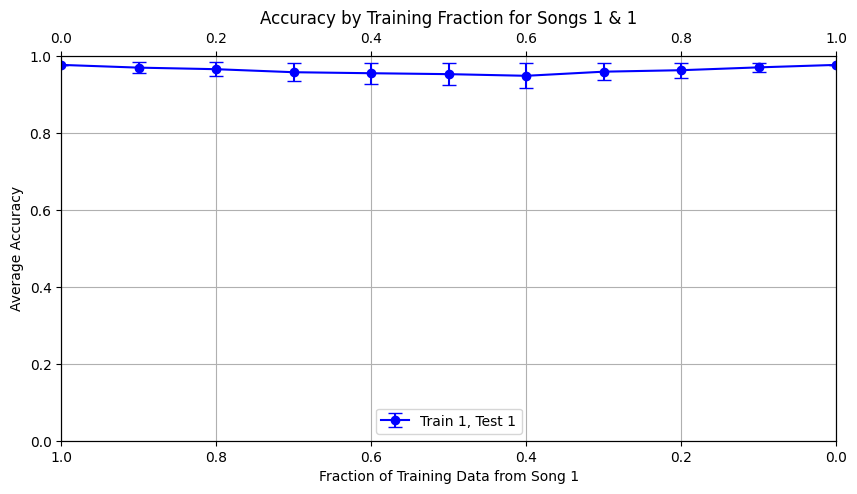

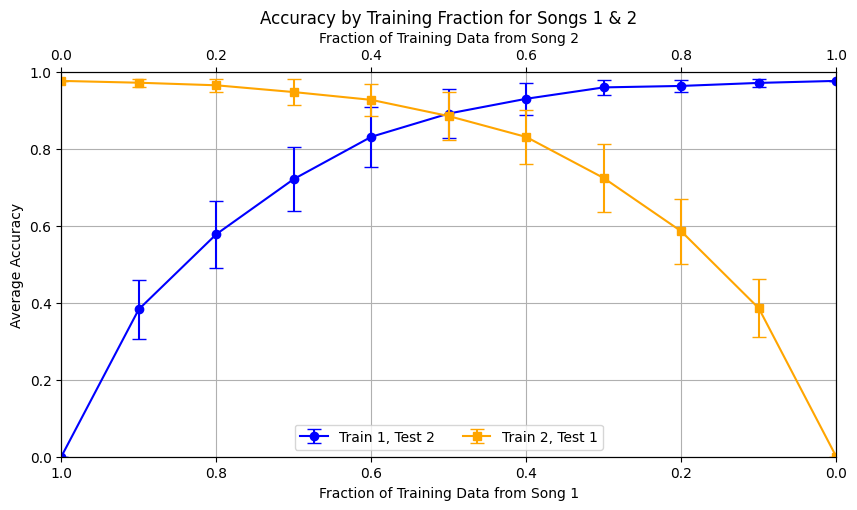

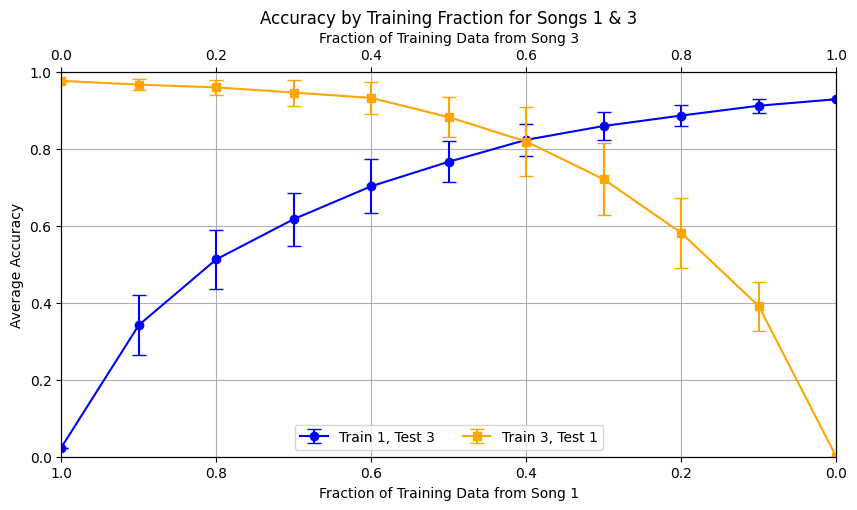

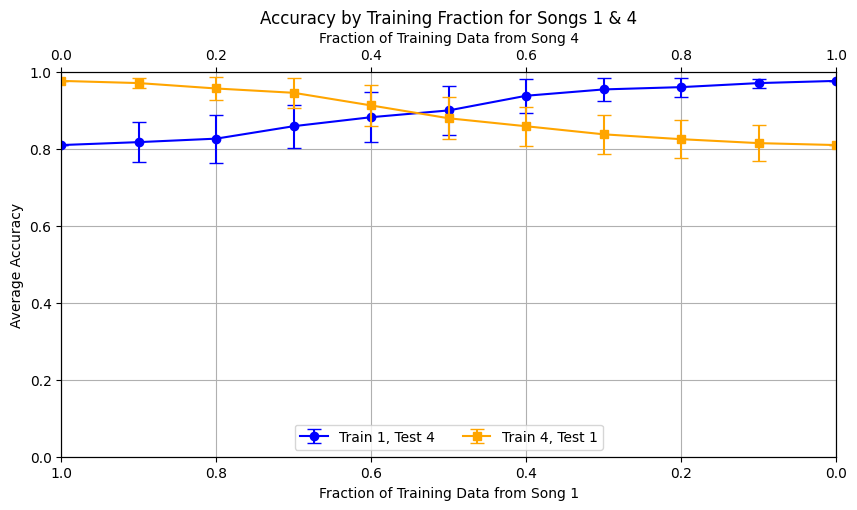

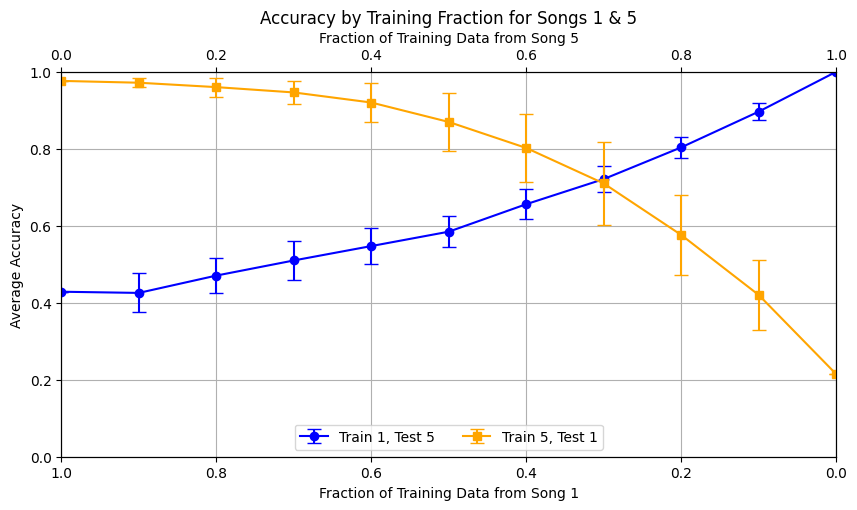

...

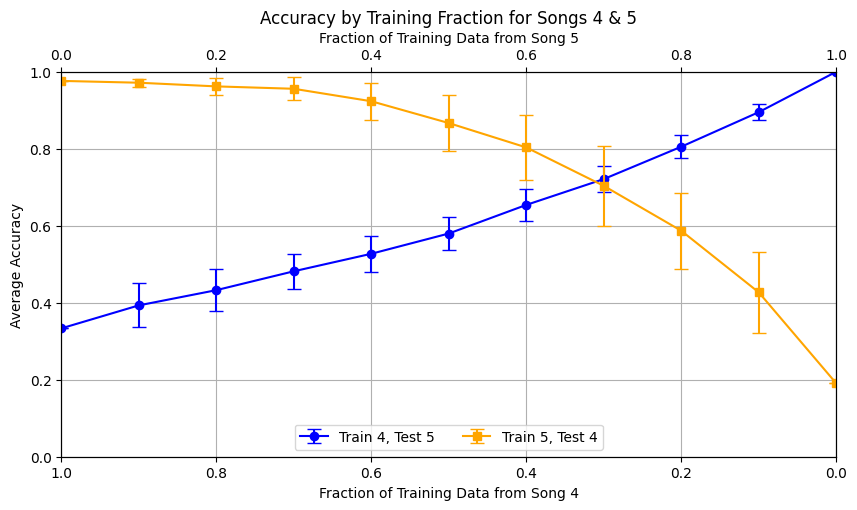

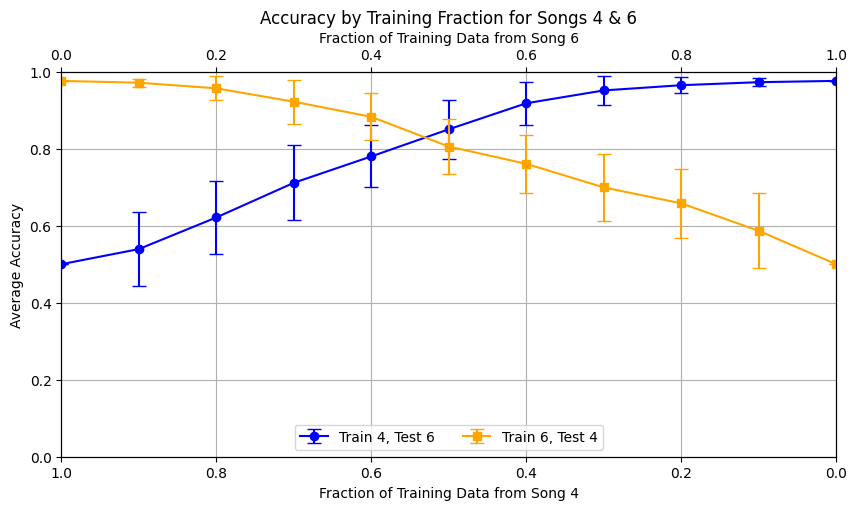

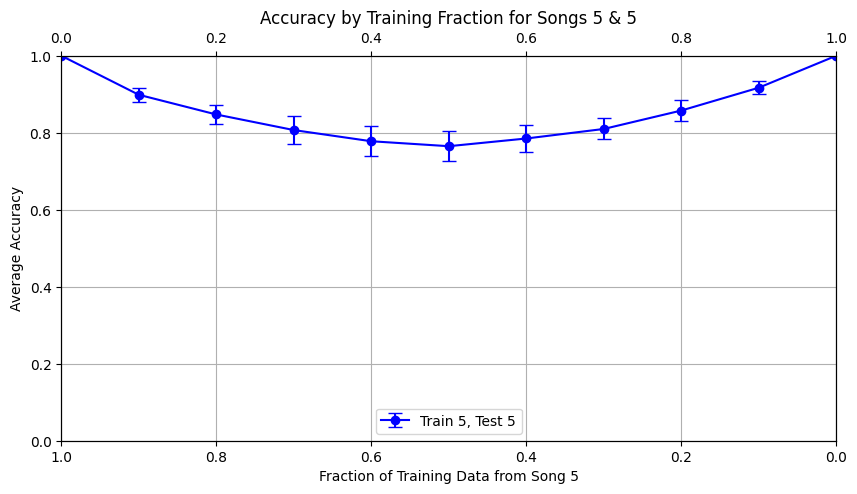

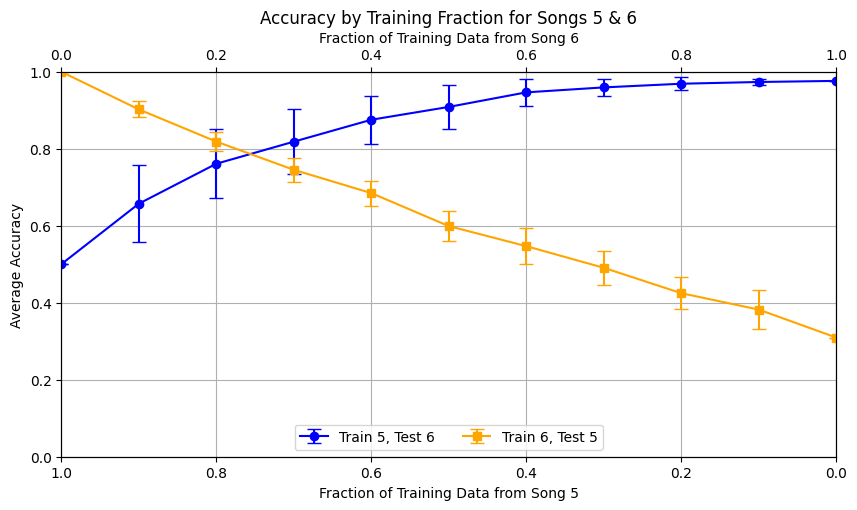

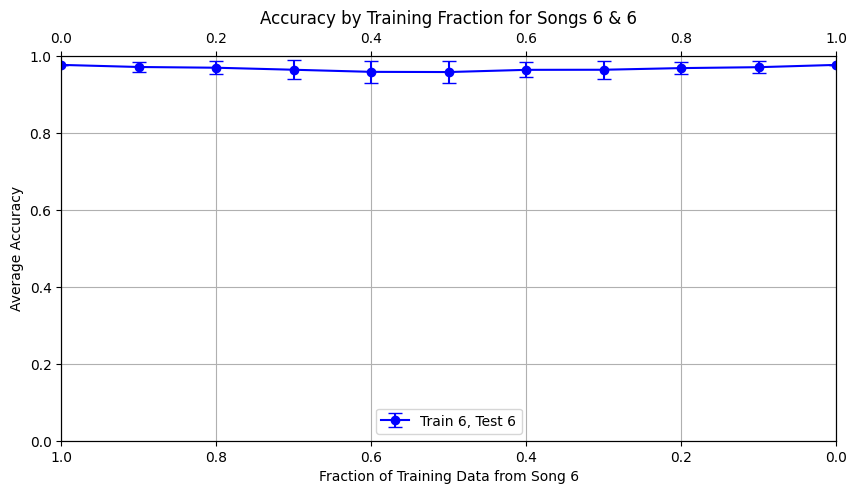

In [212]:
import matplotlib.pyplot as plt
import numpy as np

# Organizing data for plotting by unordered pairs
plot_data = {}
for (train_idx, test_idx, fraction), accuracies in results.items():
    pair_label = tuple(sorted([train_idx, test_idx]))  # Create an unordered pair
    if pair_label not in plot_data:
        plot_data[pair_label] = {}
    order_label = f"Train {train_idx}, Test {test_idx}"
    if order_label not in plot_data[pair_label]:
        plot_data[pair_label][order_label] = ([], [], [])  # Store fractions, means, and std deviations
    mean_accuracy = np.mean(accuracies)
    std_deviation = np.std(accuracies)
    plot_data[pair_label][order_label][0].append(fraction)
    plot_data[pair_label][order_label][1].append(mean_accuracy)
    plot_data[pair_label][order_label][2].append(std_deviation)

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    fig, ax1 = plt.subplots(figsize=(10, 5))

    # Set the y-axis limit to [0, 1] for all plots
    ax1.set_ylim([0, 1])

    # Initialize the secondary axis
    ax2 = ax1.twiny()

    # Sort data by fraction and plot for each training order within the pair
    for order_label, (fractions, means, std_devs) in data.items():
        sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
        fractions, means, std_devs = zip(*sorted_data)

        # Plot with error bars
        if "Train " + str(pair[0]) in order_label:
            ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
            ax1.set_ylabel('Average Accuracy')
            ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
        else:
            ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
            ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
            ax2.set_xlim([0, 1])  # Regular order for the second song

    ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
    lines, labels = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
    ax1.grid(True)
    plt.show()


### Songpair Dictionaries

In [213]:
from collections import defaultdict

# Create a dictionary to hold a dictionary for each song pair
song_pair_dictionaries = defaultdict(dict)

# Populate the song pair dictionaries
for (train_idx, test_idx, fraction), accuracy in results.items():
    key = (train_idx, test_idx)
    if fraction not in song_pair_dictionaries[key]:
        song_pair_dictionaries[key][fraction] = []
    song_pair_dictionaries[key][fraction].append(accuracy)

# Now you have a dictionary of dictionaries, where each key is a song pair (train_idx, test_idx)
# and the value is another dictionary with fractions as keys and accuracies as values

# Example of accessing the data for song pair (1, 2)
song1_song2_results = song_pair_dictionaries[(1, 2)]
#print("Results for Song 1 training and Song 2 testing:", song1_song2_results)


# Now you can directly access results for song 1 training and song 2 testing like:
# print(song_1_2_results)


In [25]:
song_pair_dictionaries[(1, 2)]

{0.0: [[0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762]],
 0.1: [[0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9761904761904762,
   0.9523809523809523,
   0.9761904761904762,
   0.9523809523809523,
   0.9761904761904762,
   0.9523809523809523,
   0.9761904761904762,
   0.9761904761904762,

## Overlap and Contradiction

### Normal and 5th Note Random - 0.58(overlap and contradiction)

#### Training

Model 0, Fraction 0.00, Epoch 1, Loss: 2.2226
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.6332
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.1507
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.8149
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.6226
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.5047
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4524
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.4304
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.4192
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.4127
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.4088
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.4054
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.4073
prediction sha

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Model 0, Fraction 0.10, Epoch 1, Loss: 2.2085
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 101, Loss: 1.6005
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 201, Loss: 1.1449
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 301, Loss: 0.8709
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 401, Loss: 0.6949
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 501, Loss: 0.6071
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 601, Loss: 0.5960
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 701, Loss: 0.5303
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 801, Loss: 0.5073
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 901, Loss: 0.4924
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1001, Loss: 0.4722
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.10, Epoch 1101, Loss: 0.4841
prediction shape 

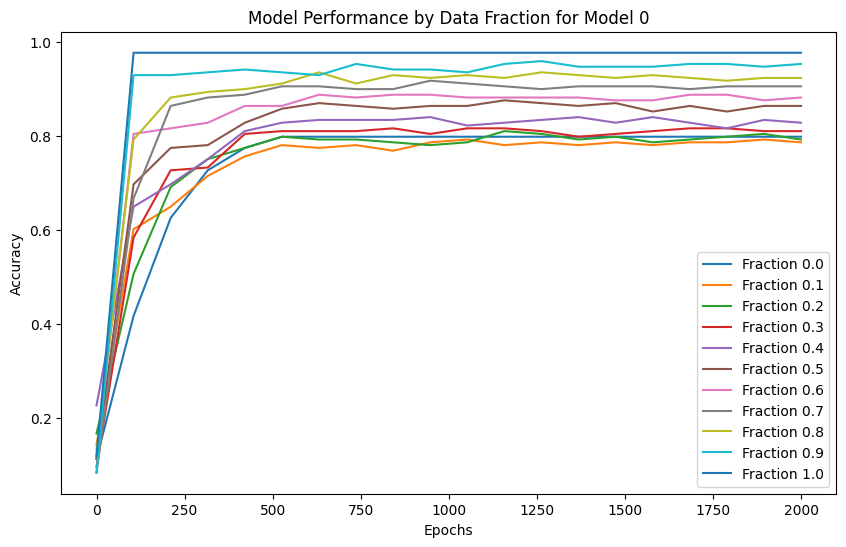

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2308
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.6370
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.1329
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.8087
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.6139
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.5162
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.4630
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.4358
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.4224
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.4144
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.4095
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.4059
prediction shape 

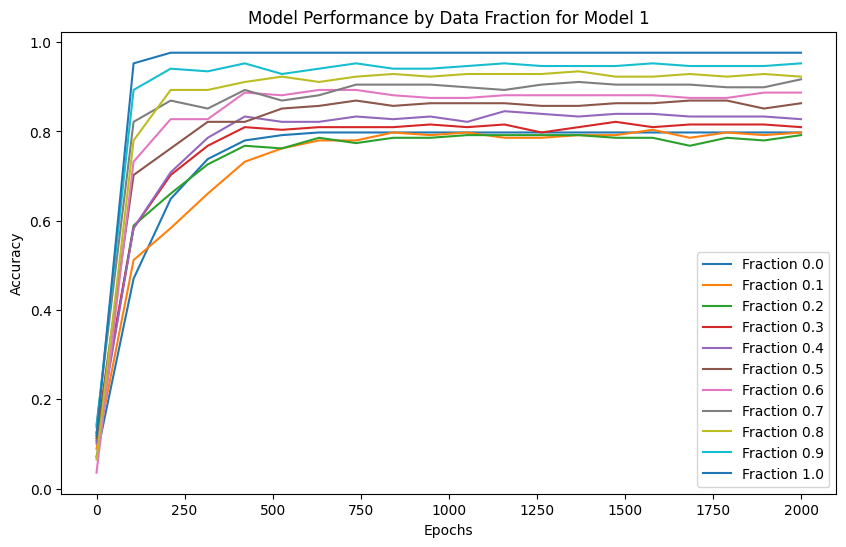

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2064
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.6265
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.1444
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.8397
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.6522
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.5615
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.4802
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.4423
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.4244
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.4166
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.4087
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.4055
prediction shape 

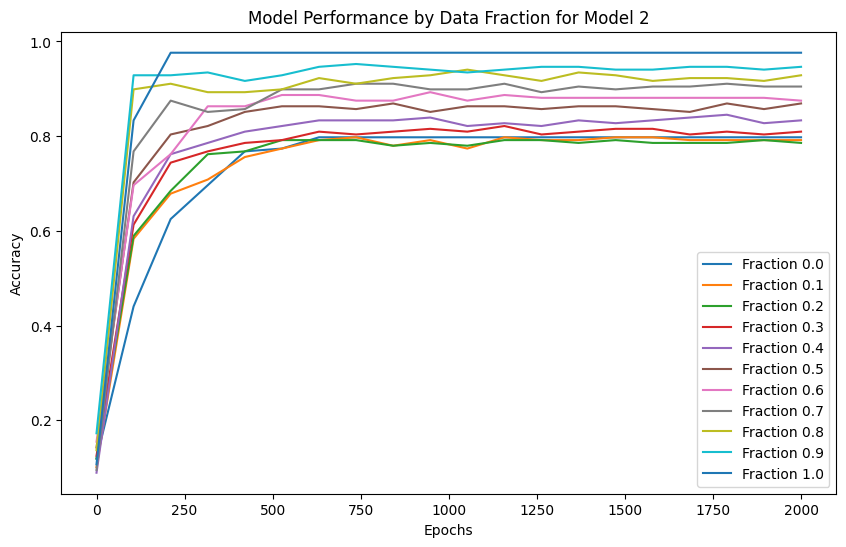

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2065
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.6017
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.1273
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.8232
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.6074
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.5239
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.4840
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.4623
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.4491
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.4396
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.4324
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.4269
prediction shape 

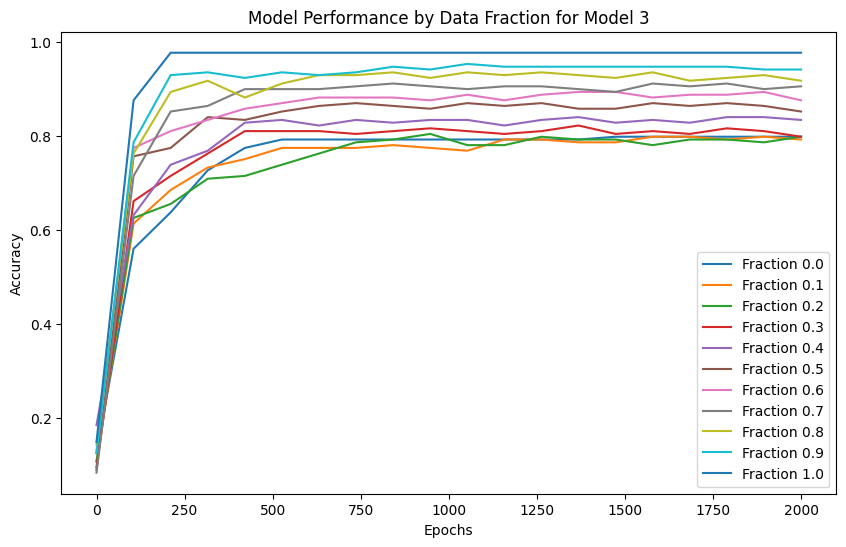

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2197
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.6432
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.1377
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.8283
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.6541
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.5532
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.5020
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.4717
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.4470
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.4291
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.4176
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.4109
prediction shape 

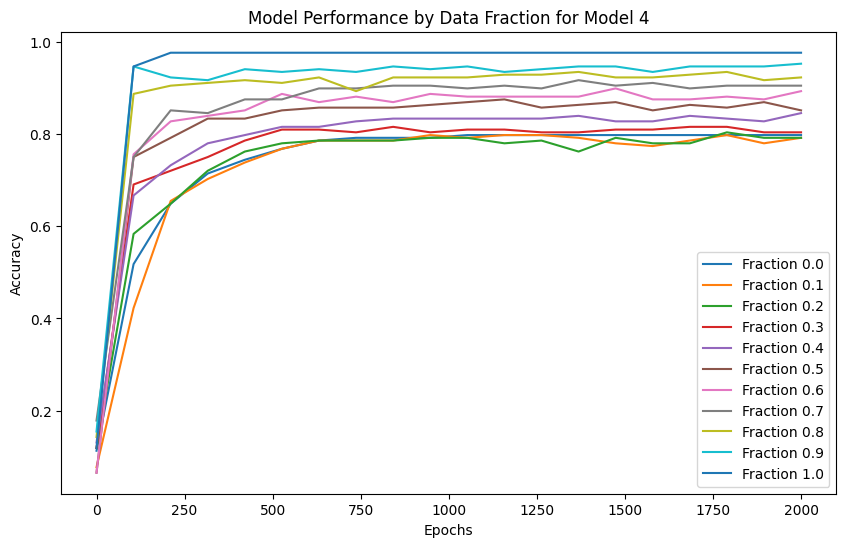

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2126
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.5897
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.0611
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.7619
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.6035
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.5075
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.4644
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.4391
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.4231
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.4146
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.4096
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.4062
prediction shape 

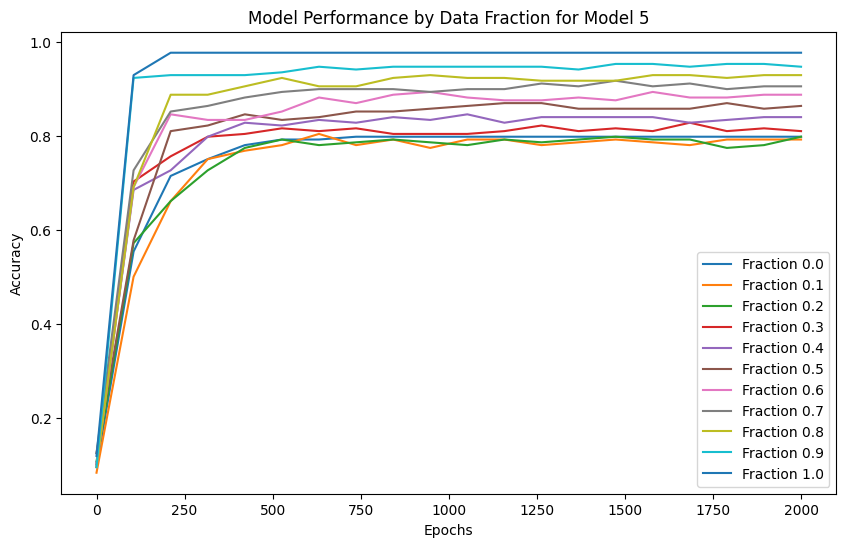

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2302
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.5861
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.1002
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.7892
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.6238
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.5354
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4771
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.4461
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.4304
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.4211
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.4138
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.4100
prediction shape 

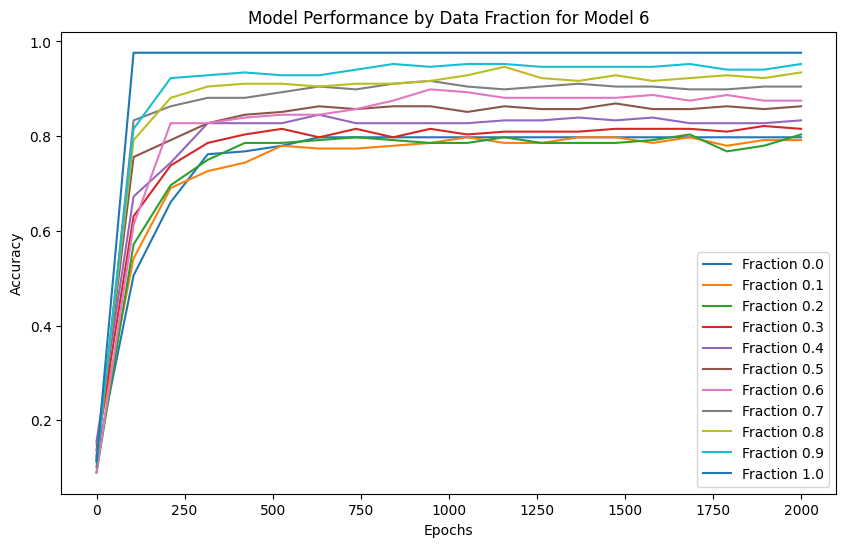

Model 7, Fraction 0.00, Epoch 1, Loss: 2.1967
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.5763
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.0605
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.7637
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.6096
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.5372
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.4999
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.4711
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.4528
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.4405
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.4313
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.4219
prediction shape 

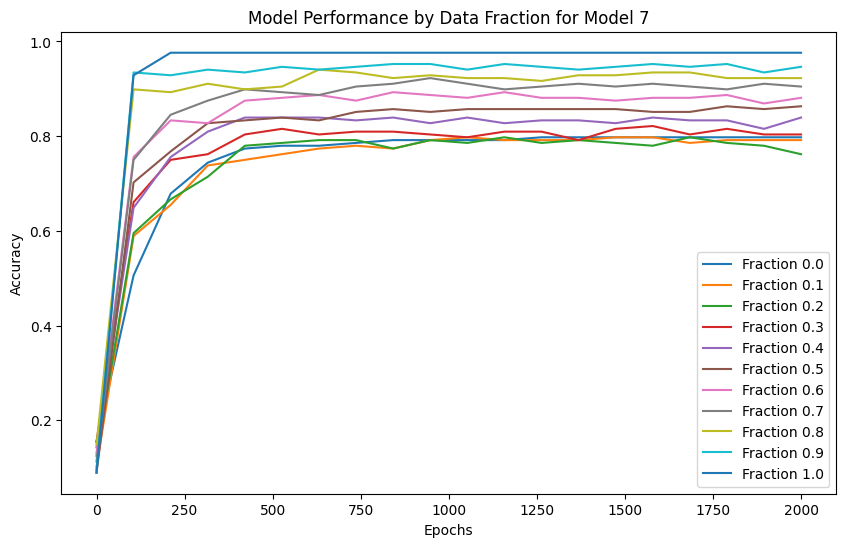

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2246
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.6391
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.1276
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.7970
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.5846
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.4890
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.4482
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.4288
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.4184
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.4122
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.4079
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.4052
prediction shape 

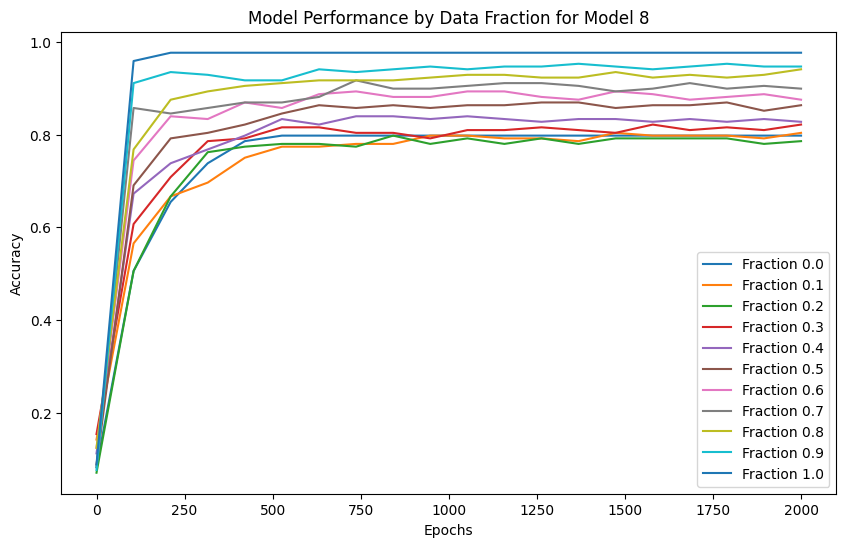

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2035
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.5813
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.1264
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.8409
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.6694
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.5587
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.4862
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.4466
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.4269
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.4167
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.4100
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.4071
prediction shape 

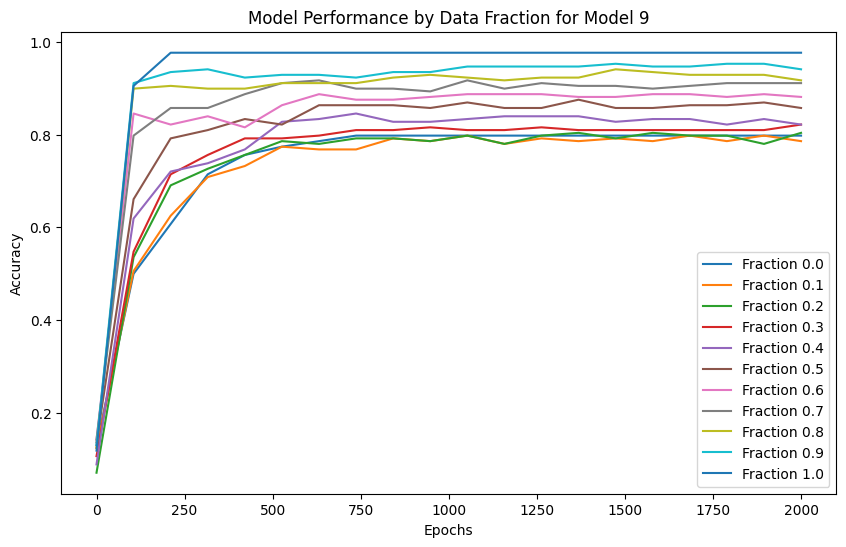

Model 10, Fraction 0.00, Epoch 1, Loss: 2.1974
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.5873
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.1323
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.7956
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.6203
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.5089
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.4552
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.4319
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.4201
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.4132
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.4087
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.4067
predi

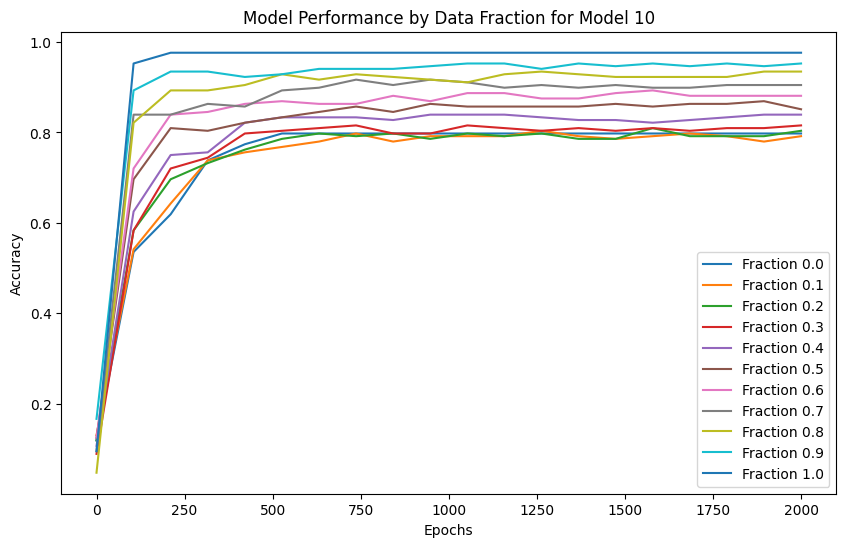

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.6247
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.2055
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.8646
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.6792
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.5793
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.5141
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.4727
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.4440
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.4283
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.4198
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.4137
predi

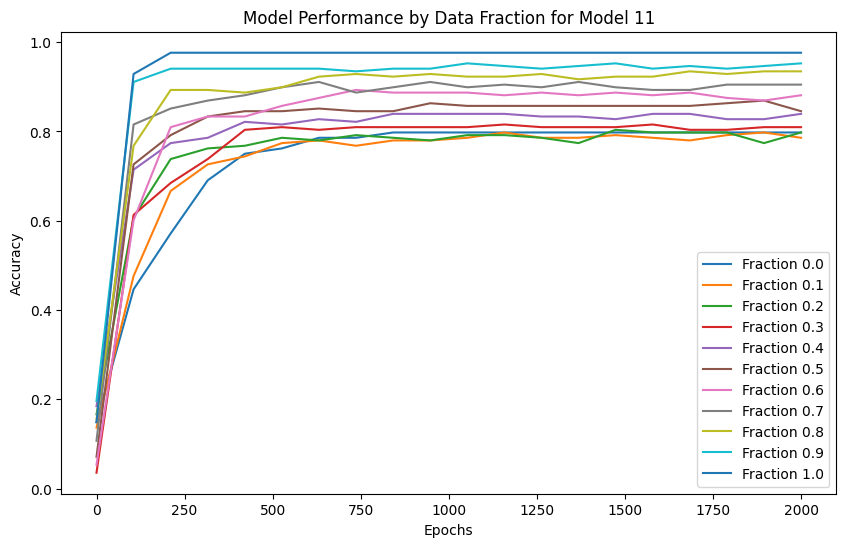

Model 12, Fraction 0.00, Epoch 1, Loss: 2.1998
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.6315
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.0514
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.7735
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.5970
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.5115
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.4724
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.4456
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.4288
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.4226
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.4117
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.4076
predi

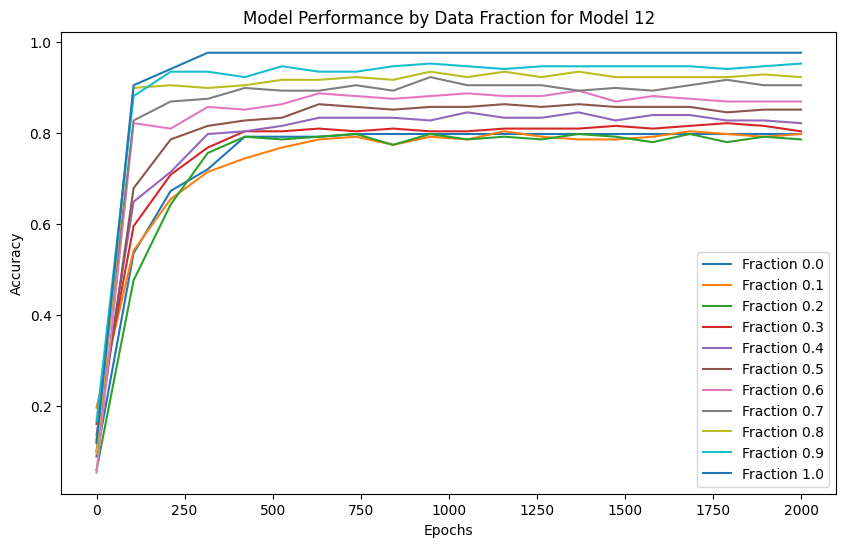

Model 13, Fraction 0.00, Epoch 1, Loss: 2.1920
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.5795
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.0522
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.7834
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.6105
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.5182
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.4714
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.4473
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.4323
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.4189
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.4105
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.4065
predi

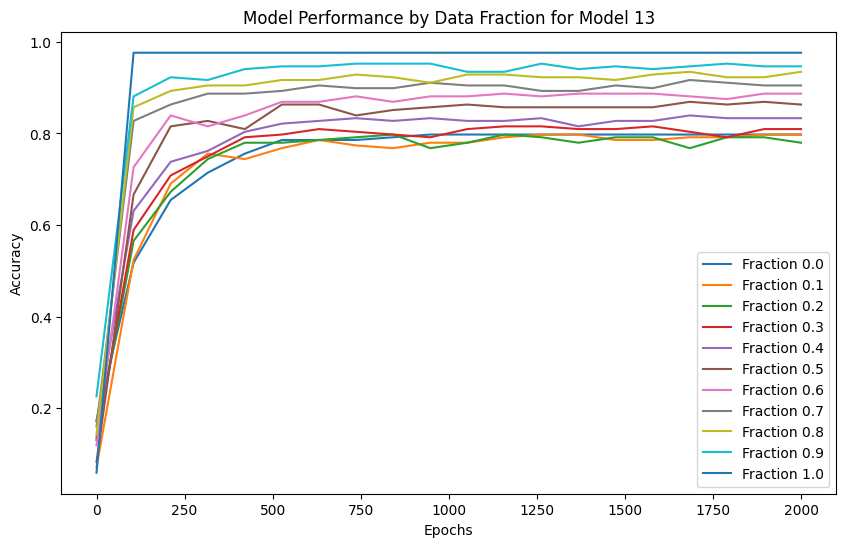

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2302
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.6128
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.1185
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.7682
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.5849
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.4995
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.4538
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.4306
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.4187
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.4121
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.4079
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.4075
predi

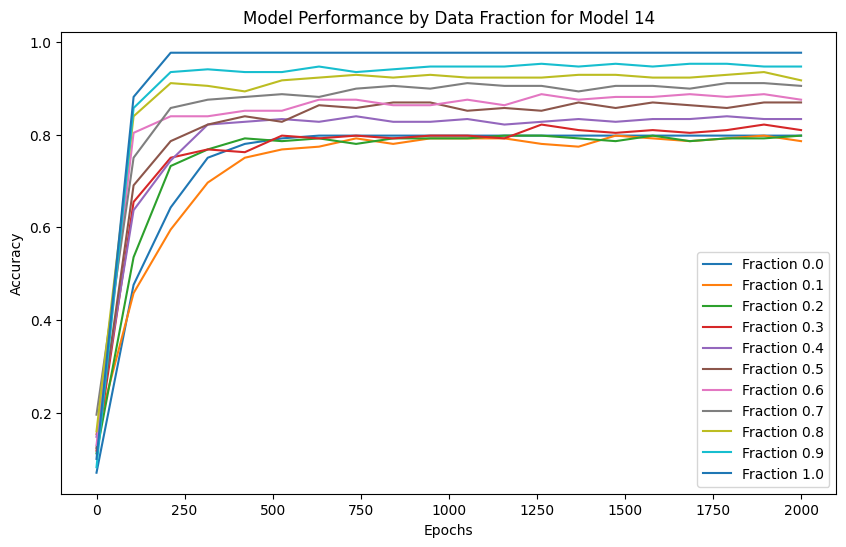

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2145
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.6261
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.1620
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.8328
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.5984
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.4876
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.4445
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.4263
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.4181
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.4121
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.4075
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.4045
predi

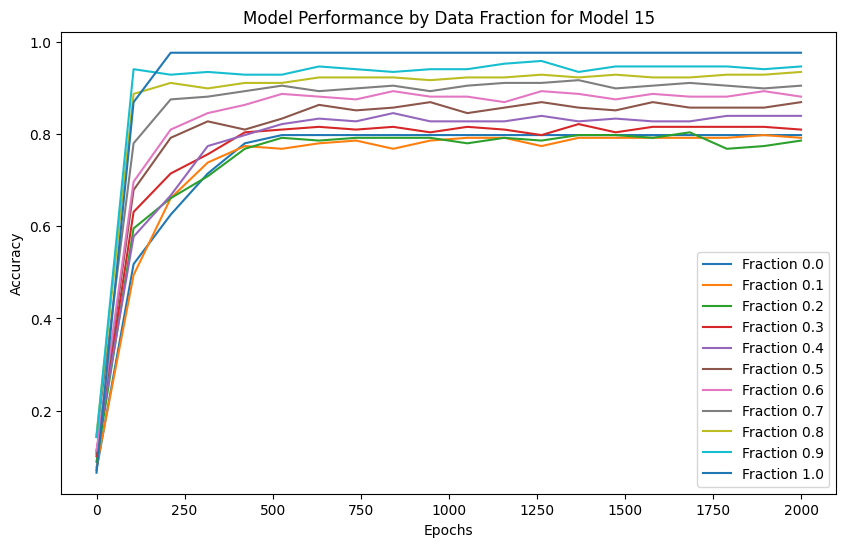

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2059
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.5689
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.1135
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.7816
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.5910
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.5078
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.4690
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.4444
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.4236
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.4144
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.4095
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.4061
predi

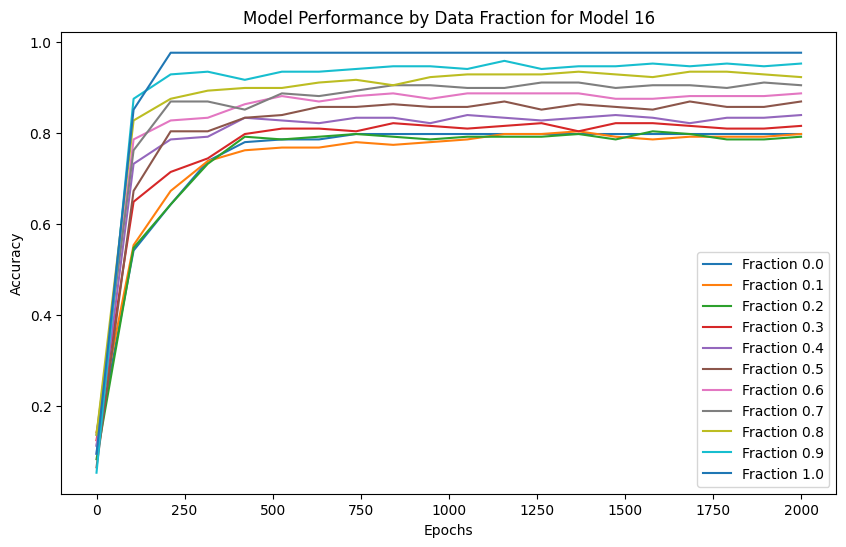

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2115
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.5425
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.0959
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.7722
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.6227
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.5416
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.4852
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.4541
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.4318
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.4190
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.4123
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.4078
predi

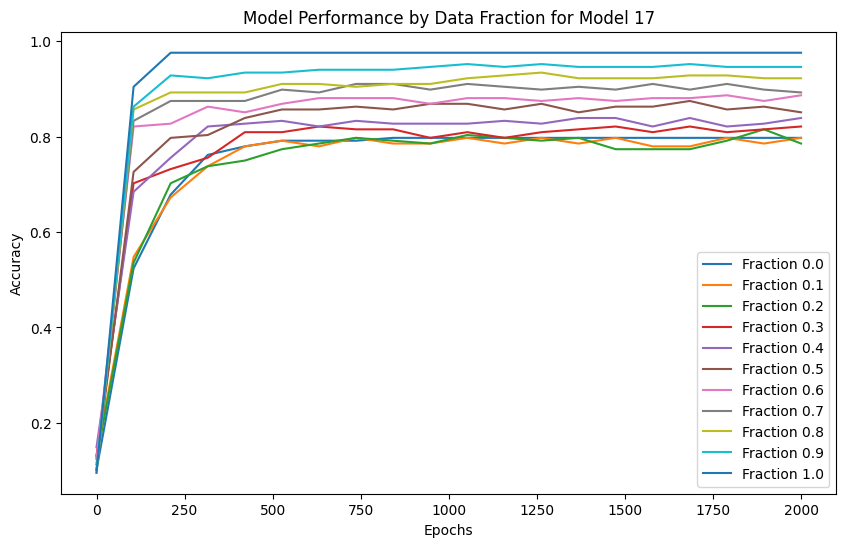

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.5626
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.0750
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.7648
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.6102
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.5205
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.4688
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.4426
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.4274
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.4198
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.4122
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.4081
predi

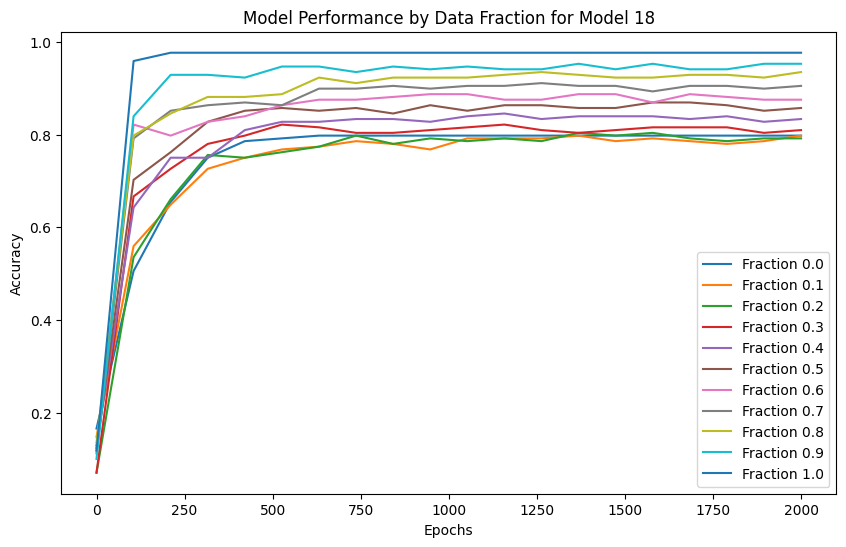

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2164
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.6536
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.1555
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.8224
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.6079
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.4959
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.4470
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.4304
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.4179
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.4121
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.4080
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.4054
predi

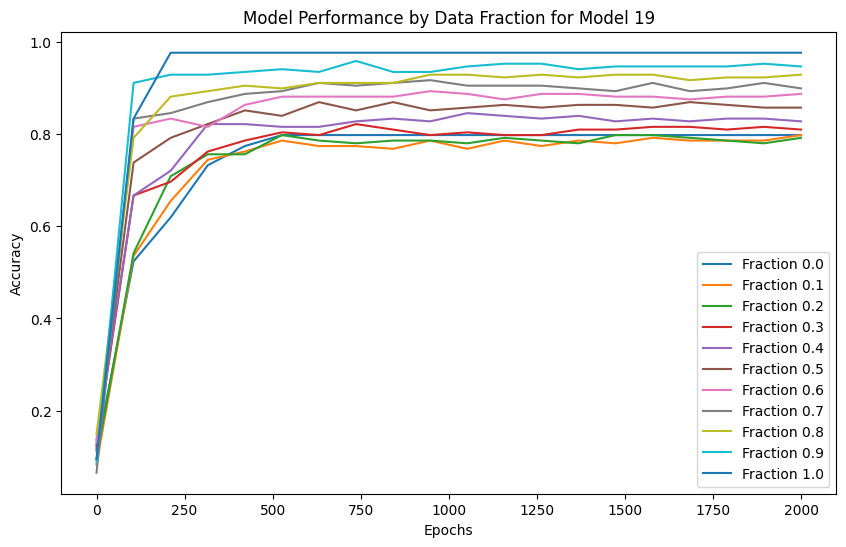

Model 20, Fraction 0.00, Epoch 1, Loss: 2.2297
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.6023
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.1079
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.7670
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.5968
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.5048
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4549
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.4338
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.4223
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.4149
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.4095
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.4060
predi

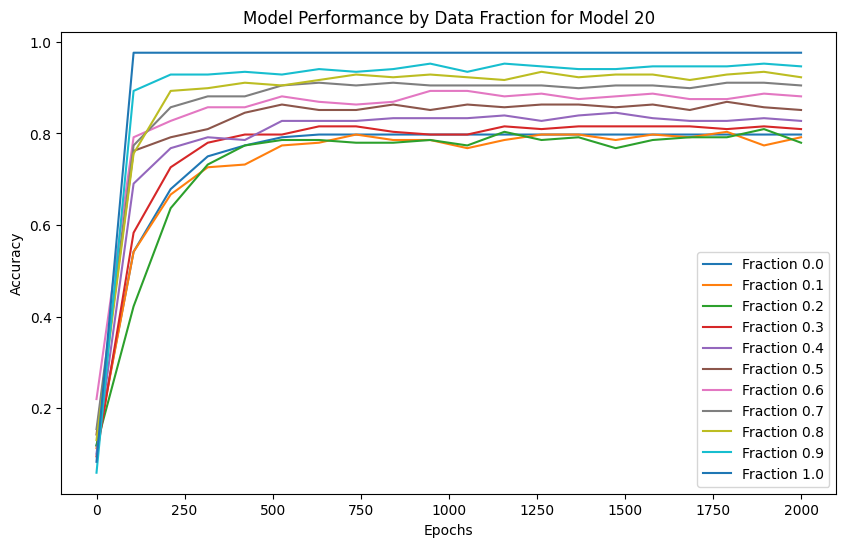

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2238
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.6203
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.1171
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.7786
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.5998
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.5067
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.4590
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.4358
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.4231
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.4148
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.4104
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.4074
predi

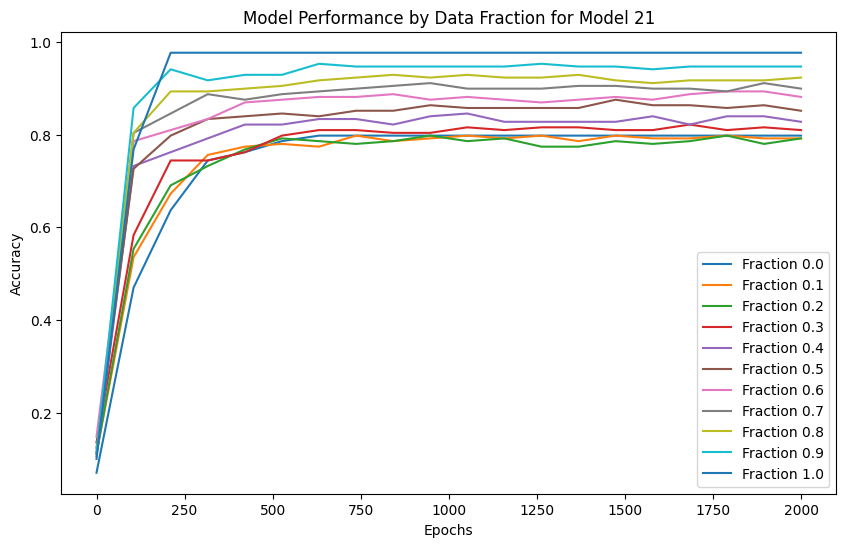

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2083
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.5585
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.0880
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.7695
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.5954
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.5052
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.4590
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.4322
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.4194
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.4124
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.4081
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.4050
predi

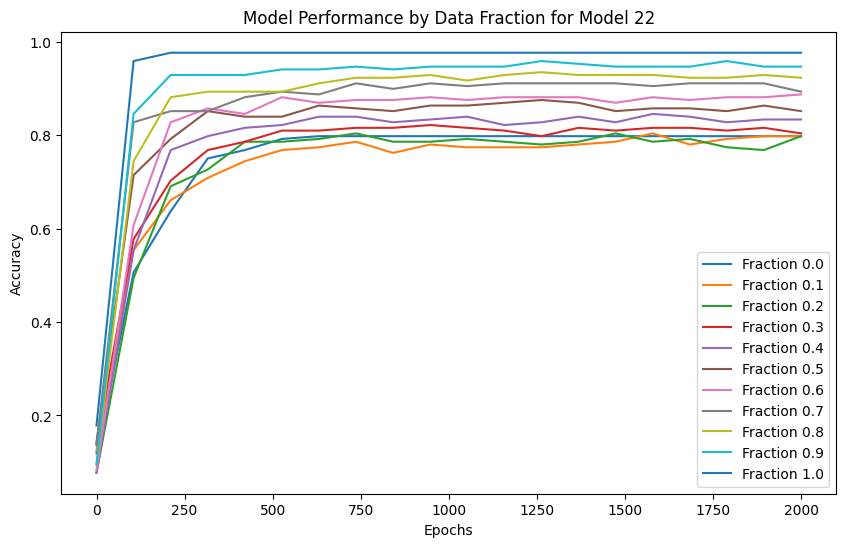

Model 23, Fraction 0.00, Epoch 1, Loss: 2.1843
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.6093
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.1014
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.8031
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.6154
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.5179
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.4634
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.4356
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.4232
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.4149
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.4122
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.4079
predi

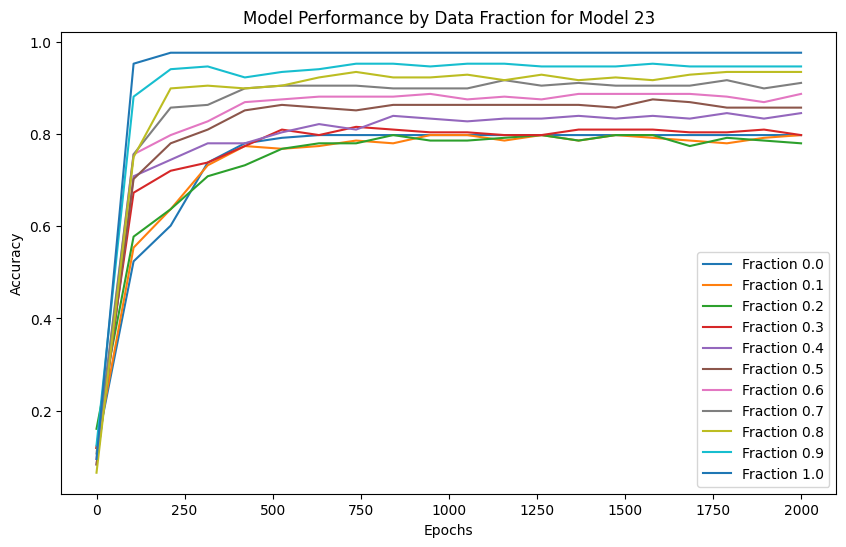

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2338
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.6105
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.1222
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.8097
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.6187
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.5137
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.4677
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.4415
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.4257
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.4164
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.4106
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.4084
predi

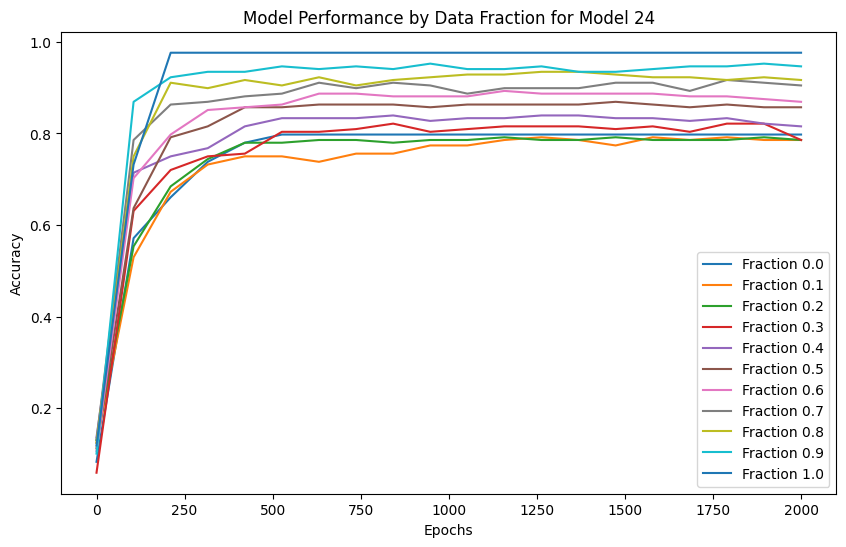

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2066
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.6316
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.1268
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.7891
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.5910
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.4953
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.4534
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.4326
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.4207
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.4137
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.4090
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.4058
predi

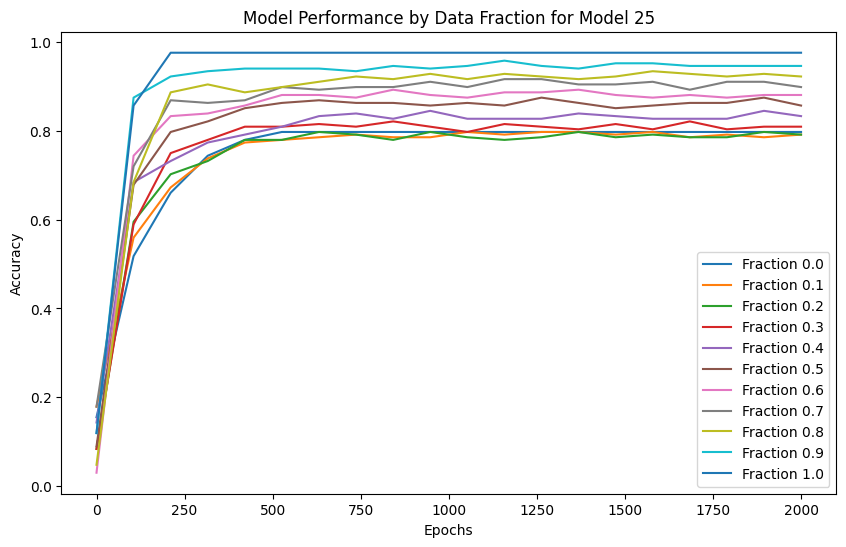

Model 26, Fraction 0.00, Epoch 1, Loss: 2.2108
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.6138
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.0570
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.7921
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.6191
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.5063
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.4566
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.4331
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.4209
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.4139
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.4111
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.4074
predi

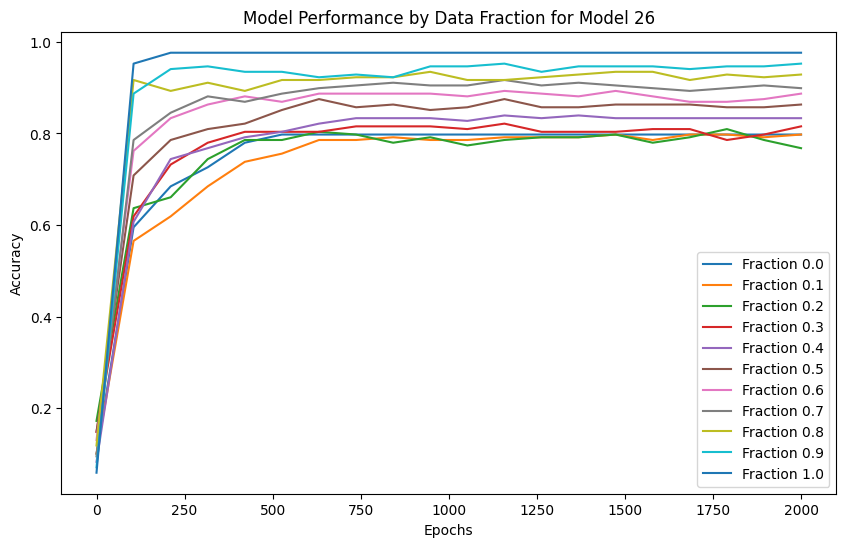

Model 27, Fraction 0.00, Epoch 1, Loss: 2.1978
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.6344
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.0530
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.7536
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.5828
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.4867
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4417
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.4248
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.4154
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.4101
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.4063
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.4035
predi

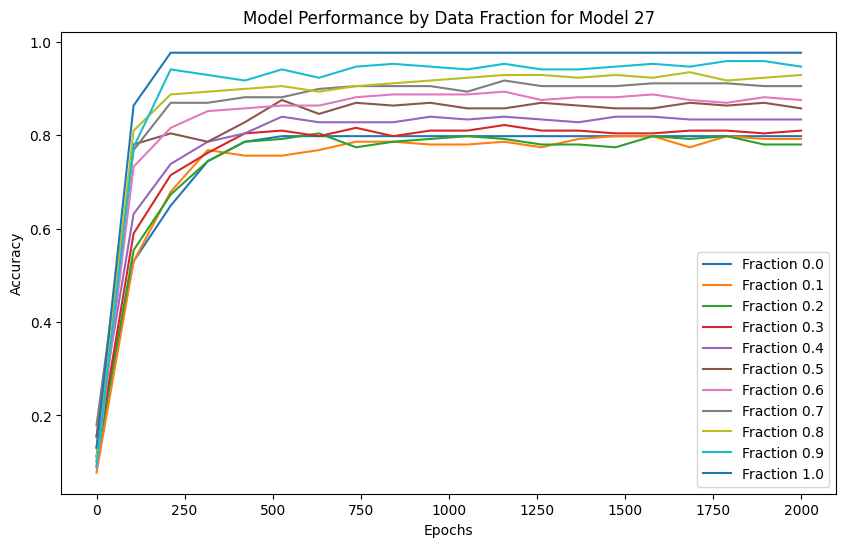

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2254
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.6596
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.1220
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.7794
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.6145
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.5319
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.4864
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.4583
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.4416
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.4294
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.4197
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.4117
predi

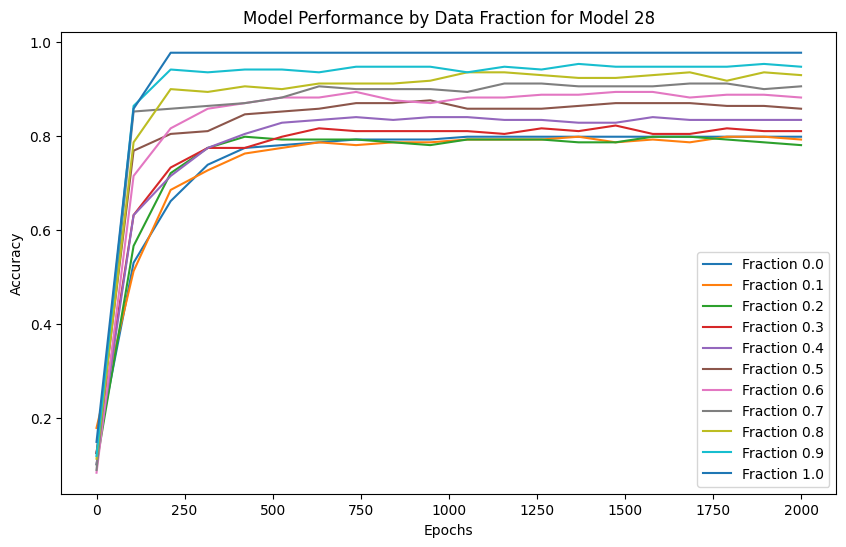

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2078
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.6181
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.1728
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.8302
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.6362
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.5316
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.4689
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.4409
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.4265
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.4177
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.4124
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.4082
predi

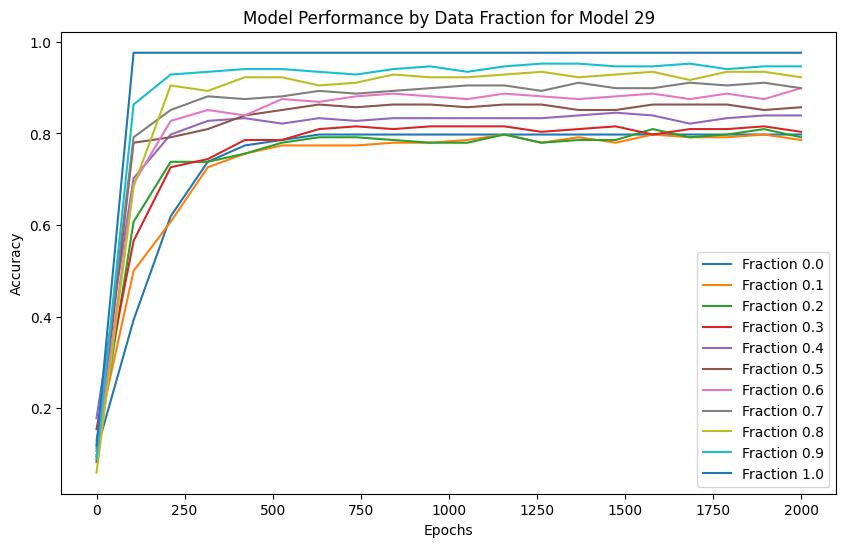

In [8]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_5th_note_contradiction/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [168]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_5th_note_contradiction"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.6278
  Fraction 0.10, Average Accuracy: 0.7452
  Fraction 0.20, Average Accuracy: 0.8812
  Fraction 0.30, Average Accuracy: 0.9728
  Fraction 0.40, Average Accuracy: 0.9762
  Fraction 0.50, Average Accuracy: 0.9762
  Fraction 0.60, Average Accuracy: 0.9762
  Fraction 0.70, Average Accuracy: 0.9762
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.7976
  Fraction 0.10, Average Accuracy: 0.7956
  Fraction 0.20, Average Accuracy: 0.7665
  Fraction 0.30, Average Accuracy: 0.7448
  Fraction 0.40, Average Accuracy: 0.7440
  Fraction 0.50, Average Accuracy: 0.7440
  Fraction 0.60, Average Accuracy: 0.7438
  Fraction 0.70, Average Accuracy: 0.7440
  Fraction 0.80, Average Accuracy: 0.7438
  Fraction 0.90, Average Accuracy: 0.7431
  Fraction 1.00, Average Accuracy: 0.5946


#### plot for transformers

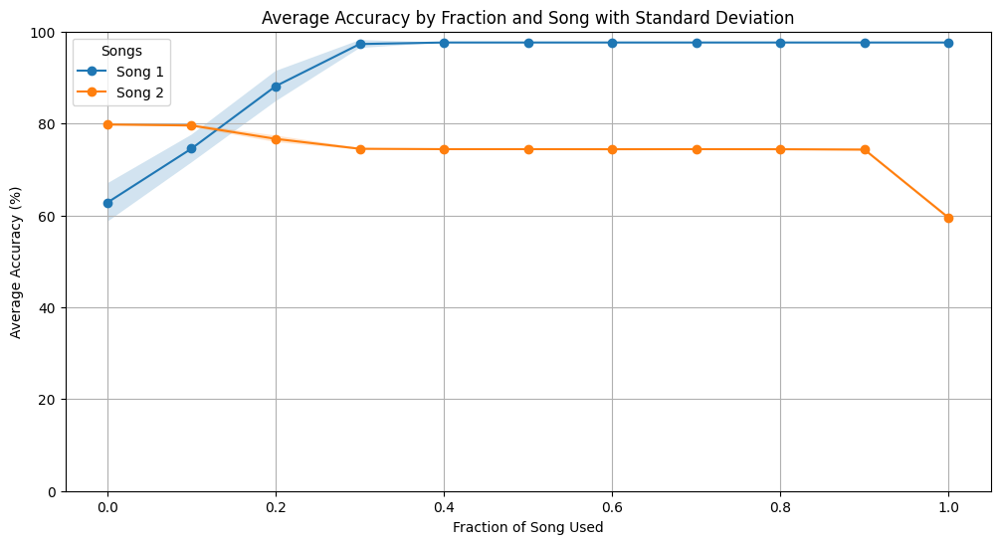

In [169]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot for decision tree

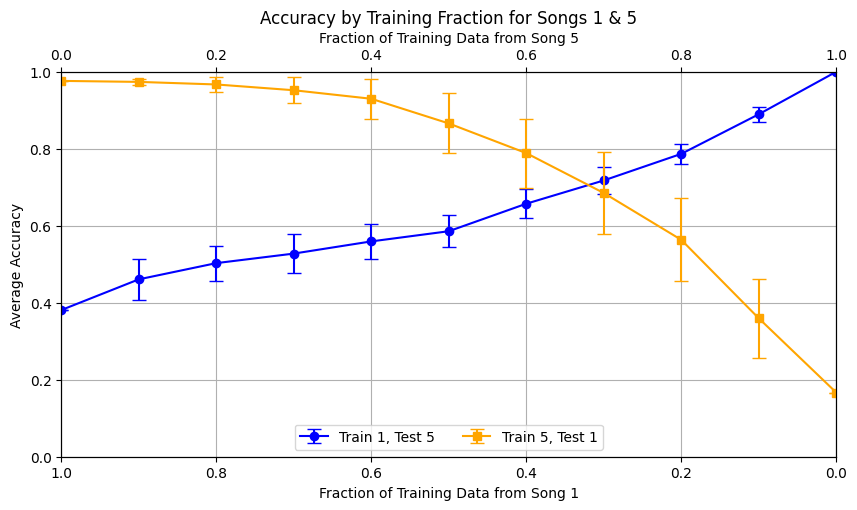

In [170]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 5), (5, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

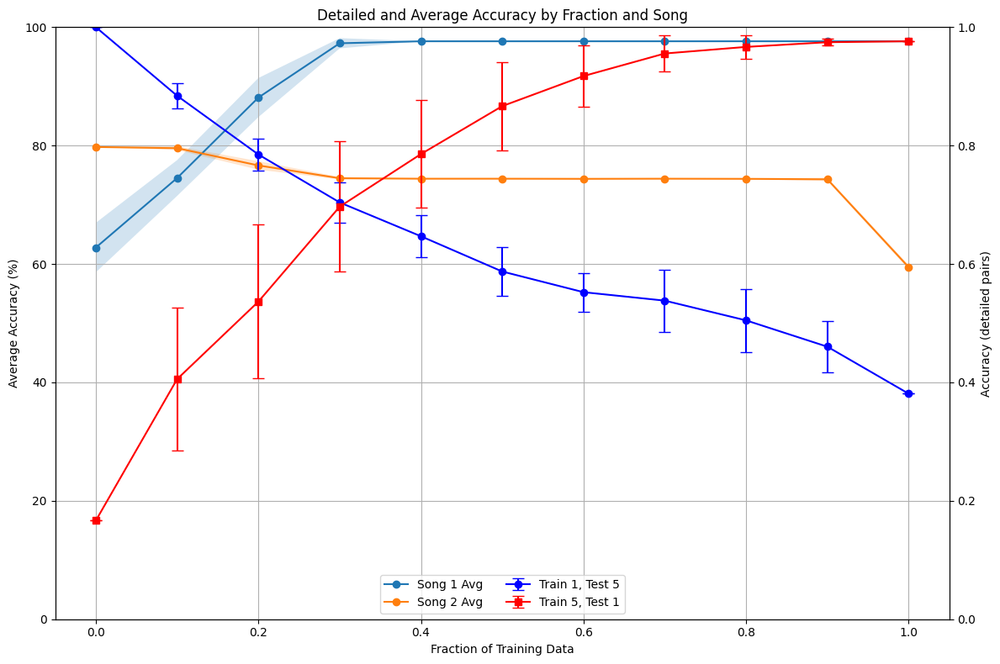

In [113]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 5), (5, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


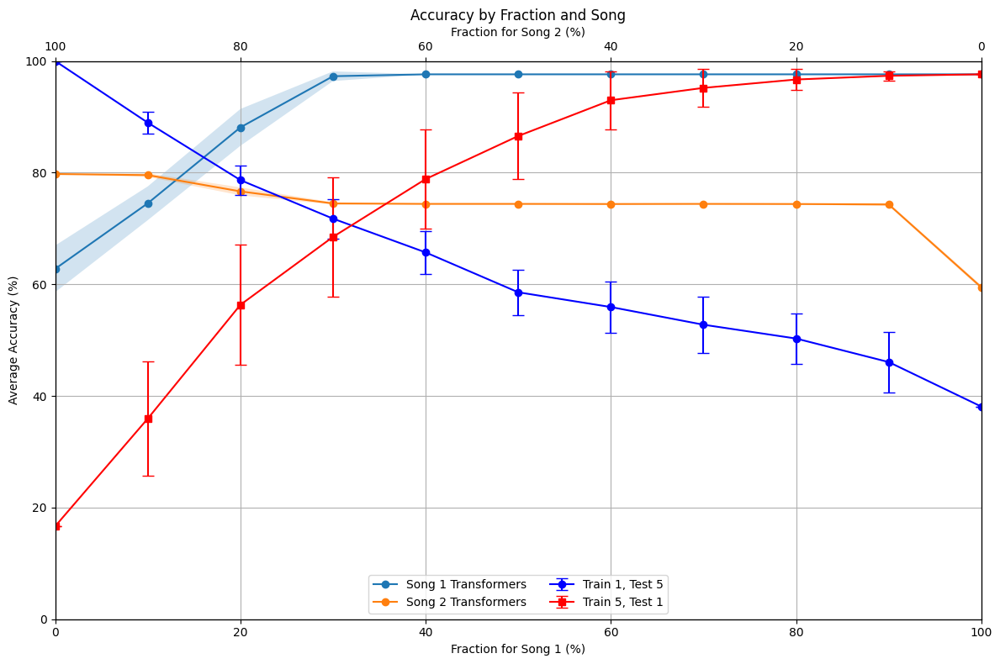

In [166]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 5), (5, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction for Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


In [189]:
# import matplotlib.pyplot as plt
# import numpy as np

# # Set up the figure and primary axis
# fig, ax1 = plt.subplots(figsize=(12, 8))

# # Plot the overall average accuracies in the primary axis
# average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
# std_dev_accuracies = accuracies.std(axis=2) * 100

# for song_idx, song in enumerate(songStrings):
#     x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
#     y_values = average_accuracies[:, song_idx]
#     y_err = std_dev_accuracies[:, song_idx]
#     ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
#     ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# # Configure primary axis
# ax1.set_title('Accuracy by Fraction and Song')
# ax1.set_xlabel('Fraction for Song 1 (%)')
# ax1.set_ylabel('Average Accuracy (%)')
# ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
# ax1.set_ylim(0, 100)
# ax1.grid(True)

# # Initialize the secondary axis on the same x-axis but different y-scale
# ax2 = ax1.twinx()

# # Plotting detailed pair data on the secondary axis
# desired_pairs = [(1, 5), (5, 1)]  # Define which song combinations you want to plot
# for pair, data in plot_data.items():
#     if pair in desired_pairs:
#         for order_label, (fractions, means, std_devs) in data.items():
#             sorted_data = sorted(zip(fractions, means, std_devs))
#             fractions, means, std_devs = zip(*sorted_data)
#             fractions = np.array(fractions) * 100  # Convert to percentages for consistency

#             if "Train " + str(pair[0]) in order_label:
#                 mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages for reversing the direction
#                 ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
#             else:
#                 ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# # Configure secondary axis
# ax2.set_ylabel('Accuracy (detailed pairs)')
# ax2.set_ylim(0, 1)  # Adjust the scale appropriately
# ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# # Configure secondary x-axis as before
# ax3 = ax1.twiny()
# ax3.set_xlabel('Fraction for Song 2 (%)')
# ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# # Combine legends from both axes
# lines, labels = ax1.get_legend_handles_labels()
# lines2, labels2 = ax2.get_legend_handles_labels()
# lines3, labels3 = ax3.get_legend_handles_labels()
# ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

# plt.tight_layout()
# plt.show()


### Normal and 10th Note - 0.98(overlap - contradiction)

#### Training

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather t

Model 0, Fraction 0.00, Epoch 1, Loss: 2.3212
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 101, Loss: 1.4331
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.7245
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.3457
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.2153
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.1631
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.1375
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.1232
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.1145
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.1088
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.1048
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.1019
prediction shape 

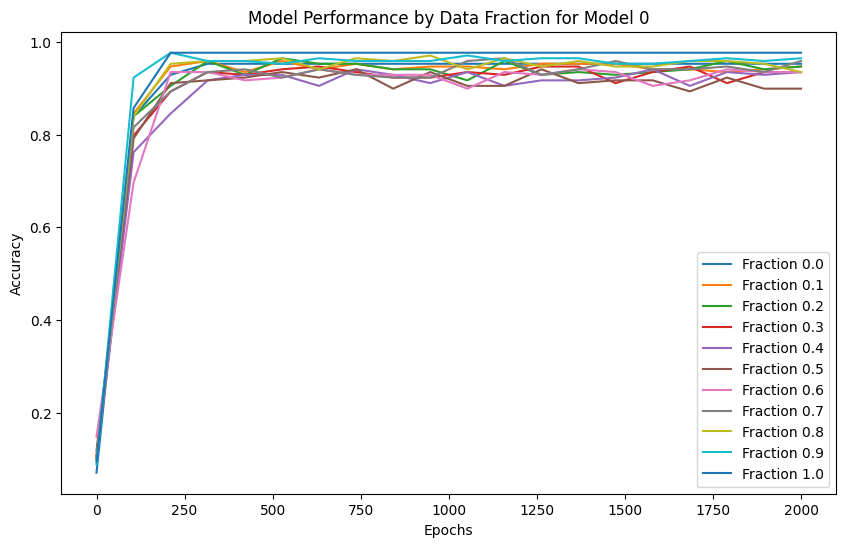

Model 1, Fraction 0.00, Epoch 1, Loss: 2.3163
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.4470
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.6618
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.3726
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.2109
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.1586
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.1348
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.1217
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.1136
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.1082
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.1045
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.1017
prediction shape 

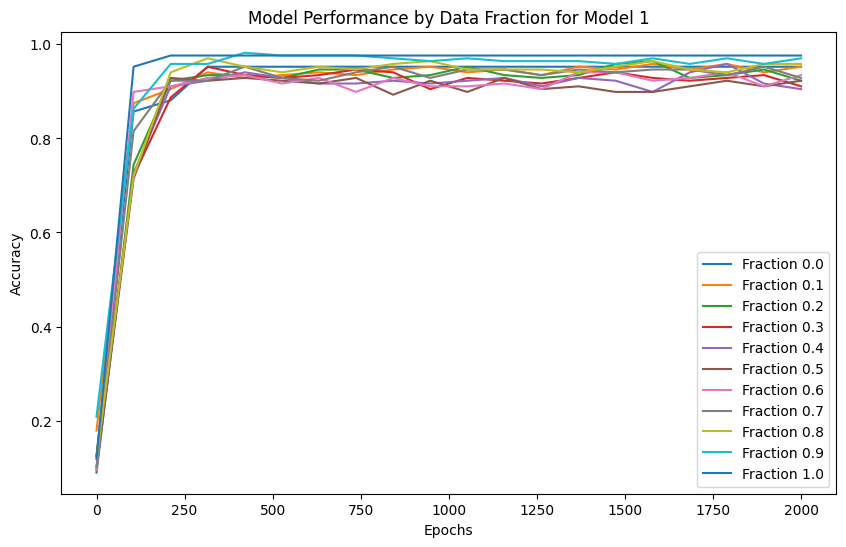

Model 2, Fraction 0.00, Epoch 1, Loss: 2.3451
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.4360
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.7161
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.3718
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.2287
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.1708
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.1426
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.1267
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.1170
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.1106
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.1062
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.1030
prediction shape 

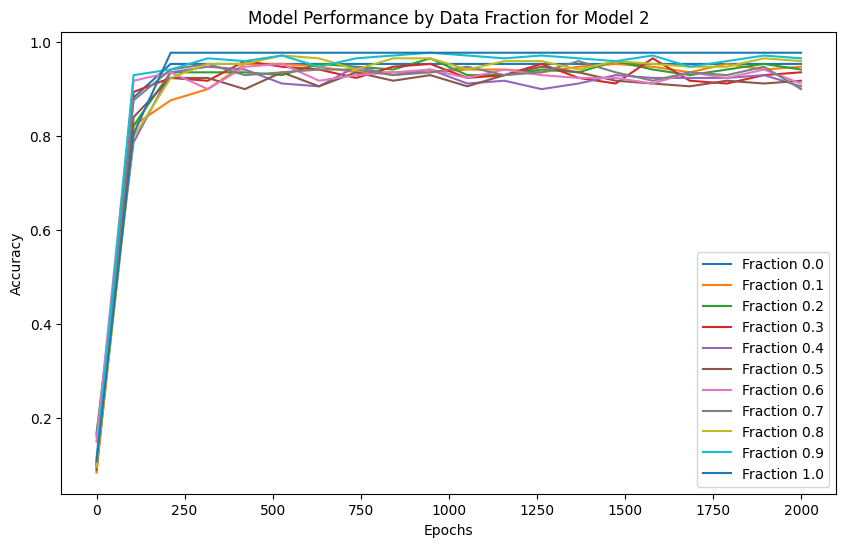

Model 3, Fraction 0.00, Epoch 1, Loss: 2.3360
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.4461
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.7393
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.4142
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.2310
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.1666
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.1383
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.1234
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.1145
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.1087
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.1047
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.1019
prediction shape 

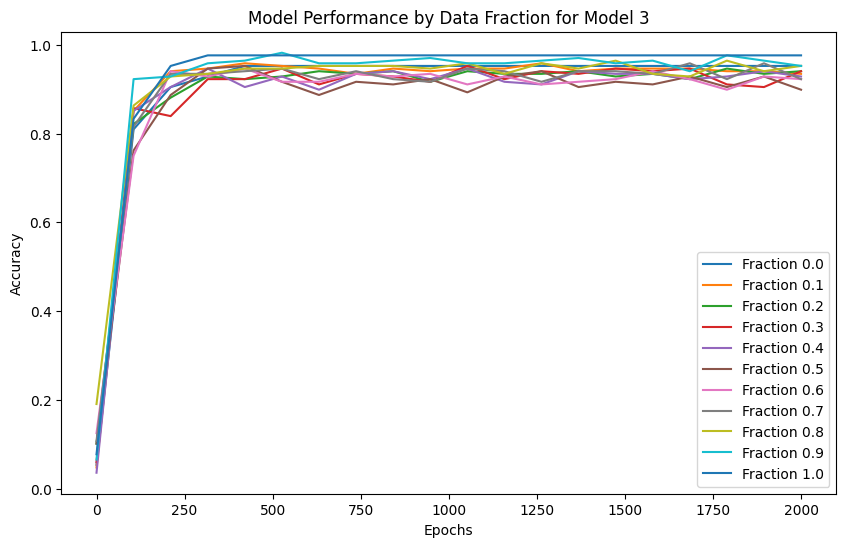

Model 4, Fraction 0.00, Epoch 1, Loss: 2.3133
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.4140
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.7125
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.3977
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.2312
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.1675
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.1385
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.1232
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.1141
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.1083
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.1043
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.1015
prediction shape 

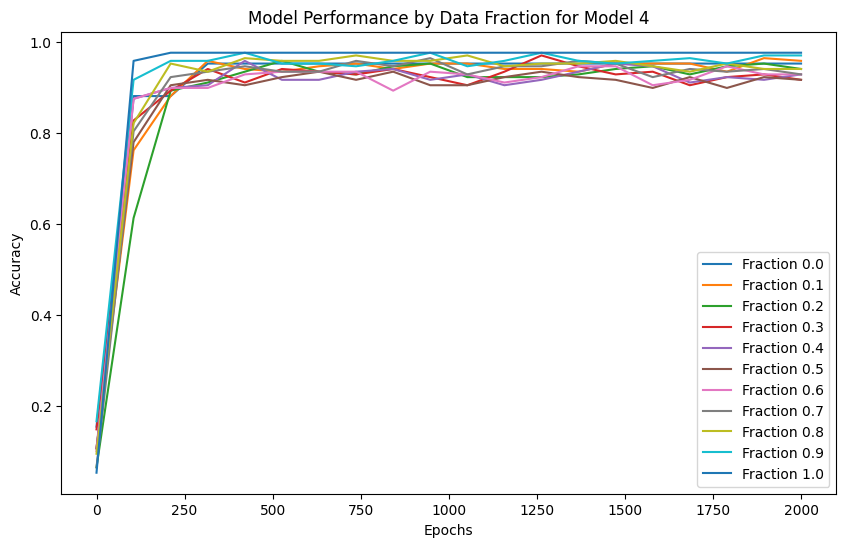

Model 5, Fraction 0.00, Epoch 1, Loss: 2.3331
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.4253
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.6677
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.3926
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.2323
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.1701
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.1417
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.1261
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.1166
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.1106
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.1063
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.1031
prediction shape 

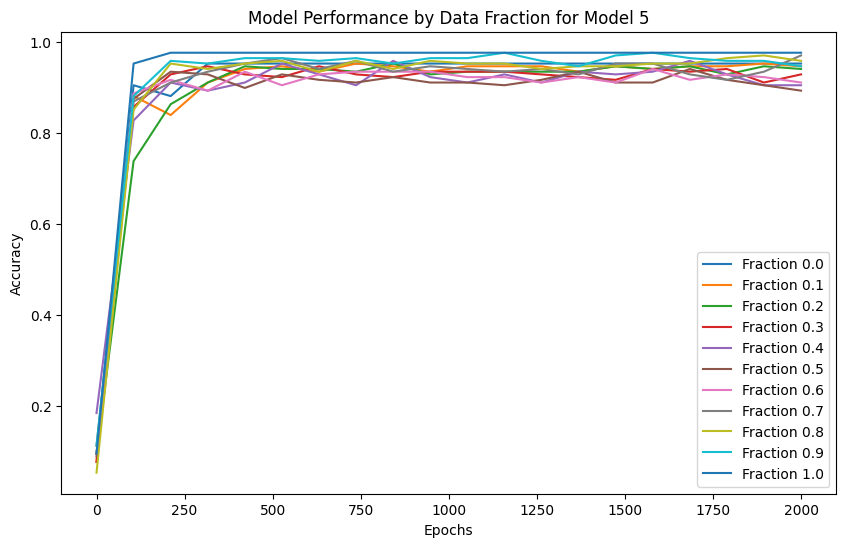

Model 6, Fraction 0.00, Epoch 1, Loss: 2.3297
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.4111
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.6732
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.3990
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.2744
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.1760
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.1421
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.1254
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.1156
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.1095
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.1053
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.1023
prediction shape 

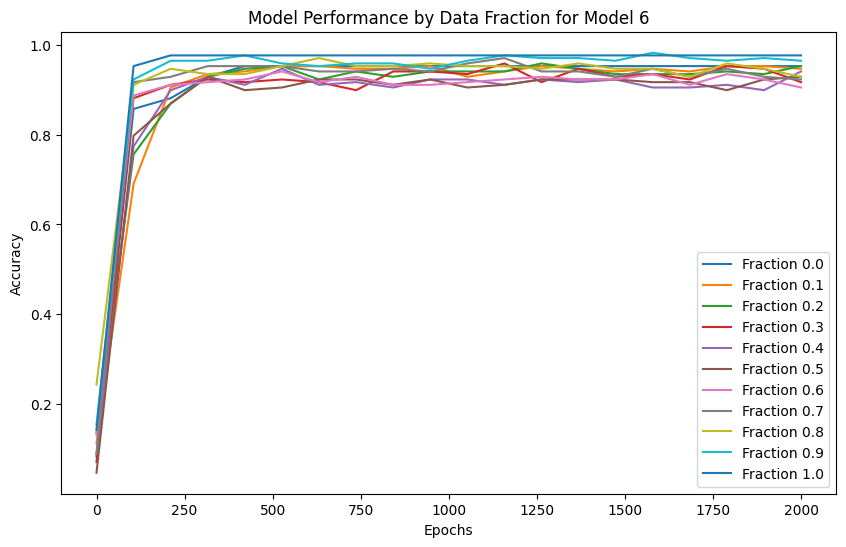

Model 7, Fraction 0.00, Epoch 1, Loss: 2.3094
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.3633
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.6349
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.3340
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.2143
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.1645
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.1394
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.1249
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.1159
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.1099
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.1057
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.1027
prediction shape 

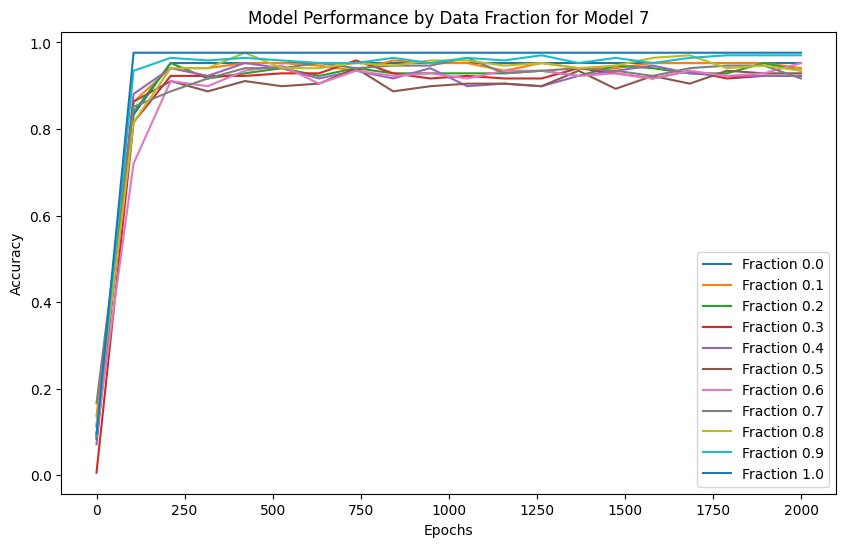

Model 8, Fraction 0.00, Epoch 1, Loss: 2.3306
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.4415
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.7029
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.3467
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.2165
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.1633
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.1373
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.1229
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.1142
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.1084
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.1045
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.1017
prediction shape 

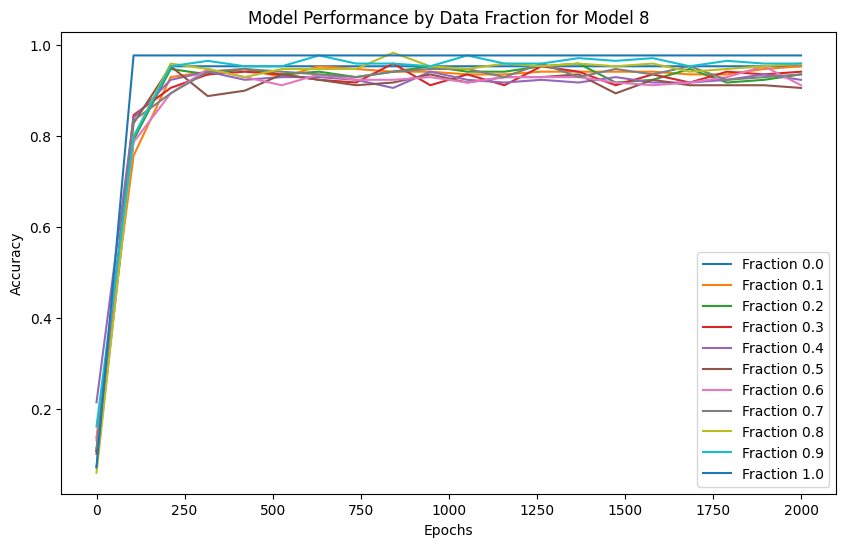

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2897
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.3588
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.6475
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.3245
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.2096
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.1620
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.1380
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.1242
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.1155
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.1098
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.1057
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.1028
prediction shape 

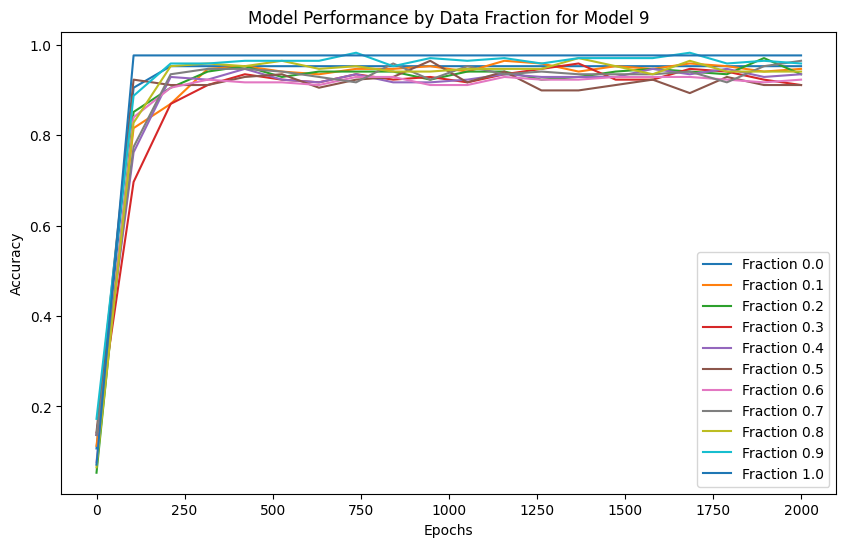

Model 10, Fraction 0.00, Epoch 1, Loss: 2.3061
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.4686
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 0.7226
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.4058
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.2357
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.1662
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.1387
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.1240
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.1150
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.1091
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.1050
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.1021
predi

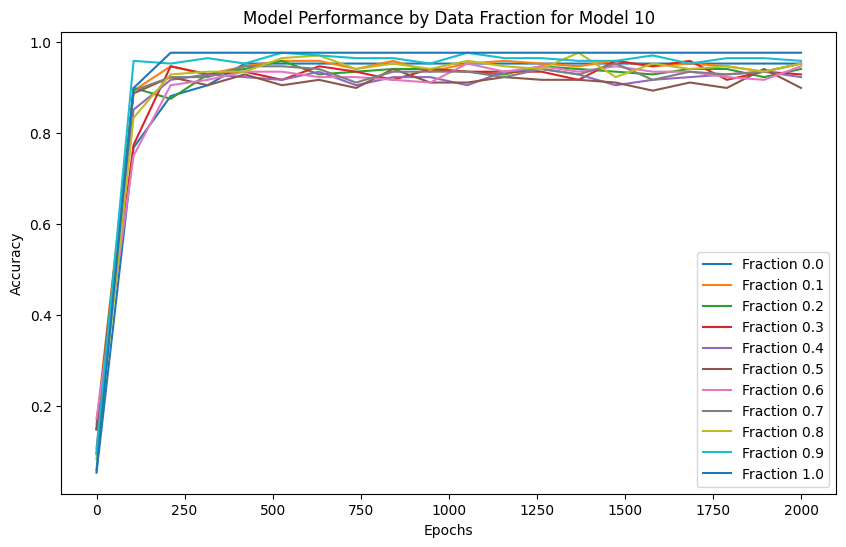

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2758
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.4318
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 0.7150
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.3467
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.2158
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.1624
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.1366
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.1224
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.1138
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.1083
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.1044
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.1016
predi

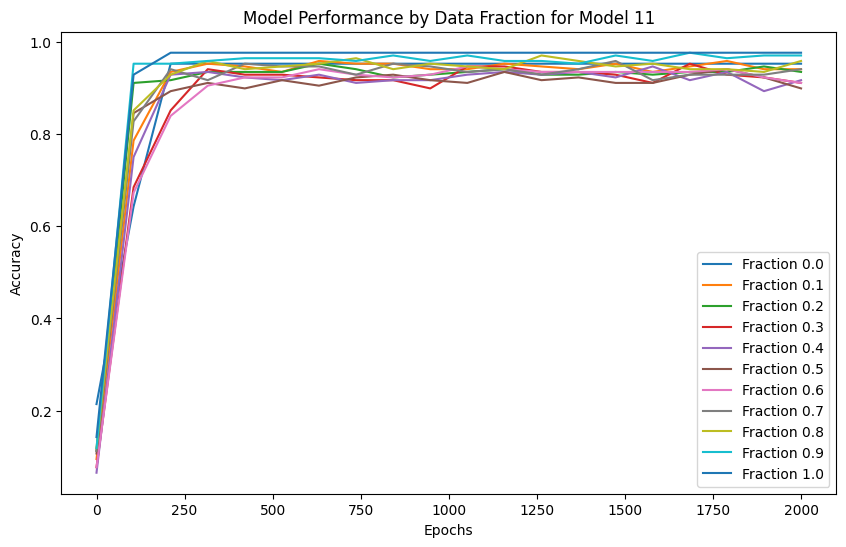

Model 12, Fraction 0.00, Epoch 1, Loss: 2.3389
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.4693
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 0.7435
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.3820
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.2288
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.1686
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.1401
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.1245
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.1151
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.1091
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.1050
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.1020
predi

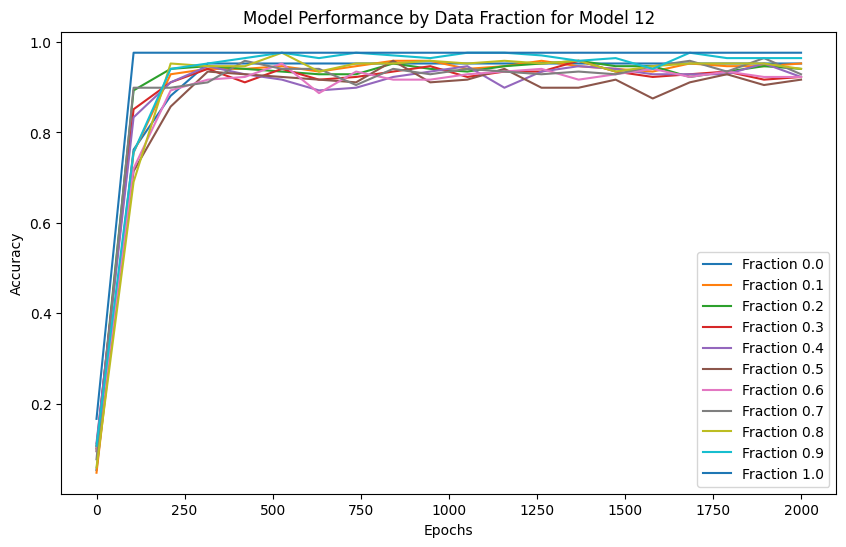

Model 13, Fraction 0.00, Epoch 1, Loss: 2.3131
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.4044
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 0.7356
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.3831
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.2415
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.1795
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.1479
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.1300
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.1190
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.1119
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.1070
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.1036
predi

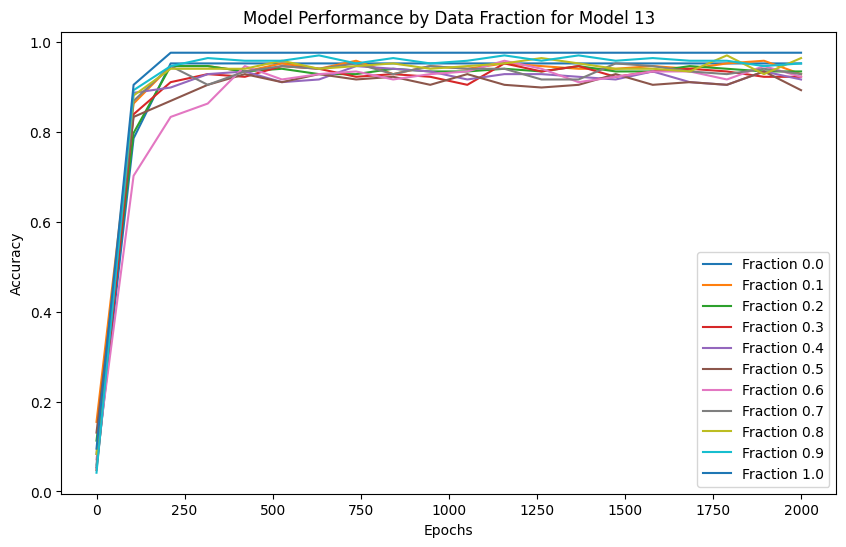

Model 14, Fraction 0.00, Epoch 1, Loss: 2.3227
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.4629
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 0.6983
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.3583
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.2143
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.1616
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.1368
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.1231
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.1146
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.1090
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.1051
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.1023
predi

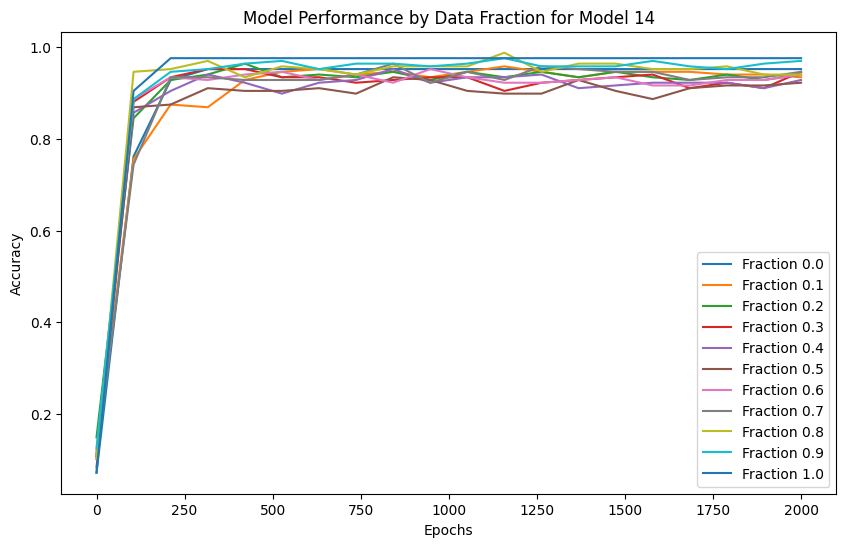

Model 15, Fraction 0.00, Epoch 1, Loss: 2.3391
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.4392
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 0.6786
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.3419
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.2171
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.1657
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.1414
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.1255
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.1162
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.1098
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.1055
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.1024
predi

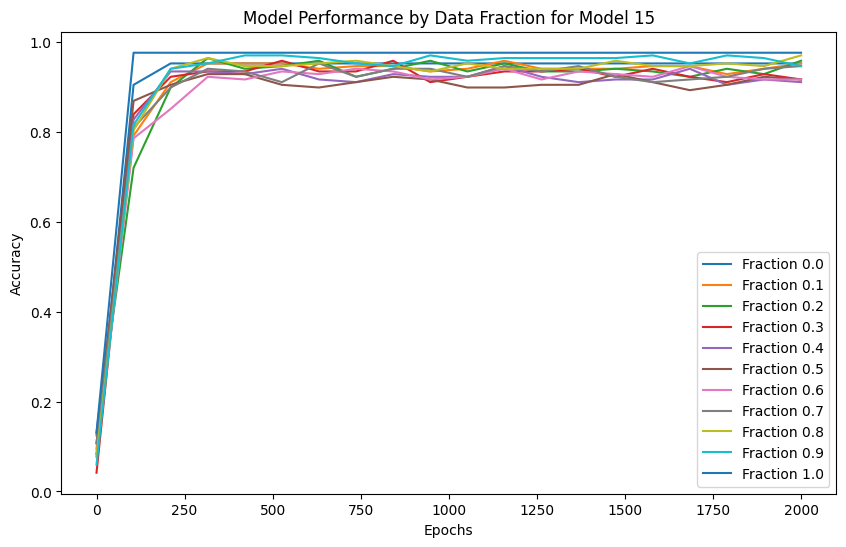

Model 16, Fraction 0.00, Epoch 1, Loss: 2.3428
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.4953
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 0.7240
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.3387
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.2122
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.1618
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.1370
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.1229
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.1143
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.1087
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.1047
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.1019
predi

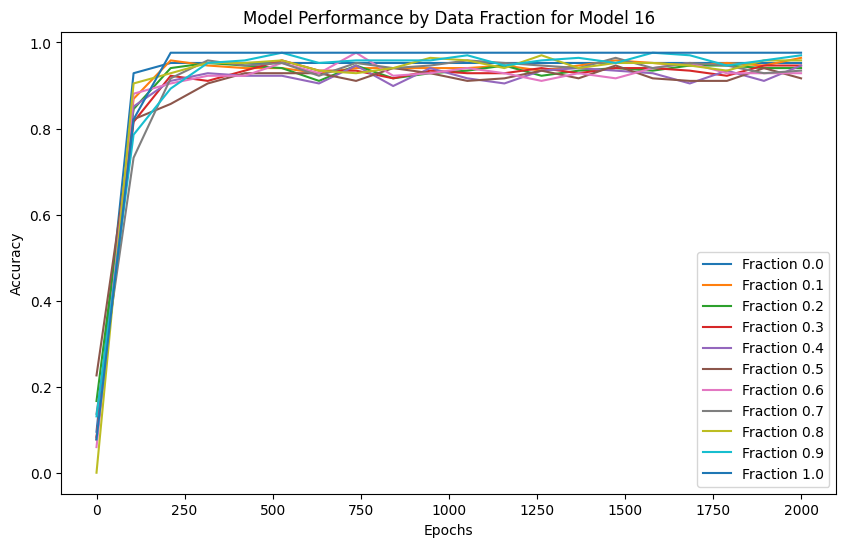

Model 17, Fraction 0.00, Epoch 1, Loss: 2.3570
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.5097
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 0.7177
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.3337
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.2094
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.1604
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.1363
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.1226
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.1140
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.1083
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.1045
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.1017
predi

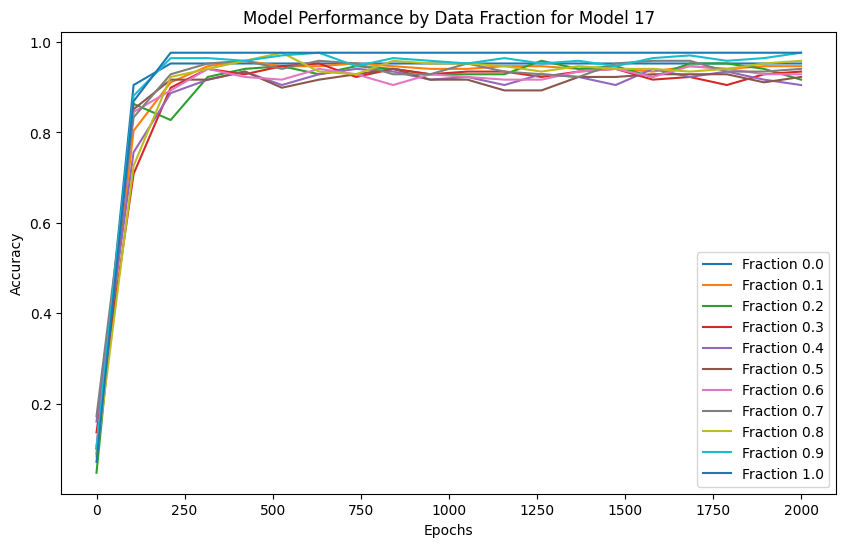

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2848
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.2958
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 0.6693
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.3362
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.2118
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.1617
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.1370
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.1232
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.1146
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.1089
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.1050
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.1021
predi

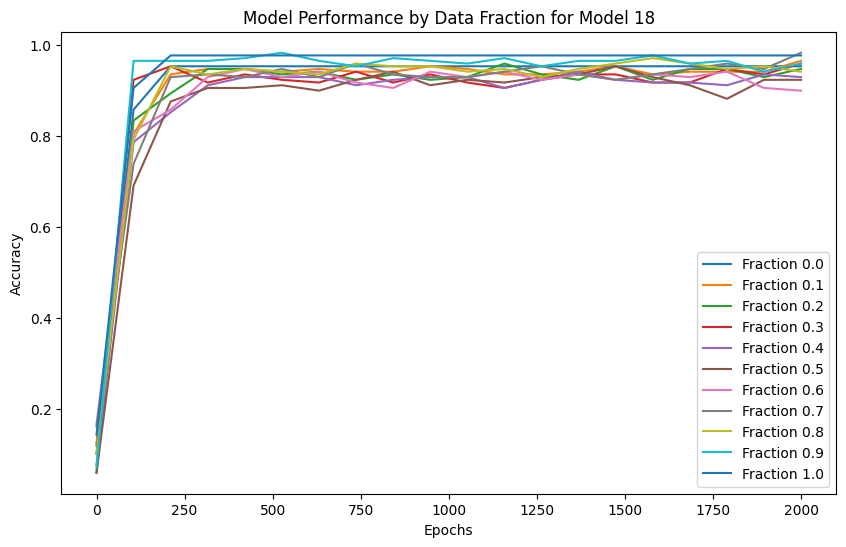

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2892
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.3255
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 0.6384
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.3728
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.2185
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.1603
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.1350
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.1214
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.1132
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.1078
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.1041
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.1014
predi

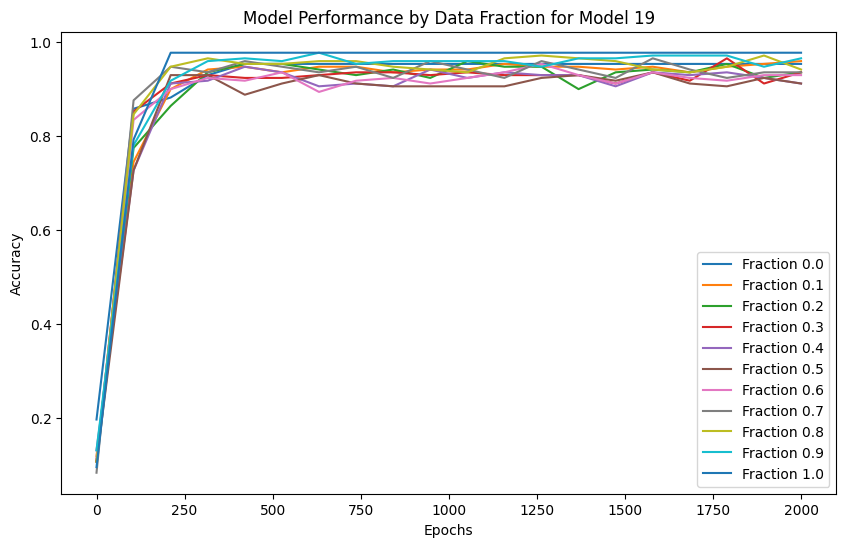

Model 20, Fraction 0.00, Epoch 1, Loss: 2.3290
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.4905
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 0.7297
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.3580
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.2123
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.1586
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.1339
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.1206
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.1126
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.1073
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.1037
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.1013
predi

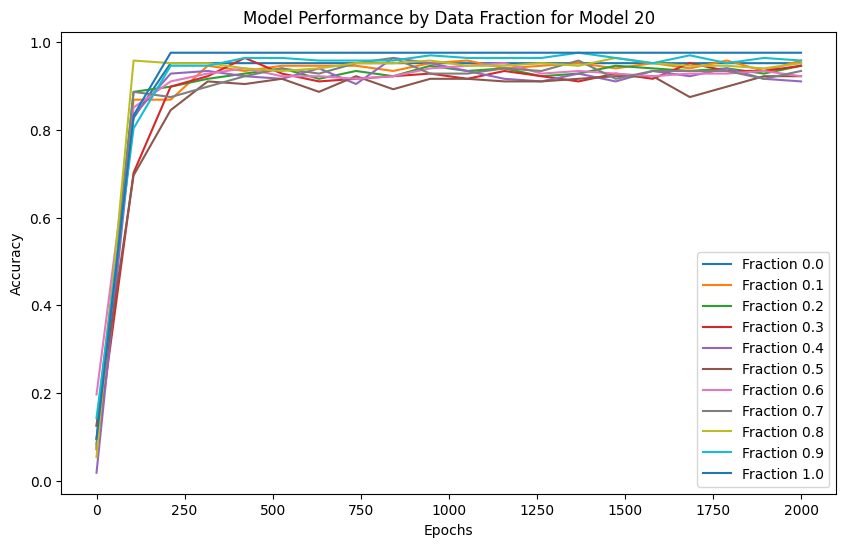

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2965
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.4095
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 0.6606
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.3342
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.2133
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.1624
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.1373
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.1232
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.1145
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.1087
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.1048
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.1019
predi

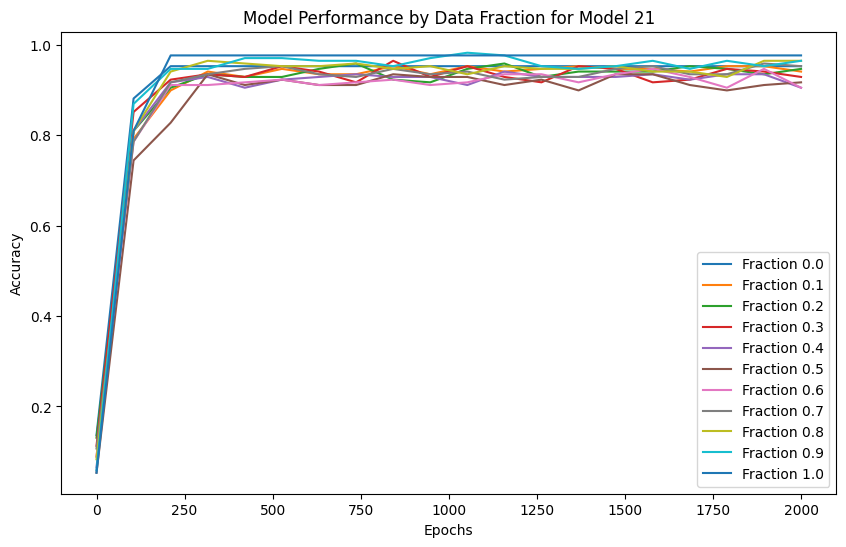

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2933
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.3462
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 0.6423
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.3231
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.2079
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.1606
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.1368
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.1232
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.1146
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.1090
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.1050
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.1021
predi

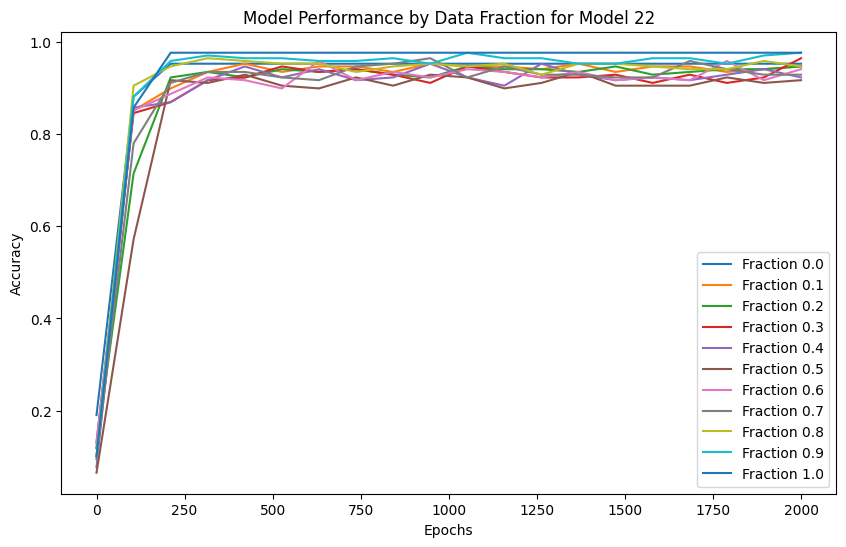

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2900
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.3236
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 0.6616
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.3420
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.2155
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.1635
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.1381
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.1239
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.1151
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.1093
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.1053
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.1024
predi

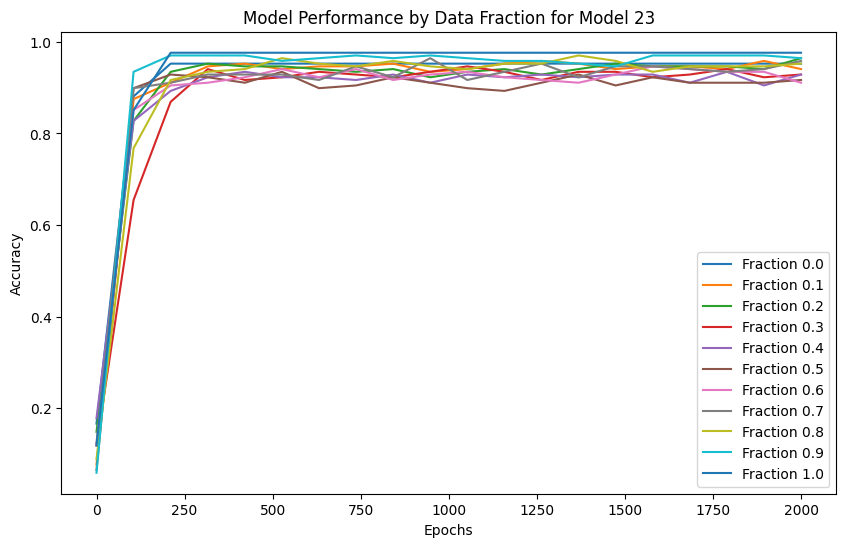

Model 24, Fraction 0.00, Epoch 1, Loss: 2.3172
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.4095
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 0.7120
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.3516
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.2214
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.1676
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.1410
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.1260
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.1167
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.1105
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.1062
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.1030
predi

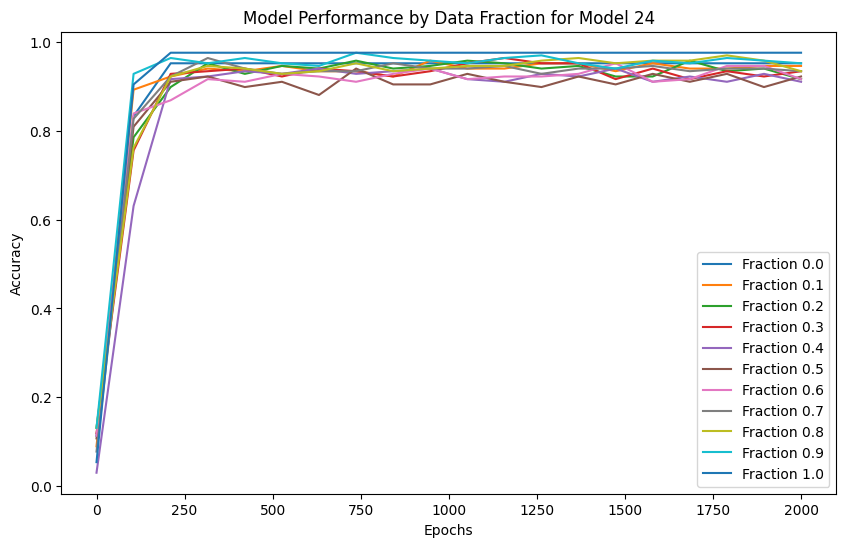

Model 25, Fraction 0.00, Epoch 1, Loss: 2.3108
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.3913
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 0.6732
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.3413
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.2125
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.1615
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.1368
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.1231
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.1145
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.1089
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.1050
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.1021
predi

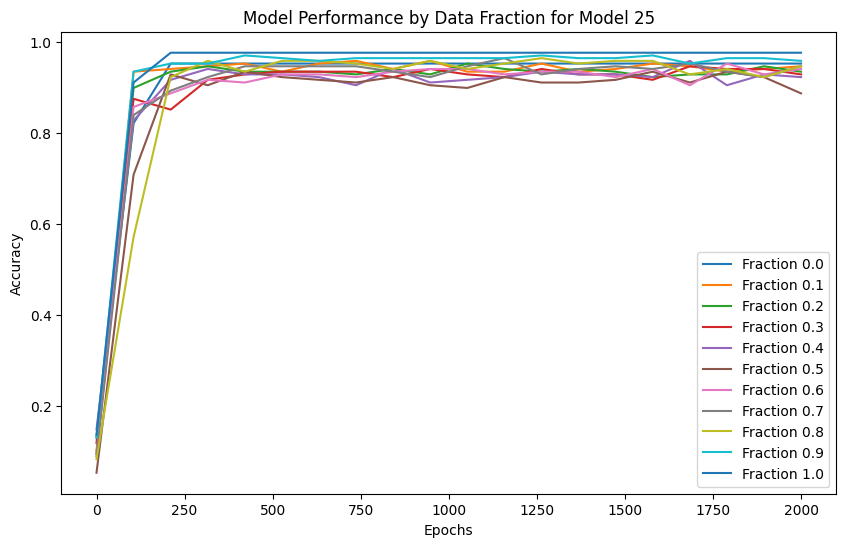

Model 26, Fraction 0.00, Epoch 1, Loss: 2.3155
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.4418
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 0.7280
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.4096
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.2668
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.1809
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.1442
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.1259
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.1155
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.1090
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.1047
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.1018
predi

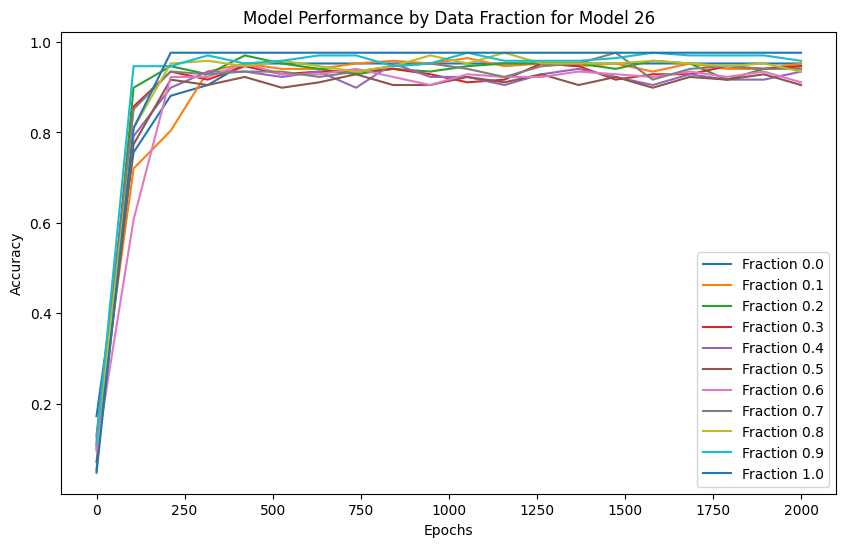

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2972
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.3915
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 0.6756
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.3514
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.2201
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.1662
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.1397
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.1247
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.1155
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.1095
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.1054
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.1024
predi

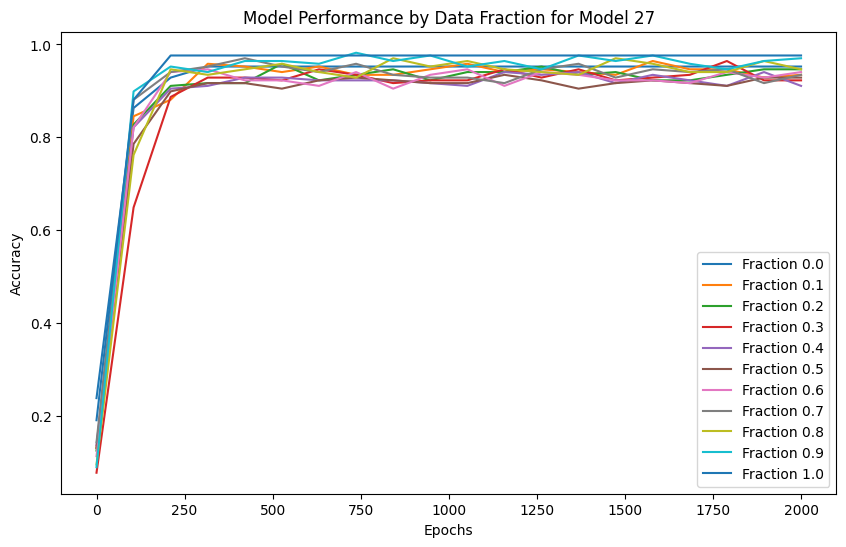

Model 28, Fraction 0.00, Epoch 1, Loss: 2.3057
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.3807
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 0.6234
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.3189
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.2099
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.1634
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.1396
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.1256
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.1164
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.1103
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.1062
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.1031
predi

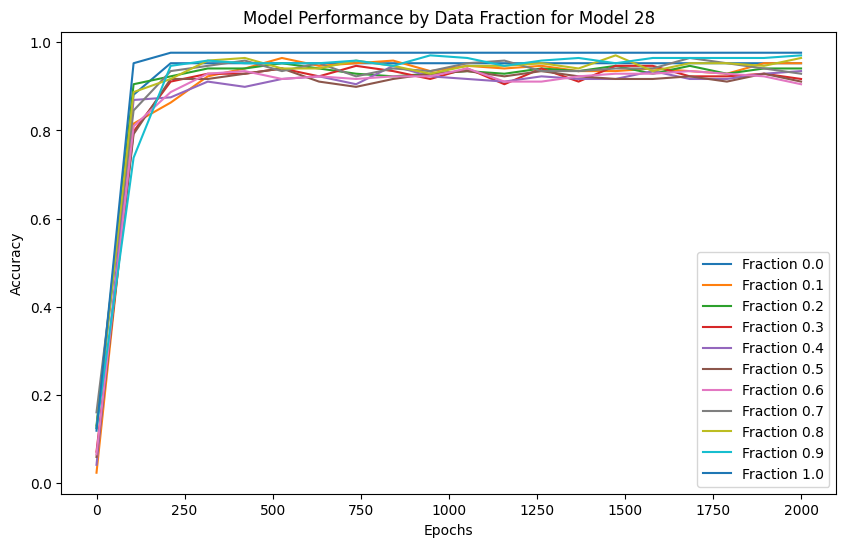

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2884
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.3672
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 0.7076
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.3728
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.2283
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.1698
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.1414
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.1255
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.1158
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.1095
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.1052
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.1022
predi

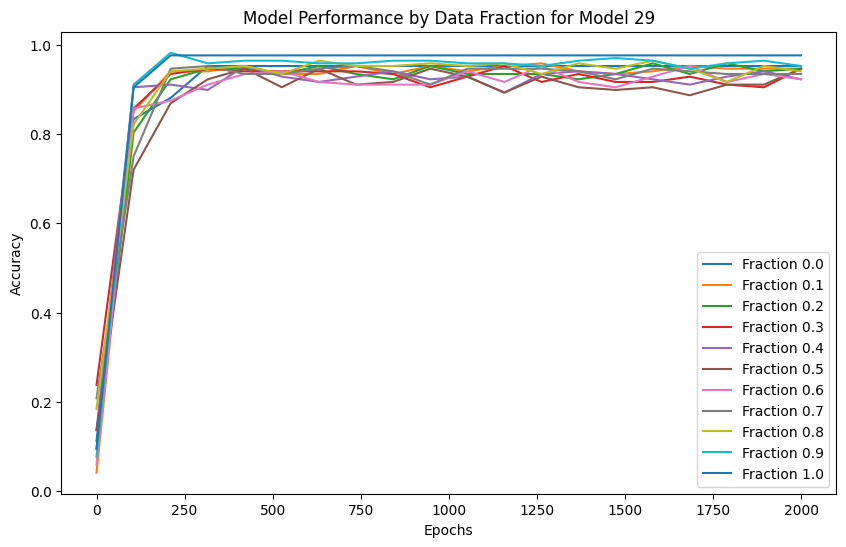

In [214]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 10
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB",
    "ABCDEFGHIEABCDEFGHIEABCDEFGHIEABCDEFGHIEAB"
    
])  #igh contradiction contradiction 24  and overlap 54  

for model_idx in range(num_models):
    model_dir = f"Songs_GHI_contradiction/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [275]:
import os
import numpy as np
import torch

# Initialize the model parameters (keep these consistent with training)
ntokens = 10
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_GHI_contradiction"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB",
    "ABCDEFGHIEABCDEFGHIEABCDEFGHIEABCDEFGHIEAB"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.7867
  Fraction 0.10, Average Accuracy: 0.8706
  Fraction 0.20, Average Accuracy: 0.8770
  Fraction 0.30, Average Accuracy: 0.8786
  Fraction 0.40, Average Accuracy: 0.8794
  Fraction 0.50, Average Accuracy: 0.9183
  Fraction 0.60, Average Accuracy: 0.9730
  Fraction 0.70, Average Accuracy: 0.9762
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9524
  Fraction 0.10, Average Accuracy: 0.9524
  Fraction 0.20, Average Accuracy: 0.9524
  Fraction 0.30, Average Accuracy: 0.9524
  Fraction 0.40, Average Accuracy: 0.9516
  Fraction 0.50, Average Accuracy: 0.9151
  Fraction 0.60, Average Accuracy: 0.8603
  Fraction 0.70, Average Accuracy: 0.8571
  Fraction 0.80, Average Accuracy: 0.8571
  Fraction 0.90, Average Accuracy: 0.8571
  Fraction 1.00, Average Accuracy: 0.7849


#### plot for transformer

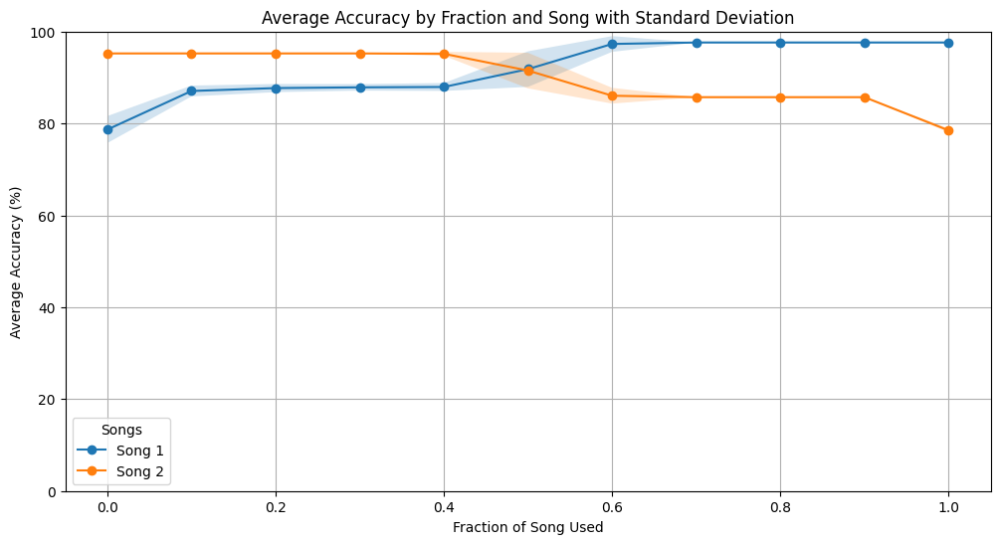

In [216]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot for decision tree

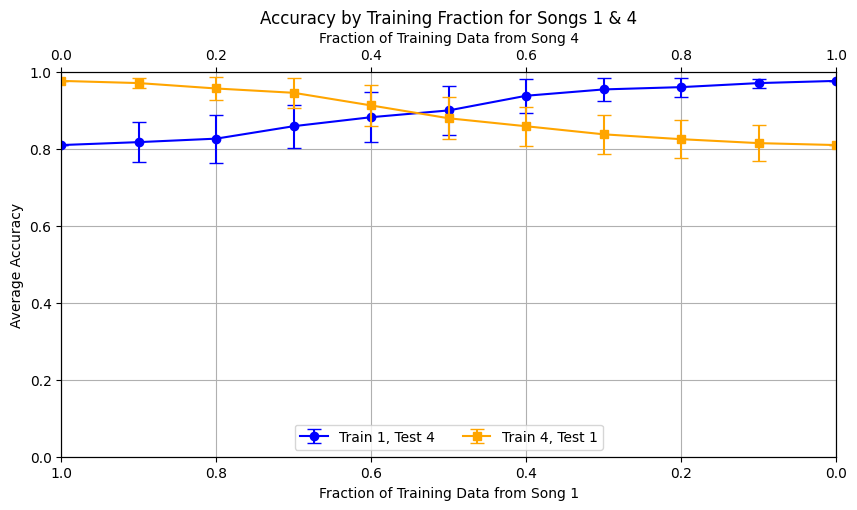

In [217]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 4), (4, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

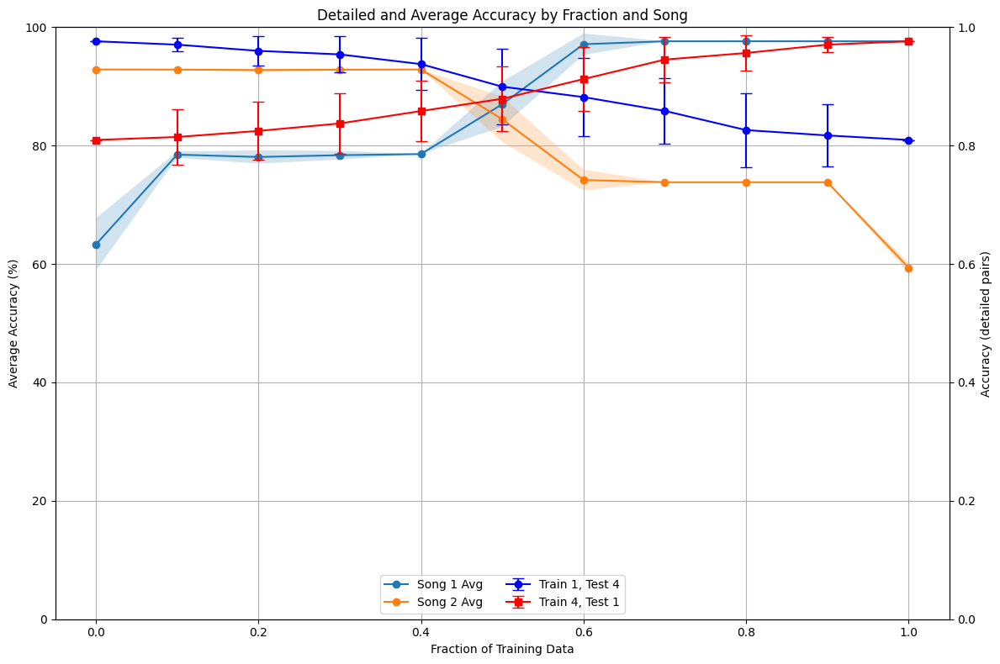

In [274]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 4), (4, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


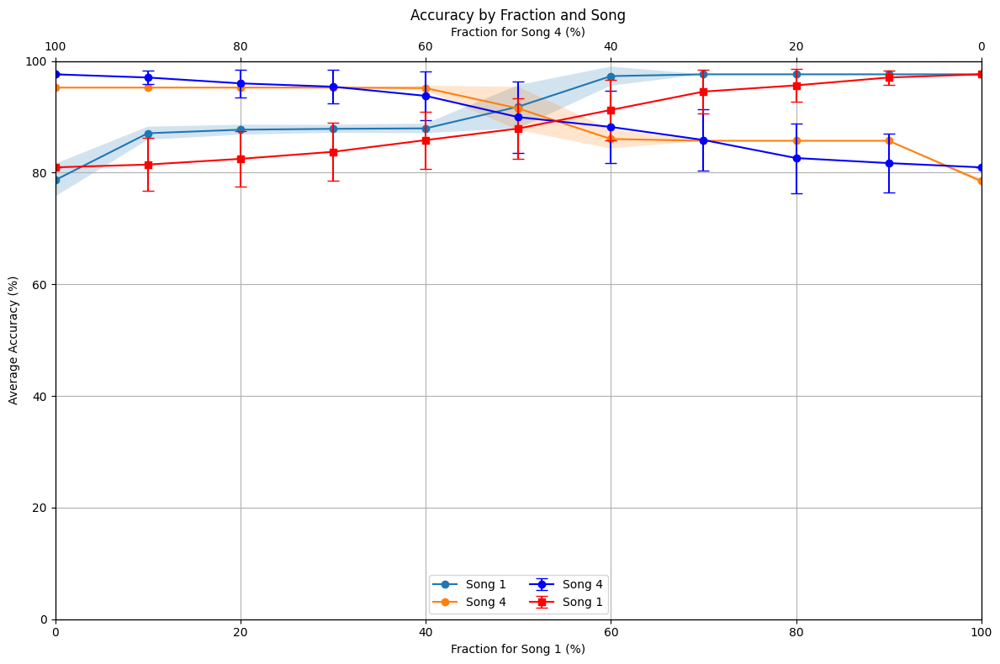

In [276]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 4), (4, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction for Song 4 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Extract lines and labels from the plots
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()

# Specify custom labels as required
custom_labels = ['Song 1', 'Song 4', 'Song 4', 'Song 1']

# Combine the lines and custom labels
combined_lines = lines + lines2

# Update the legend with custom labels
ax1.legend(combined_lines, custom_labels, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


### Normal and 5th note contradiction

#### Training

Model 0, Fraction 0.00, Epoch 1, Loss: 2.3279
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.5058
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.8444
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.4313
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.2650
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.2068
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.1831
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.1701
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.1625
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.1576
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.1542
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.1518
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.1500
prediction sha

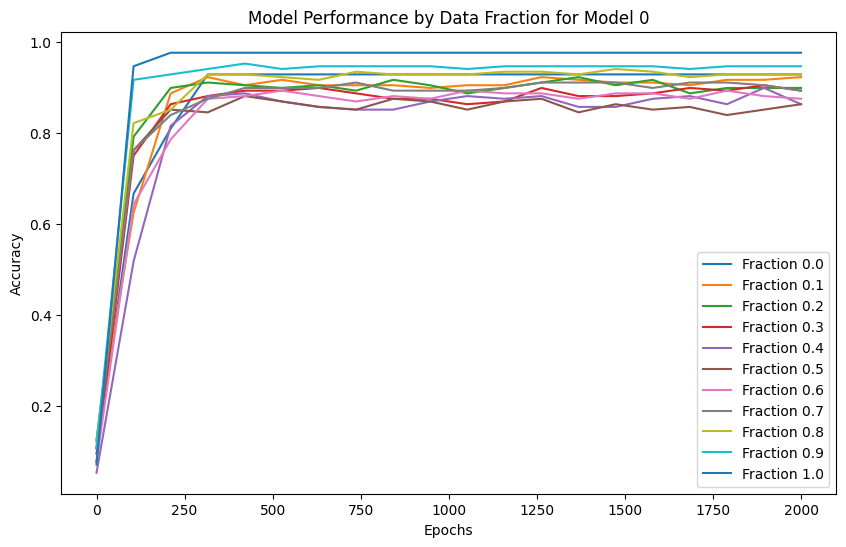

Model 1, Fraction 0.00, Epoch 1, Loss: 2.3461
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.4194
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.7270
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.3997
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.2523
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.2040
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.1821
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.1702
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.1628
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.1579
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.1546
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.1521
prediction shape 

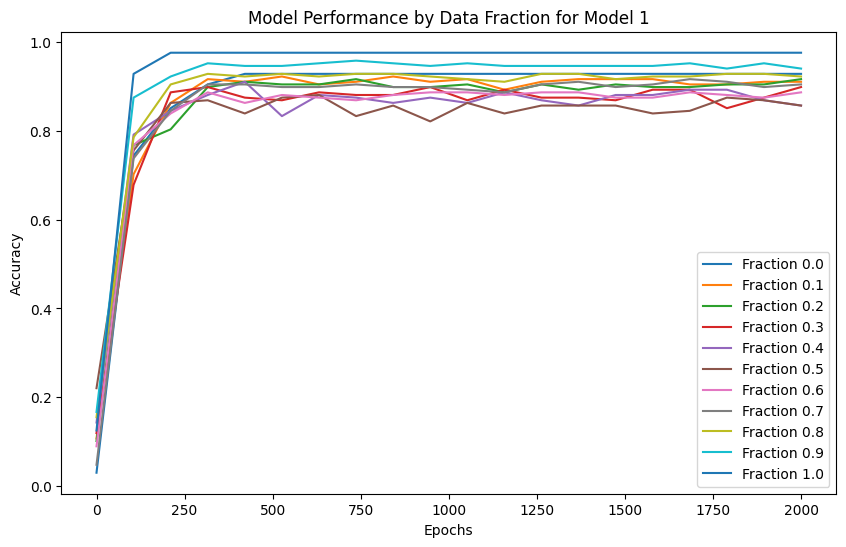

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2411
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.2968
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.6294
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.3641
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.2587
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.2184
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.1845
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.1718
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.1638
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.1584
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.1547
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.1522
prediction shape 

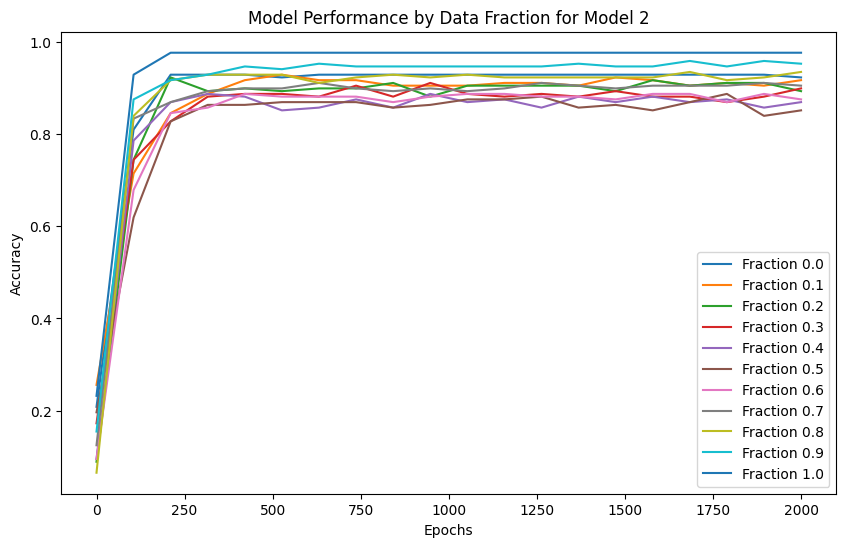

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2560
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.4511
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.7071
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.3517
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.2431
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.2018
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.1819
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.1703
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.1629
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.1581
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.1548
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.1521
prediction shape 

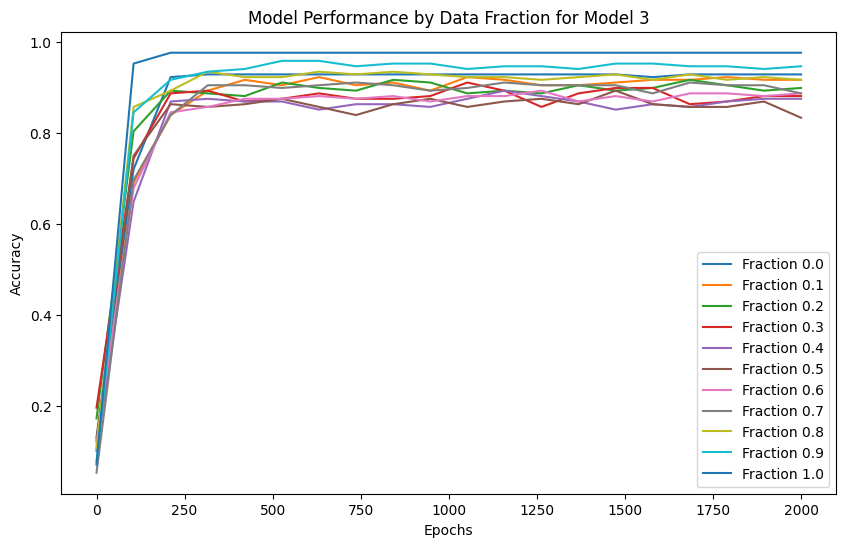

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2749
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.4409
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.6926
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.3751
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.2582
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.2091
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.1850
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.1716
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.1635
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.1582
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.1545
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.1520
prediction shape 

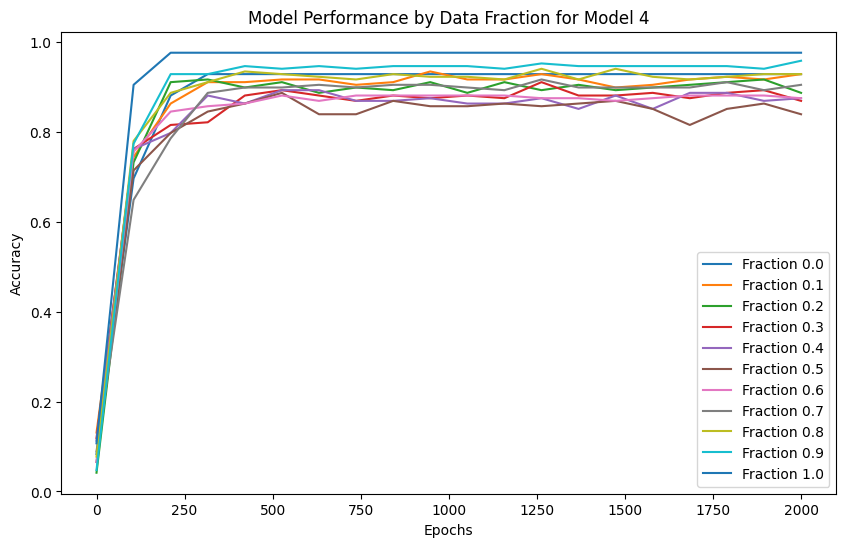

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2784
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.4038
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.6783
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.3738
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.2576
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.2101
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.1863
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.1731
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.1650
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.1596
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.1559
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.1532
prediction shape 

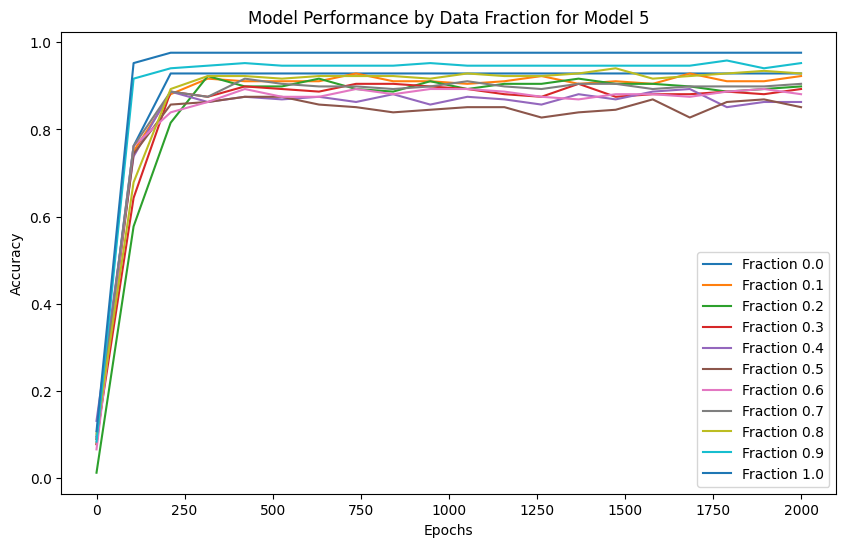

Model 6, Fraction 0.00, Epoch 1, Loss: 2.3180
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.4345
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.7427
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.4161
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.2638
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.2072
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.1833
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.1706
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.1630
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.1581
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.1546
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.1522
prediction shape 

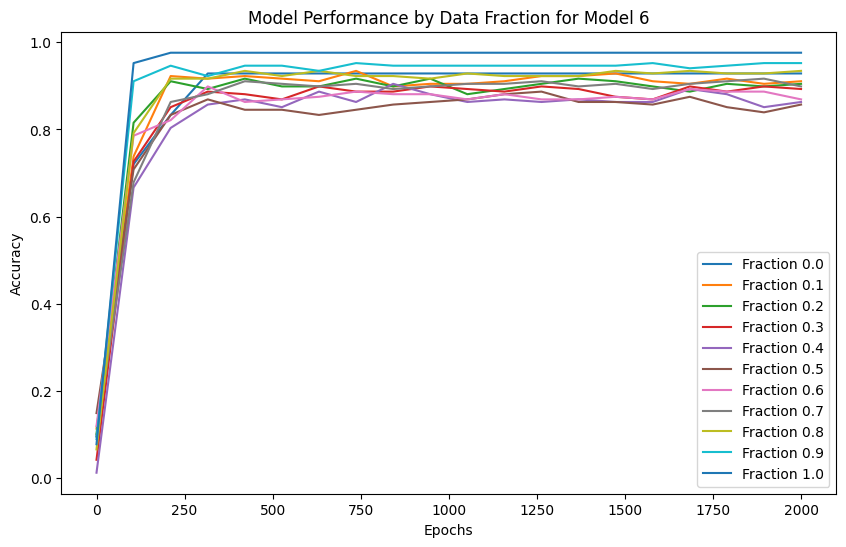

Model 7, Fraction 0.00, Epoch 1, Loss: 2.3055
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.4079
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.6805
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.3555
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.2417
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.1992
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.1792
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.1682
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.1614
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.1569
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.1538
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.1515
prediction shape 

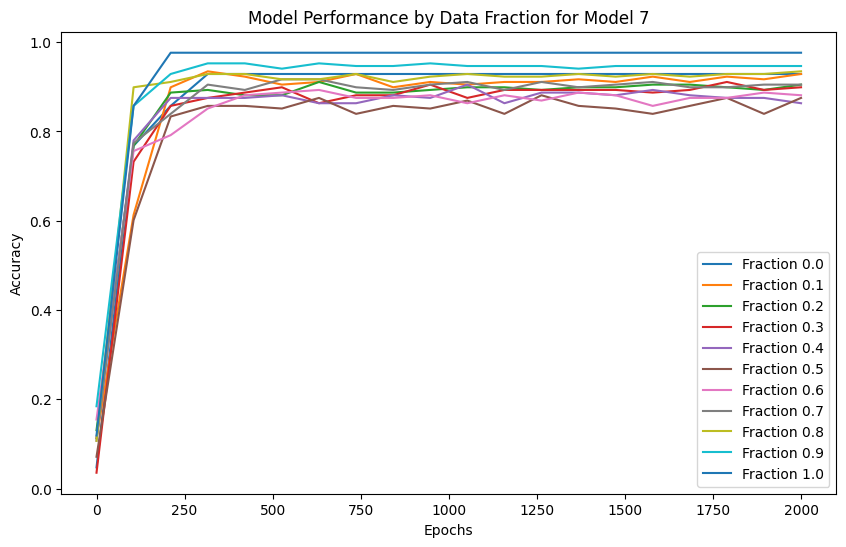

Model 8, Fraction 0.00, Epoch 1, Loss: 2.3079
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.4511
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.6869
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.3576
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.2475
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.2038
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.1823
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.1702
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.1628
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.1579
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.1545
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.1520
prediction shape 

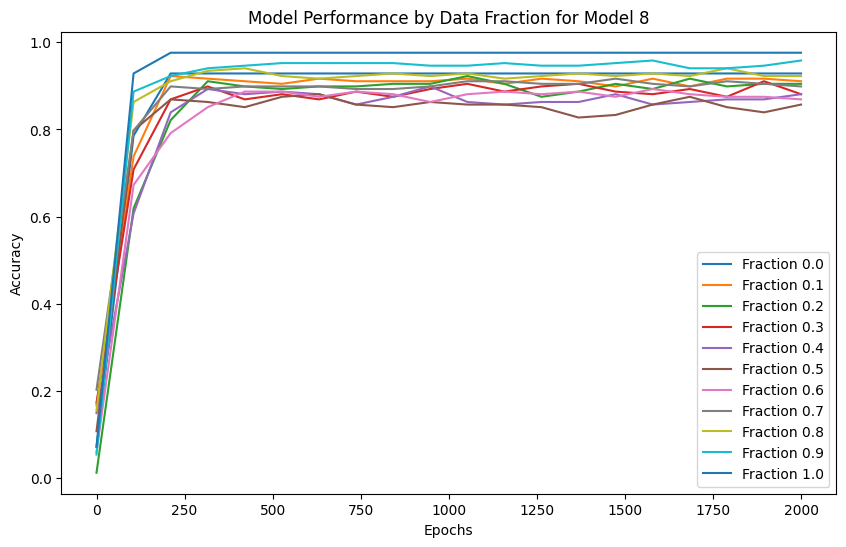

Model 9, Fraction 0.00, Epoch 1, Loss: 2.3647
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.4663
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.7607
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.3983
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.2698
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.2167
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.1913
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.1765
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.1680
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.1613
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.1570
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.1540
prediction shape 

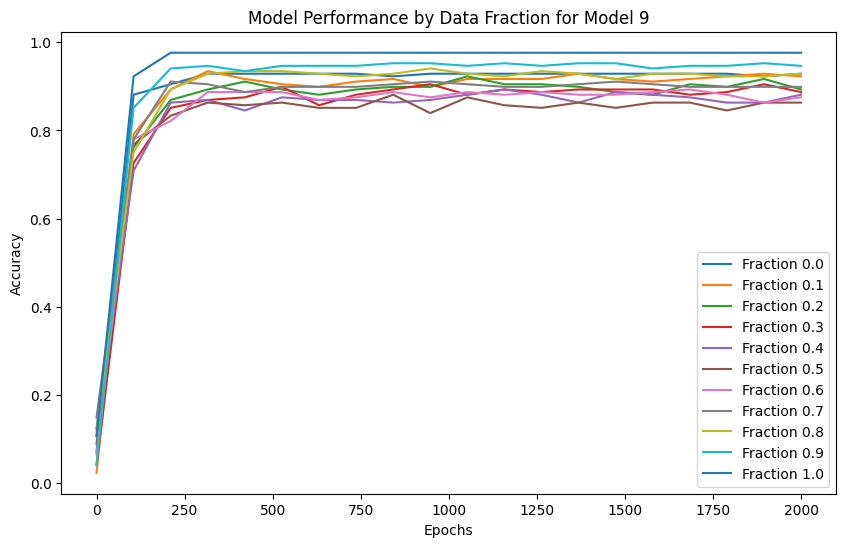

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2489
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.3943
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 0.7281
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.4280
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.2814
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.2141
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.1864
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.1716
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.1634
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.1580
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.1544
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.1518
predi

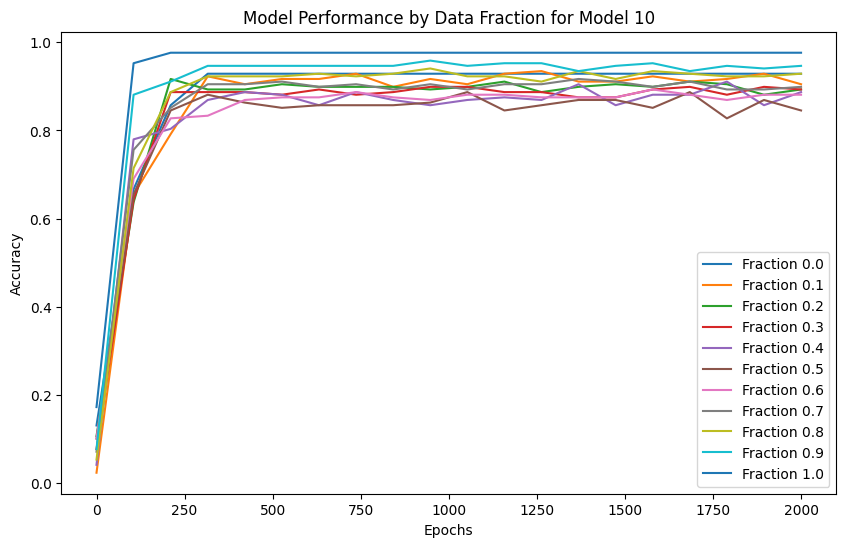

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2771
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.4306
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 0.6929
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.3626
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.2489
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.2037
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.1817
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.1696
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.1622
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.1574
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.1541
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.1517
predi

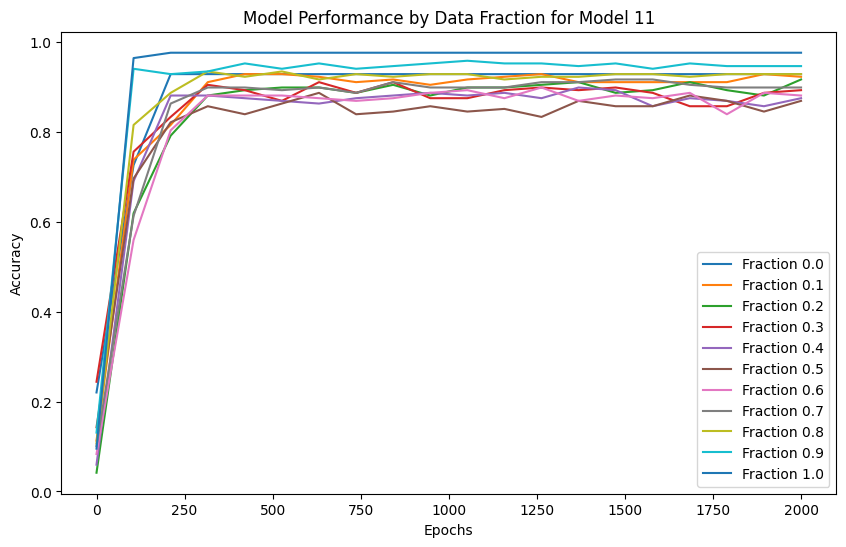

Model 12, Fraction 0.00, Epoch 1, Loss: 2.3298
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.4572
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 0.6901
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.3627
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.2508
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.2051
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.1825
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.1702
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.1625
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.1575
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.1547
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.1517
predi

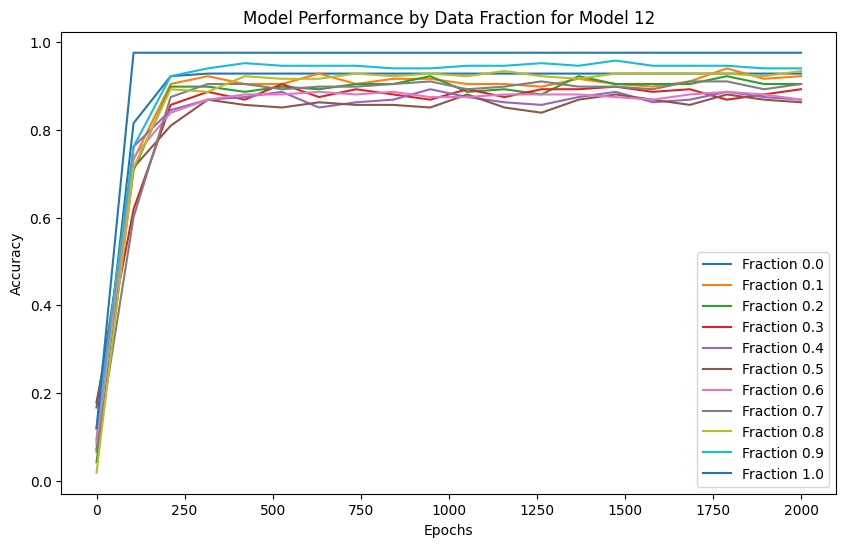

Model 13, Fraction 0.00, Epoch 1, Loss: 2.3319
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.3887
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 0.6672
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.3567
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.2526
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.2089
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.1866
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.1737
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.1656
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.1601
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.1563
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.1535
predi

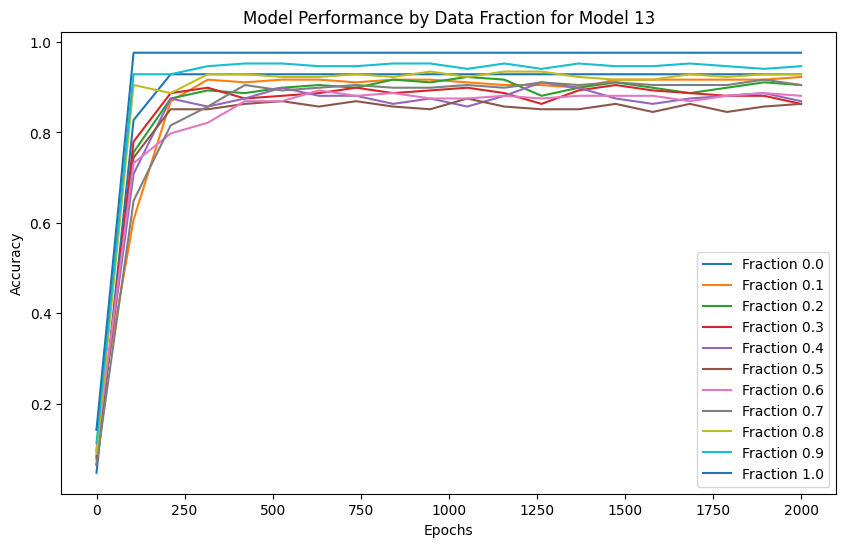

Model 14, Fraction 0.00, Epoch 1, Loss: 2.3518
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.4675
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 0.7386
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.3940
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.2601
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.2083
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.1841
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.1710
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.1632
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.1580
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.1545
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.1520
predi

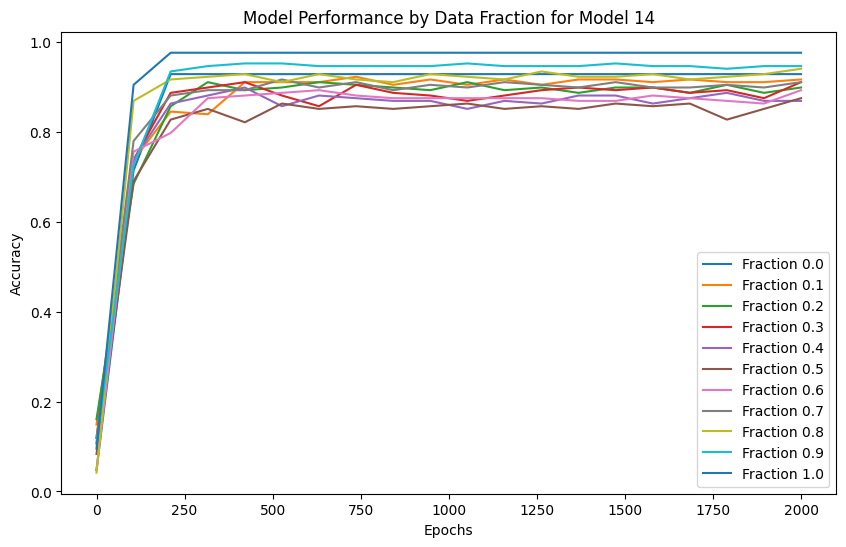

Model 15, Fraction 0.00, Epoch 1, Loss: 2.3006
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.3451
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 0.6880
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.3699
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.2576
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.2115
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.1882
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.1748
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.1662
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.1605
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.1564
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.1536
predi

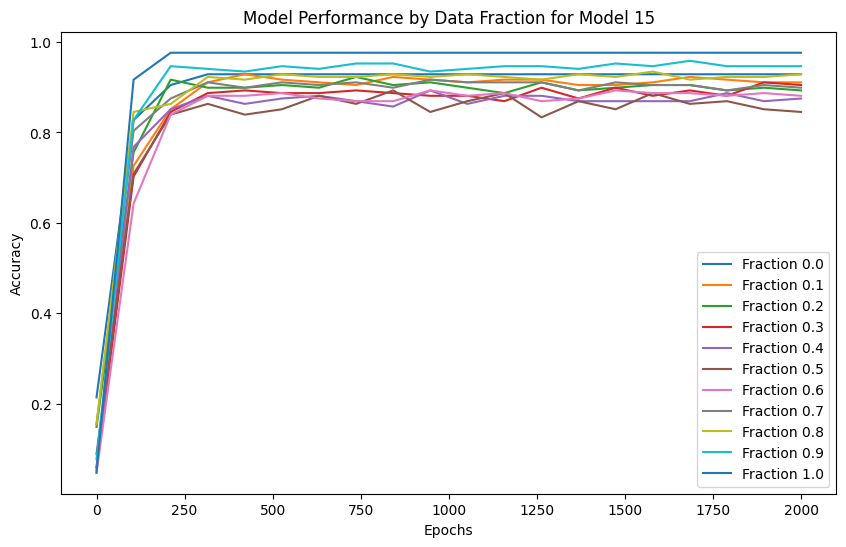

Model 16, Fraction 0.00, Epoch 1, Loss: 2.3337
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.4939
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 0.7025
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.3824
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.2580
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.2077
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.1844
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.1721
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.1640
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.1588
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.1553
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.1528
predi

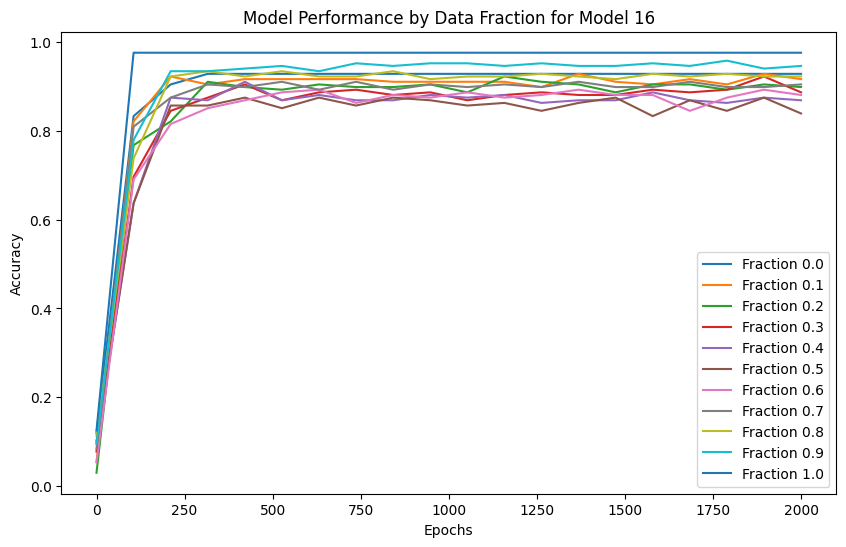

Model 17, Fraction 0.00, Epoch 1, Loss: 2.3186
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.4652
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 0.7095
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.3628
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.2439
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.2008
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.1805
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.1692
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.1621
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.1574
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.1542
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.1518
predi

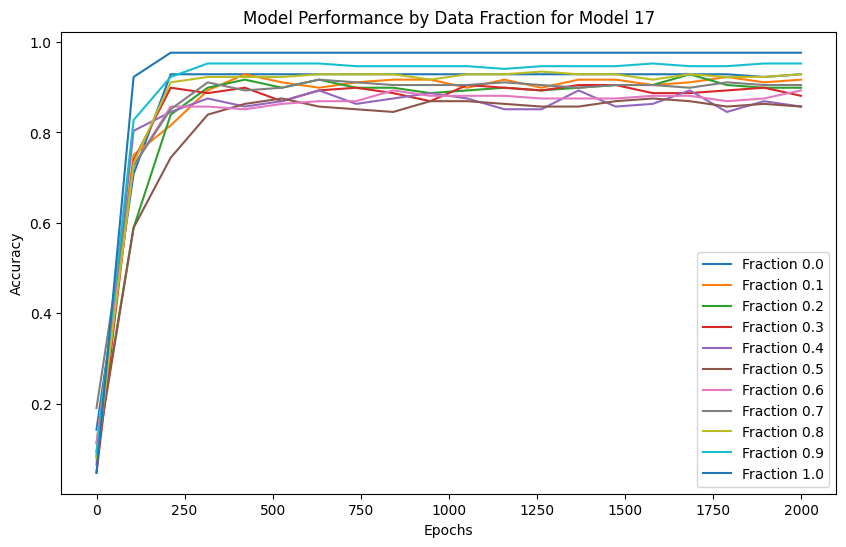

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2925
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.4790
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 0.7140
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.3910
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.2535
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.2037
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.1813
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.1692
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.1619
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.1577
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.1539
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.1515
predi

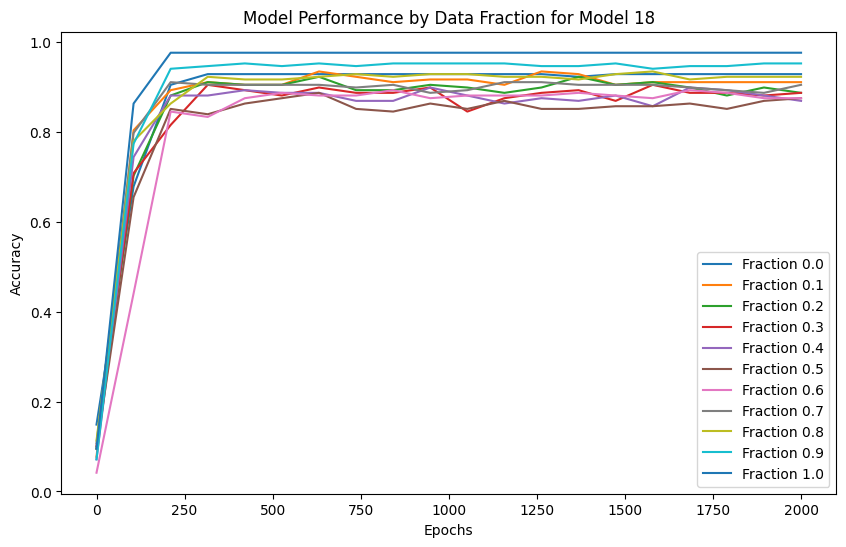

Model 19, Fraction 0.00, Epoch 1, Loss: 2.3011
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.3530
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 0.6659
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.3687
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.2524
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.2076
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.1853
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.1724
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.1645
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.1592
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.1556
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.1529
predi

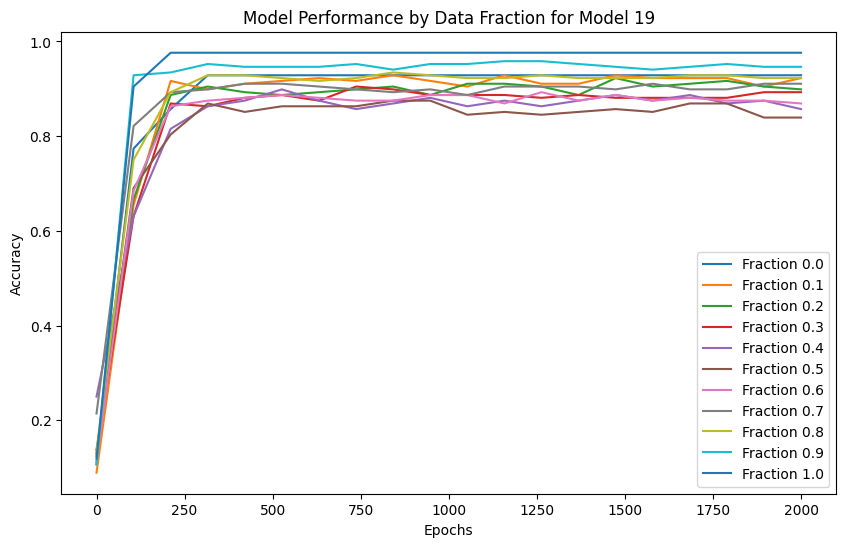

Model 20, Fraction 0.00, Epoch 1, Loss: 2.3686
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.4865
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 0.7511
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.3857
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.2574
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.2072
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.1836
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.1707
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.1645
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.1579
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.1544
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.1520
predi

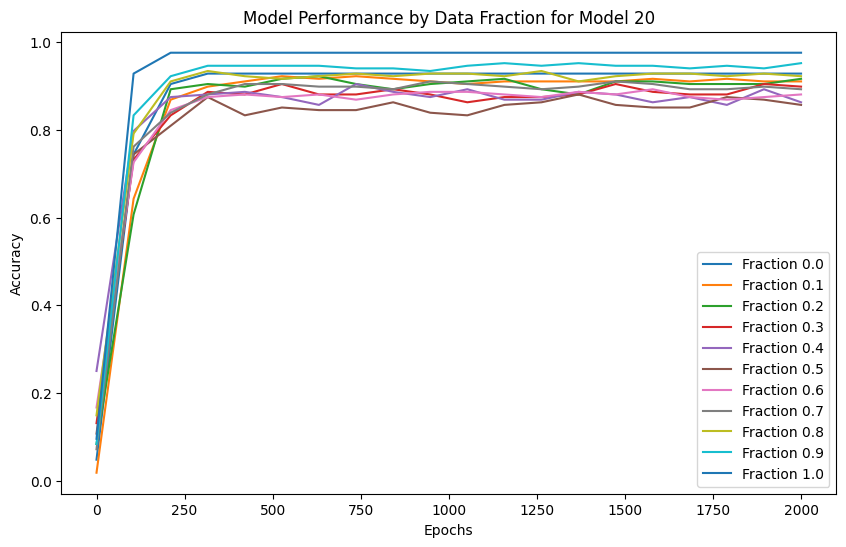

Model 21, Fraction 0.00, Epoch 1, Loss: 2.3364
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.3656
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 0.6769
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.3572
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.2515
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.2088
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.1858
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.1732
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.1652
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.1598
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.1559
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.1531
predi

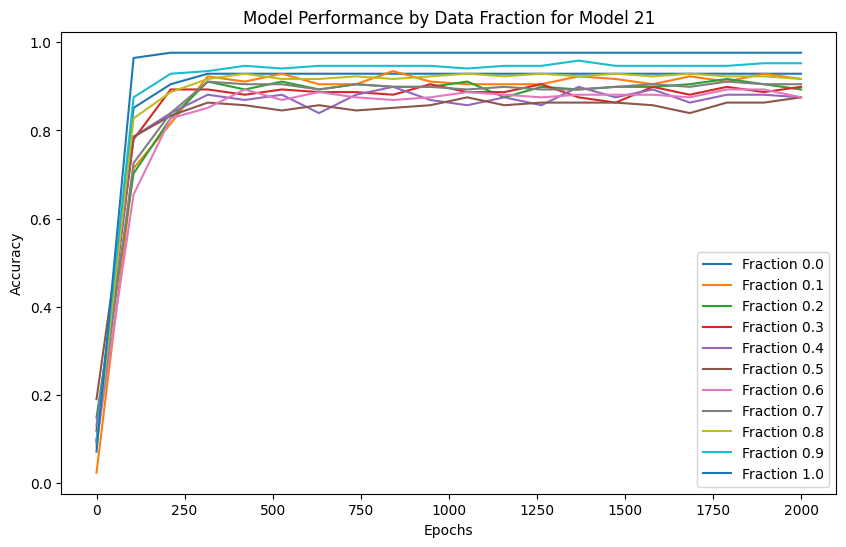

Model 22, Fraction 0.00, Epoch 1, Loss: 2.3030
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.4454
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 0.7117
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.4029
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.2658
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.2128
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.1879
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.1740
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.1655
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.1600
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.1562
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.1533
predi

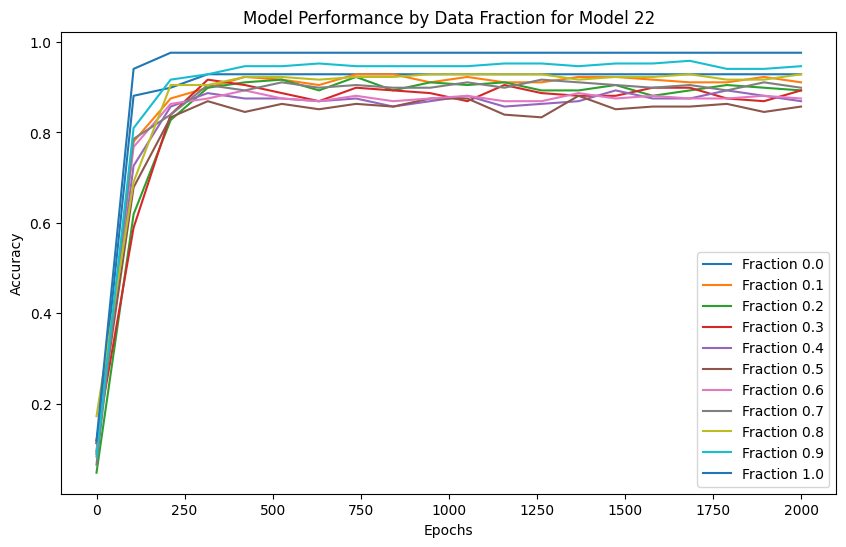

Model 23, Fraction 0.00, Epoch 1, Loss: 2.3519
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.4683
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 0.7437
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.3916
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.2527
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.2048
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.1830
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.1708
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.1633
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.1584
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.1553
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.1524
predi

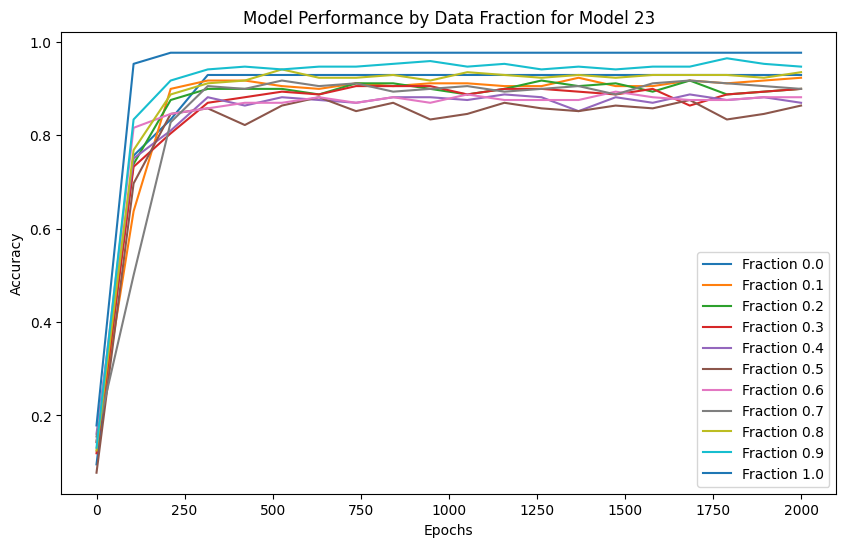

Model 24, Fraction 0.00, Epoch 1, Loss: 2.3664
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.4569
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 0.7992
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.3984
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.2551
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.2054
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.1826
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.1701
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.1626
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.1577
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.1543
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.1518
predi

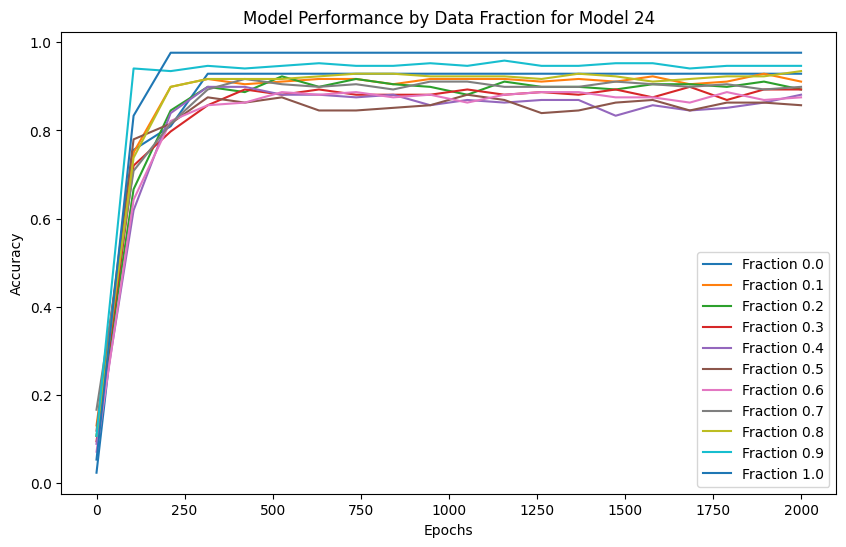

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2779
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.5160
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 0.7708
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.3937
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.2540
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.2048
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.1823
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.1700
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.1625
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.1577
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.1543
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.1518
predi

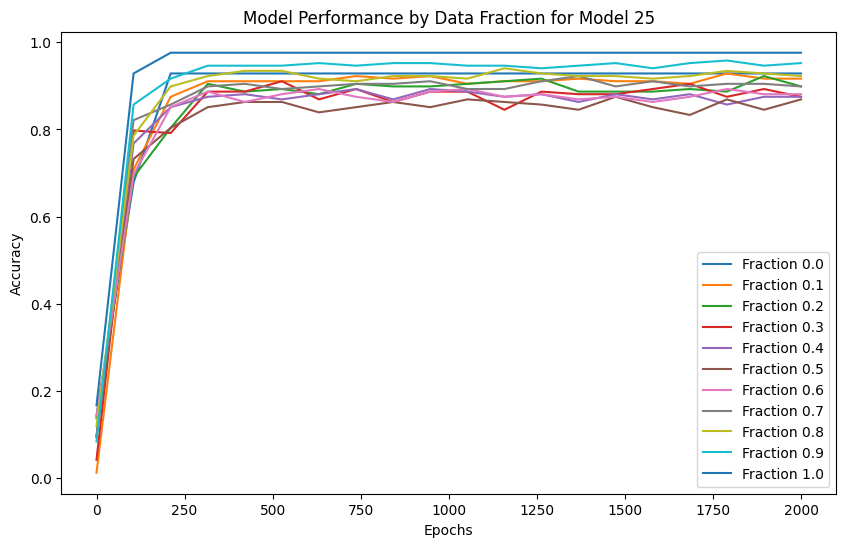

Model 26, Fraction 0.00, Epoch 1, Loss: 2.3313
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.4871
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 0.8374
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.4603
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.2966
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.2164
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.1863
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.1716
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.1632
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.1580
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.1544
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.1518
predi

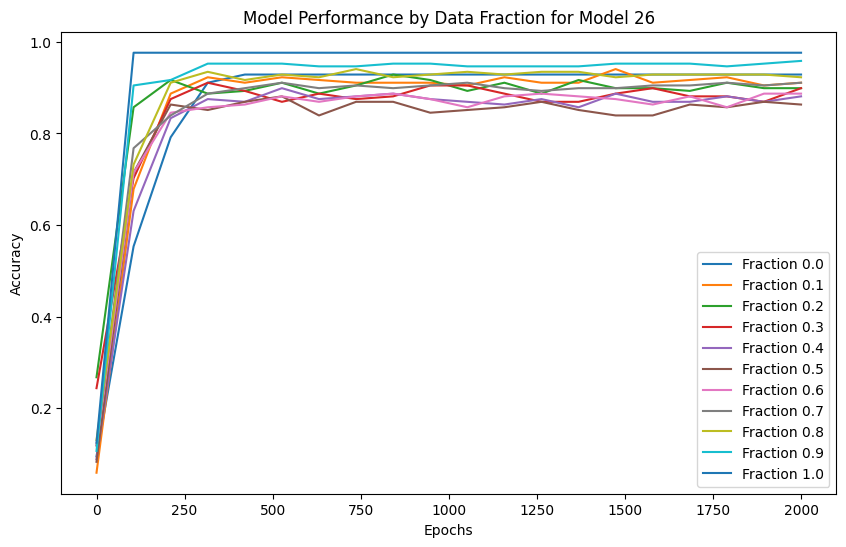

Model 27, Fraction 0.00, Epoch 1, Loss: 2.4077
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.5003
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 0.7059
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.3933
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.2725
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.2188
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.1917
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.1764
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.1669
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.1608
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.1567
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.1535
predi

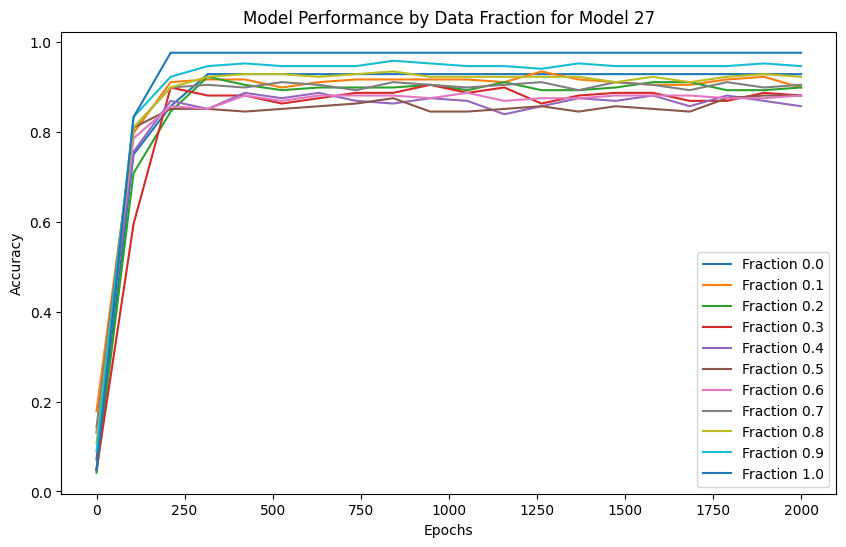

Model 28, Fraction 0.00, Epoch 1, Loss: 2.3077
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.4385
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 0.7182
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.3731
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.2527
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.2066
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.1847
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.1718
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.1639
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.1587
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.1551
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.1525
predi

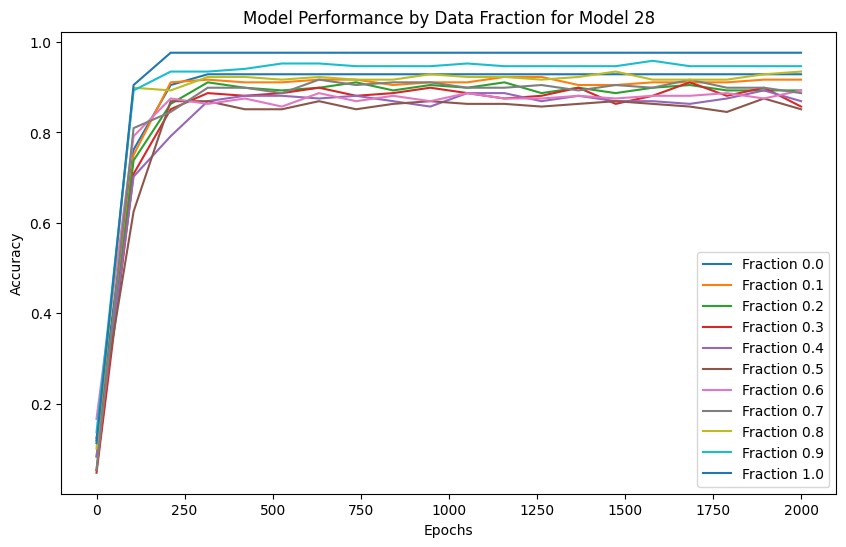

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2990
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.3865
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 0.6745
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.3711
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.2596
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.2121
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.1879
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.1741
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.1658
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.1603
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.1561
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.1533
predi

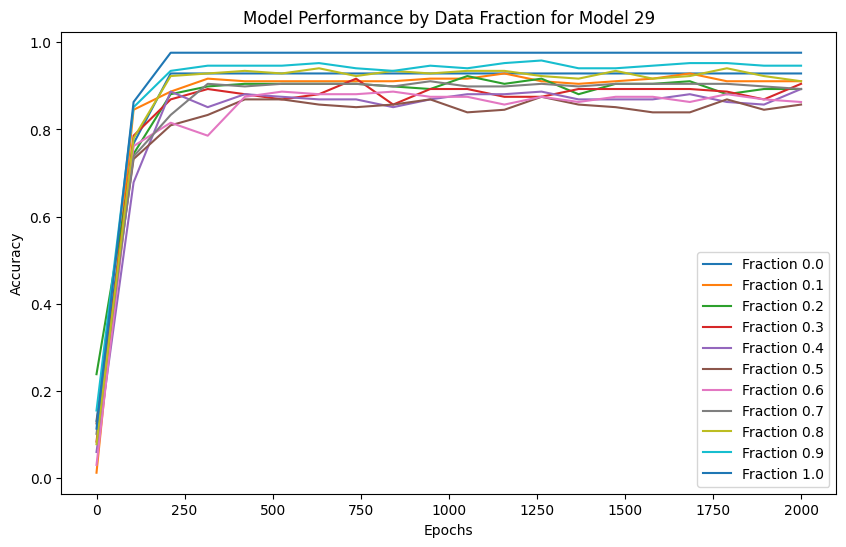

In [220]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 10
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB",
    "ABCDAFGHIAABCDAFGHIAABCDAFGHIAABCDAFGHIAAB"
])

for model_idx in range(num_models):
    model_dir = f"Songs_A_note_contradiction/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [277]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 10
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_A_note_contradiction"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB",
    "ABCDAFGHIAABCDAFGHIAABCDAFGHIAABCDAFGHIAAB"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.6329
  Fraction 0.10, Average Accuracy: 0.7847
  Fraction 0.20, Average Accuracy: 0.7808
  Fraction 0.30, Average Accuracy: 0.7837
  Fraction 0.40, Average Accuracy: 0.7857
  Fraction 0.50, Average Accuracy: 0.8698
  Fraction 0.60, Average Accuracy: 0.9712
  Fraction 0.70, Average Accuracy: 0.9762
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9286
  Fraction 0.10, Average Accuracy: 0.9284
  Fraction 0.20, Average Accuracy: 0.9276
  Fraction 0.30, Average Accuracy: 0.9282
  Fraction 0.40, Average Accuracy: 0.9286
  Fraction 0.50, Average Accuracy: 0.8444
  Fraction 0.60, Average Accuracy: 0.7419
  Fraction 0.70, Average Accuracy: 0.7381
  Fraction 0.80, Average Accuracy: 0.7381
  Fraction 0.90, Average Accuracy: 0.7381
  Fraction 1.00, Average Accuracy: 0.5937


#### plot for transformers

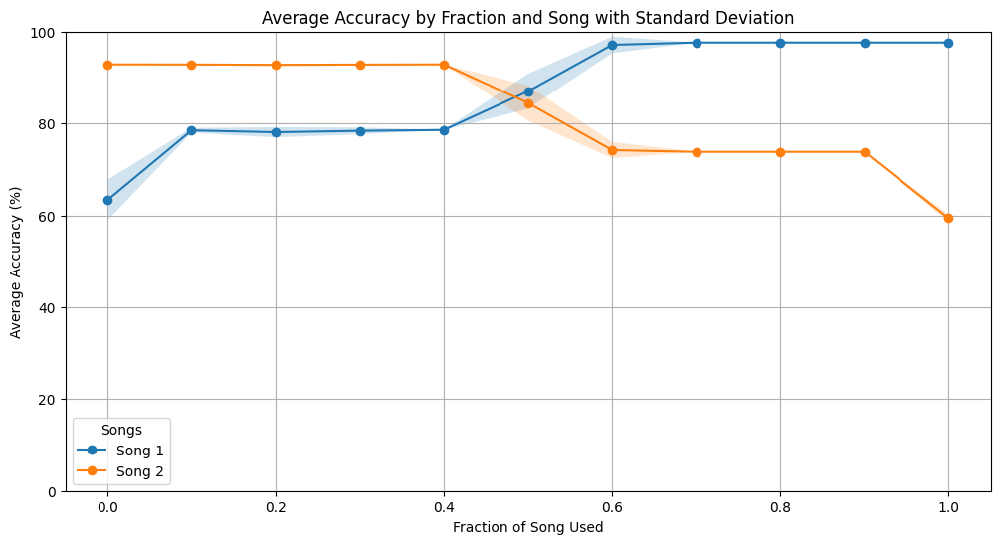

In [222]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot of decision tree

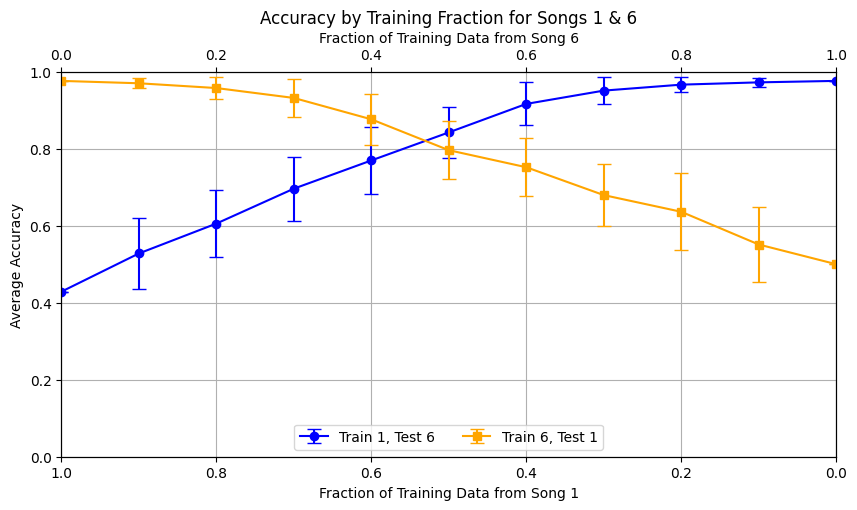

In [223]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 6), (6, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### Combined plot

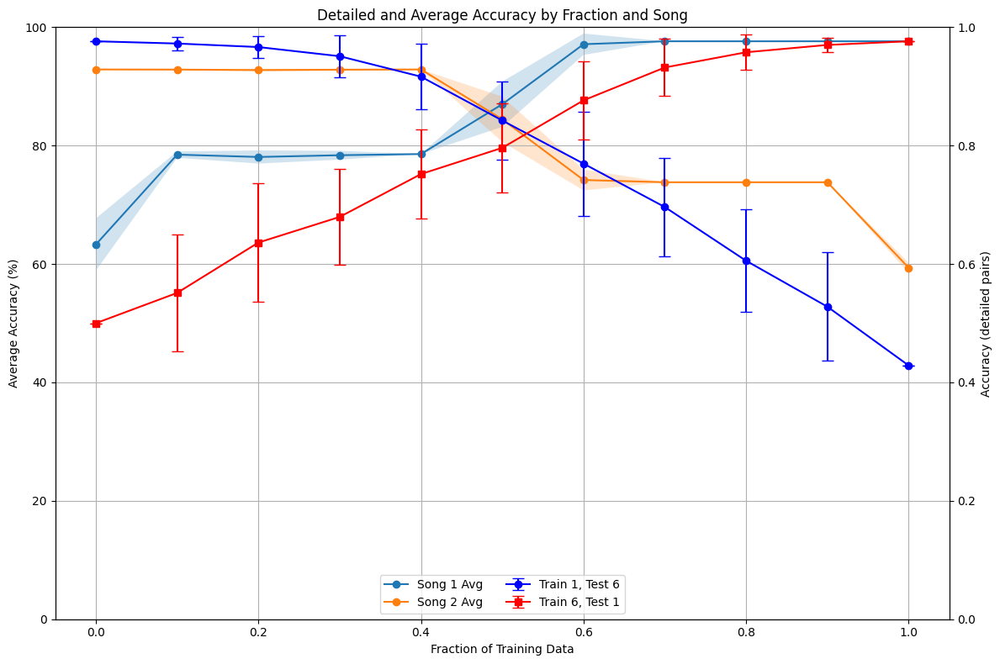

In [224]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 6), (6, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


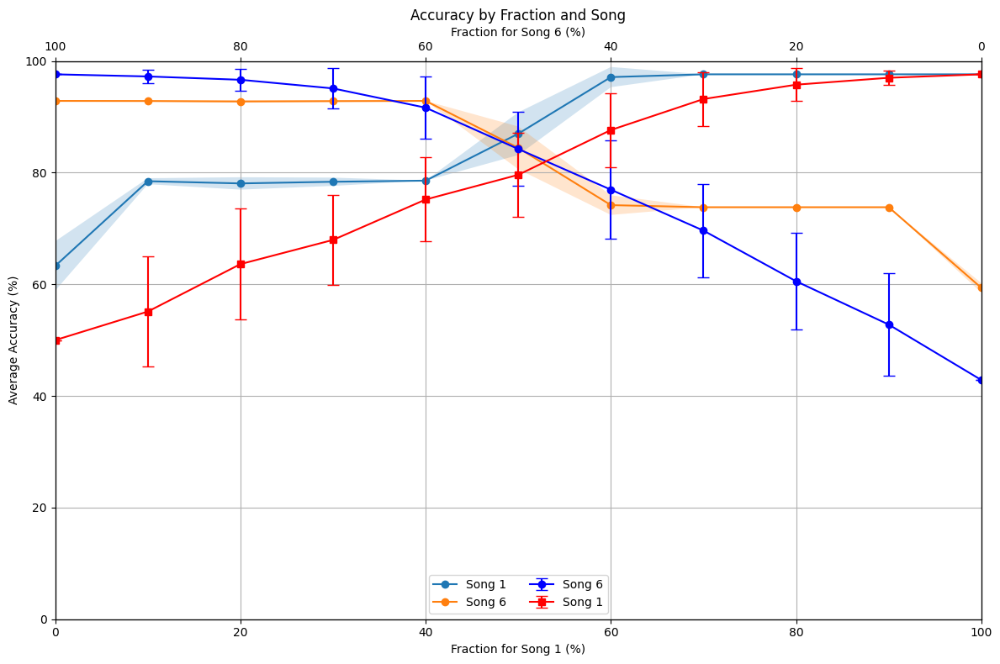

In [278]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 6), (6, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction for Song 6 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Extract lines and labels from the plots
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()

# Specify custom labels as required
custom_labels = ['Song 1', 'Song 6', 'Song 6', 'Song 1']

# Combine the lines and custom labels
combined_lines = lines + lines2

# Update the legend with custom labels
ax1.legend(combined_lines, custom_labels, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


## Training and Testing for Songs GHI contradiction with lower parameter

Model 0, Fraction 0.00, Epoch 1, Loss: 2.2073
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_92964/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.9102
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.4180
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 1.0749
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.8197
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.6055
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4214
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.2938
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.2116
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.1642
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.1364
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.1186
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.1065
prediction sha

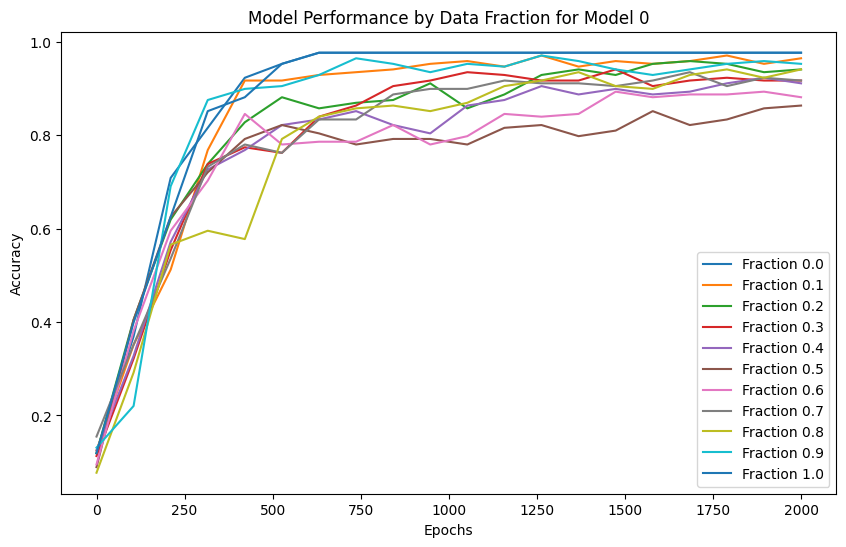

Model 1, Fraction 0.00, Epoch 1, Loss: 2.1938
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.8502
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.5281
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 1.1979
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.9279
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.6231
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.4248
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.3124
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.2408
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.1929
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.1597
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.1363
prediction shape 

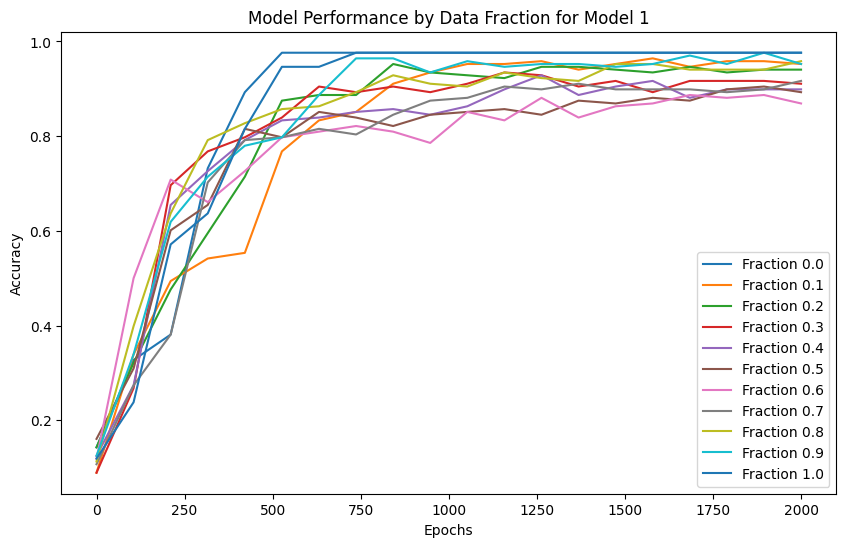

Model 2, Fraction 0.00, Epoch 1, Loss: 2.2042
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.8843
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.4602
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 1.1362
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.8666
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.6545
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.4495
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.2933
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.2159
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.1712
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.1439
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.1251
prediction shape 

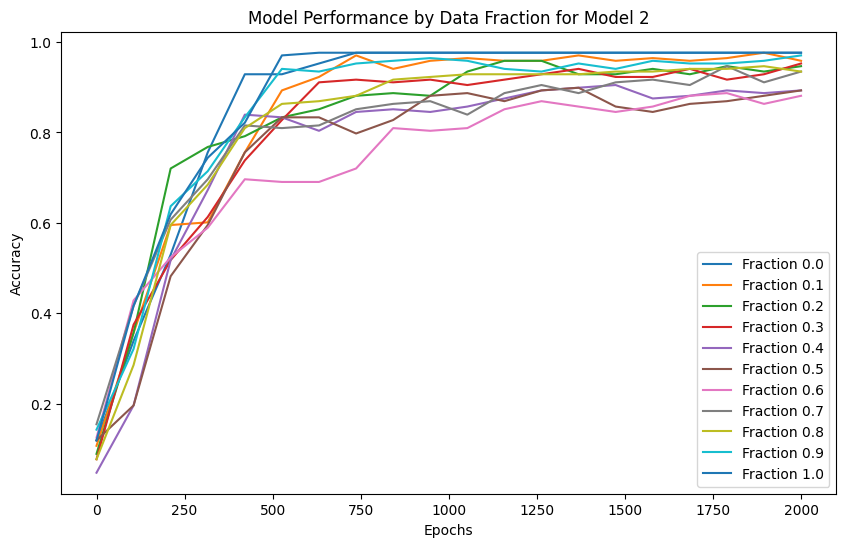

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2212
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.8959
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.4684
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 1.1700
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.9417
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.7782
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.6212
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.4029
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.2468
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.1829
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.1486
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.1275
prediction shape 

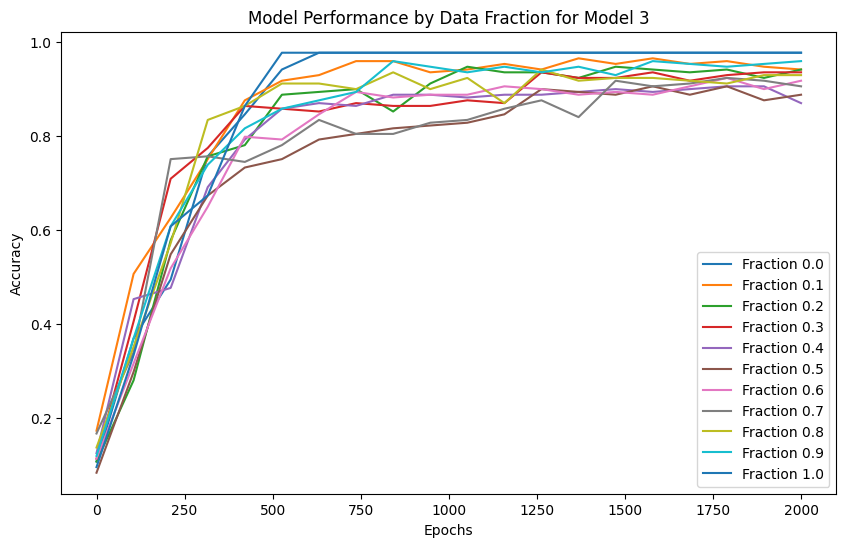

Model 4, Fraction 0.00, Epoch 1, Loss: 2.1988
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.8893
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.3736
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 1.0954
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.8227
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.5668
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.3935
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.2724
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.2081
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.1693
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.1437
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.1257
prediction shape 

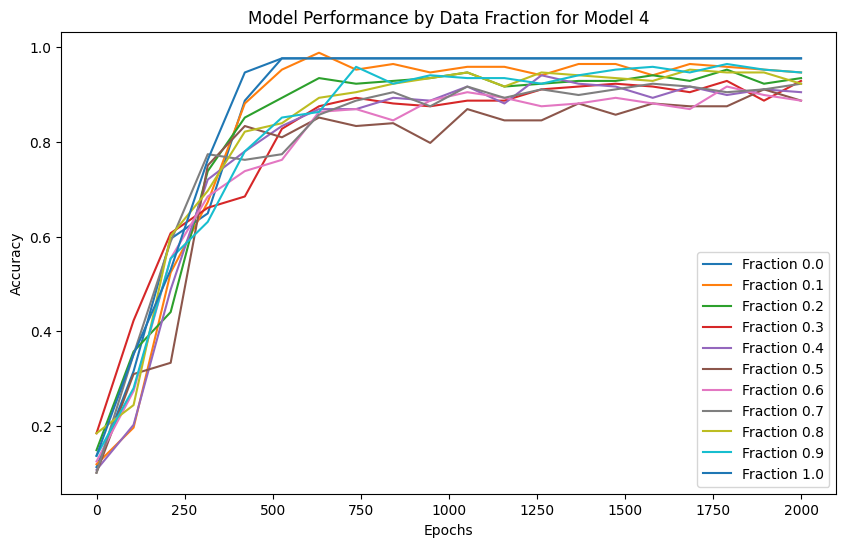

Model 5, Fraction 0.00, Epoch 1, Loss: 2.1987
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.8926
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.4128
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 1.1612
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.9770
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.7781
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.5697
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.4153
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.3242
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.2676
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.2281
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.1980
prediction shape 

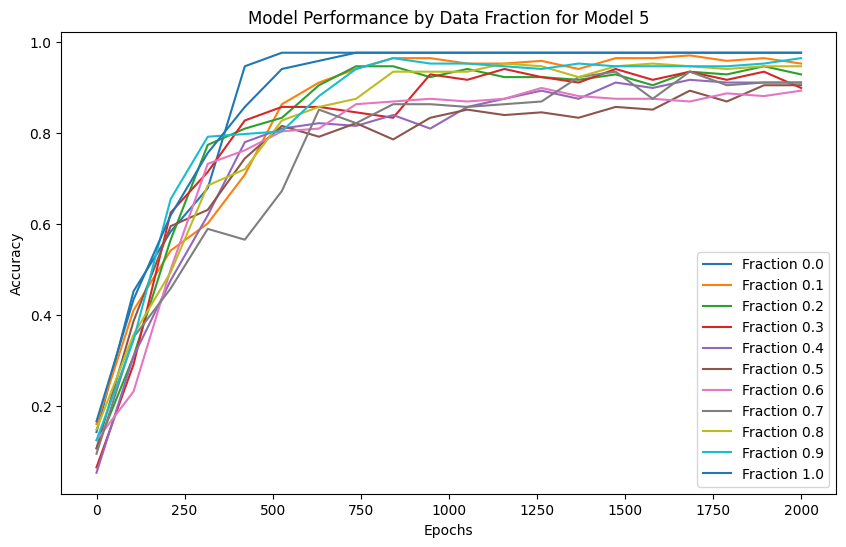

Model 6, Fraction 0.00, Epoch 1, Loss: 2.1995
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.8526
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.3422
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.9835
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.7248
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.5812
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4755
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.3647
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.2737
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.2131
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.1724
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.1462
prediction shape 

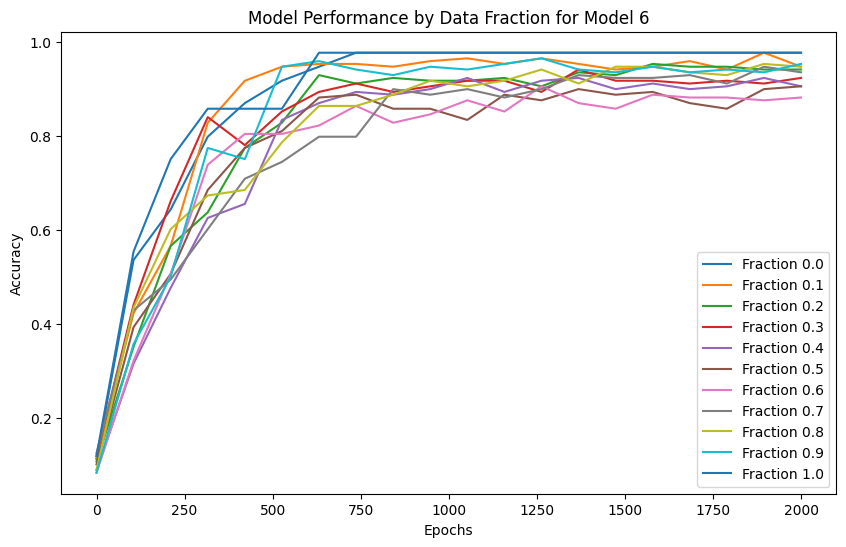

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2048
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.8853
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.3327
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 1.0241
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.8146
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.6149
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.4578
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.3648
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.2961
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.2215
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.1615
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.1318
prediction shape 

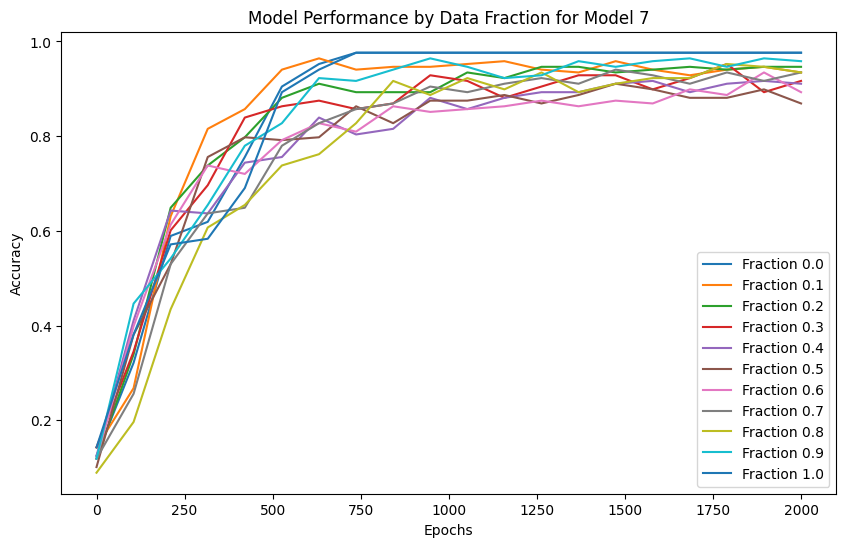

Model 8, Fraction 0.00, Epoch 1, Loss: 2.2151
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.9207
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.3742
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 1.0418
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.7071
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.4887
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.3708
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.2940
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.2234
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.1749
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.1465
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.1275
prediction shape 

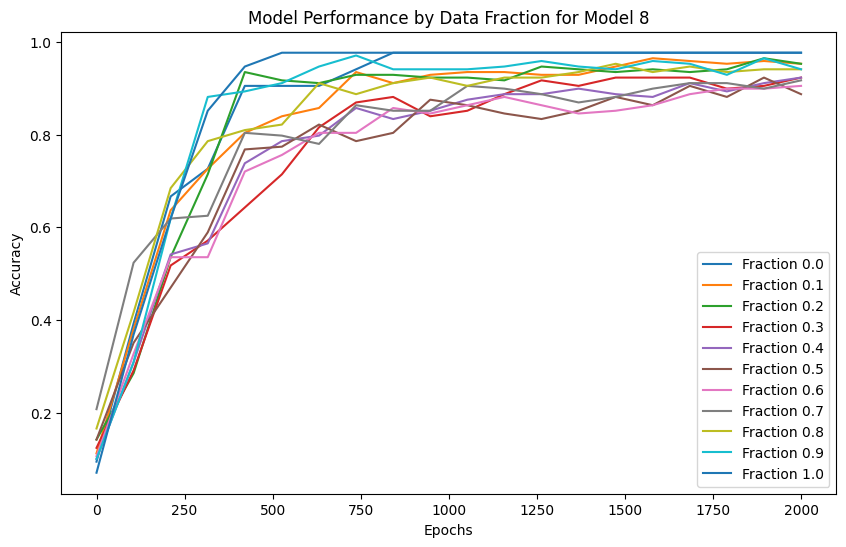

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2014
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.8676
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.4957
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 1.1451
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.7926
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.5397
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.3591
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.2554
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.1953
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.1580
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.1346
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.1186
prediction shape 

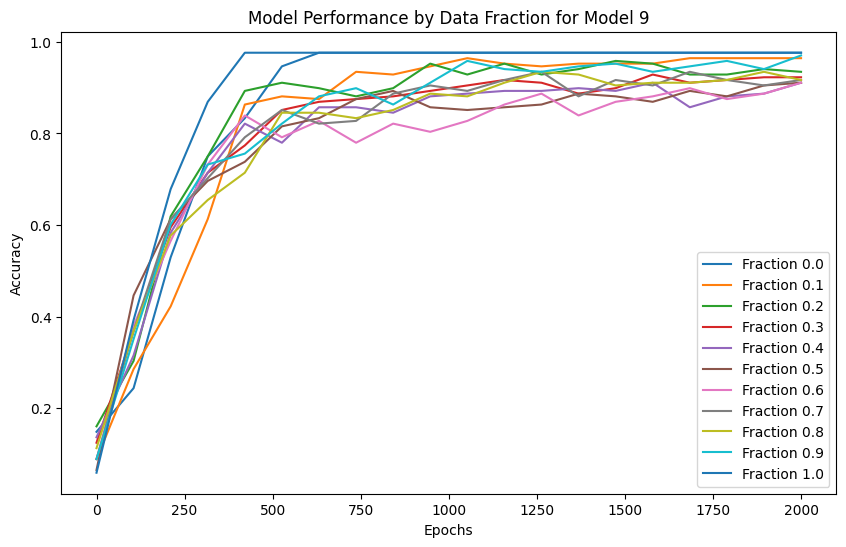

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2057
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.8949
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.4162
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 1.0269
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.6658
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.4415
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.3198
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.2455
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.1973
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.1648
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.1420
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.1255
predi

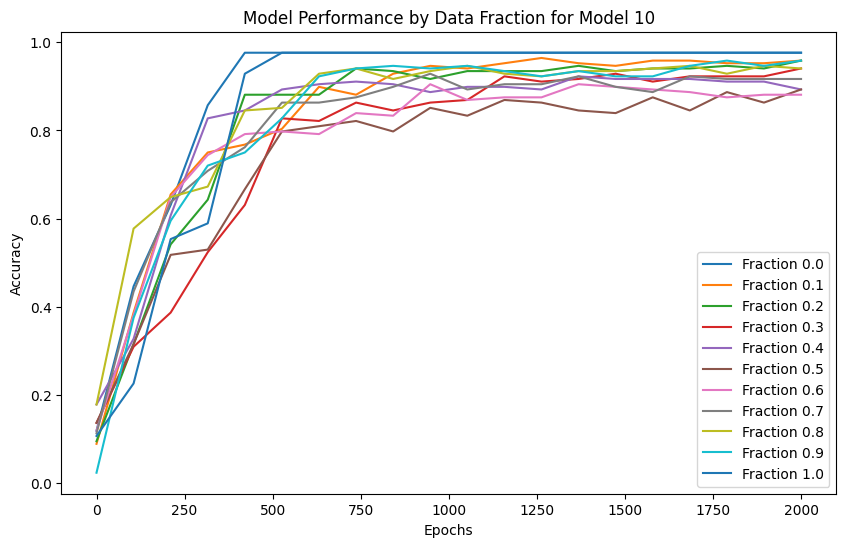

Model 11, Fraction 0.00, Epoch 1, Loss: 2.2052
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.9371
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.4212
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 1.0412
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.7362
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.4943
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.3384
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.2498
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.1957
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.1604
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.1361
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.1189
predi

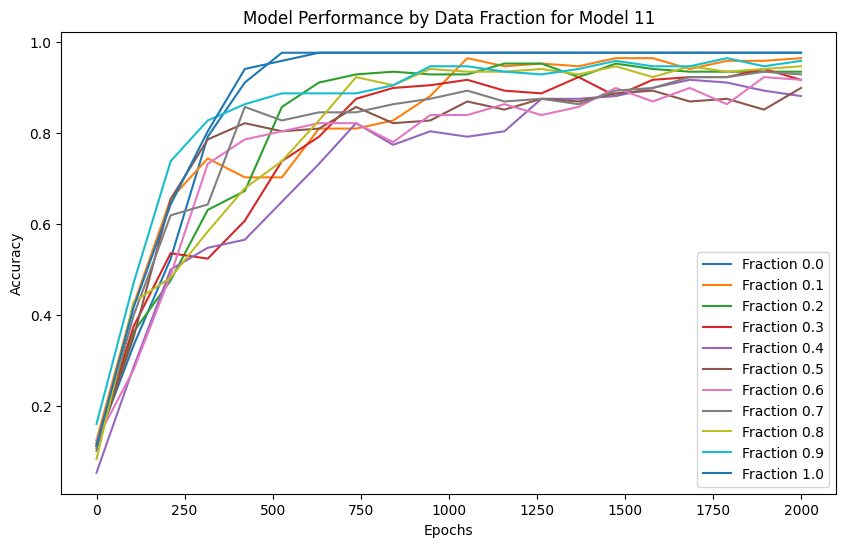

Model 12, Fraction 0.00, Epoch 1, Loss: 2.2017
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.9018
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.3640
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.9855
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.7205
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.5645
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.4095
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.2940
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.2238
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.1789
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.1487
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.1279
predi

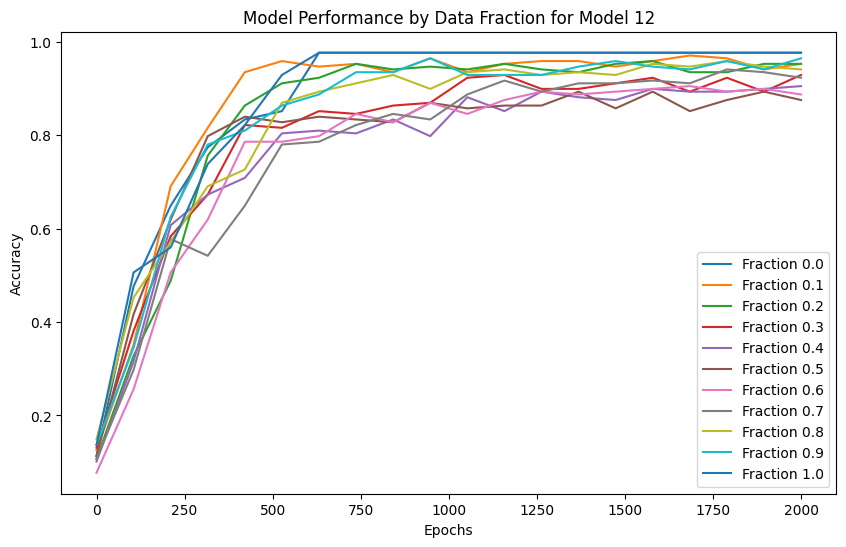

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2056
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.8684
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.3825
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 1.0821
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.9096
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.7769
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.5966
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.4015
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.2827
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.2092
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.1587
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.1308
predi

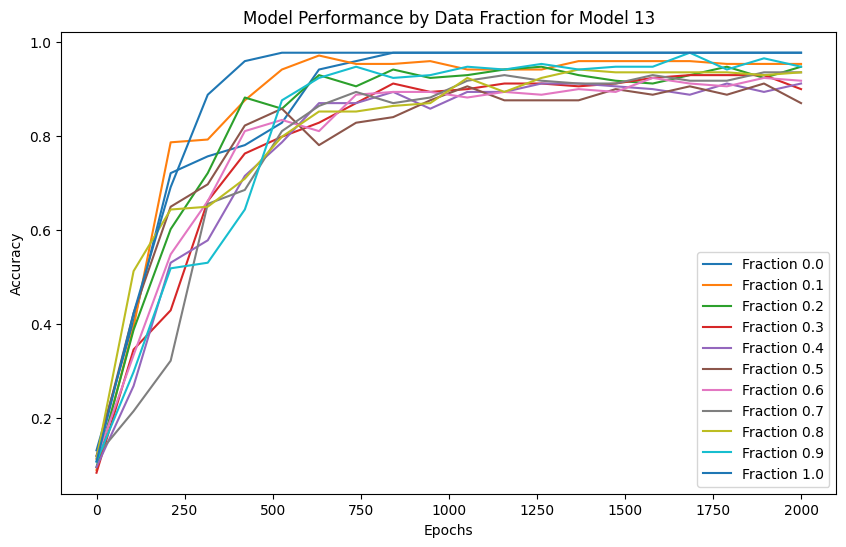

Model 14, Fraction 0.00, Epoch 1, Loss: 2.1948
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.8439
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.3639
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 1.0684
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.7757
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.5150
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.3613
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.2689
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.2098
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.1711
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.1453
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.1273
predi

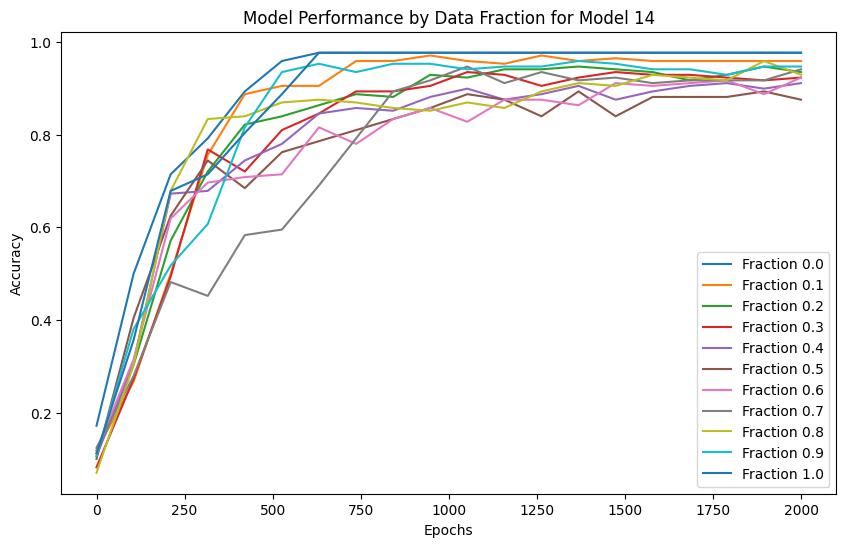

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2037
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.8953
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.3888
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 1.1128
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.8725
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.6463
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.4661
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.3330
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.2446
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.1899
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.1564
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.1341
predi

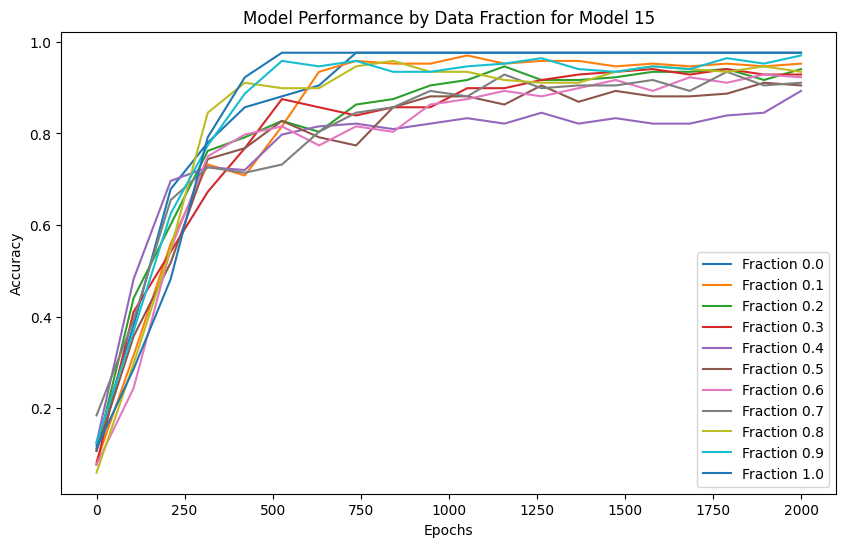

Model 16, Fraction 0.00, Epoch 1, Loss: 2.1974
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.8054
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.3825
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 1.1095
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.8432
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.5905
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.3896
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.2732
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.2071
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.1674
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.1415
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.1237
predi

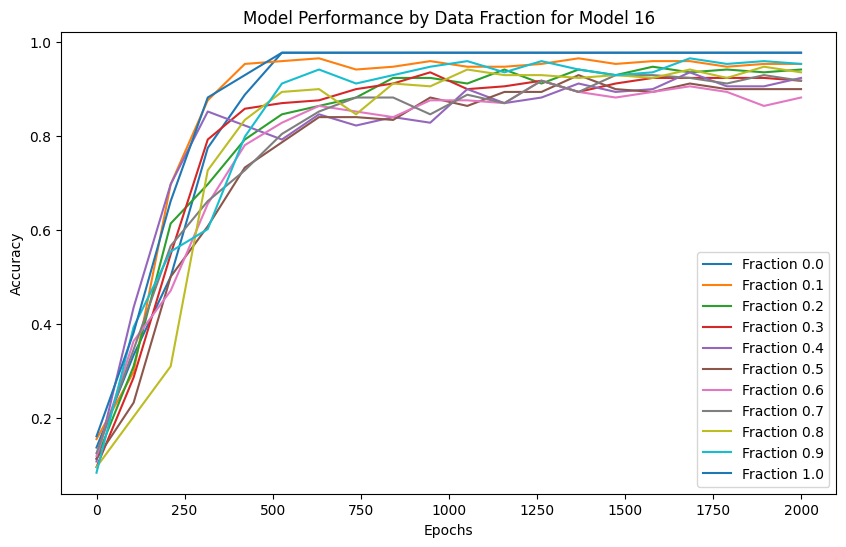

Model 17, Fraction 0.00, Epoch 1, Loss: 2.1941
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.8898
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.3781
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 1.1009
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.8931
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.6887
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.4986
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.3323
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.2486
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.1952
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.1602
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.1367
predi

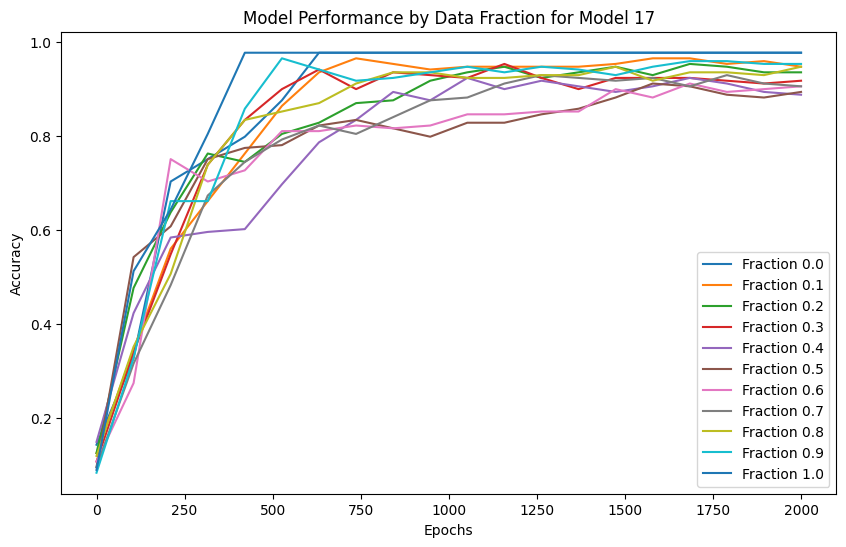

Model 18, Fraction 0.00, Epoch 1, Loss: 2.1991
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.9425
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.5243
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 1.2020
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.8673
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.5798
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.3818
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.2770
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.2142
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.1730
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.1452
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.1261
predi

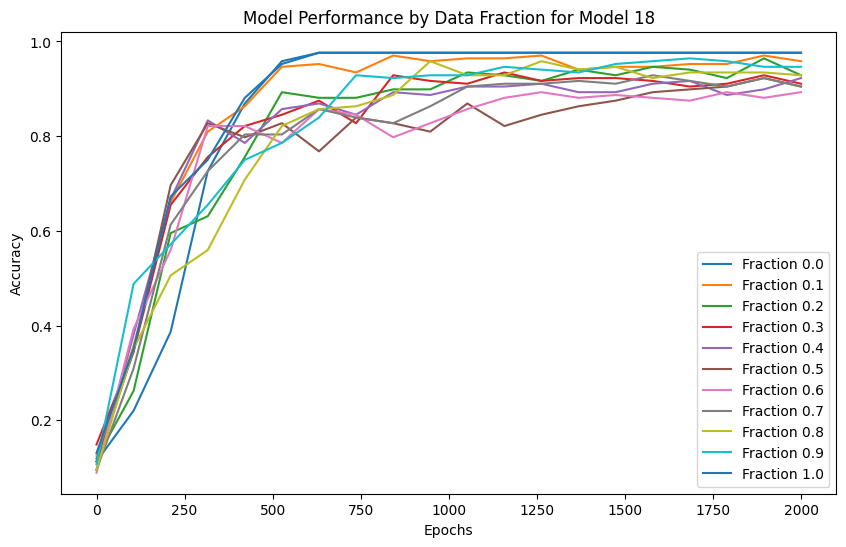

Model 19, Fraction 0.00, Epoch 1, Loss: 2.1993
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.9188
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.2906
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.8888
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.6563
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.5145
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.3797
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.2727
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.2094
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.1694
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.1426
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.1240
predi

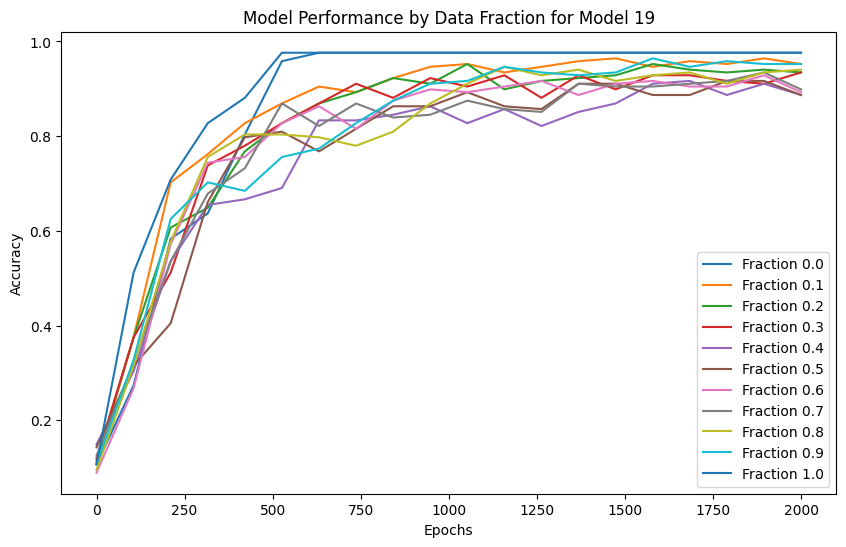

Model 20, Fraction 0.00, Epoch 1, Loss: 2.2137
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.9805
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.4692
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 1.0990
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.7794
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.5491
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4208
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.3410
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.2850
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.2410
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.2049
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.1751
predi

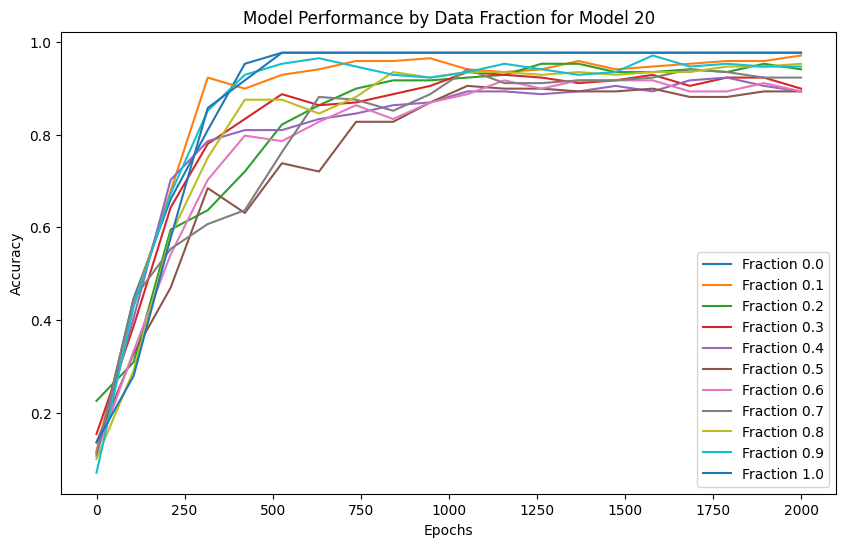

Model 21, Fraction 0.00, Epoch 1, Loss: 2.1956
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.8378
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.3189
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.9806
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.6960
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.4926
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.3596
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.2760
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.2203
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.1817
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.1540
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.1339
predi

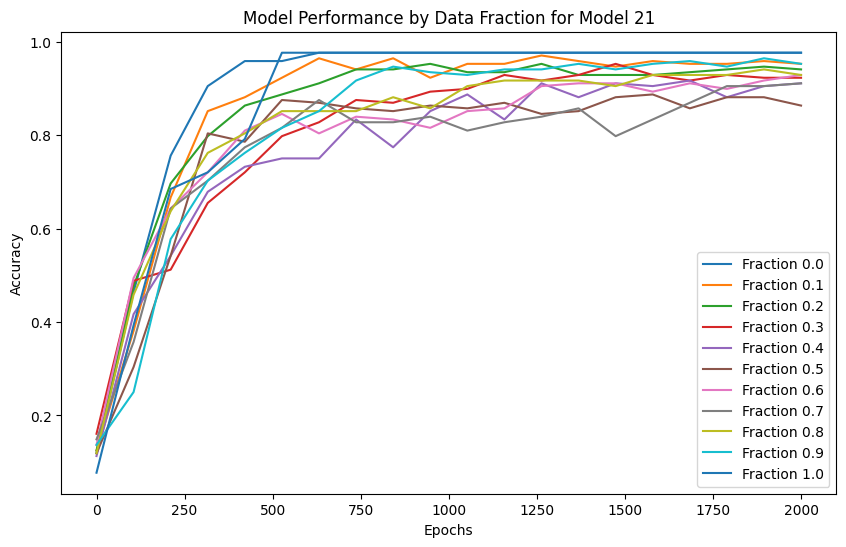

Model 22, Fraction 0.00, Epoch 1, Loss: 2.1997
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.8390
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.3560
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 1.0368
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.7561
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.5414
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.3884
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.2921
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.2293
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.1876
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.1583
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.1370
predi

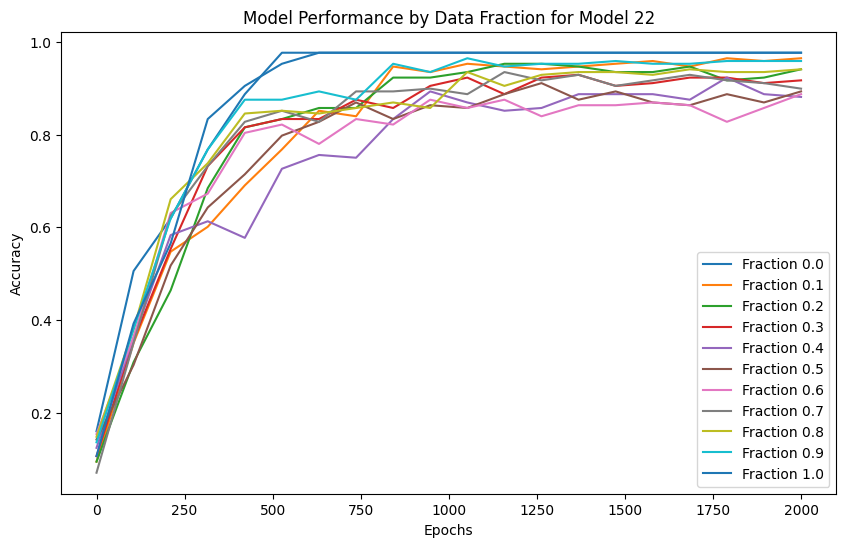

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2040
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.9441
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.4761
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 1.1069
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.7808
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.5322
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.3654
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.2656
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.2057
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.1673
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.1417
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.1239
predi

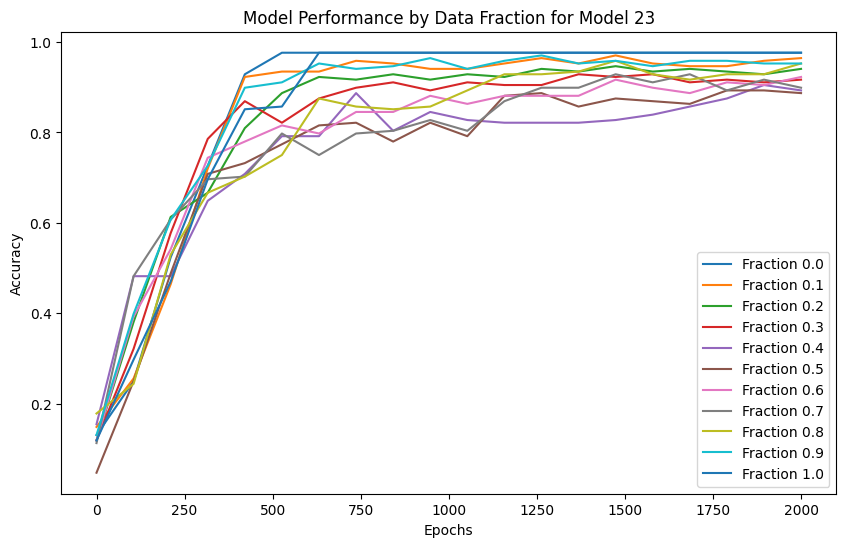

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2064
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.8883
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.4074
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 1.0425
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.7285
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.5463
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.4353
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.3146
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.2227
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.1745
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.1460
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.1271
predi

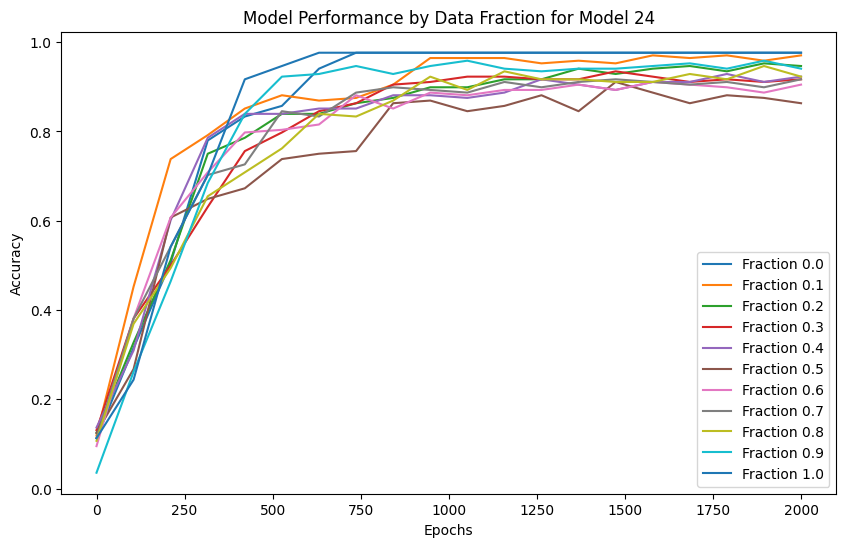

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2028
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.8836
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.3996
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 1.0964
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.8686
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.6128
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.4066
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.2708
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.1984
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.1577
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.1328
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.1165
predi

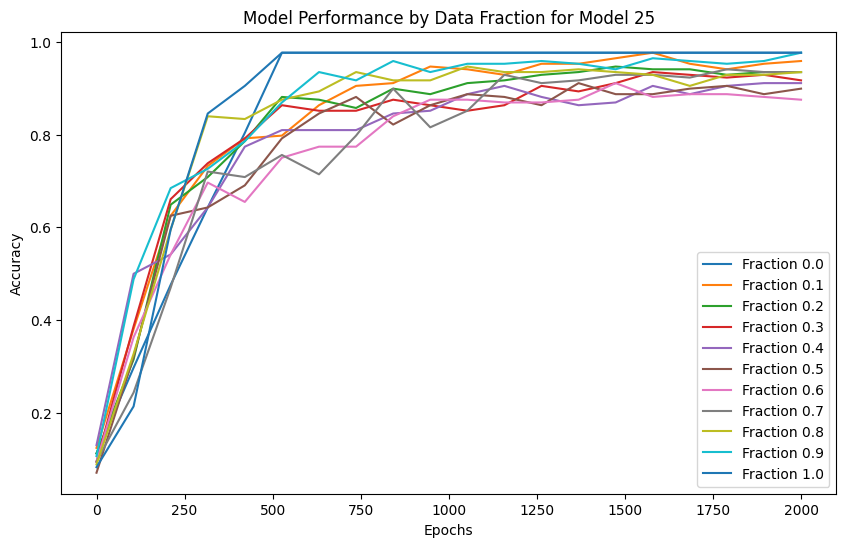

Model 26, Fraction 0.00, Epoch 1, Loss: 2.1997
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.9121
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.3453
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.9576
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.6782
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.4827
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.3547
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.2678
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.2092
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.1698
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.1430
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.1245
predi

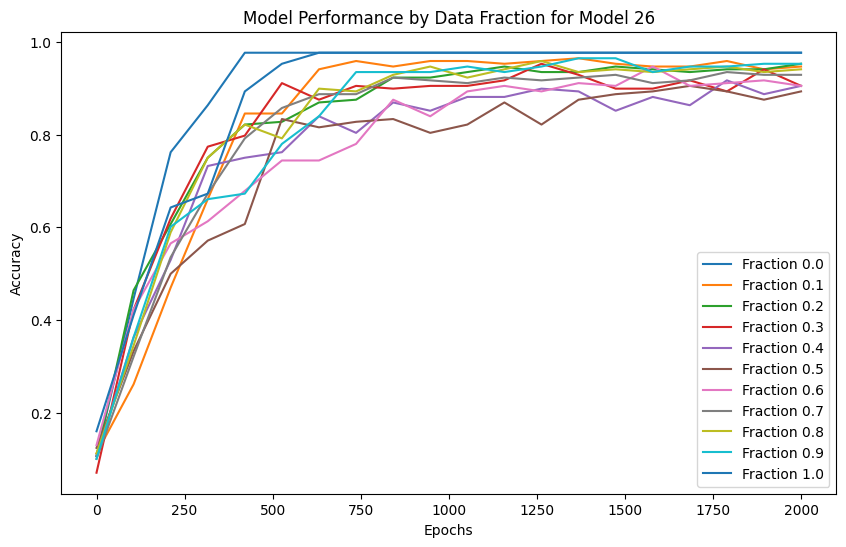

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2005
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.8994
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.3860
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 1.0917
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.8131
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.5775
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4166
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.3064
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.2299
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.1822
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.1518
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.1313
predi

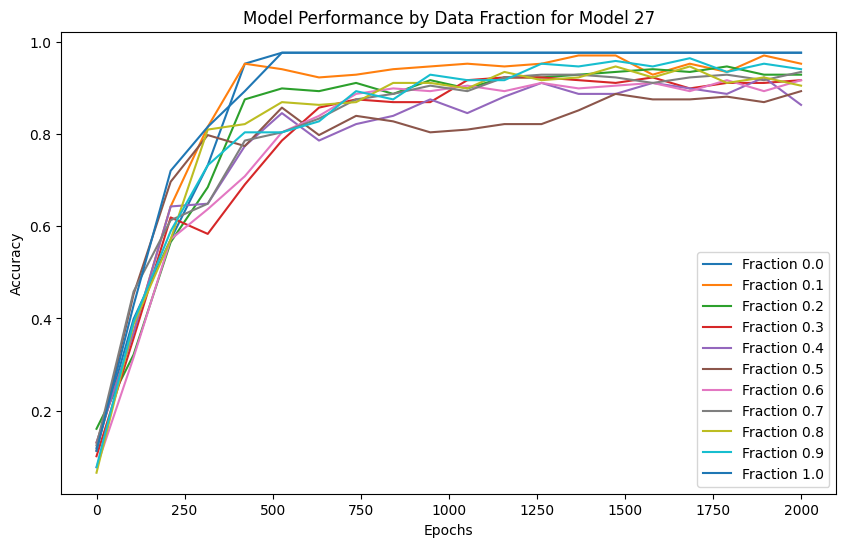

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2035
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.8650
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.4158
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 1.1025
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.8788
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.6702
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.4973
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.3573
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.2596
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.1998
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.1622
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.1370
predi

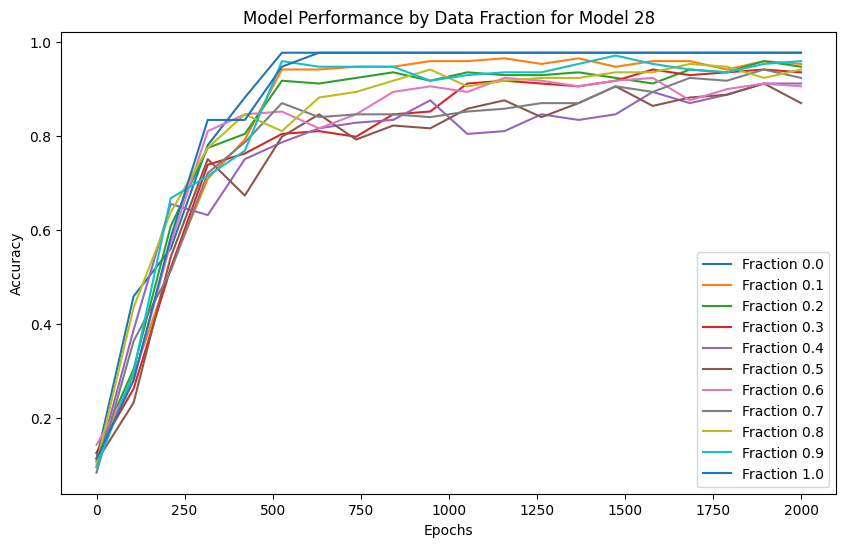

Model 29, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.8763
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.2973
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.8929
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.6688
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.4964
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.3666
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.2765
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.2135
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.1728
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.1457
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.1266
predi

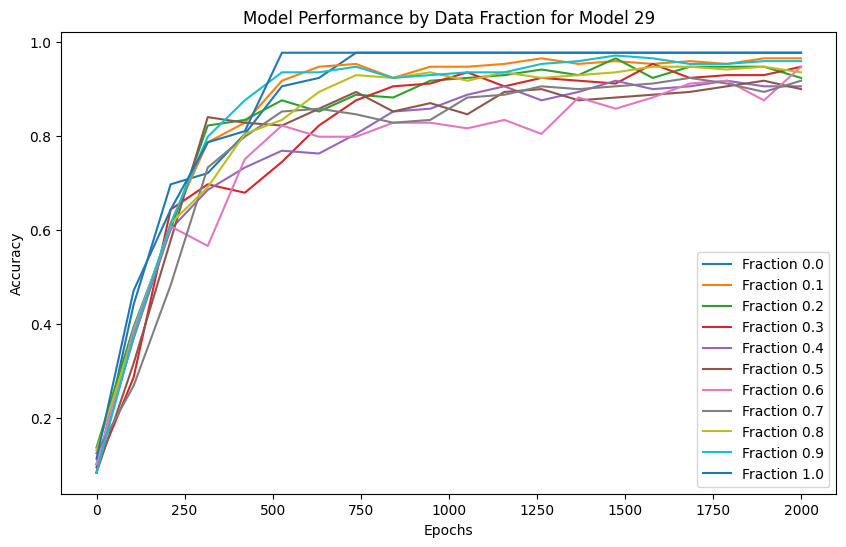

In [23]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    #"CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    # "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    # "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
    #"AHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFEDGBIAHCFED"
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_GHI_contradiction_lower_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [24]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_GHI_contradiction_lower_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIABCDEFGHIABCDEFGHIABCDEFGHIABCDEF",
    "ABCDEFIGHABCDEFIGHABCDEFIGHABCDEFIGHABCDEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.6706
  Fraction 0.10, Average Accuracy: 0.7635
  Fraction 0.20, Average Accuracy: 0.7810
  Fraction 0.30, Average Accuracy: 0.7889
  Fraction 0.40, Average Accuracy: 0.7984
  Fraction 0.50, Average Accuracy: 0.8794
  Fraction 0.60, Average Accuracy: 0.9540
  Fraction 0.70, Average Accuracy: 0.9738
  Fraction 0.80, Average Accuracy: 0.9762
  Fraction 0.90, Average Accuracy: 0.9762
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9762
  Fraction 0.20, Average Accuracy: 0.9762
  Fraction 0.30, Average Accuracy: 0.9762
  Fraction 0.40, Average Accuracy: 0.9683
  Fraction 0.50, Average Accuracy: 0.8960
  Fraction 0.60, Average Accuracy: 0.8175
  Fraction 0.70, Average Accuracy: 0.7952
  Fraction 0.80, Average Accuracy: 0.7944
  Fraction 0.90, Average Accuracy: 0.7802
  Fraction 1.00, Average Accuracy: 0.6706


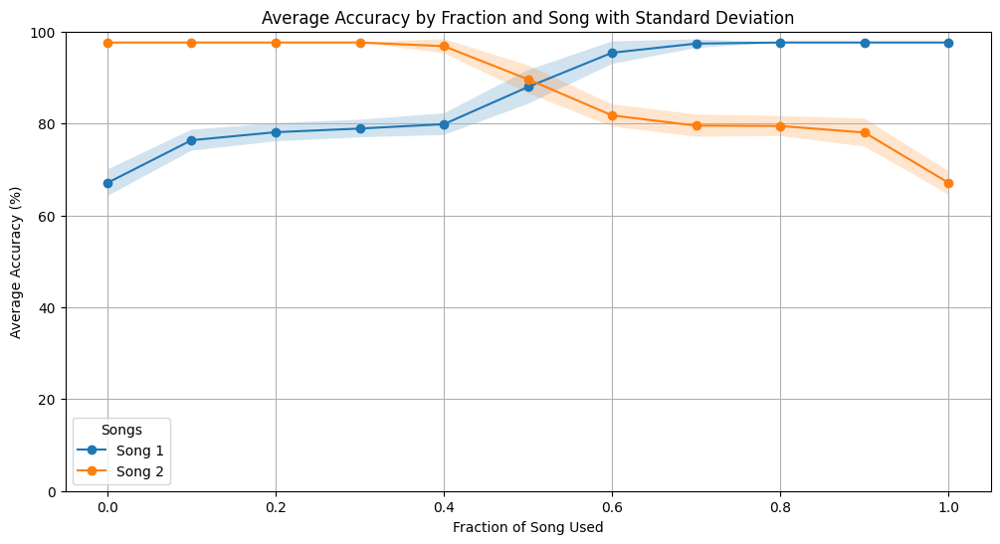

In [25]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


## Model Size

### Normal and reverse songs - 8,8,2 - M

#### Training 

Model 0, Fraction 0.00, Epoch 1, Loss: 2.3415
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.3988
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.7111
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.3573
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.2078
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.1443
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.1134
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.0962
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.0856
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.0740
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.0707
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.0682
prediction sha

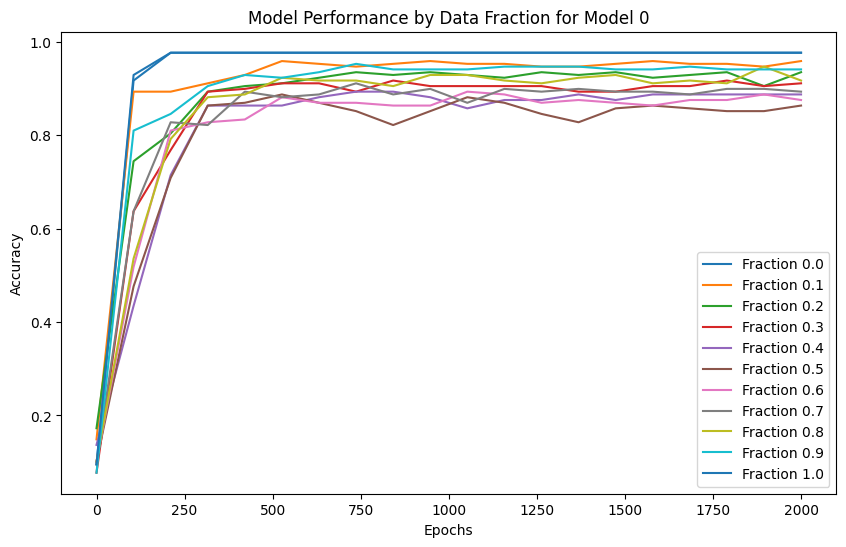

Model 1, Fraction 0.00, Epoch 1, Loss: 2.3145
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.3518
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.6991
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.3482
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.2022
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.1414
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.1117
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.0952
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.0852
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.0786
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.0740
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.0707
prediction shape 

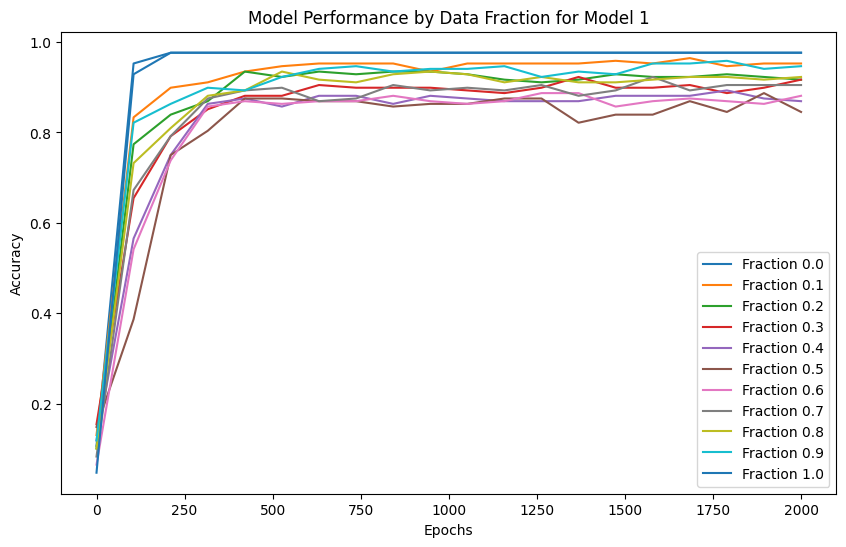

Model 2, Fraction 0.00, Epoch 1, Loss: 2.3141
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.3554
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.6476
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.2951
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.1778
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.1292
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.1046
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.0904
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.0816
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.0758
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.0718
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.0689
prediction shape 

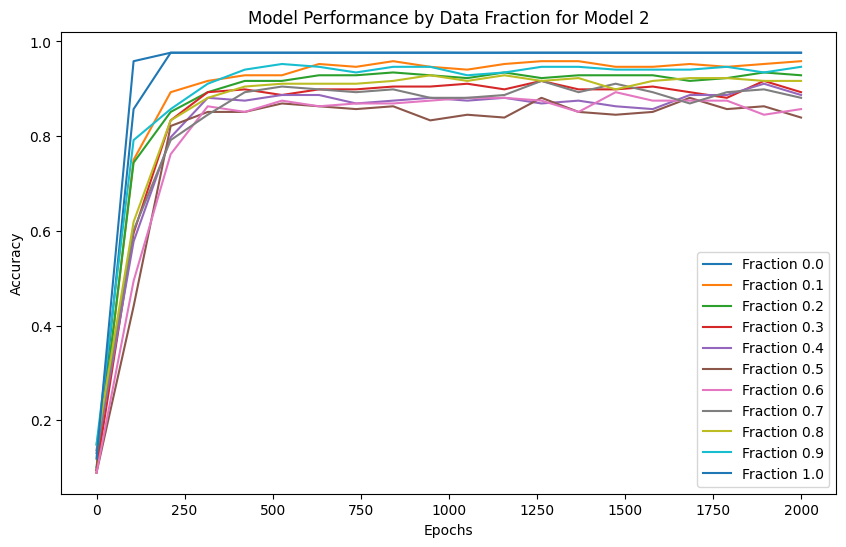

Model 3, Fraction 0.00, Epoch 1, Loss: 2.3154
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.4917
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.7246
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.3400
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.2017
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.1422
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.1124
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.0956
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.0854
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.0787
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.0708
prediction shape 

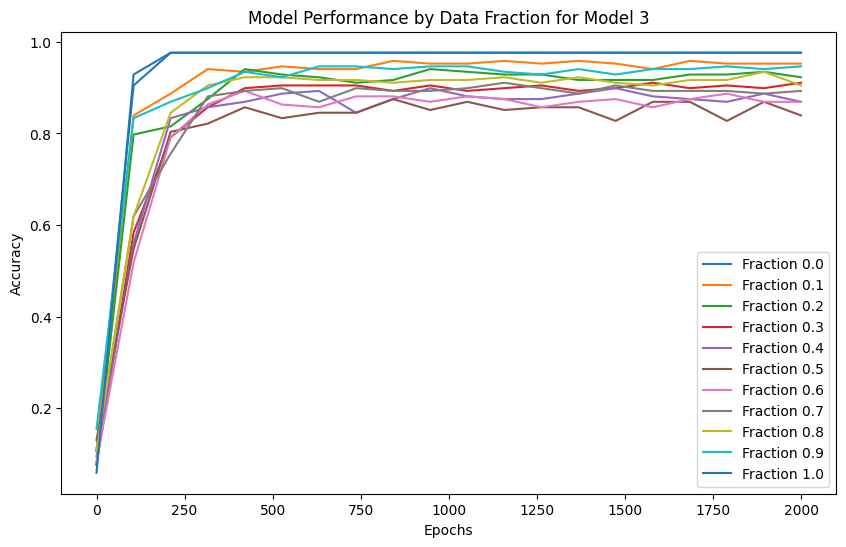

Model 4, Fraction 0.00, Epoch 1, Loss: 2.3010
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.3483
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.6096
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.2890
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.1791
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.1315
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.1068
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.0925
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.0835
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.0774
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.0732
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.0703
prediction shape 

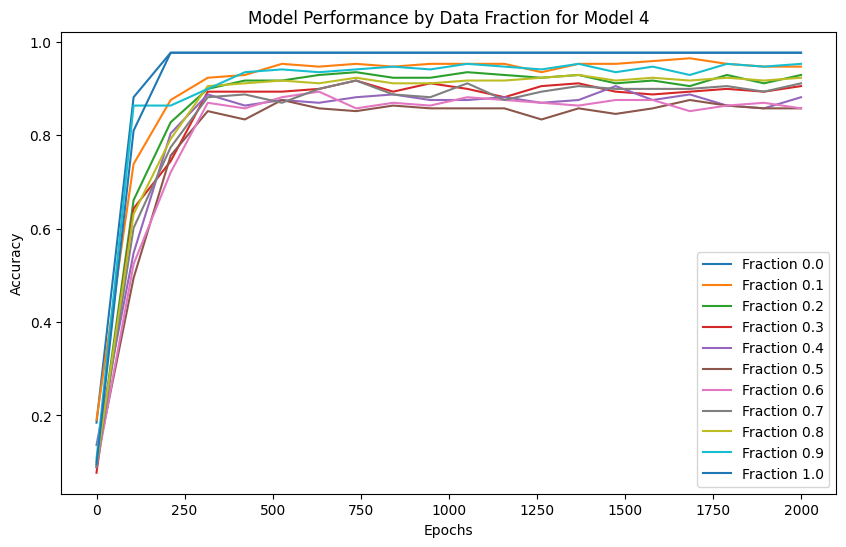

Model 5, Fraction 0.00, Epoch 1, Loss: 2.3345
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.4276
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.7320
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.3443
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.1971
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.1381
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.1092
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.0934
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.0837
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.0774
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.0731
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.0700
prediction shape 

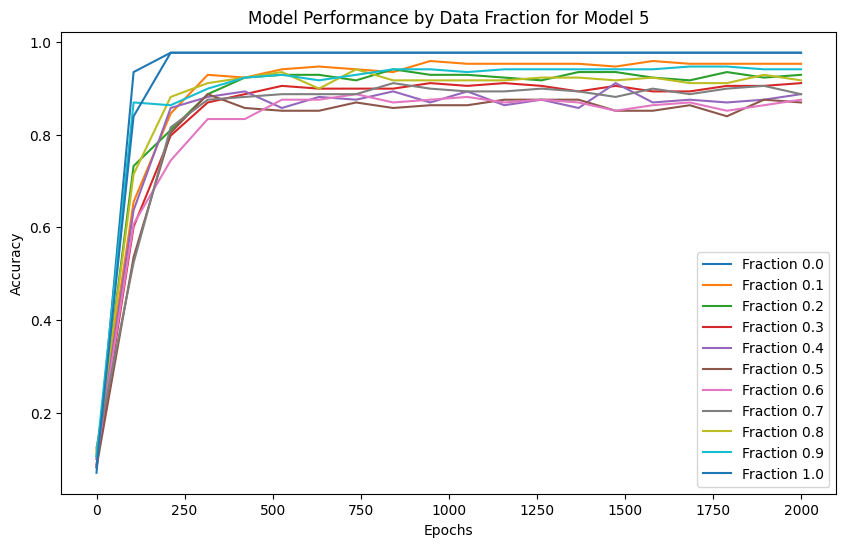

Model 6, Fraction 0.00, Epoch 1, Loss: 2.3236
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.4457
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.7250
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.3290
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.1941
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.1382
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.1105
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.0948
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.0850
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.0785
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.0740
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.0707
prediction shape 

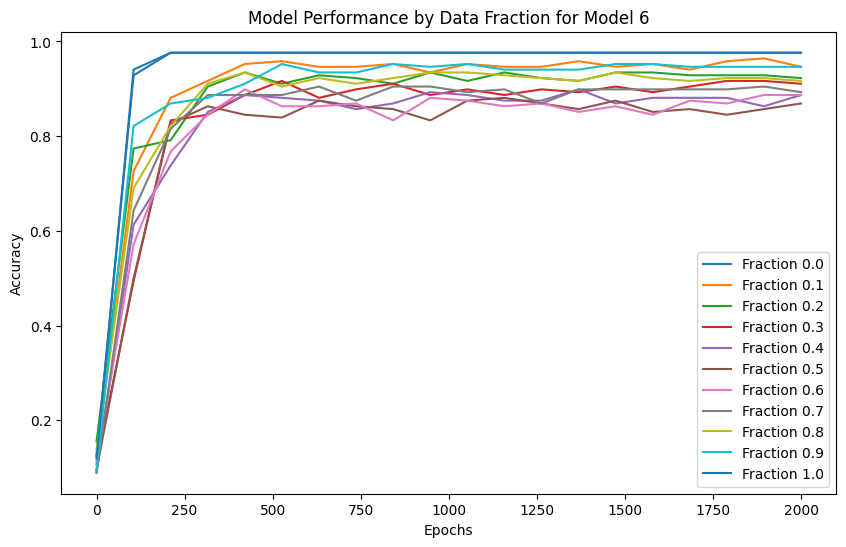

Model 7, Fraction 0.00, Epoch 1, Loss: 2.3295
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.4177
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.7020
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.3484
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.2082
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.1469
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.1161
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.0987
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.0879
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.0808
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.0758
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.0722
prediction shape 

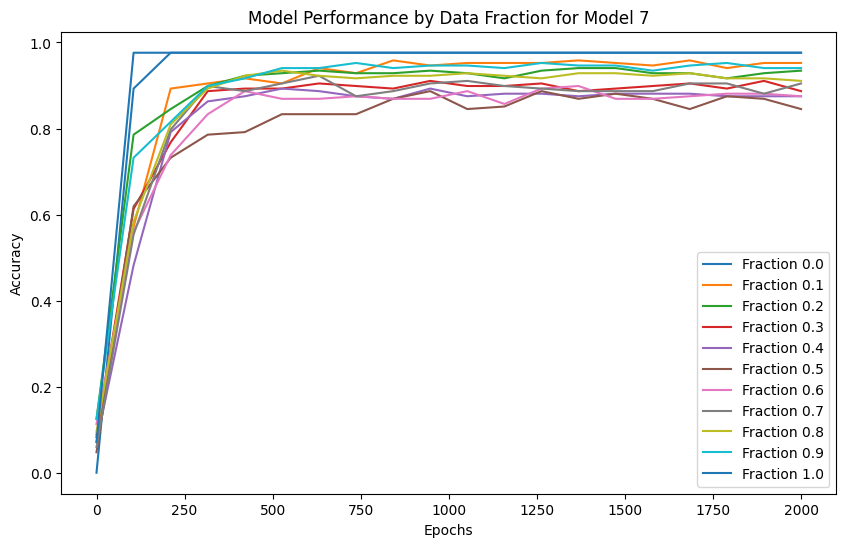

Model 8, Fraction 0.00, Epoch 1, Loss: 2.3039
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.3817
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.7173
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.3545
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.2060
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.1433
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.1126
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.0956
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.0852
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.0785
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.0738
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.0705
prediction shape 

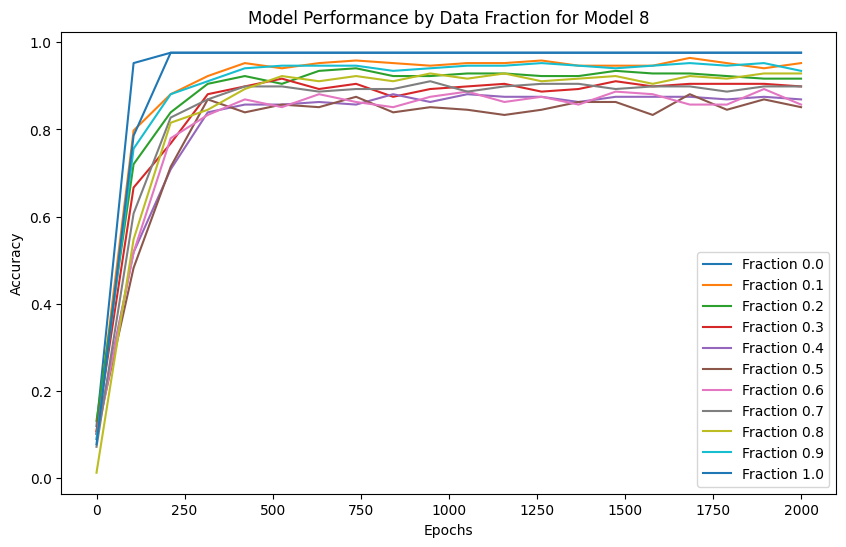

Model 9, Fraction 0.00, Epoch 1, Loss: 2.3183
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.3751
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.6177
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.3079
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.1877
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.1348
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.1081
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.0930
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.0836
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.0775
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.0732
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.0701
prediction shape 

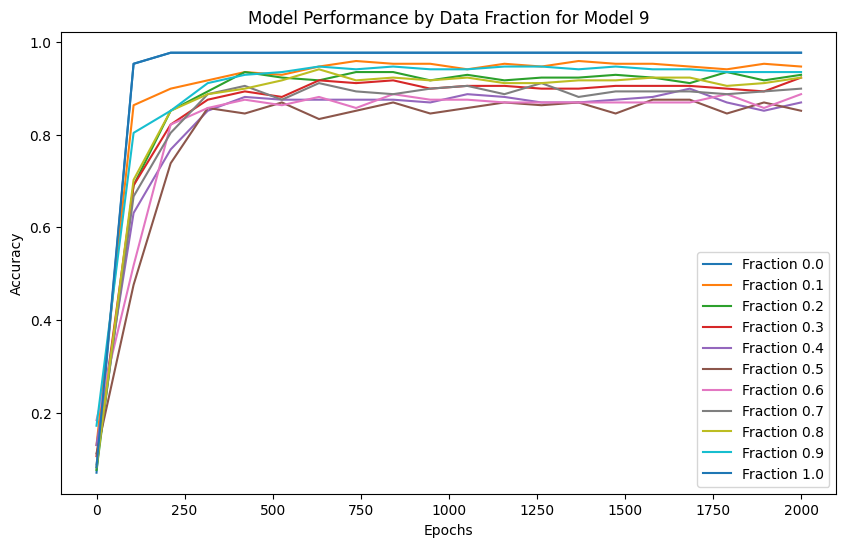

Model 10, Fraction 0.00, Epoch 1, Loss: 2.3236
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.3988
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 0.7117
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.3499
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.2008
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.1402
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.1107
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.0944
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.0845
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.0780
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.0735
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.0703
predi

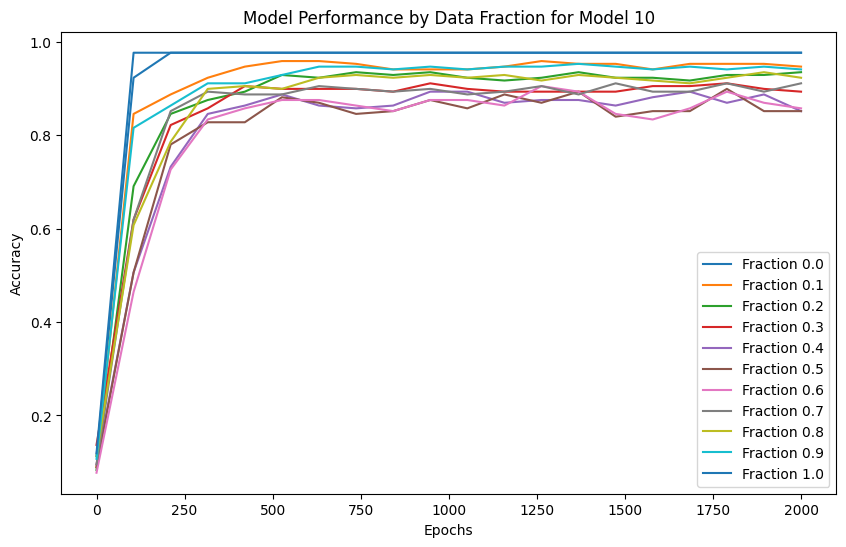

Model 11, Fraction 0.00, Epoch 1, Loss: 2.3211
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.5184
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 0.7583
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.3343
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.1891
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.1327
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.1057
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.0909
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.0818
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.0759
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.0718
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.0689
predi

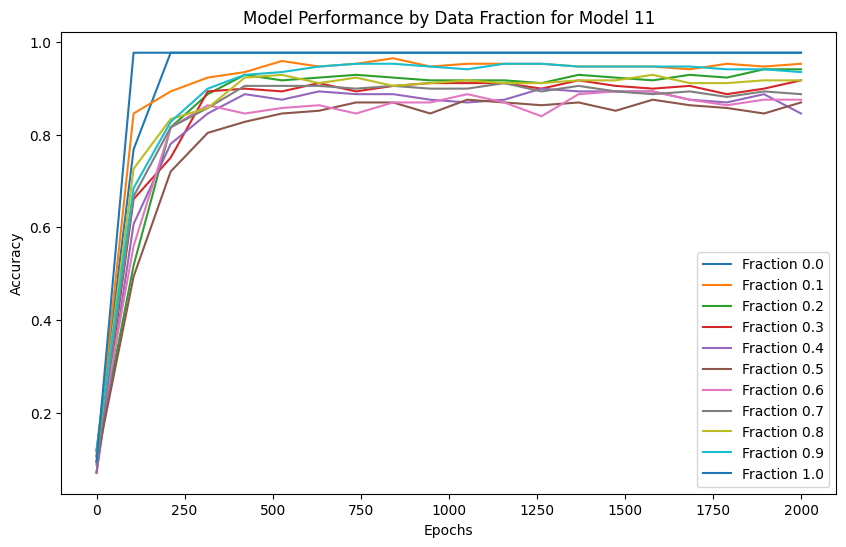

Model 12, Fraction 0.00, Epoch 1, Loss: 2.3091
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.3900
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 0.6902
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.3390
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.2011
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.1424
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.1131
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.0966
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.0863
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.0796
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.0748
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.0714
predi

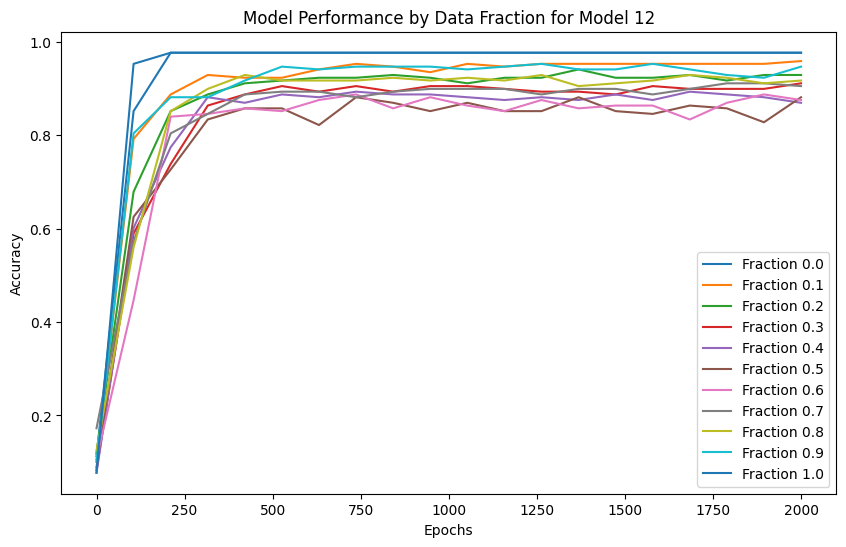

Model 13, Fraction 0.00, Epoch 1, Loss: 2.3097
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.4396
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 0.7245
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.3503
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.2022
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.1423
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.1130
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.0965
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.0863
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.0795
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.0748
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.0715
predi

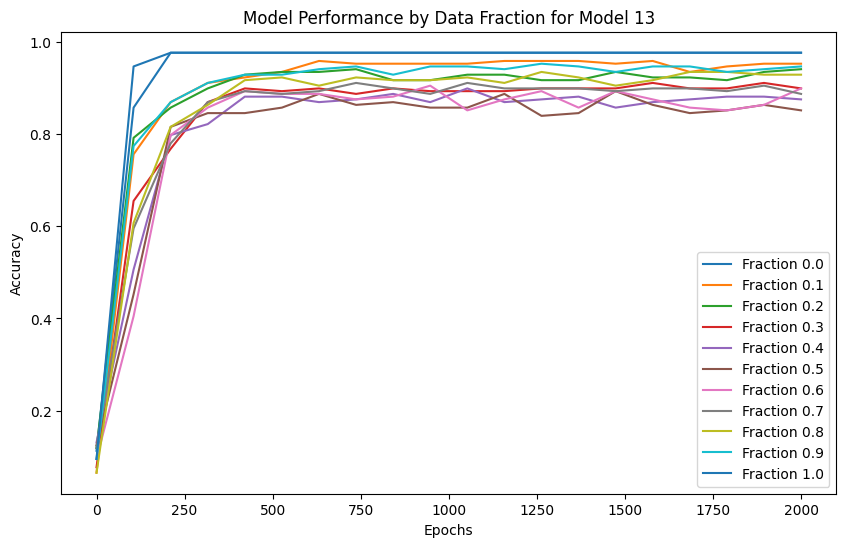

Model 14, Fraction 0.00, Epoch 1, Loss: 2.3295
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.4362
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 0.6766
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.3229
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.1875
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.1320
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.1054
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.0908
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.0820
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.0762
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.0722
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.0692
predi

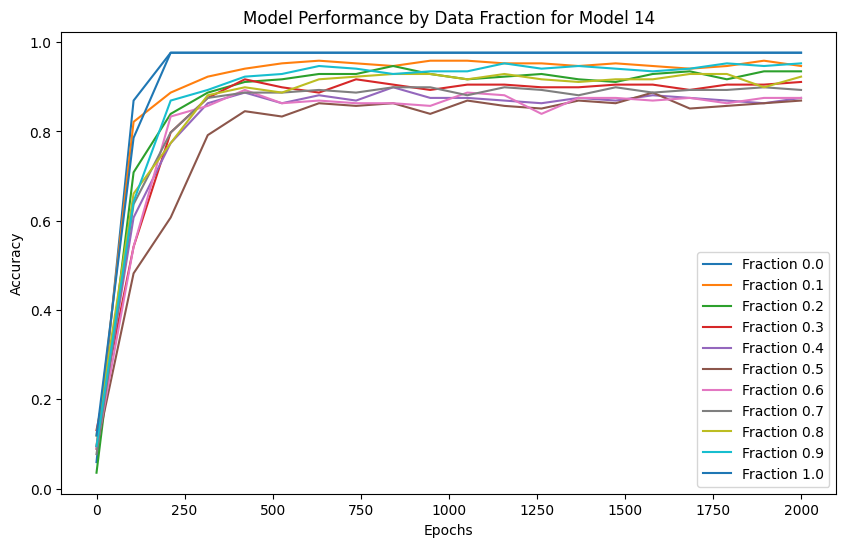

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2849
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.3805
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 0.6538
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.3141
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.1883
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.1356
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.1091
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.0940
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.0845
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.0782
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.0739
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.0707
predi

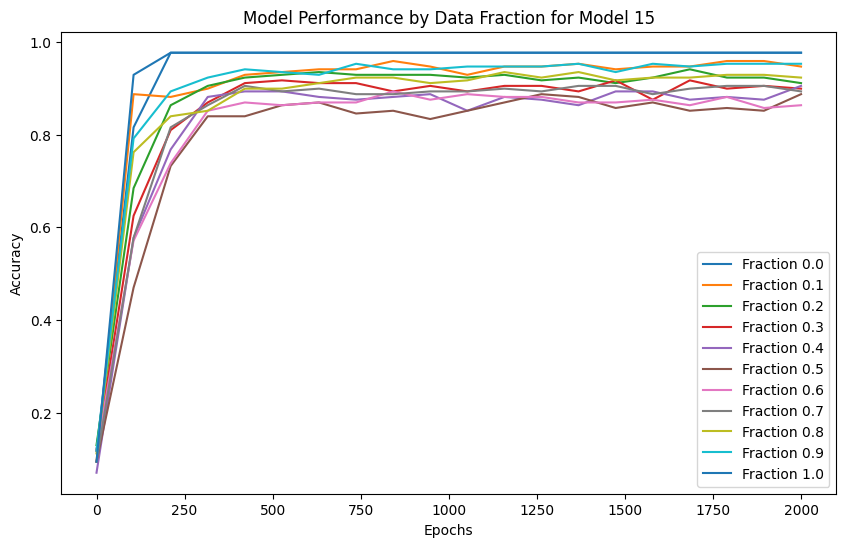

Model 16, Fraction 0.00, Epoch 1, Loss: 2.3261
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.4212
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 0.6425
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.3165
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.1906
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.1370
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.1101
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.0945
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.0845
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.0779
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.0734
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.0702
predi

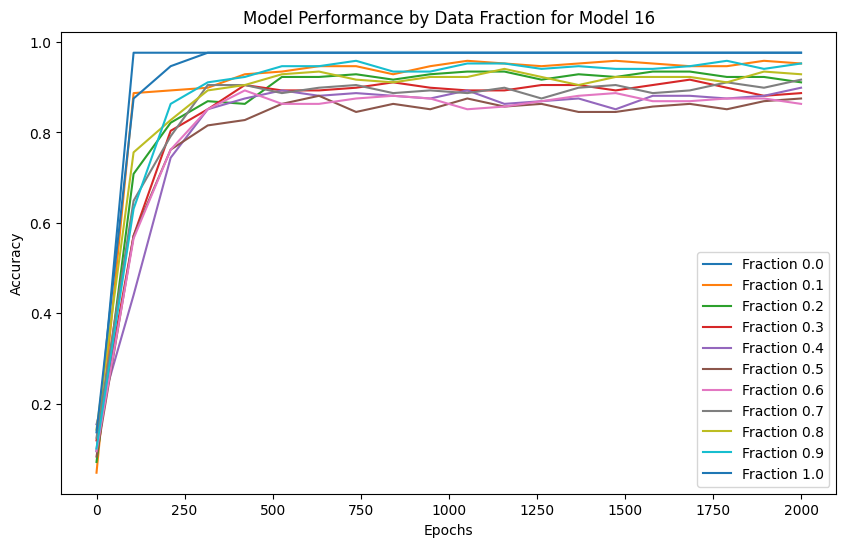

Model 17, Fraction 0.00, Epoch 1, Loss: 2.3334
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.4258
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 0.6786
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.3075
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.1827
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.1321
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.1070
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.0925
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.0833
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.0771
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.0729
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.0699
predi

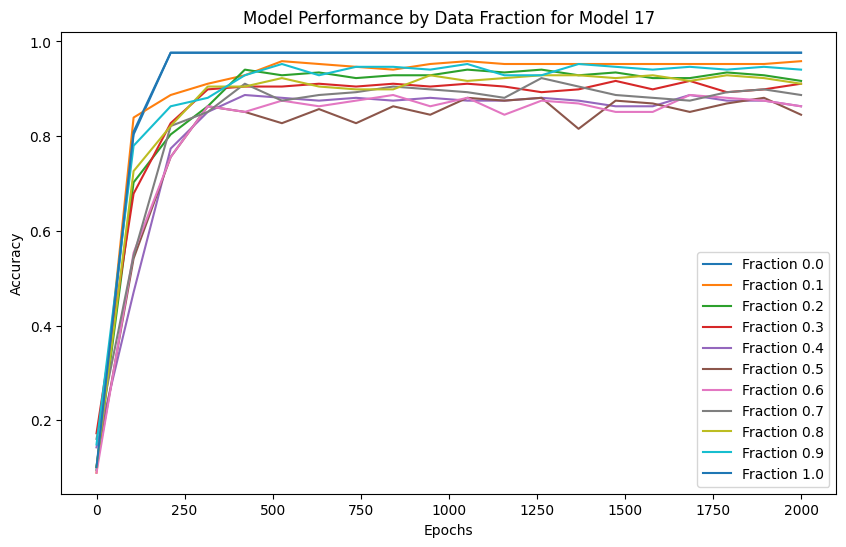

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2966
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.3066
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 0.5865
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.2955
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.1858
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.1363
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.1102
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.0947
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.0851
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.0786
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.0708
predi

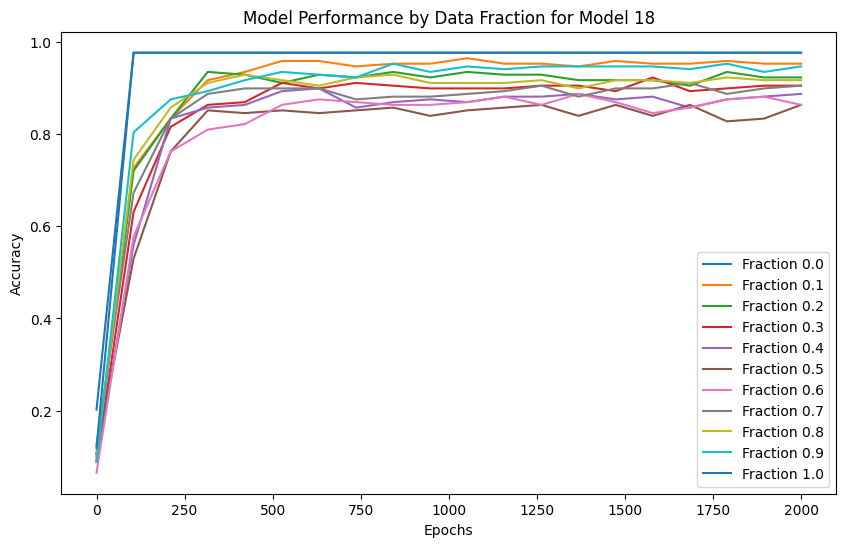

Model 19, Fraction 0.00, Epoch 1, Loss: 2.3010
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.4421
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 0.6979
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.3315
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.1962
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.1400
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.1118
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.0955
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.0854
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.0742
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.0709
predi

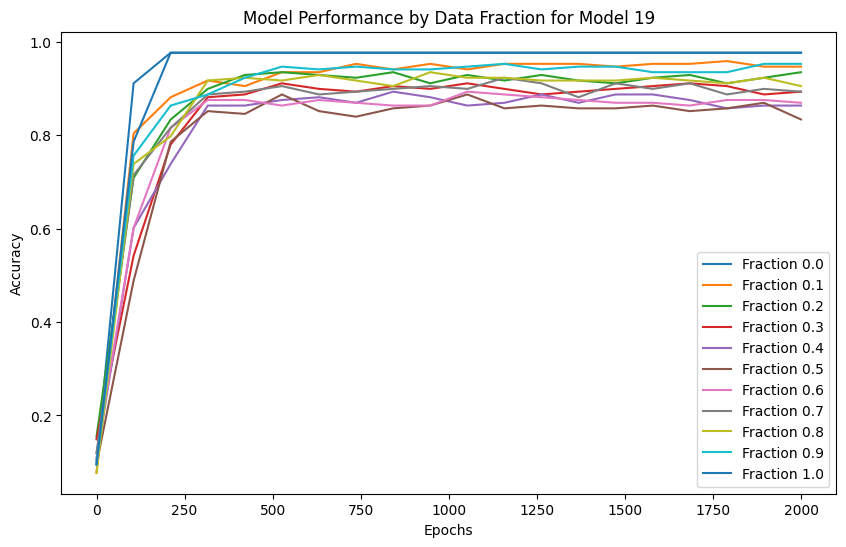

Model 20, Fraction 0.00, Epoch 1, Loss: 2.3139
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.4083
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 0.6687
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.3338
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.2002
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.1426
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.1134
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.0967
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.0862
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.0794
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.0746
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.0712
predi

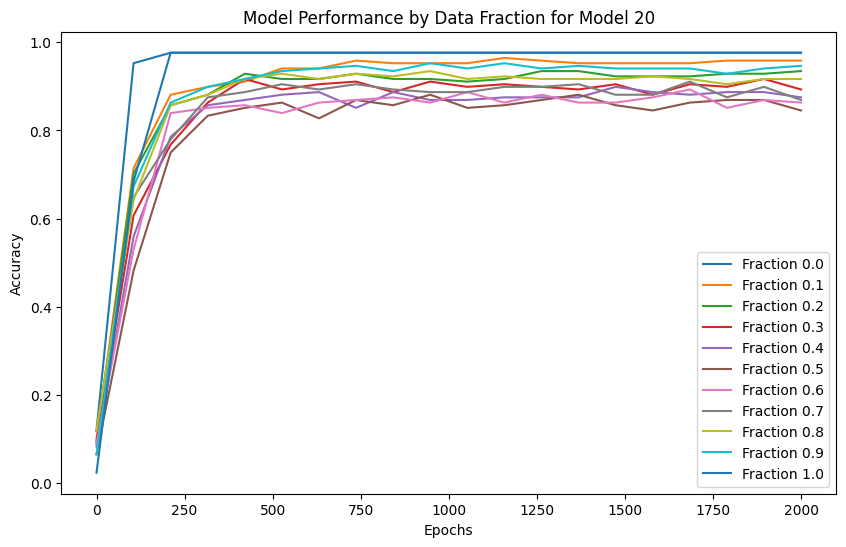

Model 21, Fraction 0.00, Epoch 1, Loss: 2.3173
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.3779
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 0.6943
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.3469
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.2045
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.1434
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.1132
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.0963
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.0859
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.0792
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.0710
predi

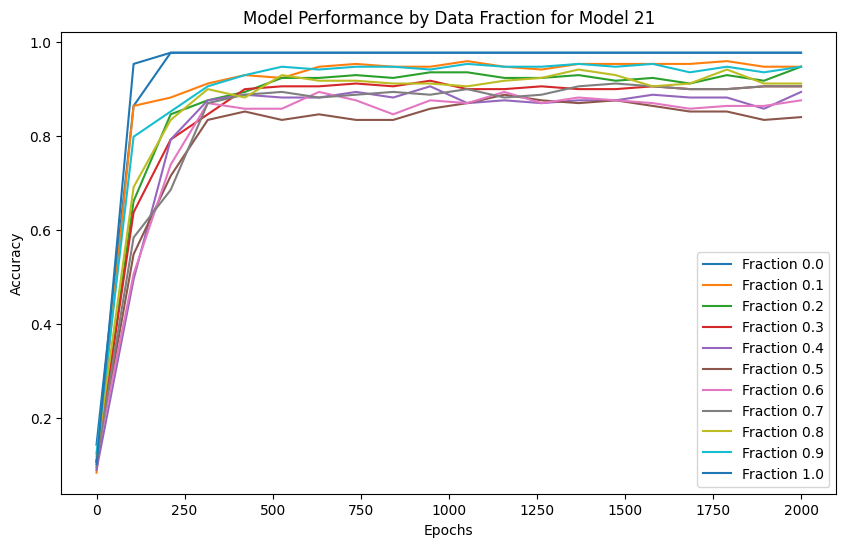

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2955
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.3478
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 0.7065
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.3445
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.1955
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.1365
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.1084
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.0928
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.0832
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.0770
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.0727
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.0696
predi

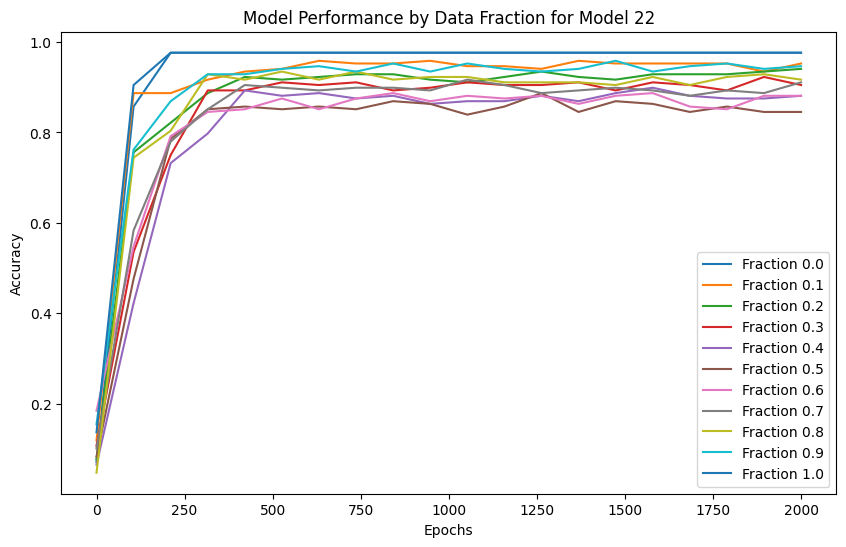

Model 23, Fraction 0.00, Epoch 1, Loss: 2.3265
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.4223
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 0.7527
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.3818
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.2102
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.1436
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.1129
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.0961
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.0858
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.0711
predi

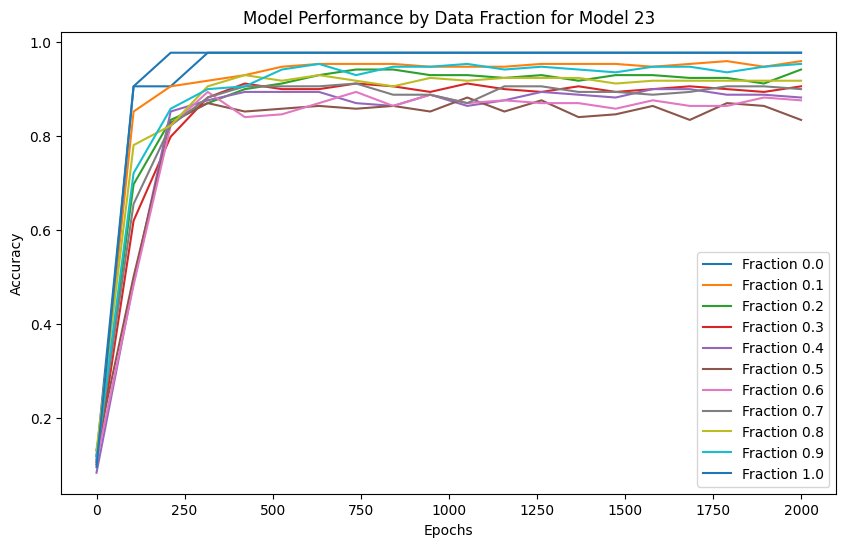

Model 24, Fraction 0.00, Epoch 1, Loss: 2.3336
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.3359
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 0.6555
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.3292
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.1986
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.1416
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.1127
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.0962
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.0859
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.0744
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.0710
predi

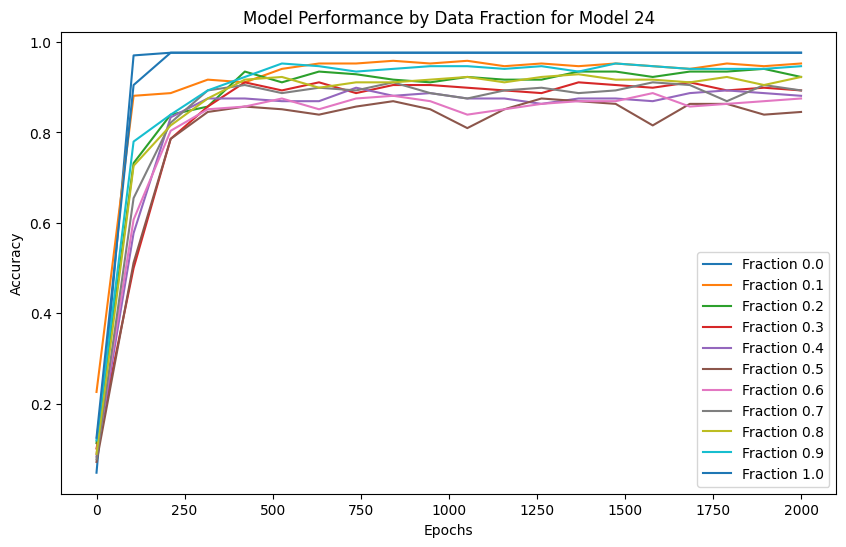

Model 25, Fraction 0.00, Epoch 1, Loss: 2.3070
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.4206
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 0.6883
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.3276
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.1916
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.1359
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.1084
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.0928
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.0833
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.0771
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.0728
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.0697
predi

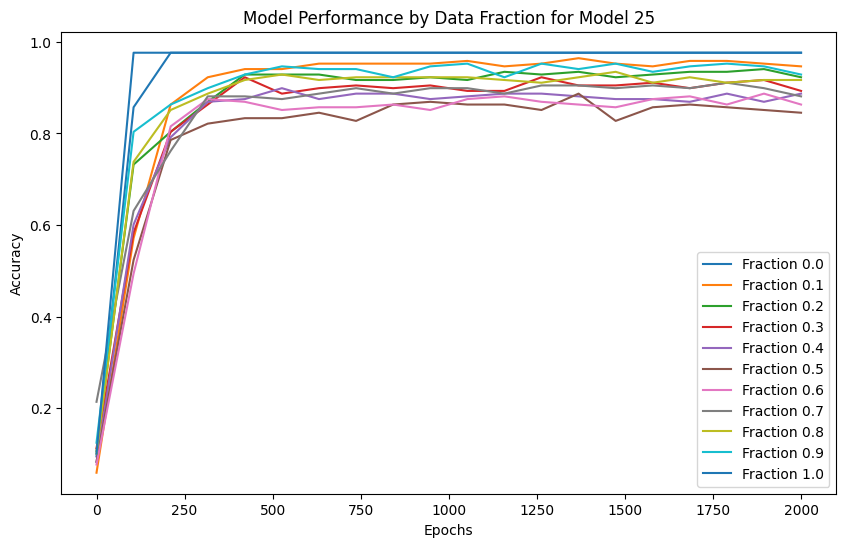

Model 26, Fraction 0.00, Epoch 1, Loss: 2.3064
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.3738
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 0.6856
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.3333
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.1927
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.1357
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.1081
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.0926
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.0832
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.0771
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.0729
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.0698
predi

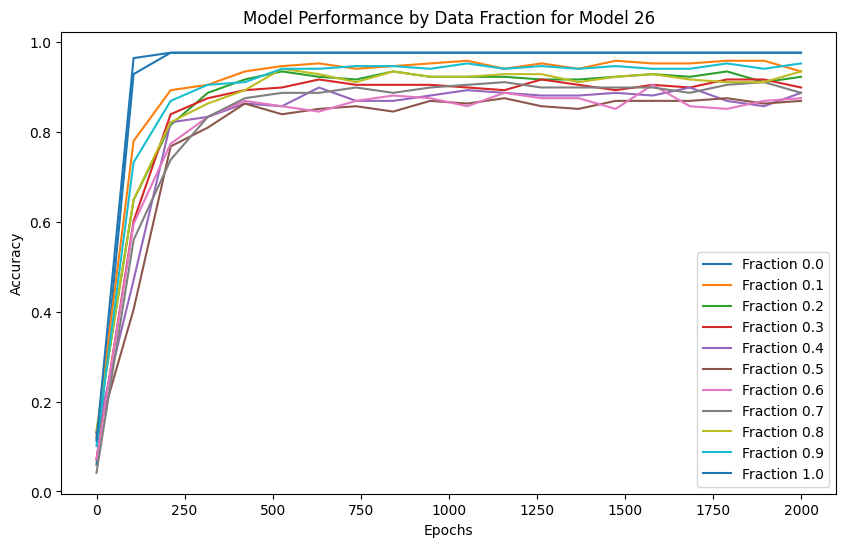

Model 27, Fraction 0.00, Epoch 1, Loss: 2.3105
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.4439
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 0.6670
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.3220
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.1939
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.1394
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.1117
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.0958
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.0859
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.0747
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.0713
predi

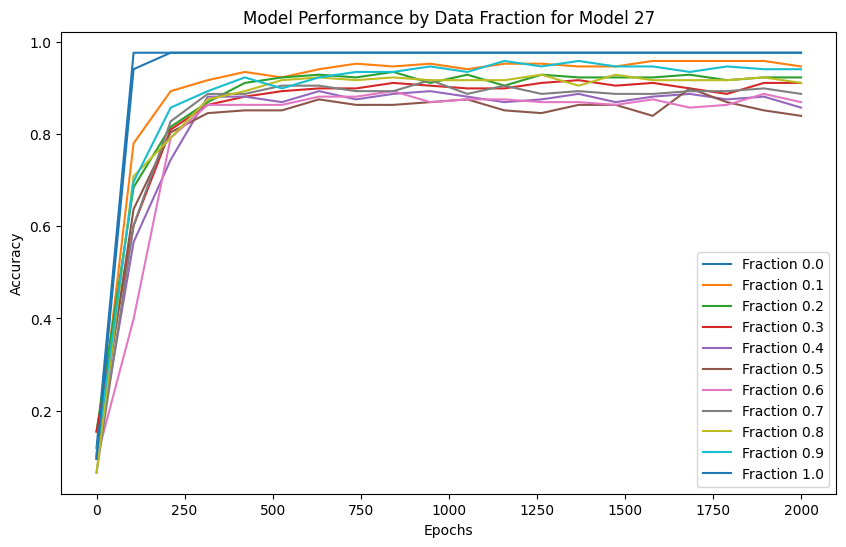

Model 28, Fraction 0.00, Epoch 1, Loss: 2.3203
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.4064
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 0.7147
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.3365
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.1945
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.1380
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.1102
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.0946
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.0849
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.0785
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.0741
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.0708
predi

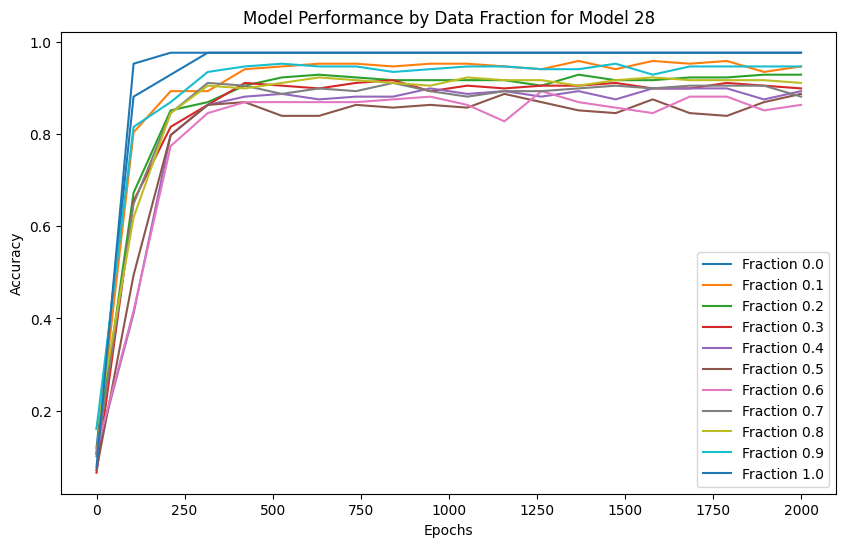

Model 29, Fraction 0.00, Epoch 1, Loss: 2.3219
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.5099
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 0.7187
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.3438
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.1976
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.1367
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.1076
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.0918
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.0824
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.0763
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.0722
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.0692
predi

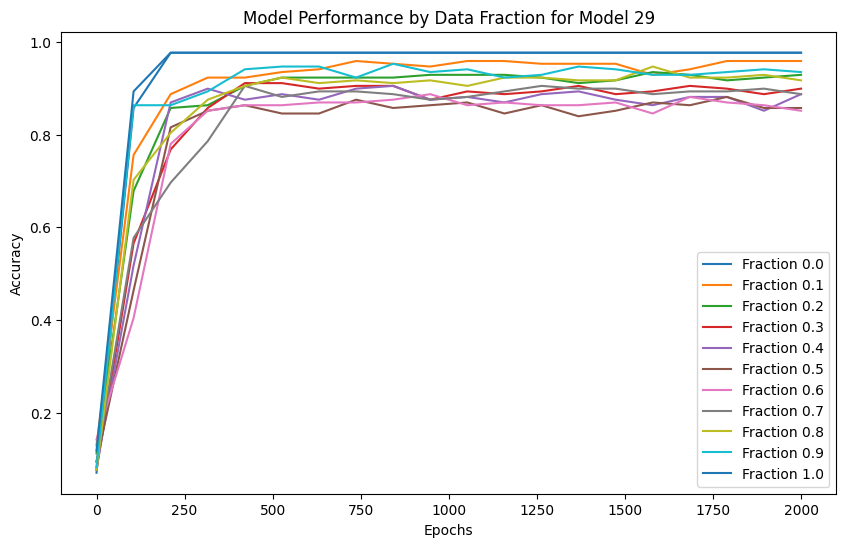

In [226]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 10
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB", # normal
    "JIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJI", # reverse
])     # between songs 0 overlap and 0 contradiction

for model_idx in range(num_models):
    model_dir = f"Songs_different_normal_reverse/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing 

In [279]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 10
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_normal_reverse"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB", # normal
    "JIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJI", # reverse
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0312
  Fraction 0.10, Average Accuracy: 0.7083
  Fraction 0.20, Average Accuracy: 0.7188
  Fraction 0.30, Average Accuracy: 0.7298
  Fraction 0.40, Average Accuracy: 0.7522
  Fraction 0.50, Average Accuracy: 0.8565
  Fraction 0.60, Average Accuracy: 0.9393
  Fraction 0.70, Average Accuracy: 0.9663
  Fraction 0.80, Average Accuracy: 0.9742
  Fraction 0.90, Average Accuracy: 0.9758
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9762
  Fraction 0.20, Average Accuracy: 0.9734
  Fraction 0.30, Average Accuracy: 0.9702
  Fraction 0.40, Average Accuracy: 0.9524
  Fraction 0.50, Average Accuracy: 0.8538
  Fraction 0.60, Average Accuracy: 0.7677
  Fraction 0.70, Average Accuracy: 0.7363
  Fraction 0.80, Average Accuracy: 0.7163
  Fraction 0.90, Average Accuracy: 0.7095
  Fraction 1.00, Average Accuracy: 0.0413


#### Plotting for transformers

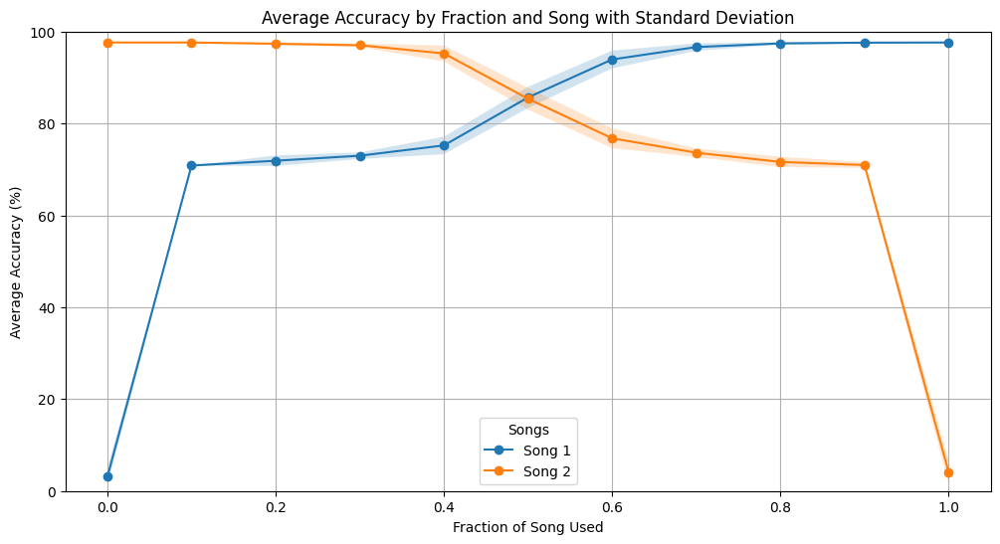

In [228]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plotting for decision tree

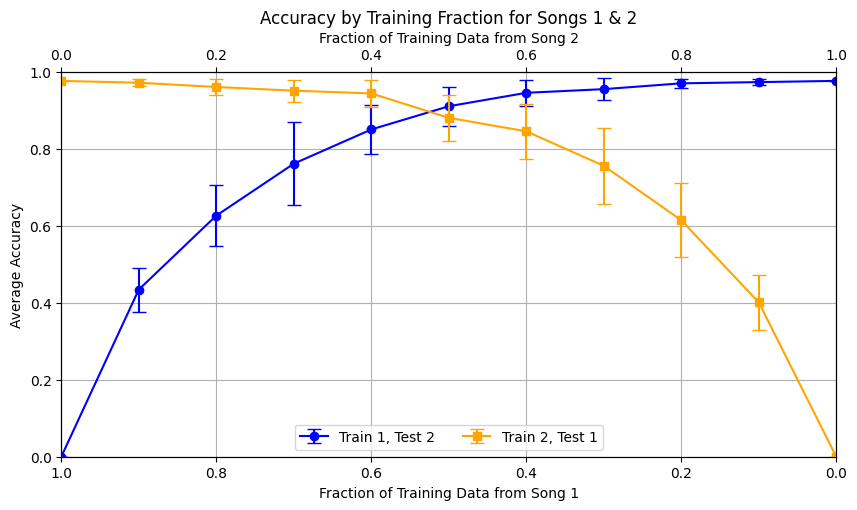

In [135]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 2), (2, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

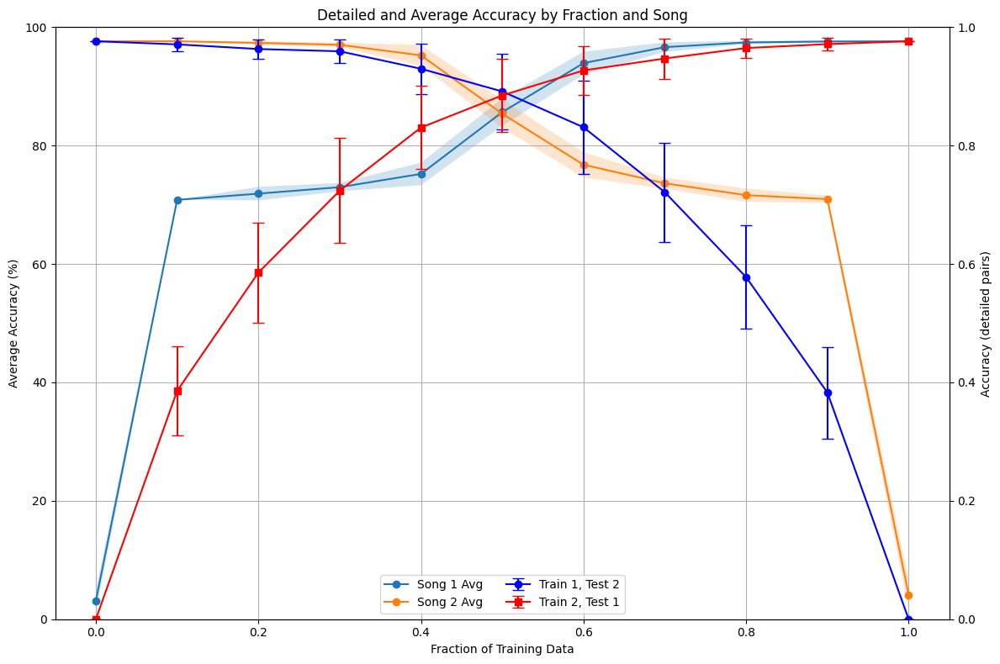

In [264]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


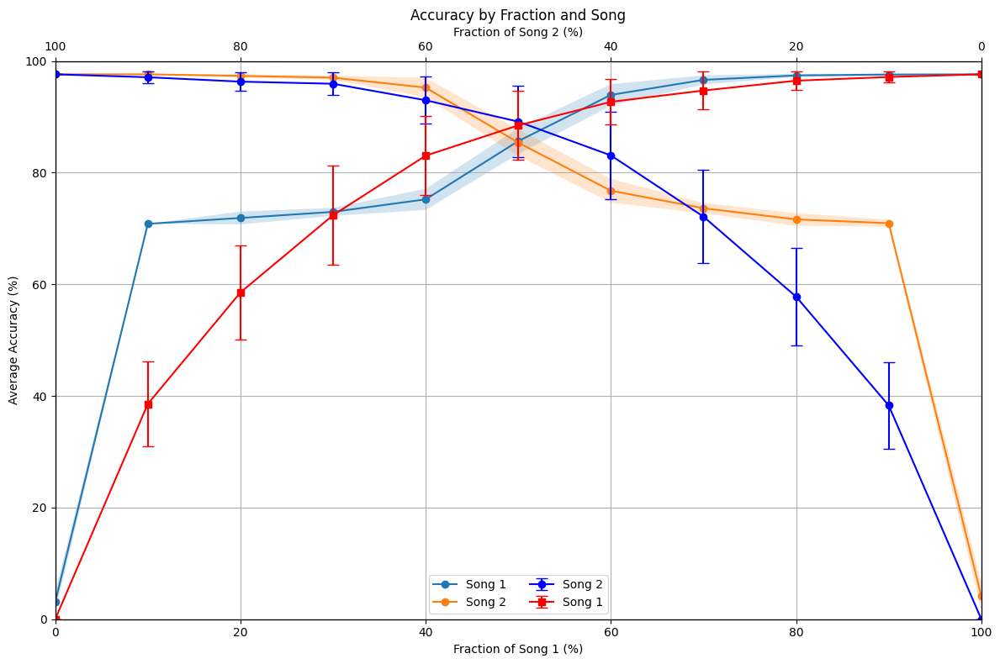

In [265]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Extract lines and labels from the plots
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()

# Specify custom labels as required
custom_labels = ['Song 1', 'Song 2', 'Song 2', 'Song 1']

# Combine the lines and custom labels
combined_lines = lines + lines2

# Update the legend with custom labels
ax1.legend(combined_lines, custom_labels, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


### Normal and reverse songs - 4,4,1 - S

#### Training

Model 0, Fraction 0.00, Epoch 1, Loss: 2.3237
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 101, Loss: 2.0134
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 201, Loss: 1.4957
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 1.1684
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.8792
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.6551
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4899
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.3626
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.2670
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.2092
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.1727
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.1483
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.1309
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1301, Loss: 0.1180
prediction sh

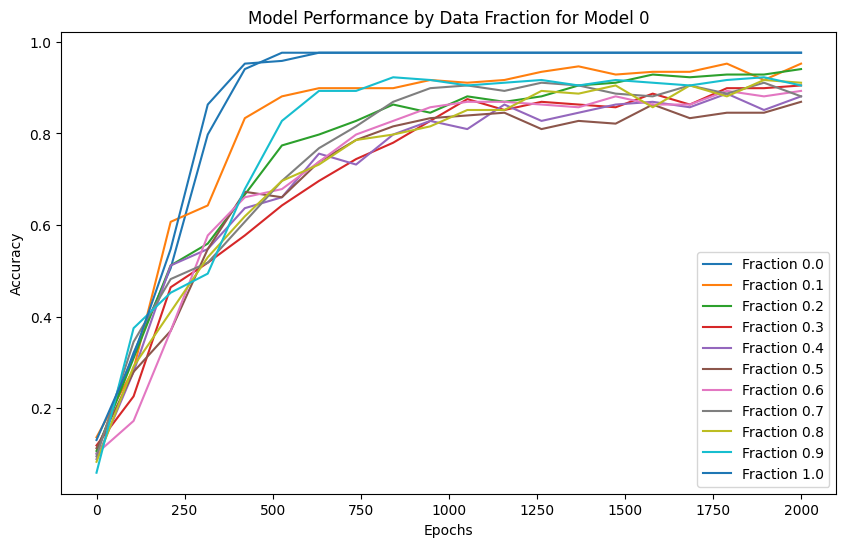

Model 1, Fraction 0.00, Epoch 1, Loss: 2.3026
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.9979
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.5000
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 1.1129
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.8230
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.6095
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.4380
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.3243
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.2502
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.2013
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.1678
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.1442
prediction shape 

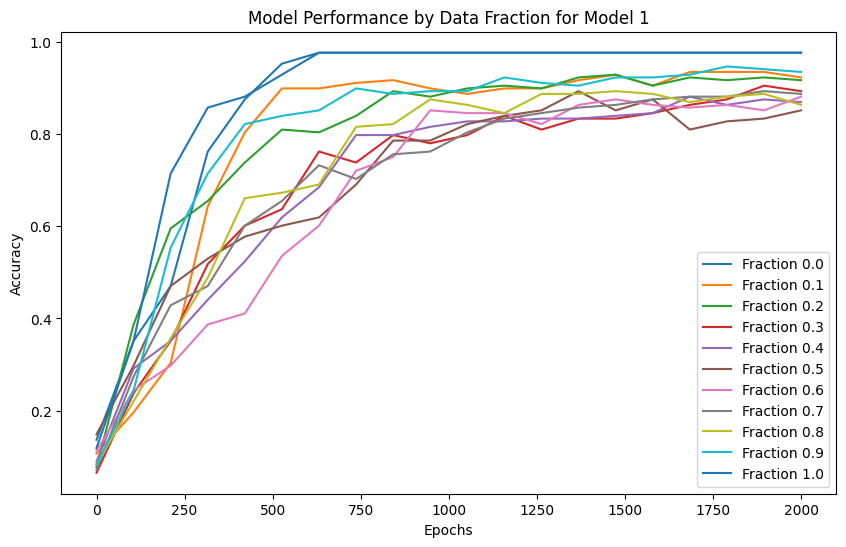

Model 2, Fraction 0.00, Epoch 1, Loss: 2.3193
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 2.0660
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.5854
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 1.1834
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.8714
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.6511
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.4899
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.3522
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.2565
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.1989
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.1626
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.1383
prediction shape 

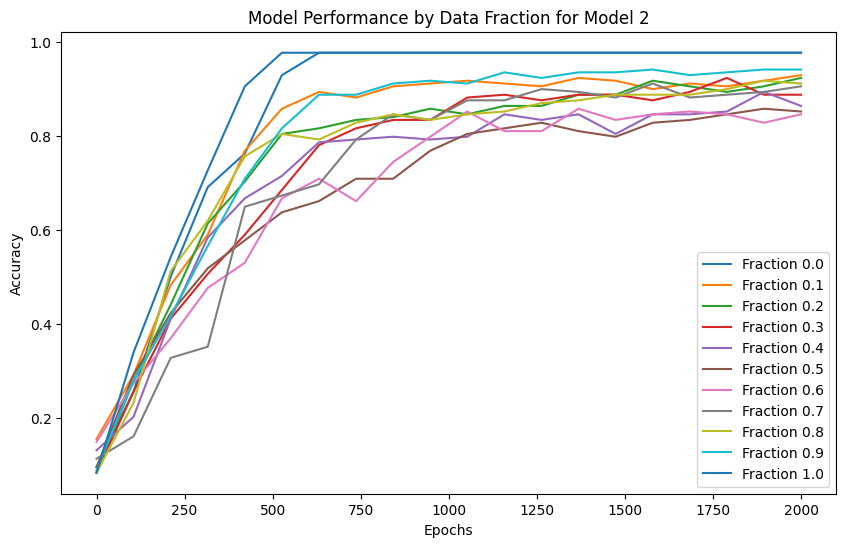

Model 3, Fraction 0.00, Epoch 1, Loss: 2.3212
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 2.0743
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.5204
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 1.1992
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.9138
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.6652
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.4793
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.3577
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.2739
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.2159
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.1764
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.1492
prediction shape 

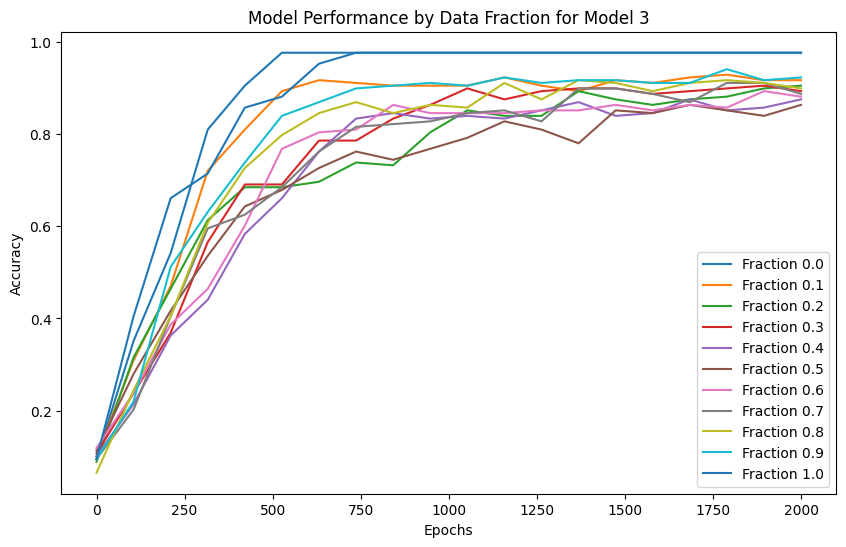

Model 4, Fraction 0.00, Epoch 1, Loss: 2.3094
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 2.0535
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.4806
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 1.1932
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 1.0273
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.8579
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.6527
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.4945
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.3614
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.2162
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.1636
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.1354
prediction shape 

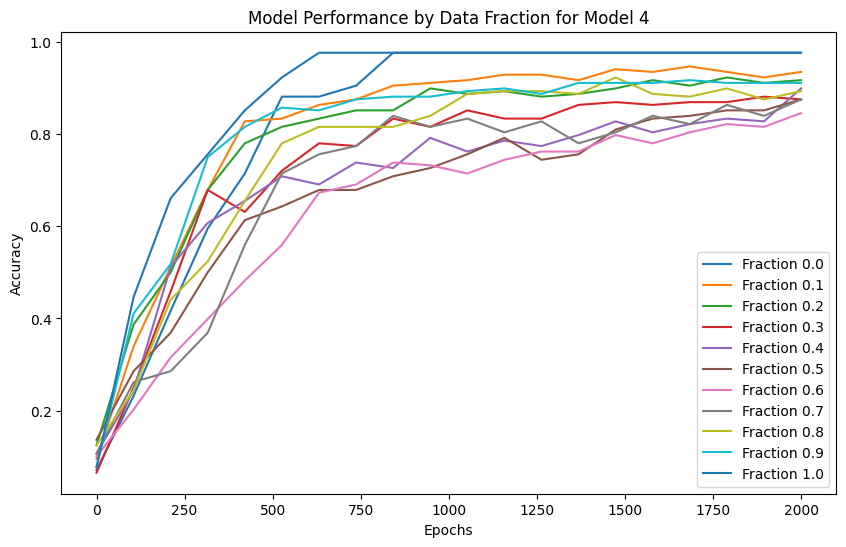

Model 5, Fraction 0.00, Epoch 1, Loss: 2.3073
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 2.0451
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.5694
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 1.1983
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.8663
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.6020
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.4263
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.3141
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.2437
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.1979
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.1665
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.1444
prediction shape 

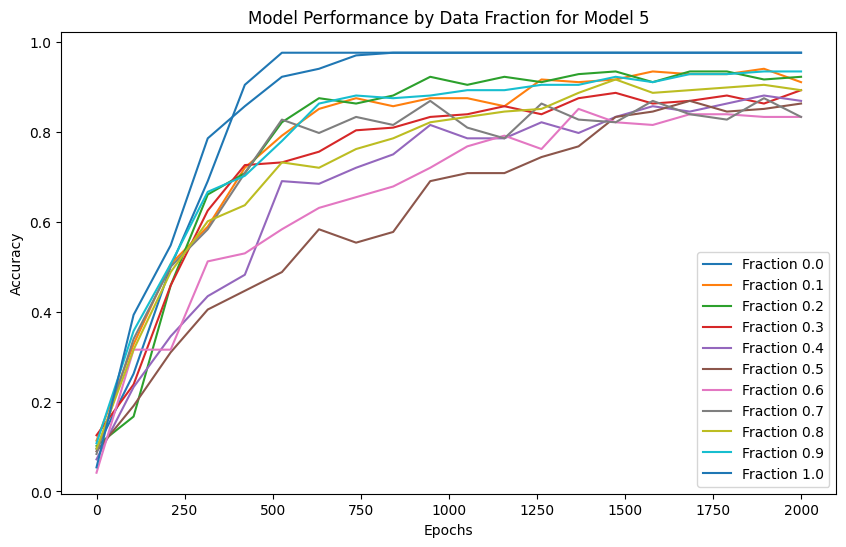

Model 6, Fraction 0.00, Epoch 1, Loss: 2.3119
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 2.0406
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.4596
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 1.1143
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.8160
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.5833
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4248
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.3169
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.2458
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.1998
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.1683
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.1458
prediction shape 

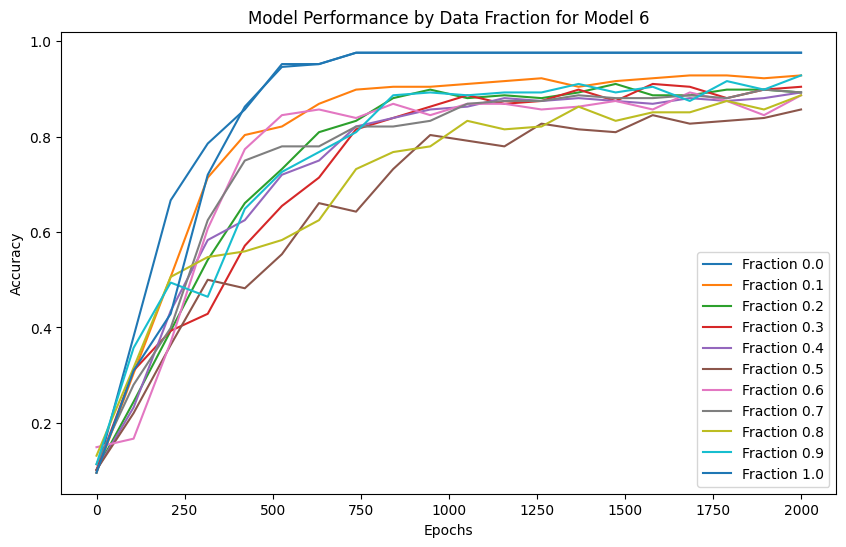

Model 7, Fraction 0.00, Epoch 1, Loss: 2.3068
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 2.0267
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.5078
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 1.2071
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.9053
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.6266
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.4464
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.3315
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.2572
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.2066
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.1705
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.1444
prediction shape 

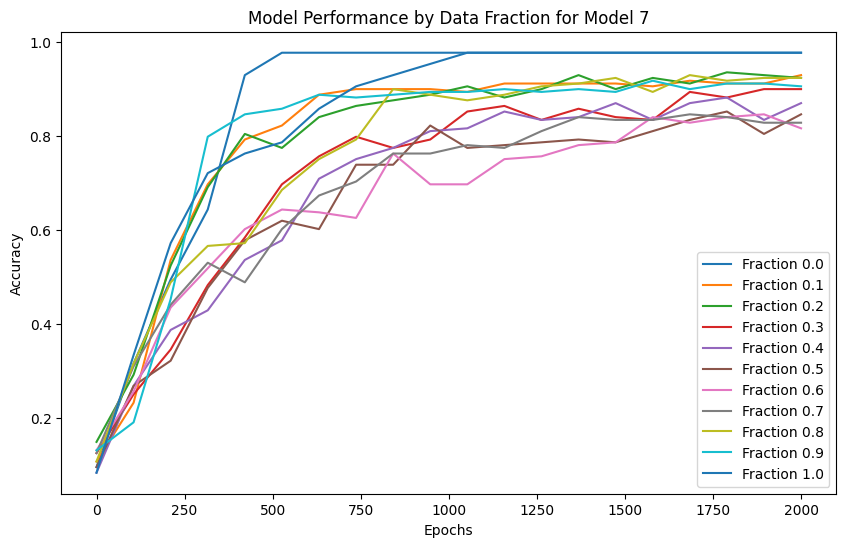

Model 8, Fraction 0.00, Epoch 1, Loss: 2.3040
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.9980
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.5006
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 1.1799
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.9065
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.6738
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.5158
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.3952
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.2938
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.2275
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.1838
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.1544
prediction shape 

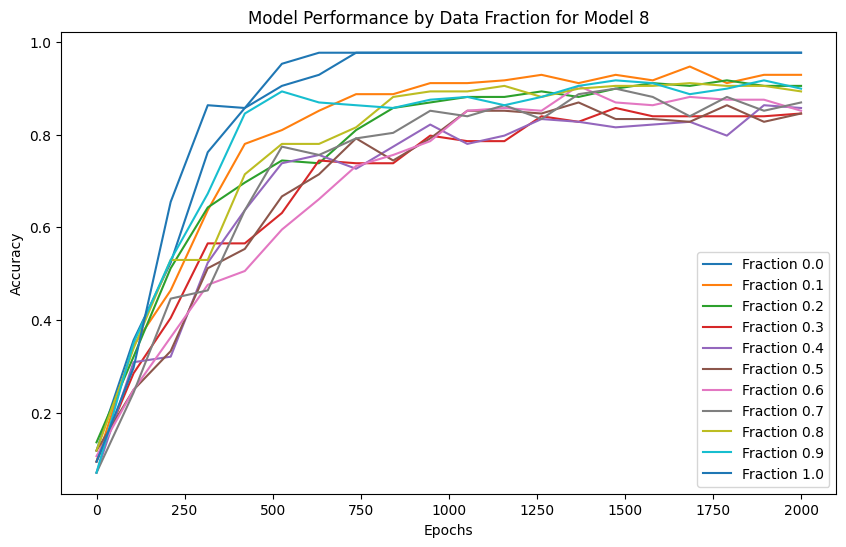

Model 9, Fraction 0.00, Epoch 1, Loss: 2.3133
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 2.0045
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.5070
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 1.1393
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.8358
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.6200
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.4559
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.3390
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.2619
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.2104
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.1749
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.1498
prediction shape 

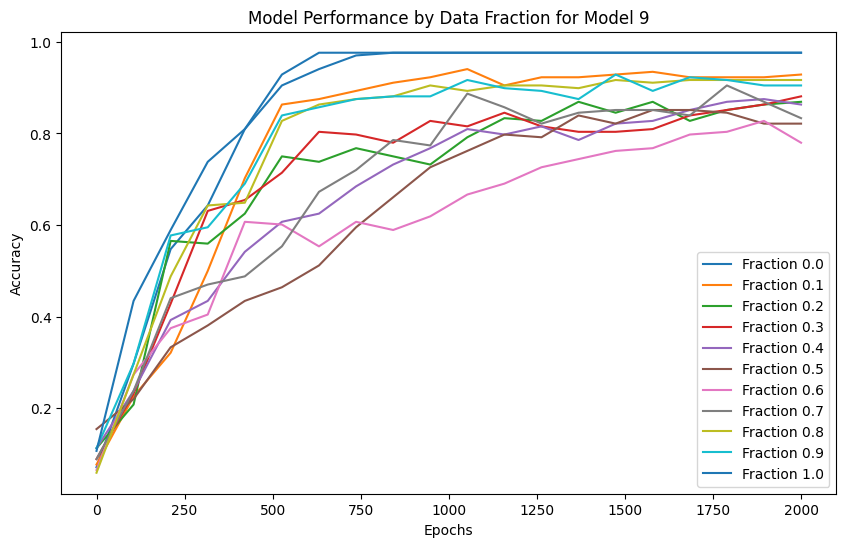

Model 10, Fraction 0.00, Epoch 1, Loss: 2.3128
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 2.0281
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.4744
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 1.1585
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.9219
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.7297
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.5647
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.4486
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.3523
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.2795
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.2097
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.1704
predi

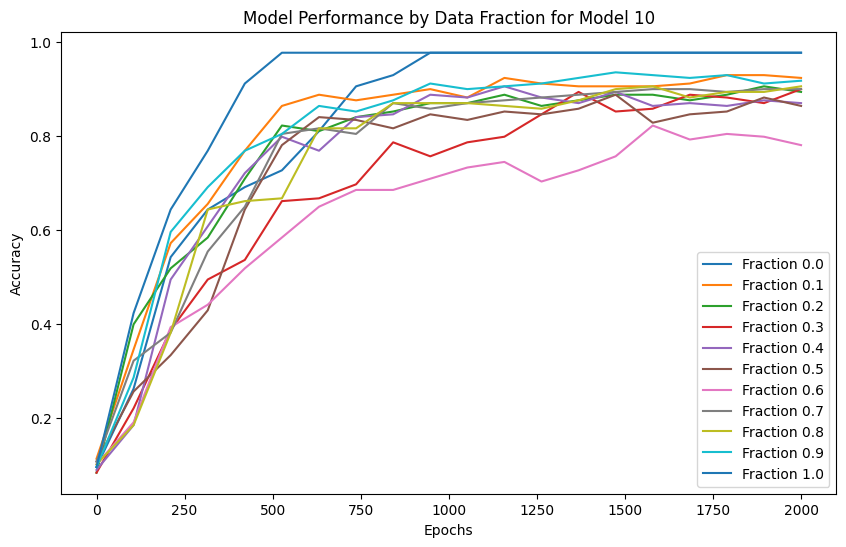

Model 11, Fraction 0.00, Epoch 1, Loss: 2.3100
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 2.0330
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.4647
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 1.1913
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 1.0044
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.8478
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.7207
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.5031
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.3389
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.2594
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.2093
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.1725
predi

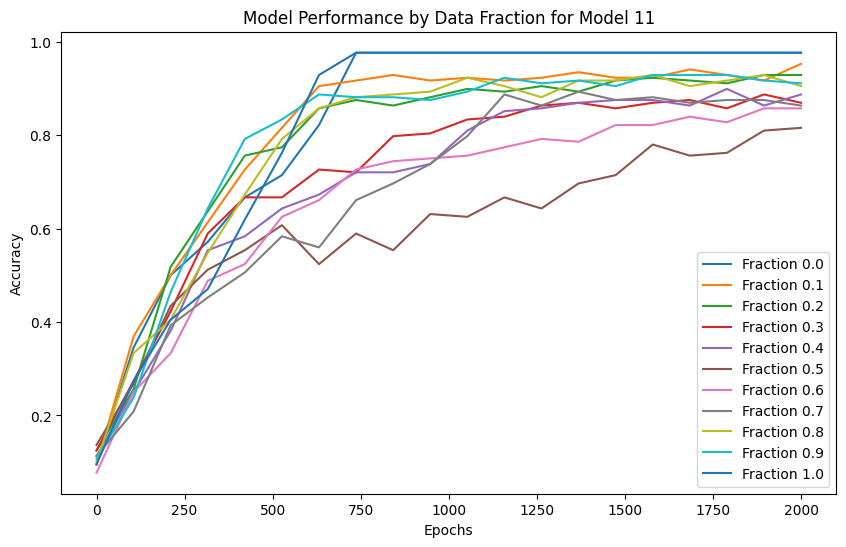

Model 12, Fraction 0.00, Epoch 1, Loss: 2.3068
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 2.0358
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.4230
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 1.0966
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.8272
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.6238
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.4830
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.3508
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.2662
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.2112
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.1740
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.1480
predi

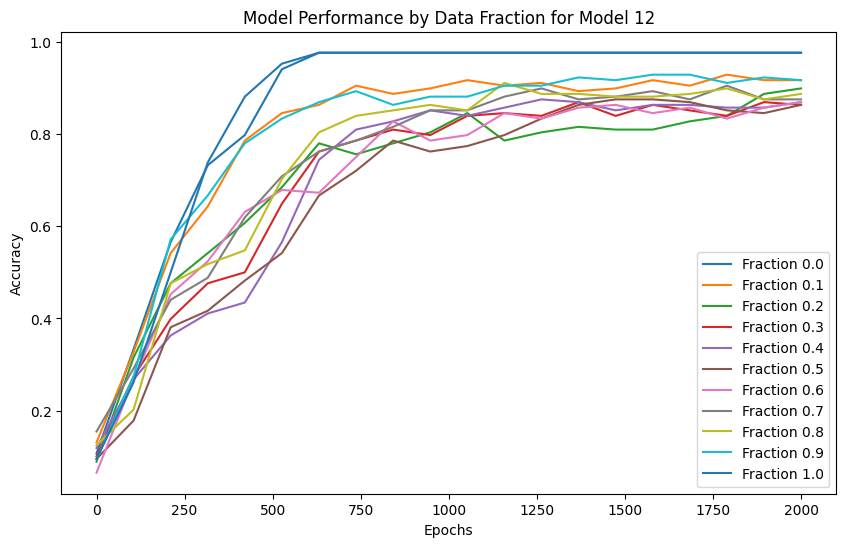

Model 13, Fraction 0.00, Epoch 1, Loss: 2.3156
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 2.0563
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.4661
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 1.1341
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.8436
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.6139
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.4461
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.3282
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.2548
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.2057
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.1716
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.1471
predi

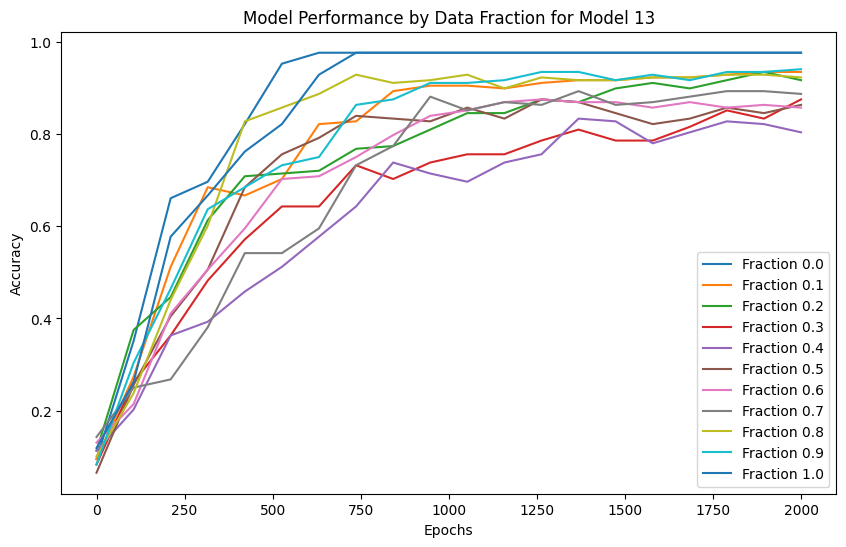

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2996
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.9550
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.4870
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 1.2182
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 1.0284
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.8351
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.6843
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.5317
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.4184
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.3364
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.2750
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.2297
predi

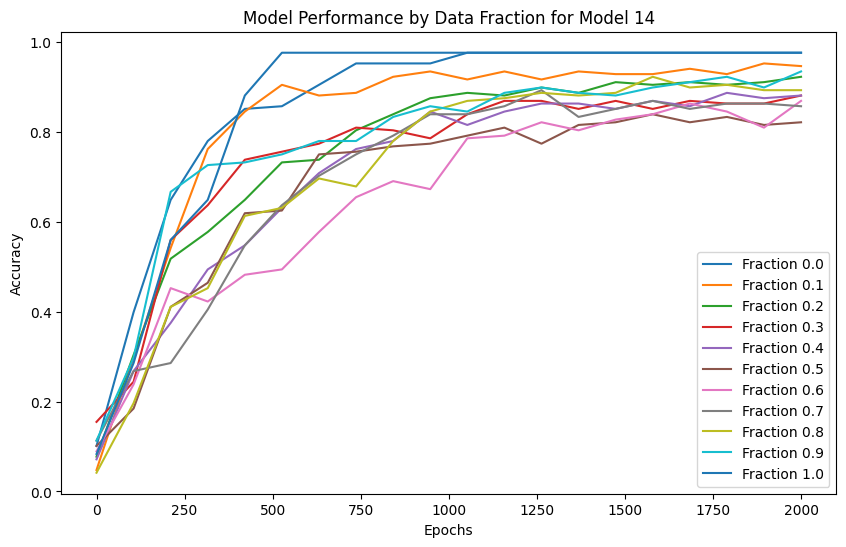

Model 15, Fraction 0.00, Epoch 1, Loss: 2.3101
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.9909
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.4407
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 1.1708
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.9747
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.7850
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.5954
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.4240
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.3081
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.2203
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.1749
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.1476
predi

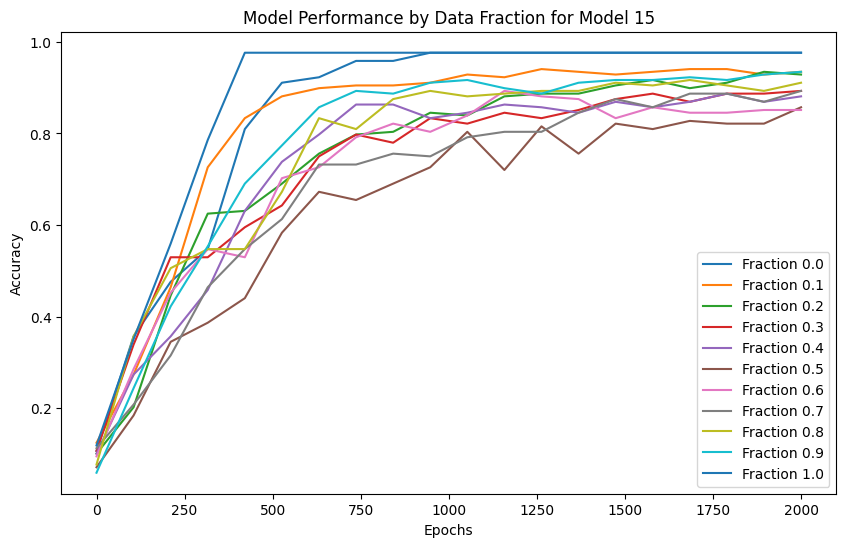

Model 16, Fraction 0.00, Epoch 1, Loss: 2.3016
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.9889
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.4680
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 1.1822
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.9603
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.7742
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.6311
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.5150
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.4070
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.3003
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.2221
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.1755
predi

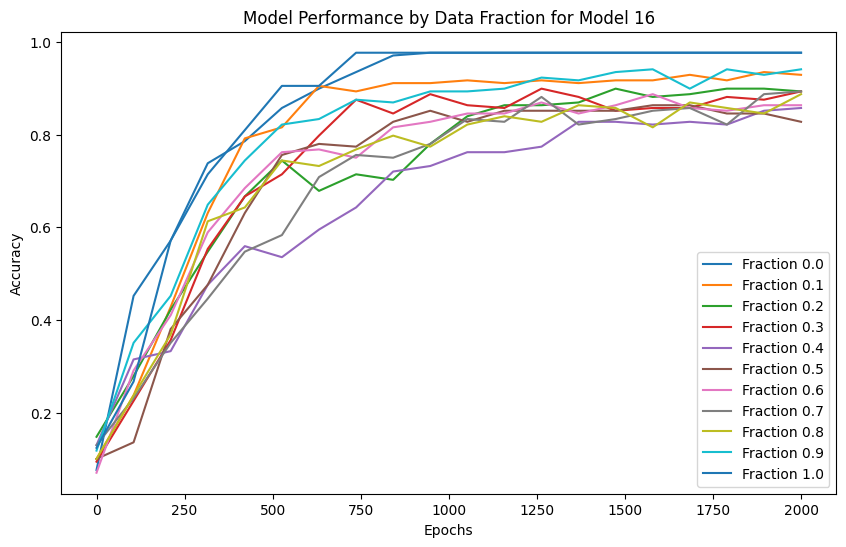

Model 17, Fraction 0.00, Epoch 1, Loss: 2.3027
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.9412
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.4087
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 1.0800
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.8374
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.6274
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.4767
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.3678
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.2849
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.2278
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.1887
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.1610
predi

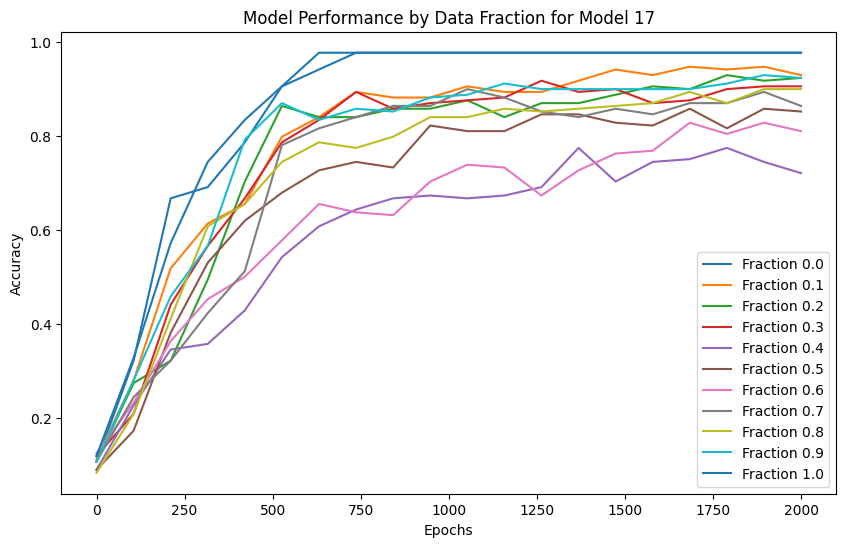

Model 18, Fraction 0.00, Epoch 1, Loss: 2.3131
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 2.0246
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.4968
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 1.1272
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.8327
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.6164
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.4690
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.3522
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.2681
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.2104
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.1716
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.1454
predi

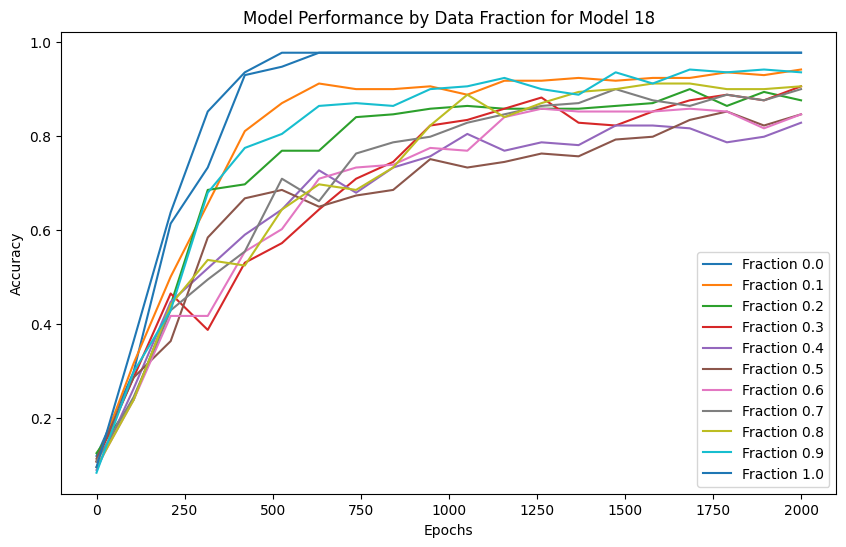

Model 19, Fraction 0.00, Epoch 1, Loss: 2.3059
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.9778
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.6053
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 1.3033
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.9894
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.7175
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.5130
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.3607
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.2678
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.2082
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.1713
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.1464
predi

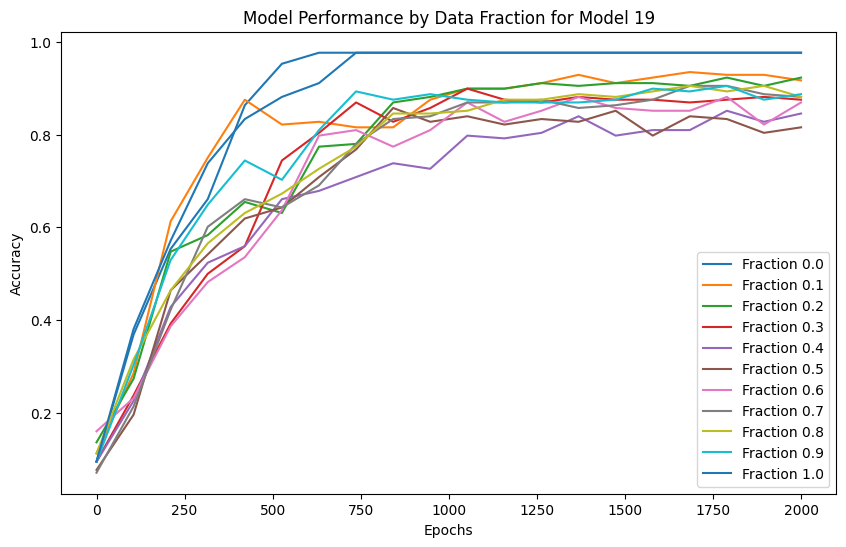

Model 20, Fraction 0.00, Epoch 1, Loss: 2.3008
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.9212
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.4421
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 1.1042
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.8013
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.5902
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4440
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.3399
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.2567
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.1966
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.1592
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.1357
predi

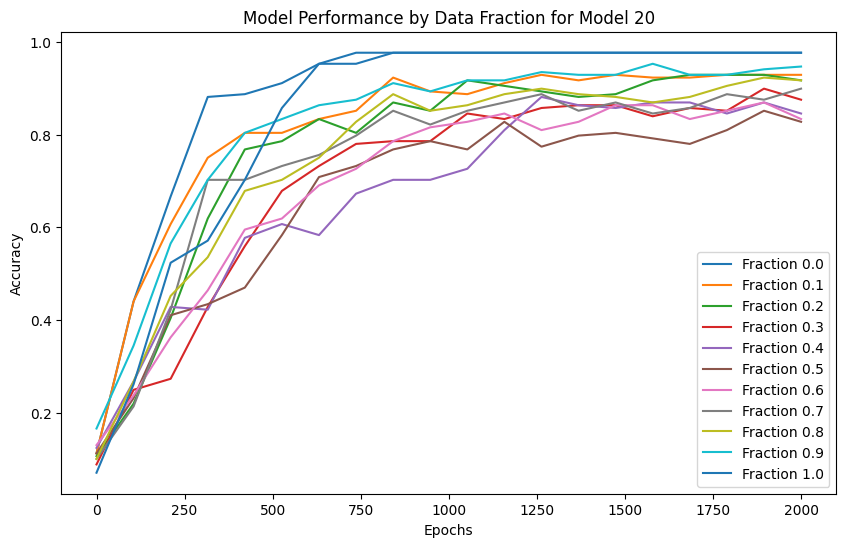

Model 21, Fraction 0.00, Epoch 1, Loss: 2.3102
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 2.0089
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.4746
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 1.1245
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.8145
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.5656
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.4171
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.3177
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.2484
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.2012
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.1685
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.1456
predi

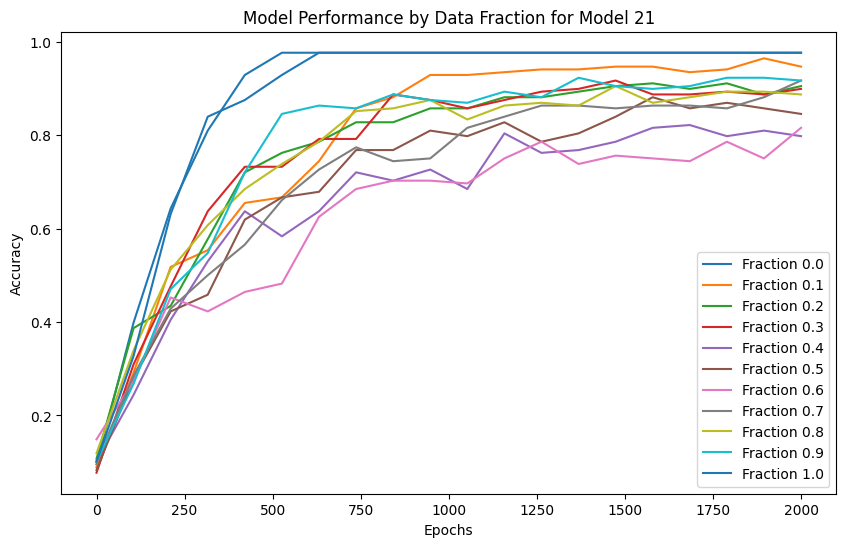

Model 22, Fraction 0.00, Epoch 1, Loss: 2.3061
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.9492
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.4973
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 1.1345
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.8178
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.5909
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.4363
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.3310
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.2590
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.2099
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.1754
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.1504
predi

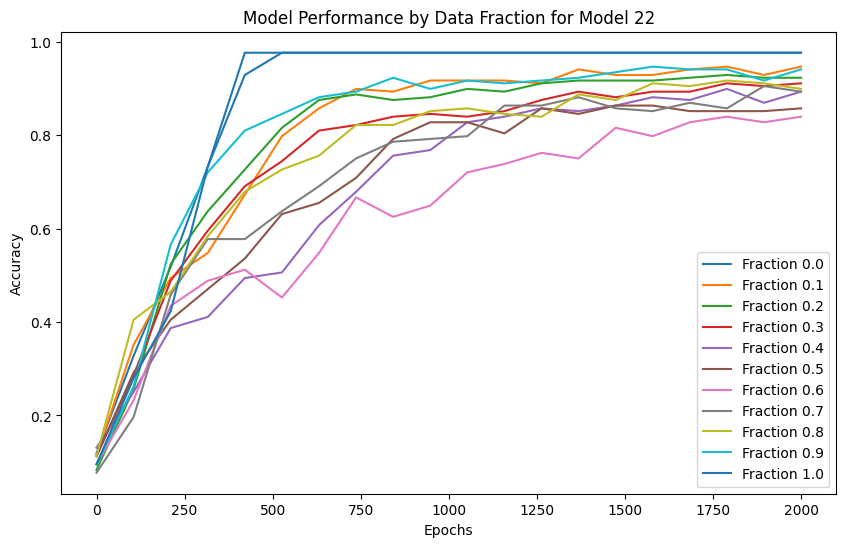

Model 23, Fraction 0.00, Epoch 1, Loss: 2.3047
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 2.0086
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.4400
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 1.0285
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.8060
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.6341
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.4539
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.3348
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.2599
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.2097
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.1750
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.1504
predi

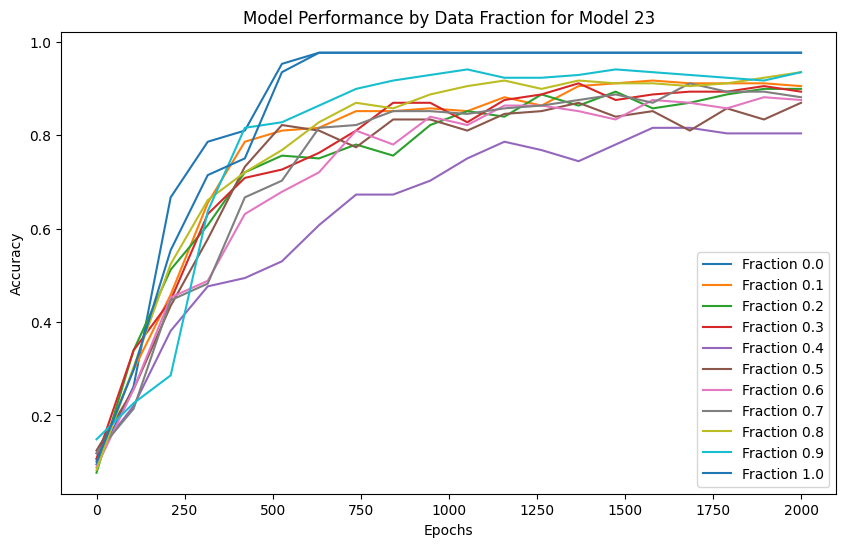

Model 24, Fraction 0.00, Epoch 1, Loss: 2.3021
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.9024
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.4657
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 1.2168
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.9477
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.7211
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.5313
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.3744
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.2661
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.2078
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.1709
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.1459
predi

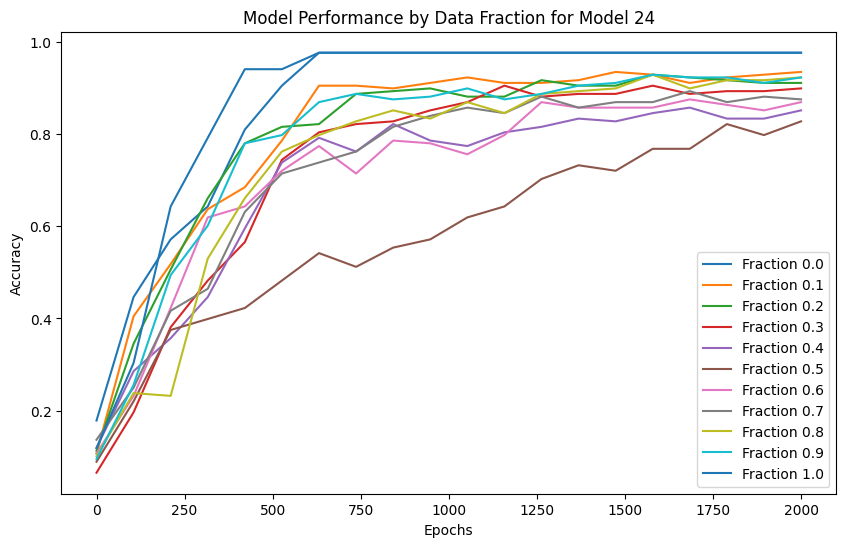

Model 25, Fraction 0.00, Epoch 1, Loss: 2.3115
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 2.0466
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.5347
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 1.1577
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.8425
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.6137
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.4333
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.3136
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.2408
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.1946
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.1633
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.1412
predi

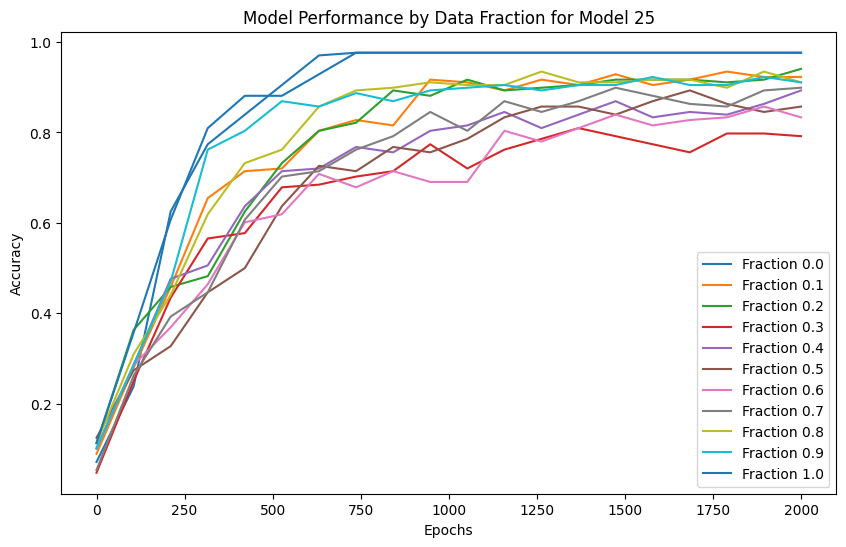

Model 26, Fraction 0.00, Epoch 1, Loss: 2.3112
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 2.0752
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.5627
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 1.1838
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.9226
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.7250
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.5261
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.3852
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.2668
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.1947
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.1569
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.1333
predi

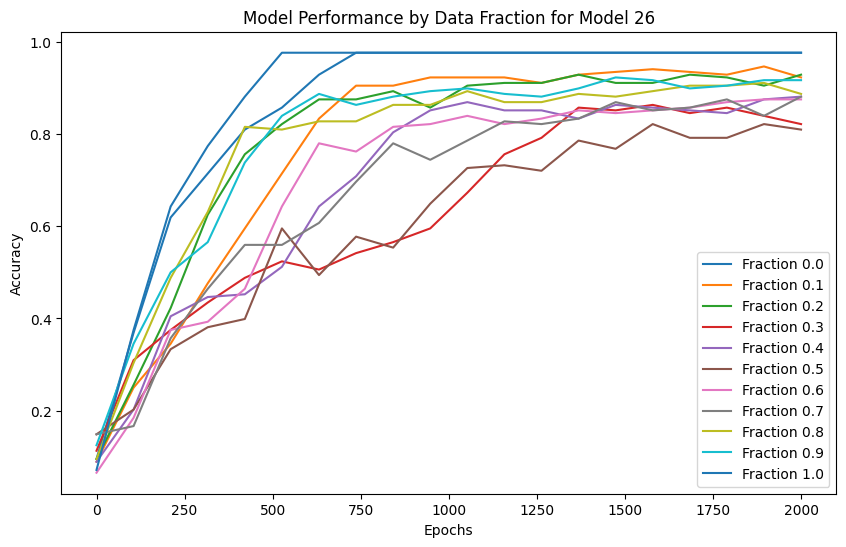

Model 27, Fraction 0.00, Epoch 1, Loss: 2.3114
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 2.0570
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.3950
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 1.0027
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.7674
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.6093
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4939
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.4046
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.3146
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.2350
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.1874
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.1561
predi

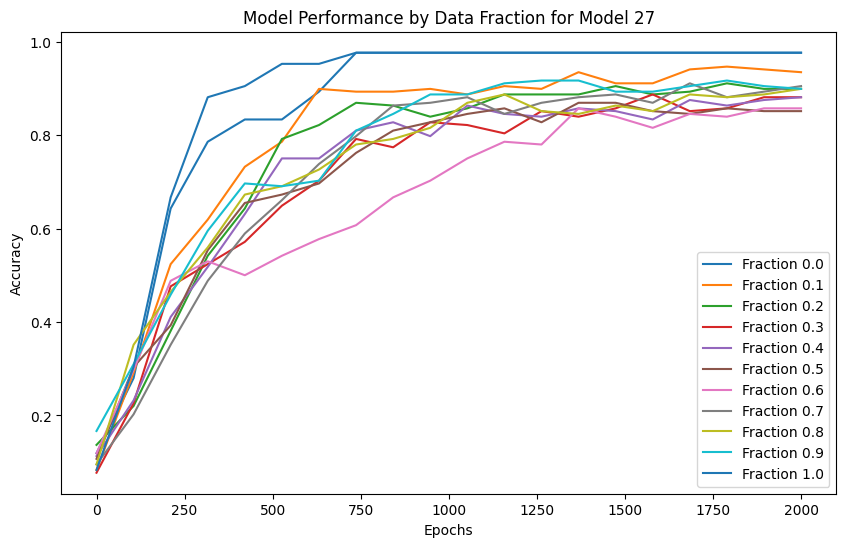

Model 28, Fraction 0.00, Epoch 1, Loss: 2.3050
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.9953
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.4699
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 1.2079
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.9992
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.7677
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.5416
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.3613
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.2527
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.1942
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.1590
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.1358
predi

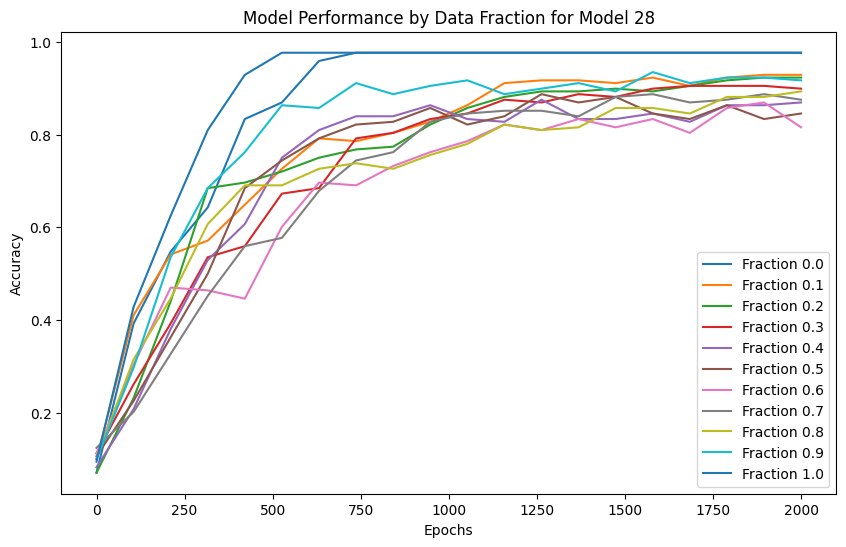

Model 29, Fraction 0.00, Epoch 1, Loss: 2.3123
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.9499
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.5084
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 1.2441
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 1.0509
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.7906
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.5551
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.4252
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.3259
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.2432
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.1892
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.1540
predi

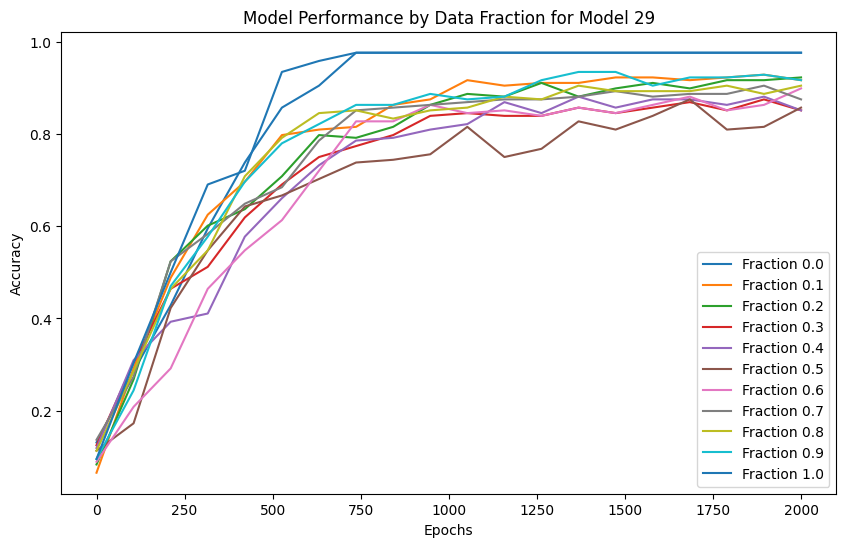

In [231]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 10
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB", # normal
    "JIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJI", # reverse
])

for model_idx in range(num_models):
    model_dir = f"Songs_different_normal_reverse_lower_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [253]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 10
emsize = 4
nhead = 2
d_hid = 4
nlayers = 1
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_normal_reverse_lower_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB", # normal
    "JIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJI", # reverse
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0397
  Fraction 0.10, Average Accuracy: 0.4948
  Fraction 0.20, Average Accuracy: 0.6460
  Fraction 0.30, Average Accuracy: 0.6837
  Fraction 0.40, Average Accuracy: 0.7194
  Fraction 0.50, Average Accuracy: 0.8397
  Fraction 0.60, Average Accuracy: 0.9256
  Fraction 0.70, Average Accuracy: 0.9619
  Fraction 0.80, Average Accuracy: 0.9724
  Fraction 0.90, Average Accuracy: 0.9756
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9752
  Fraction 0.20, Average Accuracy: 0.9738
  Fraction 0.30, Average Accuracy: 0.9593
  Fraction 0.40, Average Accuracy: 0.9413
  Fraction 0.50, Average Accuracy: 0.8452
  Fraction 0.60, Average Accuracy: 0.7377
  Fraction 0.70, Average Accuracy: 0.7058
  Fraction 0.80, Average Accuracy: 0.6639
  Fraction 0.90, Average Accuracy: 0.5423
  Fraction 1.00, Average Accuracy: 0.0419


#### plot of transformer

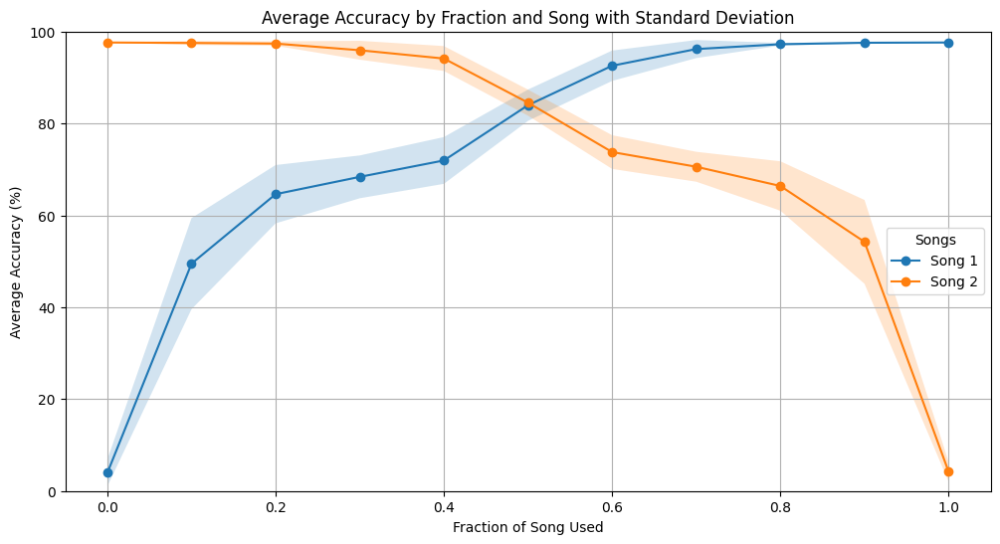

In [233]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot of Decision tree

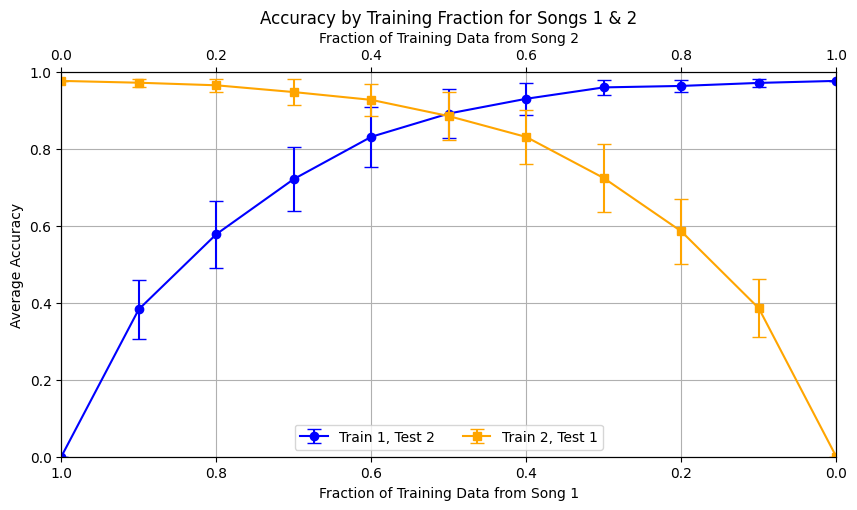

In [234]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 2), (2, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combines plot

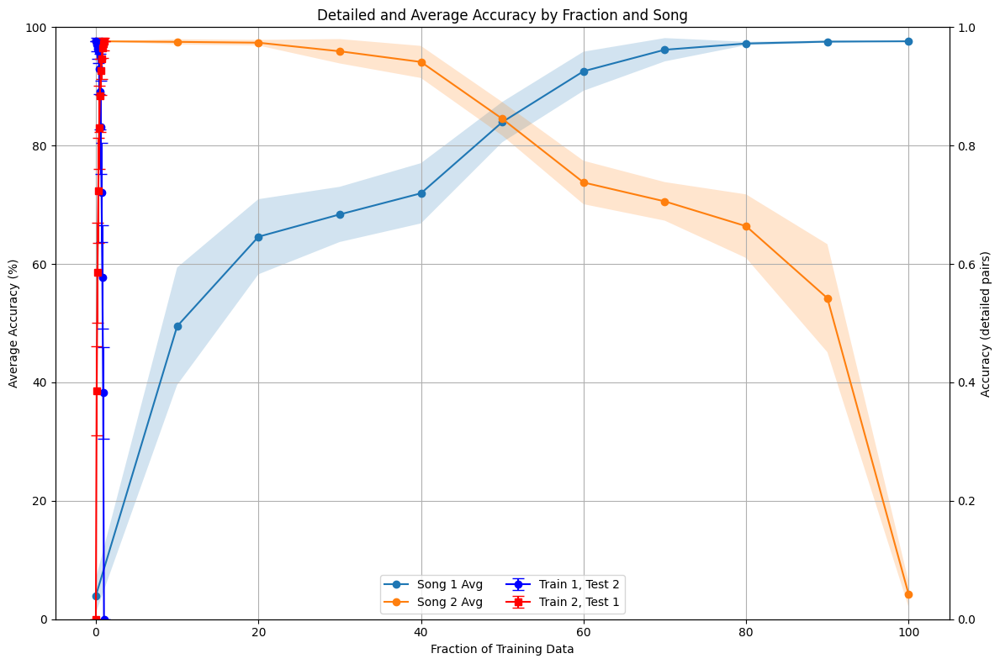

In [261]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


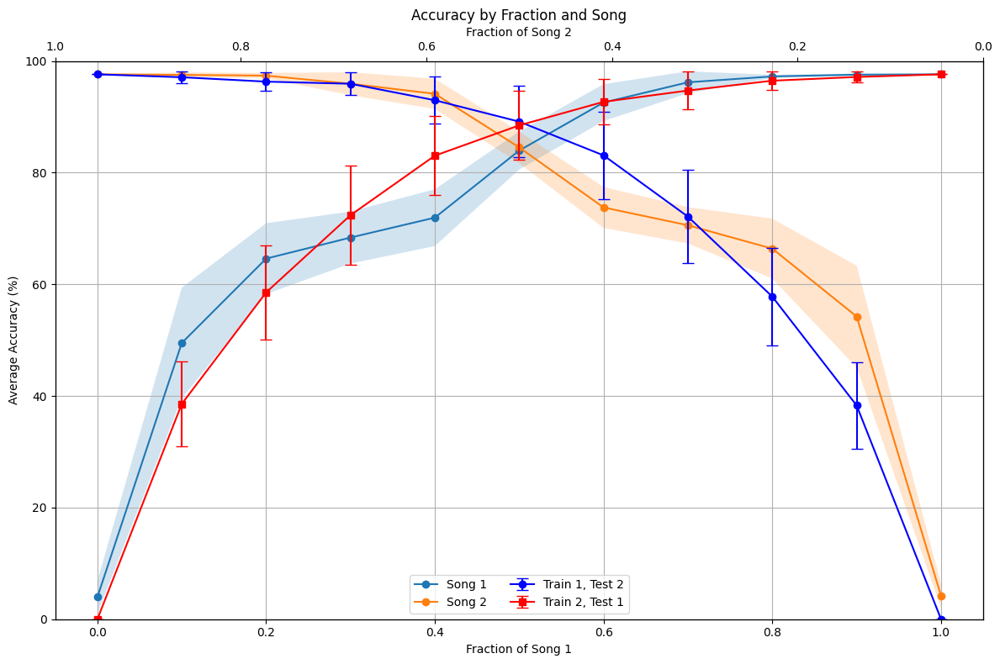

In [236]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1}')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Song 1')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Hide the secondary y-axis labels and ticks
ax2.yaxis.set_visible(False)

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Song 2')
ax3.set_xlim(1, 0)  # Set limits to invert the secondary x-axis

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


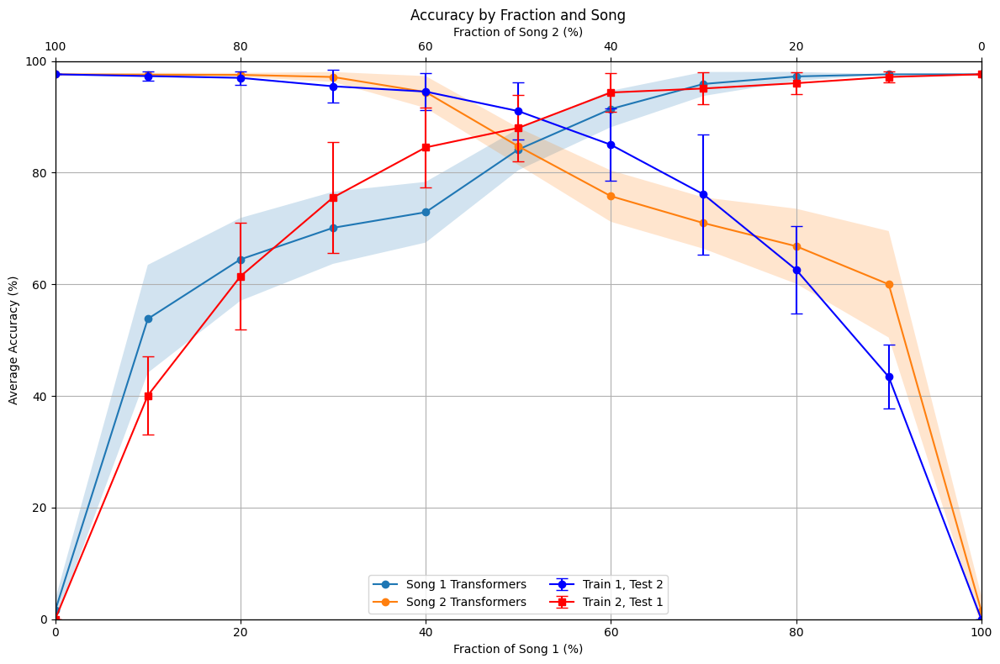

In [140]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1}')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
lines3, labels3 = ax3.get_legend_handles_labels()
ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


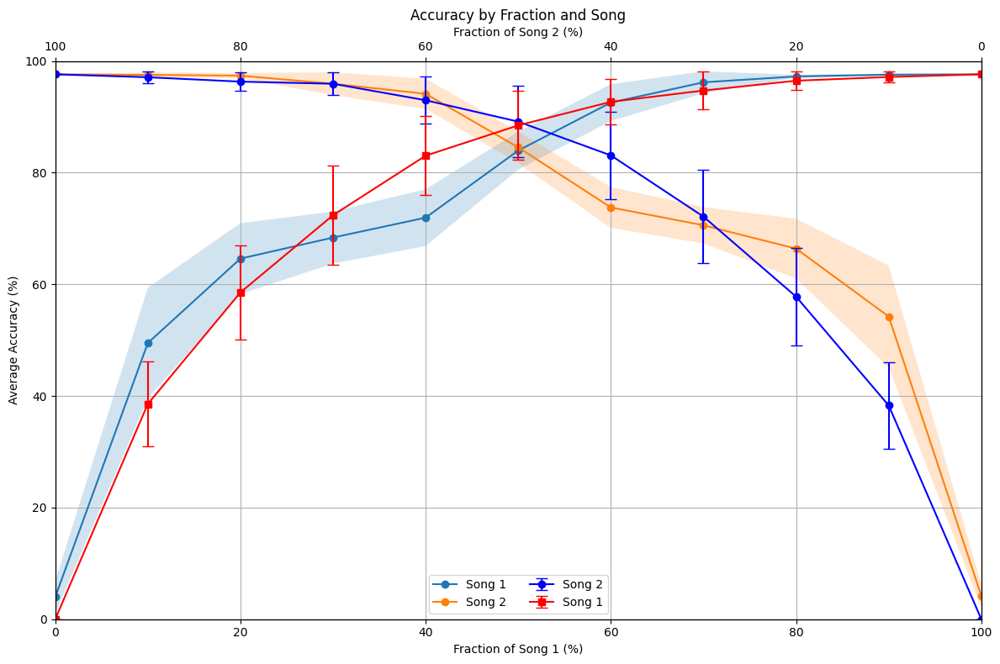

In [262]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1}')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction of Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Extract lines and labels from the plots
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()

# Specify custom labels as required
custom_labels = ['Song 1', 'Song 2', 'Song 2', 'Song 1']

# Combine the lines and custom labels
combined_lines = lines + lines2

# Update the legend with custom labels
ax1.legend(combined_lines, custom_labels, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()

### Normal and reverse songs - 16,16,4 - L

#### Training

Model 0, Fraction 0.00, Epoch 1, Loss: 2.3168
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 0.6960
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 0.2161
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.1208
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.0912
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.0716
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.0676
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.0650
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.0634
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.0620
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.0610
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.0603
prediction sha

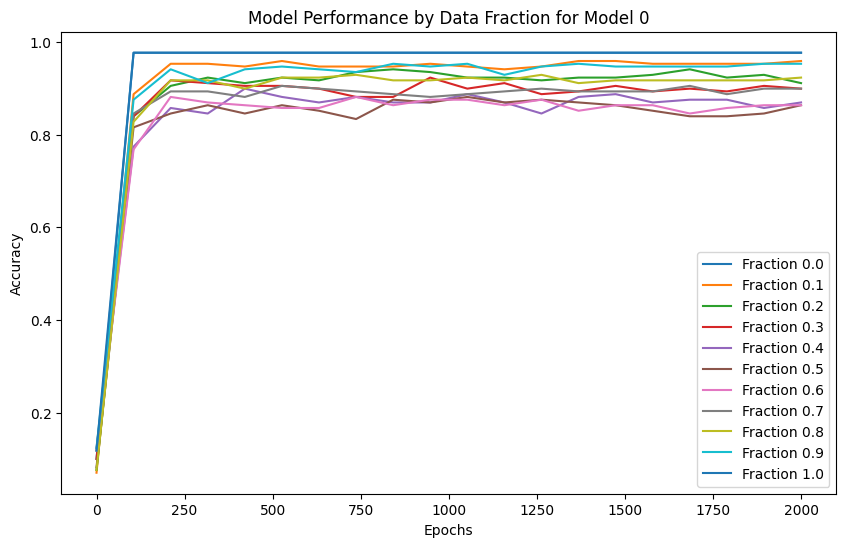

Model 1, Fraction 0.00, Epoch 1, Loss: 2.3320
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 0.6445
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 0.2050
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.1183
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.0904
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.0779
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.0714
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.0674
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.0648
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.0631
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.0618
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.0609
prediction shape 

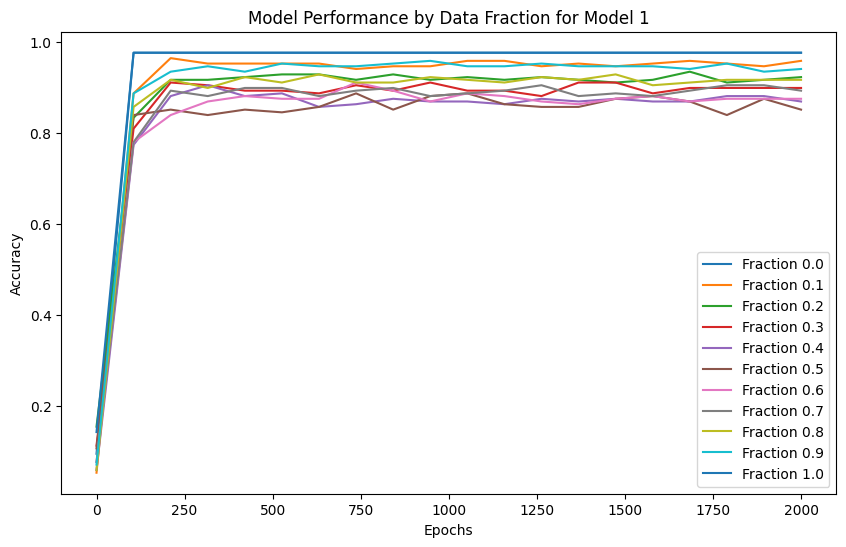

Model 2, Fraction 0.00, Epoch 1, Loss: 2.3188
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 0.6672
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 0.2282
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.1284
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.0952
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.0806
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.0729
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.0683
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.0655
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.0635
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.0621
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.0611
prediction shape 

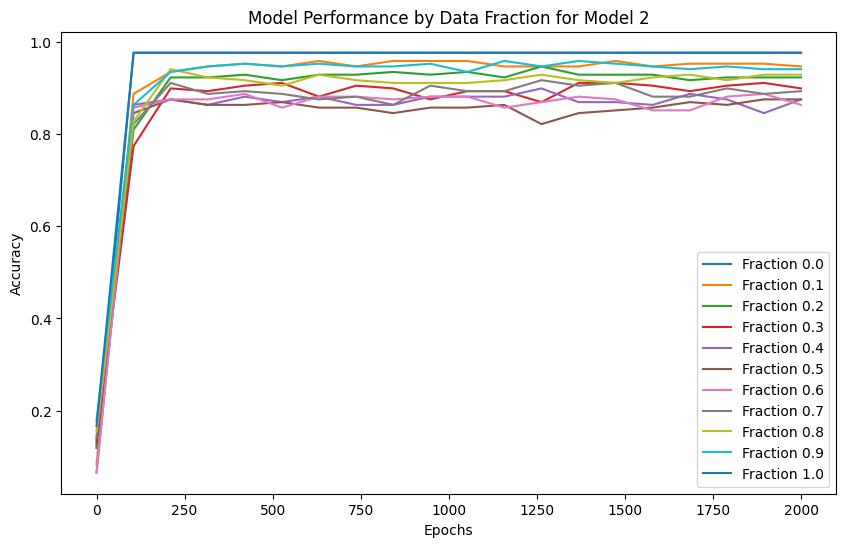

Model 3, Fraction 0.00, Epoch 1, Loss: 2.3319
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 0.6414
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 0.2121
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.1223
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.0919
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.0714
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.0673
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.0647
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.0629
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.0617
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.0608
prediction shape 

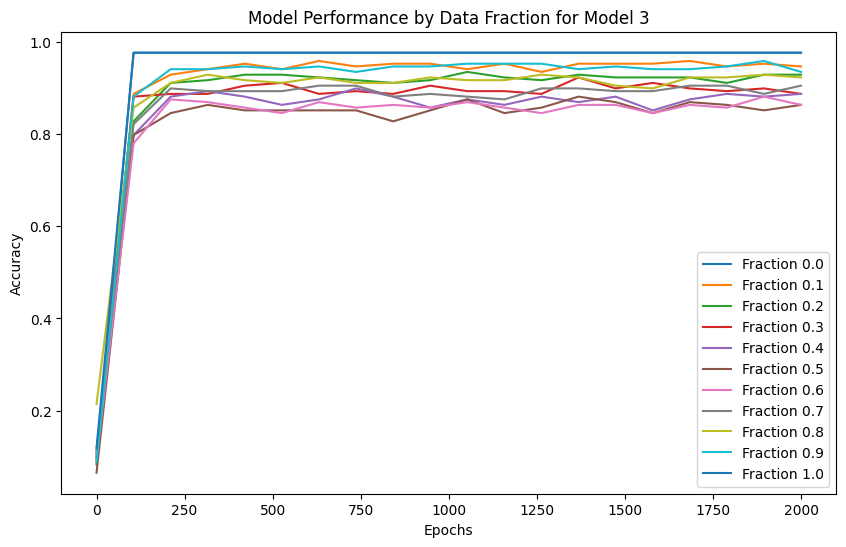

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2858
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 0.6298
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 0.2064
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.1183
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.0902
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.0778
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.0713
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.0675
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.0648
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.0631
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.0619
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.0610
prediction shape 

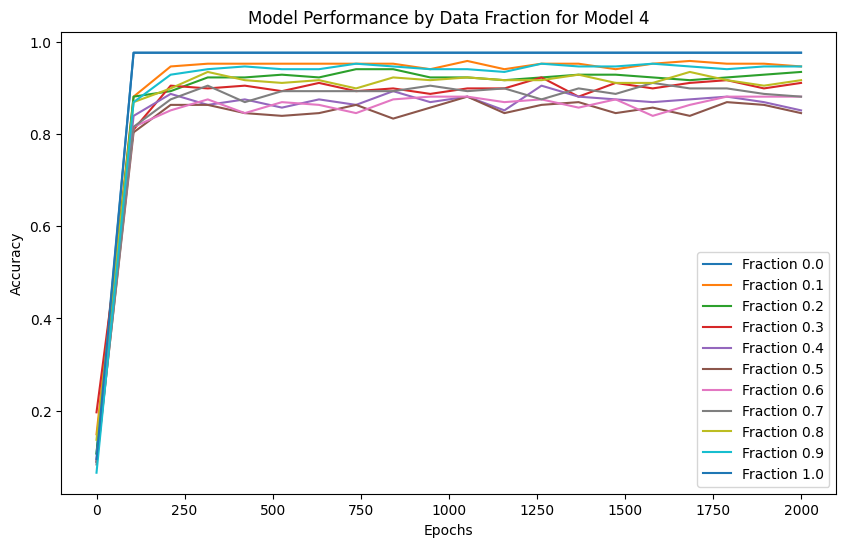

Model 5, Fraction 0.00, Epoch 1, Loss: 2.2962
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 0.6775
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 0.2151
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.1223
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.0926
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.0794
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.0724
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.0682
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.0655
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.0636
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.0623
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.0613
prediction shape 

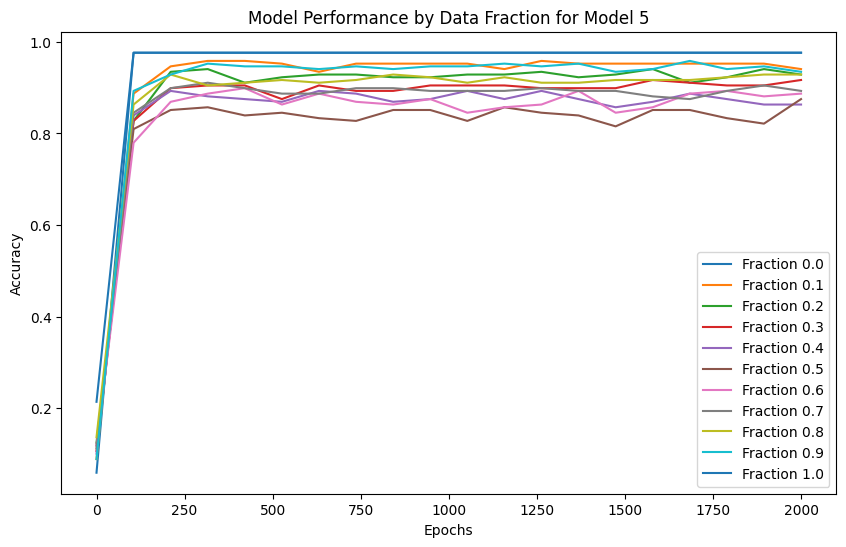

Model 6, Fraction 0.00, Epoch 1, Loss: 2.3415
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 0.6421
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 0.2124
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.1221
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.0925
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.0723
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.0681
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.0654
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.0635
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.0624
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.0612
prediction shape 

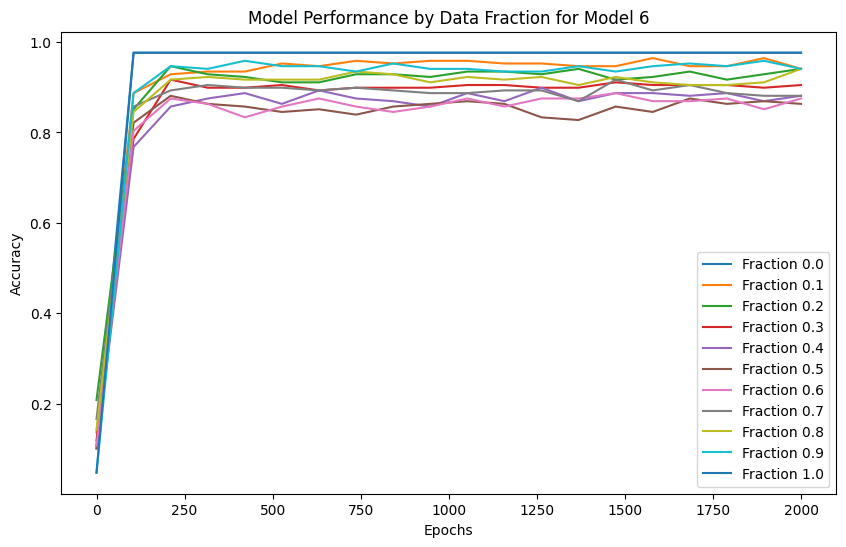

Model 7, Fraction 0.00, Epoch 1, Loss: 2.2989
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 0.6157
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 0.1953
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.1150
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.0890
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.0773
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.0710
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.0672
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.0648
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.0631
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.0618
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.0609
prediction shape 

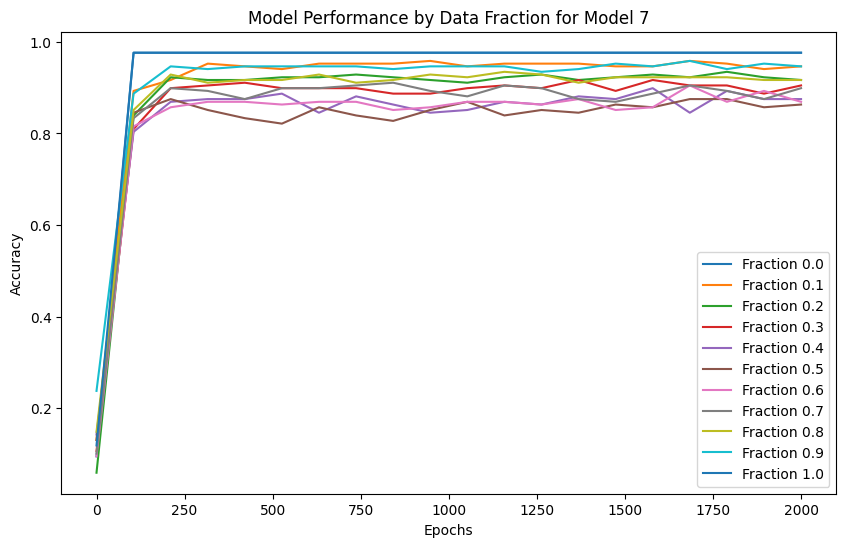

Model 8, Fraction 0.00, Epoch 1, Loss: 2.3442
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 0.6966
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 0.2227
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.1242
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.0927
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.0791
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.0720
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.0678
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.0651
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.0632
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.0620
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.0611
prediction shape 

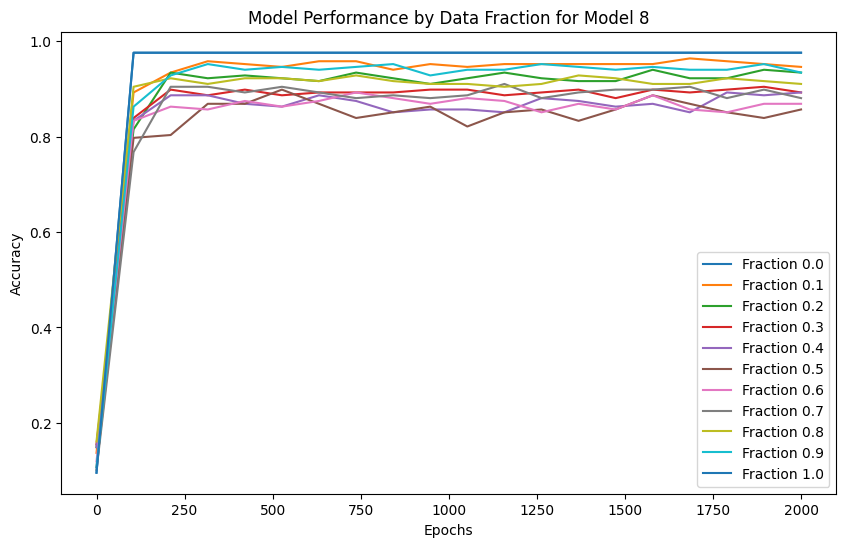

Model 9, Fraction 0.00, Epoch 1, Loss: 2.3229
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 0.7237
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 0.2220
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.1234
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.0926
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.0792
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.0721
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.0681
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.0660
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.0634
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.0621
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.0612
prediction shape 

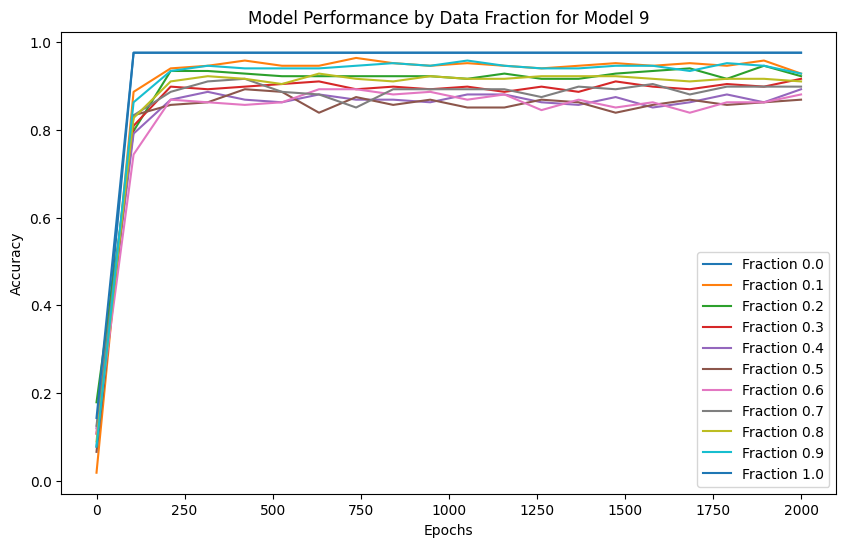

Model 10, Fraction 0.00, Epoch 1, Loss: 2.3015
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 0.7648
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 0.2229
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.1224
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.0919
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.0719
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.0679
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.0652
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.0634
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.0621
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.0612
predi

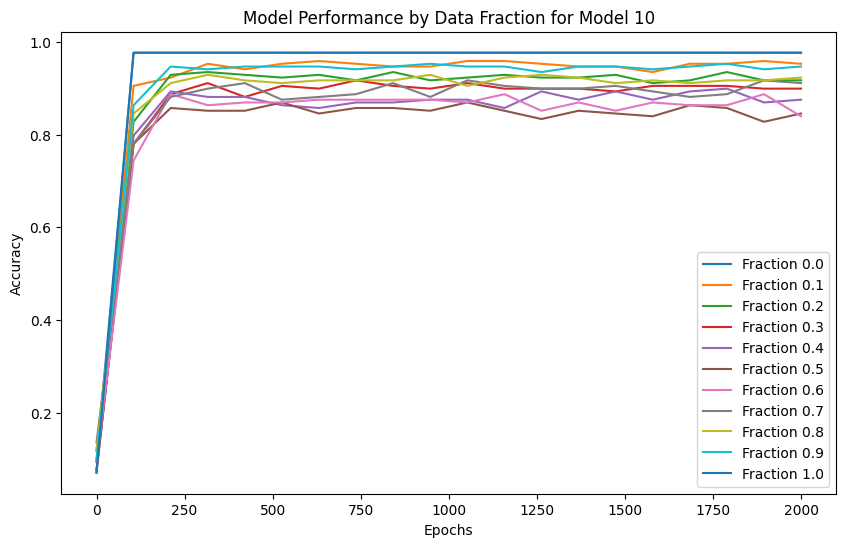

Model 11, Fraction 0.00, Epoch 1, Loss: 2.3615
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 0.7432
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 0.2204
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.1222
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.0920
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.0786
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.0716
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.0676
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.0650
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.0632
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.0619
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.0610
predi

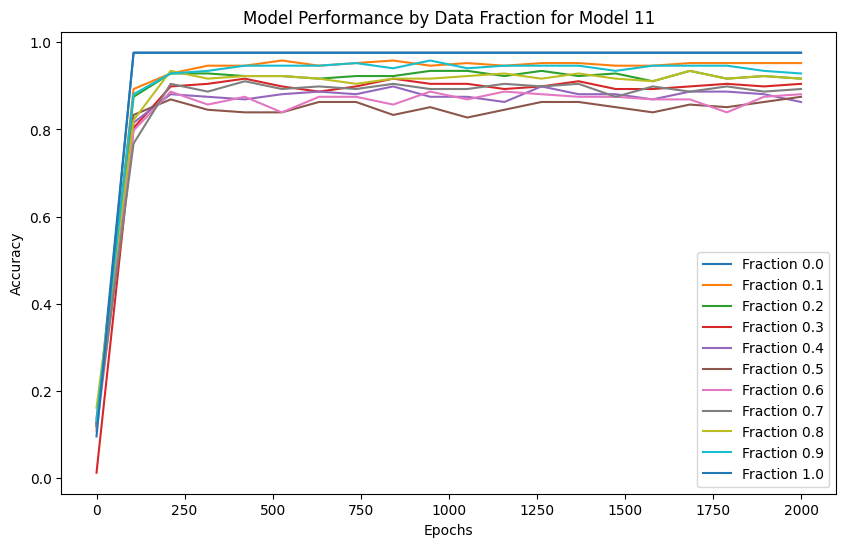

Model 12, Fraction 0.00, Epoch 1, Loss: 2.3034
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 0.6222
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 0.1991
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.1158
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.0888
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.0769
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.0706
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.0668
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.0645
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.0627
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.0615
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.0607
predi

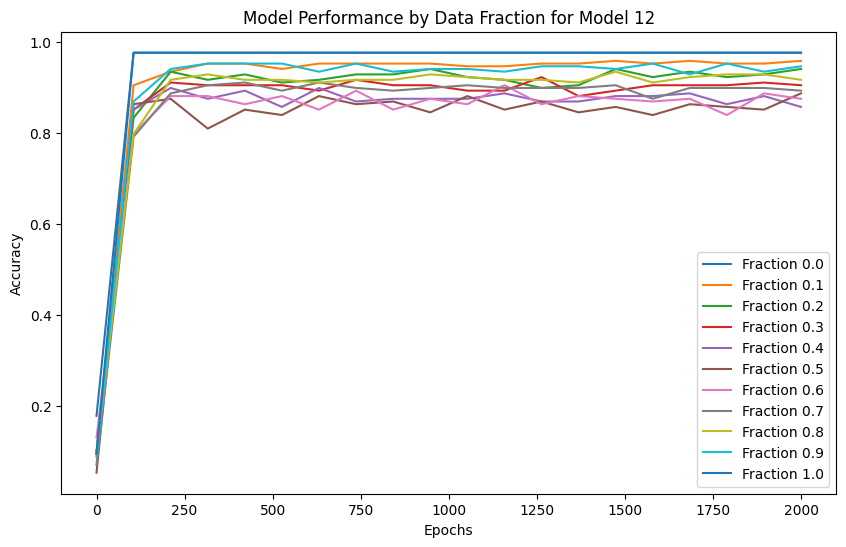

Model 13, Fraction 0.00, Epoch 1, Loss: 2.3581
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 0.7250
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 0.2166
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.1216
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.0917
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.0787
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.0719
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.0678
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.0652
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.0634
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.0621
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.0611
predi

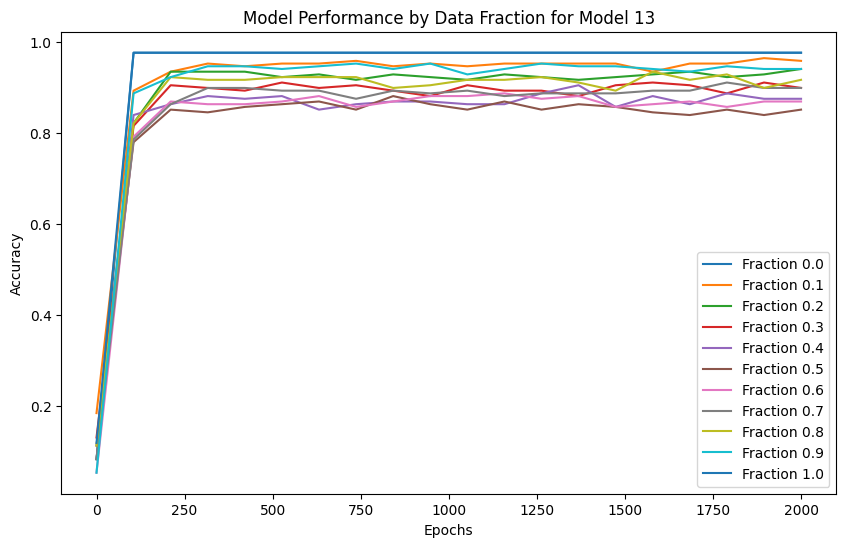

Model 14, Fraction 0.00, Epoch 1, Loss: 2.3183
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 0.6353
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 0.2028
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.1190
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.0910
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.0786
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.0720
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.0679
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.0653
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.0635
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.0622
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.0612
predi

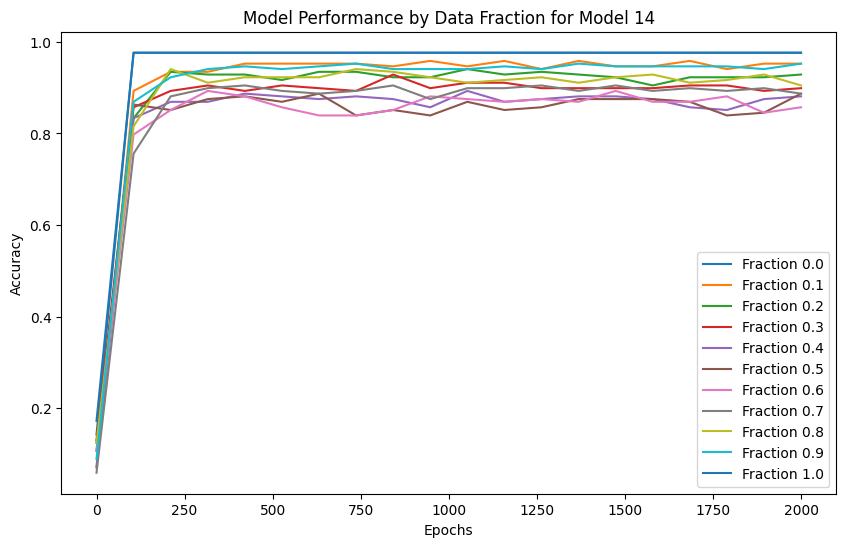

Model 15, Fraction 0.00, Epoch 1, Loss: 2.3167
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 0.7021
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 0.2244
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.1252
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.0936
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.0798
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.0725
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.0682
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.0654
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.0636
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.0625
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.0612
predi

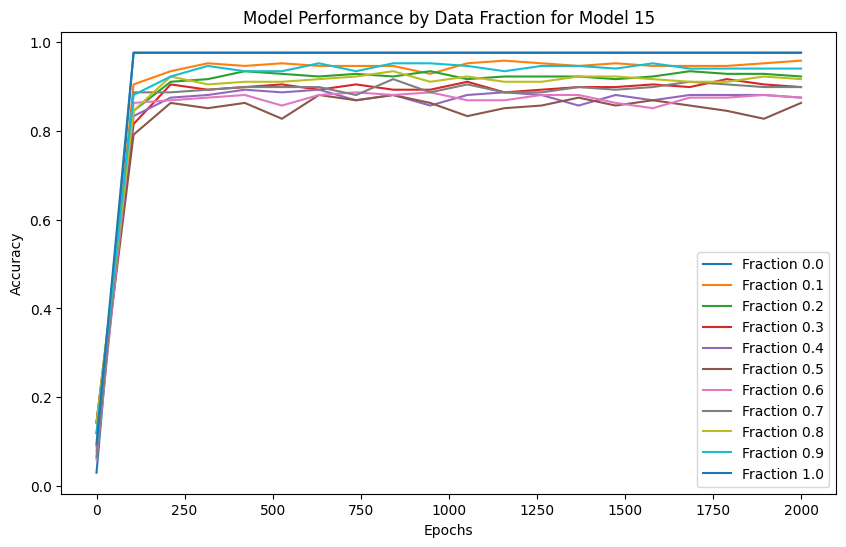

Model 16, Fraction 0.00, Epoch 1, Loss: 2.2941
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 0.6490
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 0.2054
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.1188
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.0908
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.0717
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.0677
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.0652
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.0636
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.0620
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.0611
predi

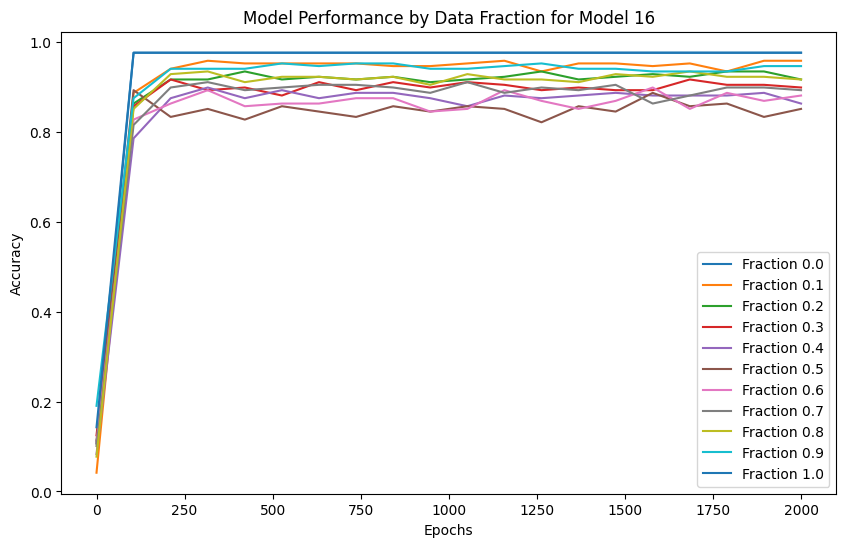

Model 17, Fraction 0.00, Epoch 1, Loss: 2.3521
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 0.7474
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 0.2225
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.1216
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.0913
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.0783
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.0715
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.0675
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.0649
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.0631
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.0620
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.0609
predi

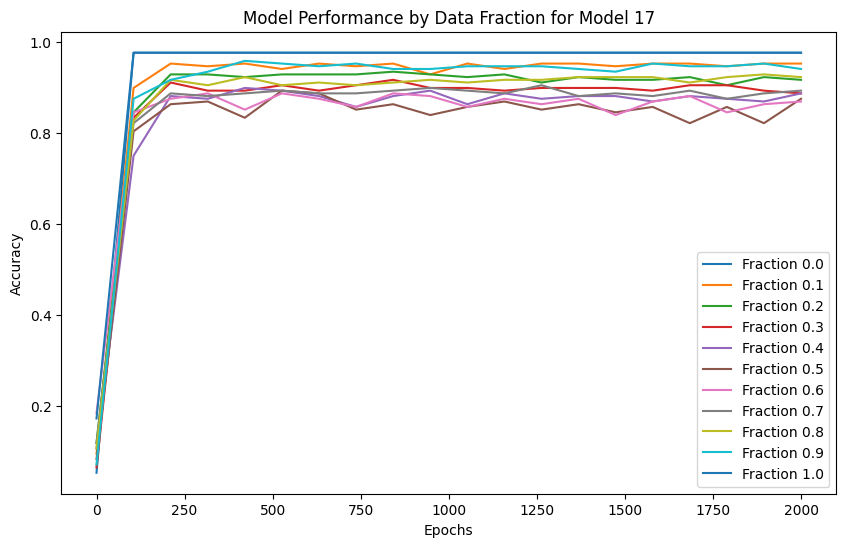

Model 18, Fraction 0.00, Epoch 1, Loss: 2.3387
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 0.6602
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 0.2154
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.1243
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.0938
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.0802
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.0729
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.0685
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.0658
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.0638
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.0624
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.0614
predi

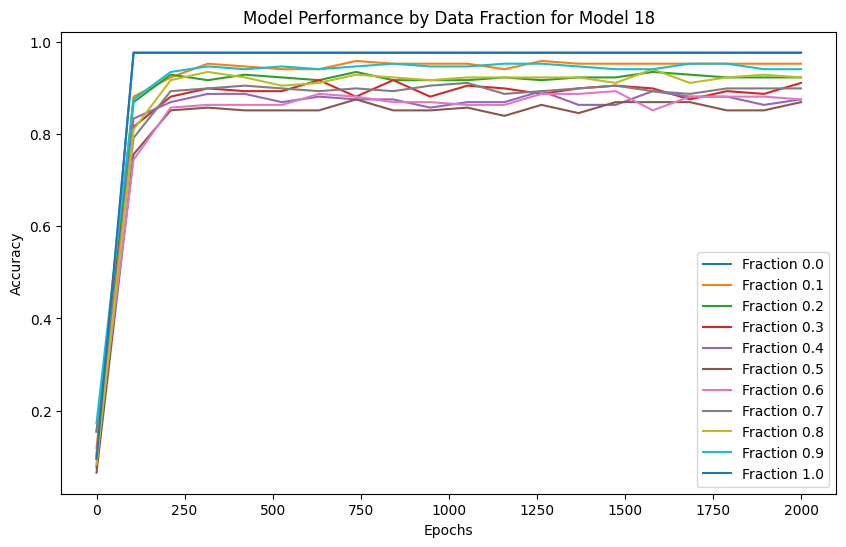

Model 19, Fraction 0.00, Epoch 1, Loss: 2.3049
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 0.6514
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 0.2182
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.1249
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.0939
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.0801
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.0728
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.0684
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.0658
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.0637
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.0623
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.0615
predi

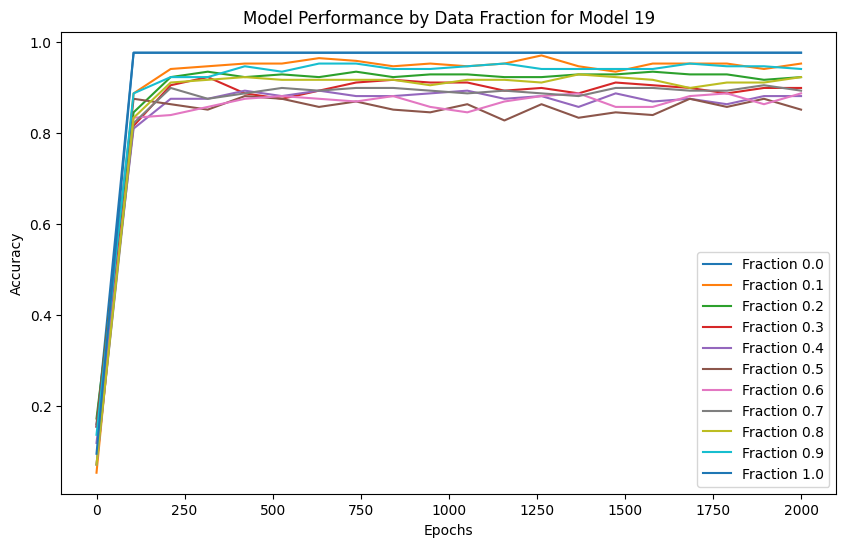

Model 20, Fraction 0.00, Epoch 1, Loss: 2.3041
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 0.6371
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 0.2112
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.1217
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.0921
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.0789
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.0720
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.0678
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.0652
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.0633
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.0620
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.0611
predi

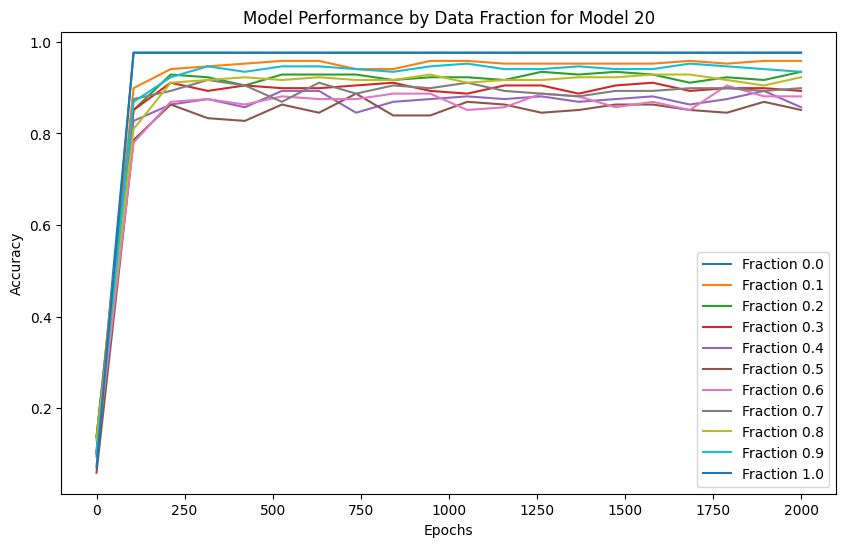

Model 21, Fraction 0.00, Epoch 1, Loss: 2.3249
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 0.7040
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 0.2210
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.1252
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.0939
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.0799
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.0726
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.0682
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.0654
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.0635
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.0622
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.0614
predi

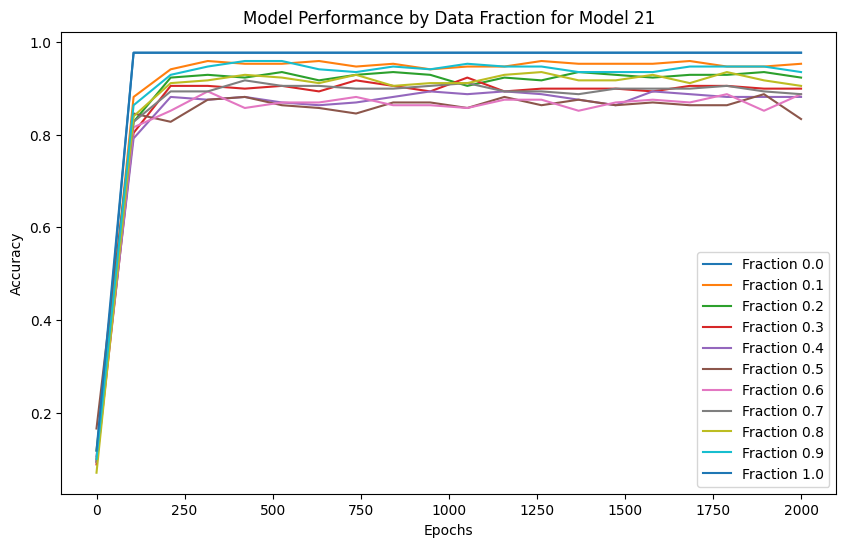

Model 22, Fraction 0.00, Epoch 1, Loss: 2.3016
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 0.6436
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 0.2174
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.1247
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.0935
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.0798
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.0725
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.0682
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.0654
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.0635
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.0621
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.0612
predi

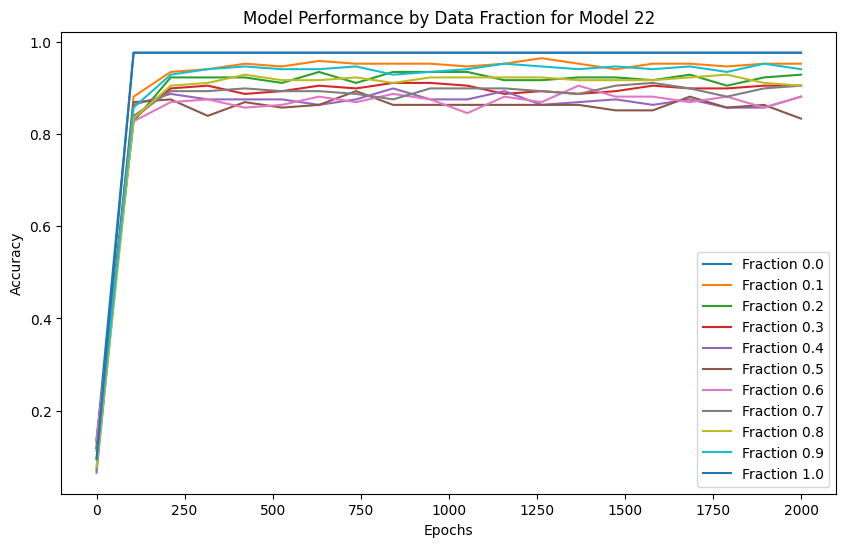

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2635
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 0.7271
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 0.2289
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.1251
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.0930
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.0721
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.0679
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.0652
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.0634
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.0620
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.0611
predi

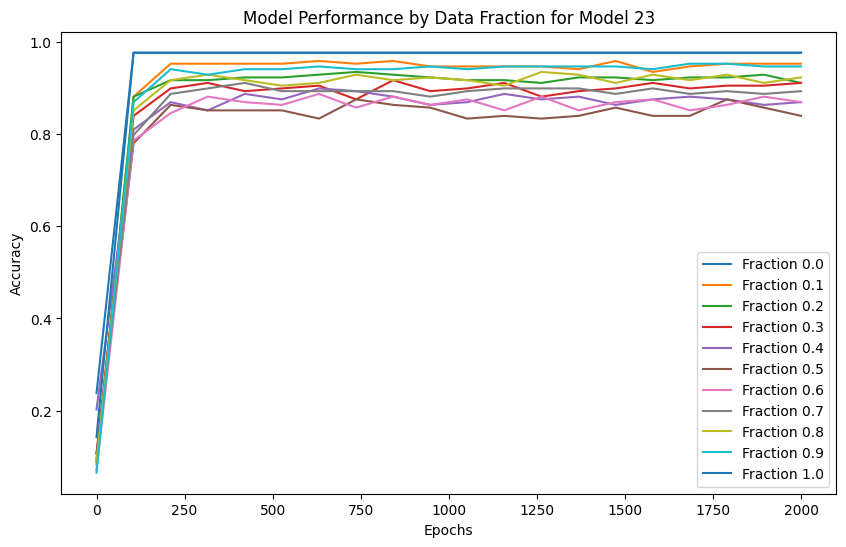

Model 24, Fraction 0.00, Epoch 1, Loss: 2.3294
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 0.6825
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 0.2220
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.1246
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.0930
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.0720
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.0678
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.0651
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.0632
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.0620
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.0609
predi

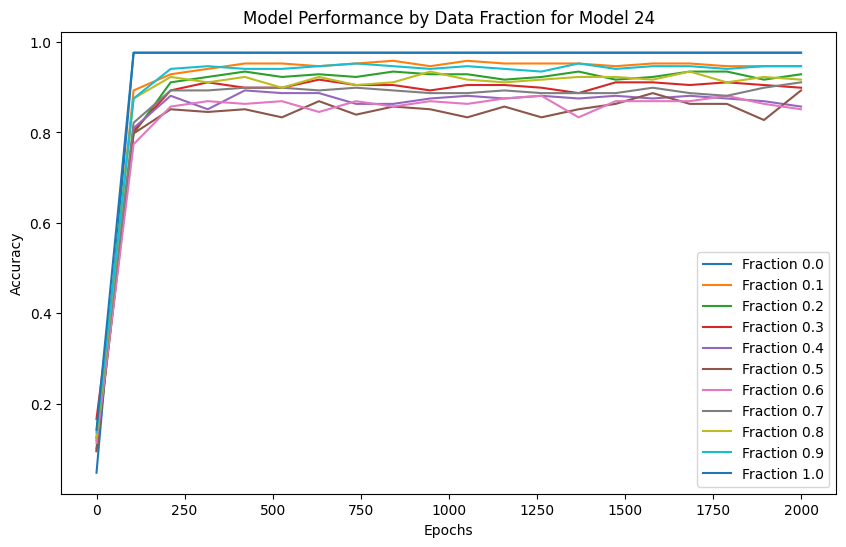

Model 25, Fraction 0.00, Epoch 1, Loss: 2.3534
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 0.7441
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 0.2314
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.1268
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.0942
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.0800
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.0727
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.0683
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.0655
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.0636
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.0622
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.0612
predi

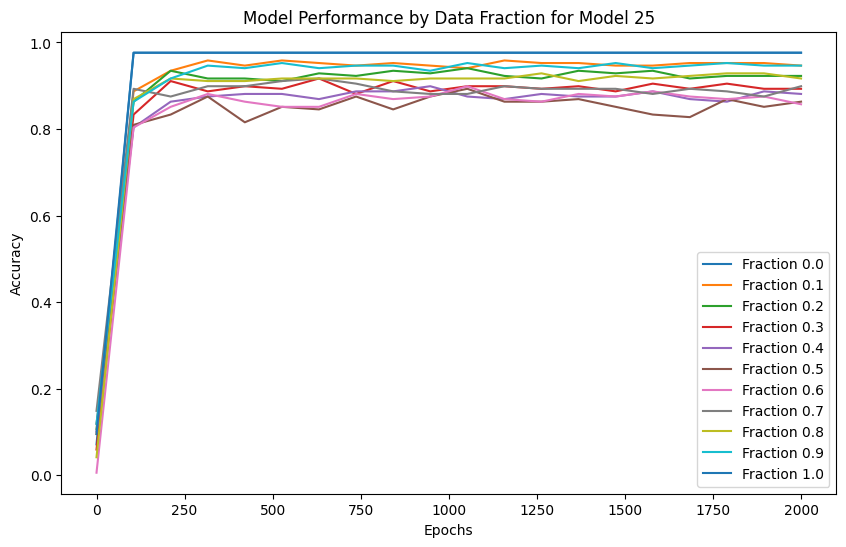

Model 26, Fraction 0.00, Epoch 1, Loss: 2.3121
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 0.6598
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 0.2079
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.1176
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.0893
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.0770
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.0706
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.0667
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.0643
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.0627
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.0615
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.0606
predi

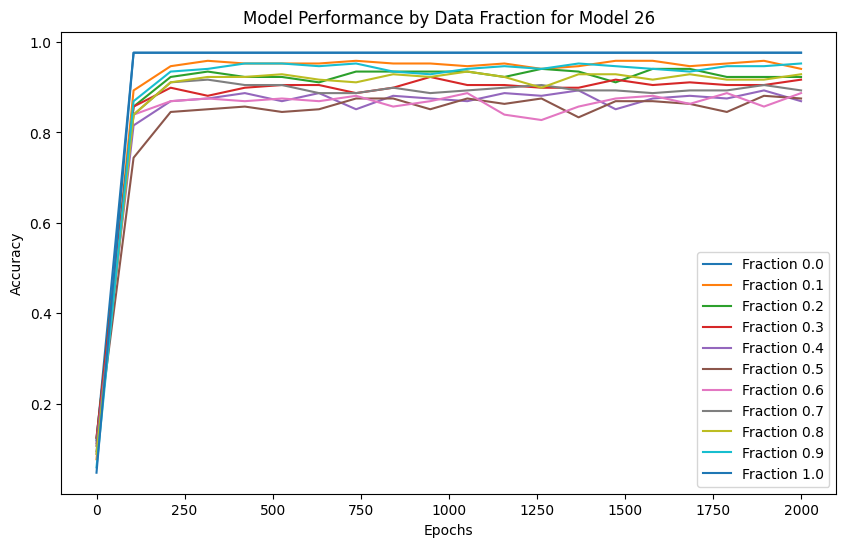

Model 27, Fraction 0.00, Epoch 1, Loss: 2.3375
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 0.6710
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 0.2102
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.1200
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.0911
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.0784
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.0717
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.0677
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.0651
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.0633
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.0620
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.0611
predi

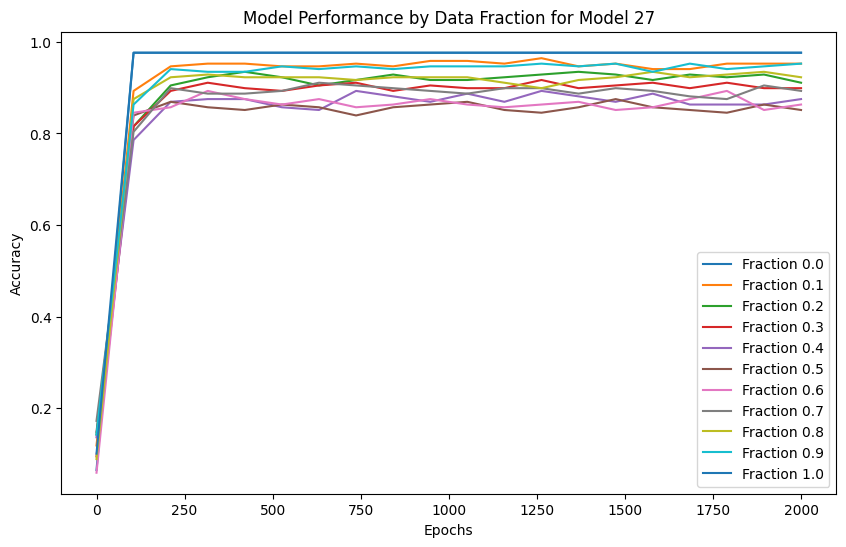

Model 28, Fraction 0.00, Epoch 1, Loss: 2.3365
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 0.6776
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 0.2133
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.1213
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.0918
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.0788
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.0719
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.0678
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.0652
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.0633
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.0620
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.0611
predi

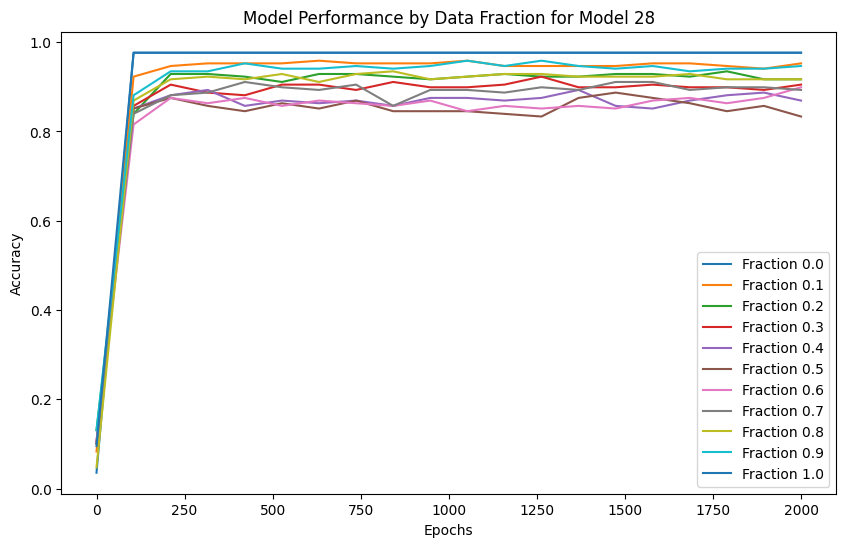

Model 29, Fraction 0.00, Epoch 1, Loss: 2.3334
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 0.6805
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 0.2170
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.1229
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.0926
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.0793
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.0723
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.0681
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.0654
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.0635
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.0622
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.0612
predi

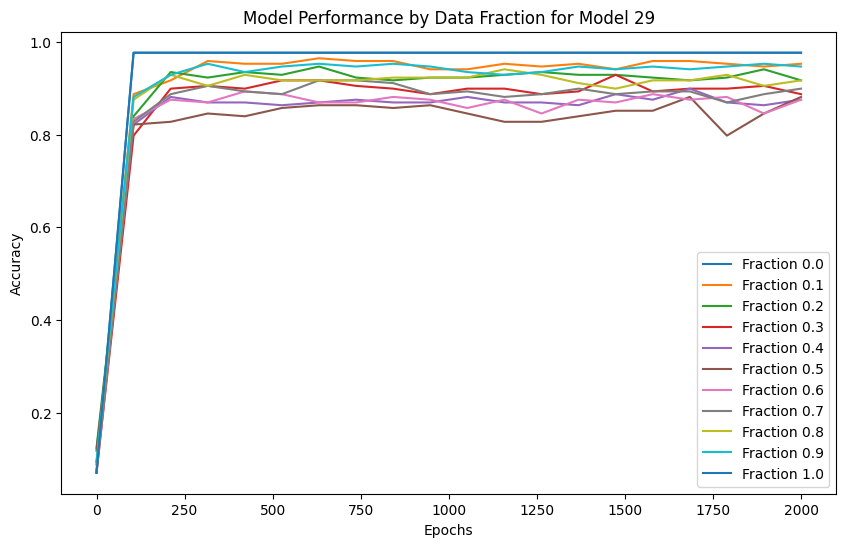

In [237]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 10
emsize = 16
nhead = 2
d_hid = 16
nlayers = 4
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB", # normal
    "JIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJI", # reverse
])

for model_idx in range(num_models):
    model_dir = f"Songs_different_normal_reverse_higher_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [266]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 10
emsize = 16
nhead = 2
d_hid = 16
nlayers = 4
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_different_normal_reverse_higher_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "ABCDEFGHIJABCDEFGHIJABCDEFGHIJABCDEFGHIJAB", # normal
    "JIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJIHGFEDCBAJI", # reverse
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0308
  Fraction 0.10, Average Accuracy: 0.7089
  Fraction 0.20, Average Accuracy: 0.7179
  Fraction 0.30, Average Accuracy: 0.7339
  Fraction 0.40, Average Accuracy: 0.7585
  Fraction 0.50, Average Accuracy: 0.8569
  Fraction 0.60, Average Accuracy: 0.9351
  Fraction 0.70, Average Accuracy: 0.9677
  Fraction 0.80, Average Accuracy: 0.9730
  Fraction 0.90, Average Accuracy: 0.9756
  Fraction 1.00, Average Accuracy: 0.9762
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.9762
  Fraction 0.10, Average Accuracy: 0.9760
  Fraction 0.20, Average Accuracy: 0.9738
  Fraction 0.30, Average Accuracy: 0.9677
  Fraction 0.40, Average Accuracy: 0.9462
  Fraction 0.50, Average Accuracy: 0.8502
  Fraction 0.60, Average Accuracy: 0.7710
  Fraction 0.70, Average Accuracy: 0.7345
  Fraction 0.80, Average Accuracy: 0.7210
  Fraction 0.90, Average Accuracy: 0.7107
  Fraction 1.00, Average Accuracy: 0.0240


#### plot for transformers

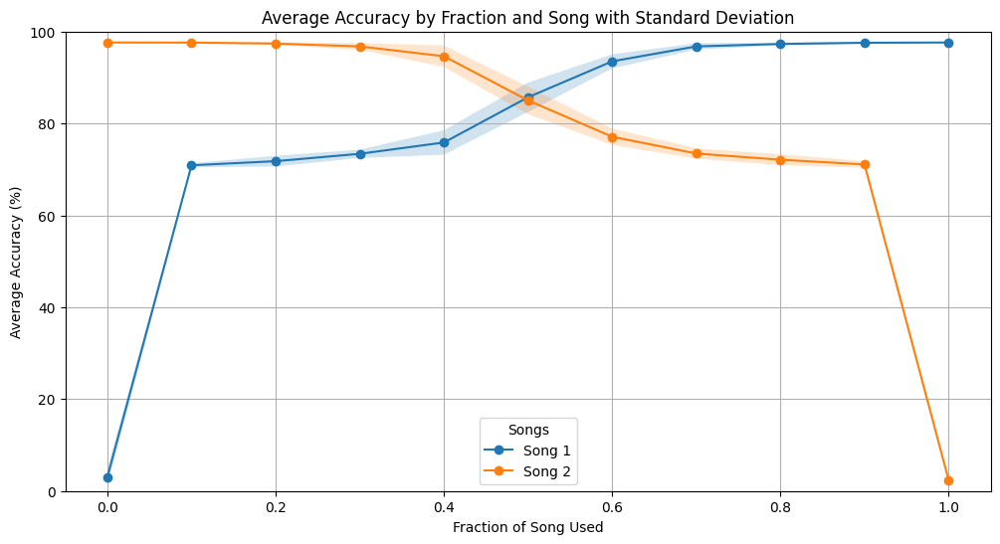

In [239]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot for decision tree

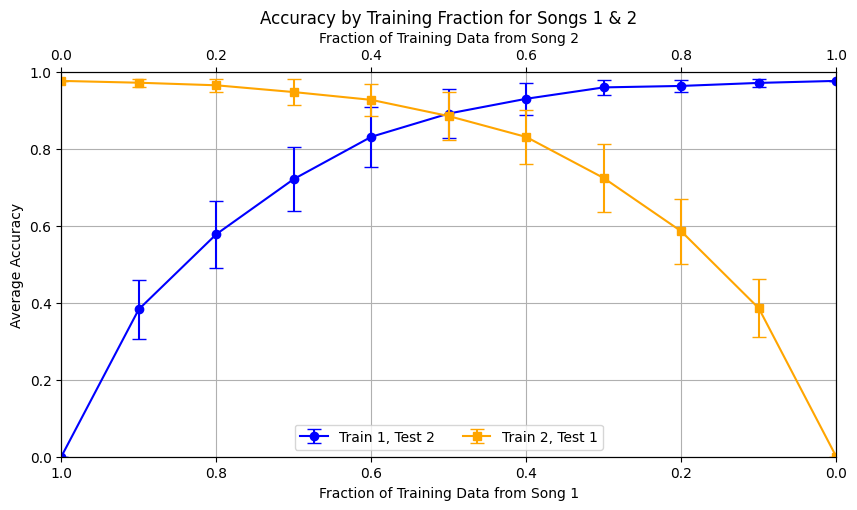

In [240]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(1, 2), (2, 1)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

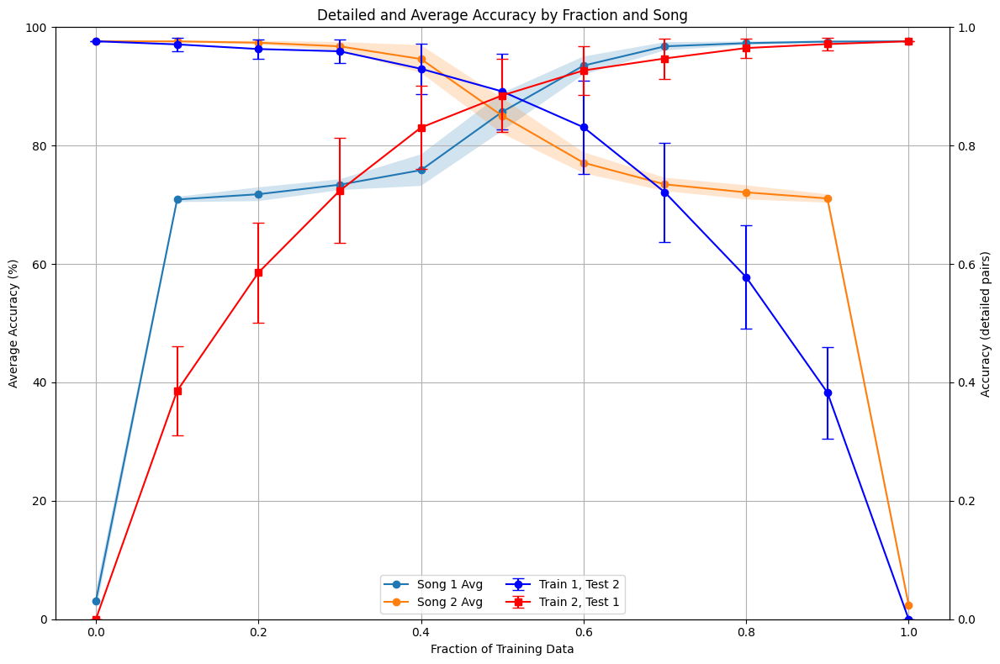

In [241]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


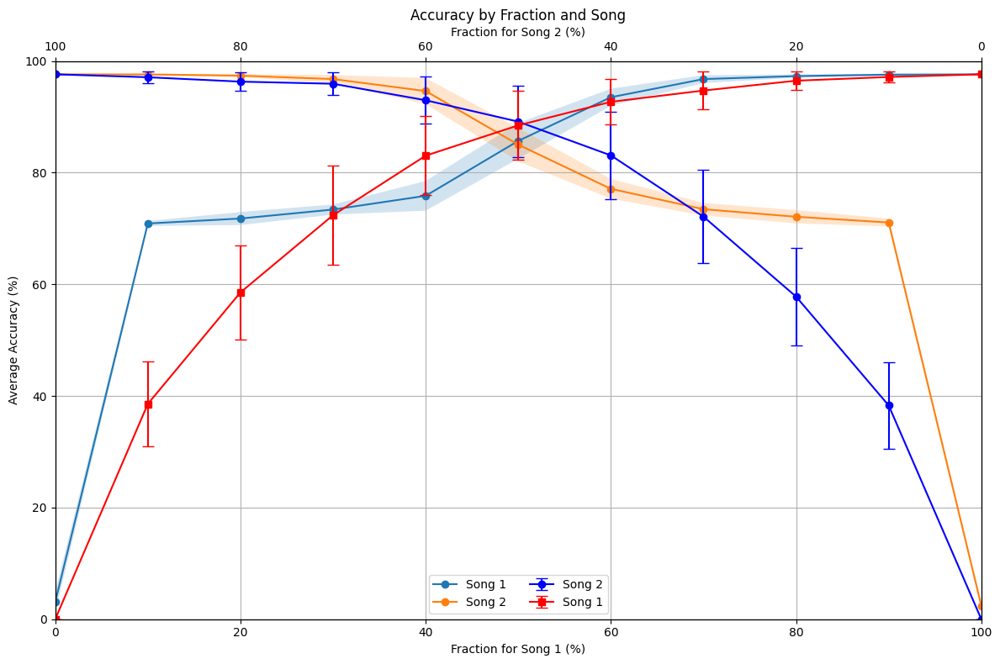

In [267]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction for Song 1 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(1, 2), (2, 1)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction for Song 2 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Extract lines and labels from the plots
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()

# Specify custom labels as required
custom_labels = ['Song 1', 'Song 2', 'Song 2', 'Song 1']

# Combine the lines and custom labels
combined_lines = lines + lines2

# Update the legend with custom labels
ax1.legend(combined_lines, custom_labels, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


## Training and Testing for normal and 5th note 

## Song Complexity

### Daisy and 5th note - Hard Songs

#### Training

Model 0, Fraction 0.00, Epoch 1, Loss: 2.3151
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_26728/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 1.6849
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.1000
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 0.7608
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 0.6055
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 0.5069
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.4505
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.4233
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.4102
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.4022
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.3968
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.3932
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.3904
prediction sha

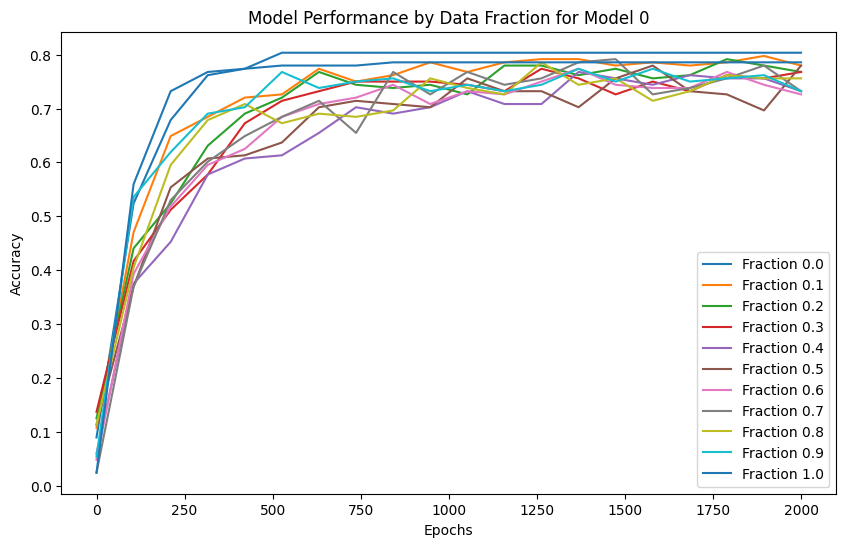

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2925
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 1.6564
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.1168
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 0.7579
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 0.5717
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 0.4846
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.4415
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.4210
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.4092
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.4017
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.3967
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.3942
prediction shape 

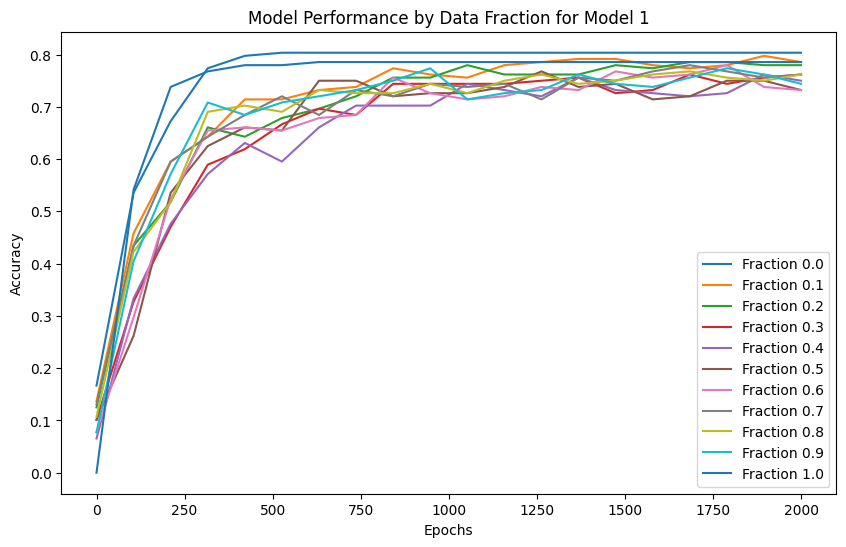

Model 2, Fraction 0.00, Epoch 1, Loss: 2.3252
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 1.6880
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.1319
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 0.7598
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 0.5883
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 0.4943
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 0.4464
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 0.4211
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.4083
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.4006
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.3956
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.3921
prediction shape 

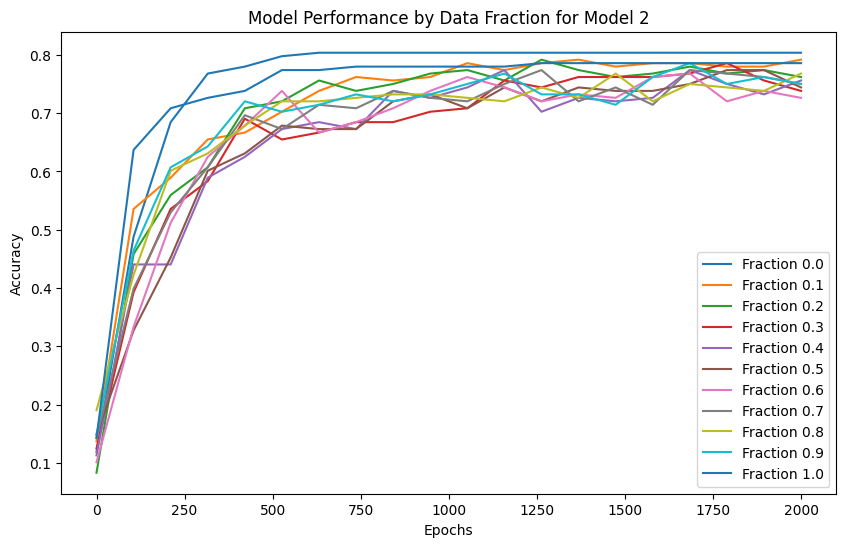

Model 3, Fraction 0.00, Epoch 1, Loss: 2.3085
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 1.6737
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.1366
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 0.8010
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 0.6012
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.4939
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.4480
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.4196
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.4061
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.3985
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.3939
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.3909
prediction shape 

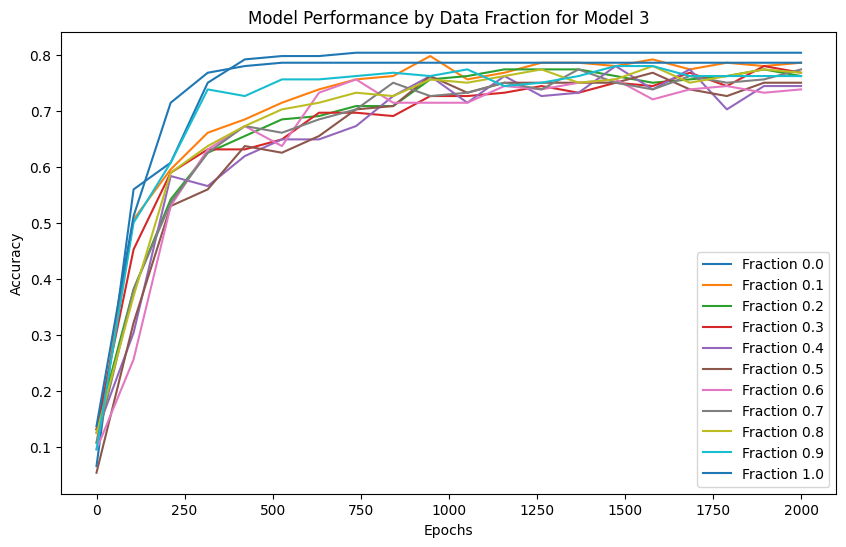

Model 4, Fraction 0.00, Epoch 1, Loss: 2.3344
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.6997
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.1787
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 0.7796
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 0.5692
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 0.4802
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.4424
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.4246
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.4088
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.3999
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.4001
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.3917
prediction shape 

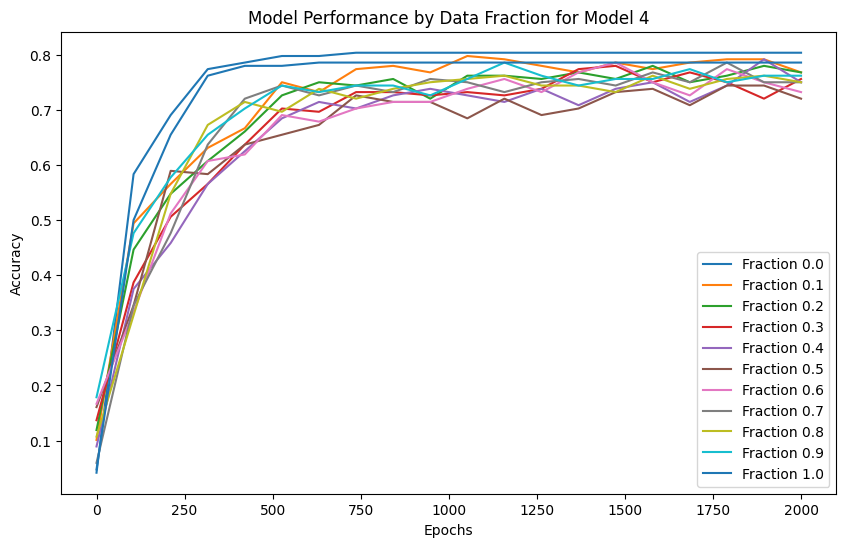

Model 5, Fraction 0.00, Epoch 1, Loss: 2.3135
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.6568
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.1466
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 0.7920
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 0.5796
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 0.4785
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 0.4382
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.4185
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.4077
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.4004
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.3957
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.3923
prediction shape 

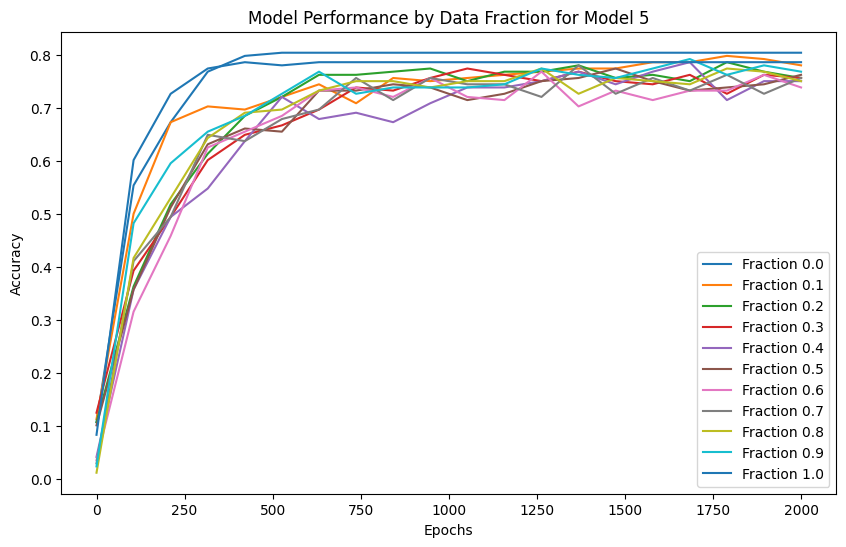

Model 6, Fraction 0.00, Epoch 1, Loss: 2.3063
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 1.7297
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.1032
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 0.7528
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 0.5754
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.4777
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.4366
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.4170
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.4060
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.3992
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.3948
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.3915
prediction shape 

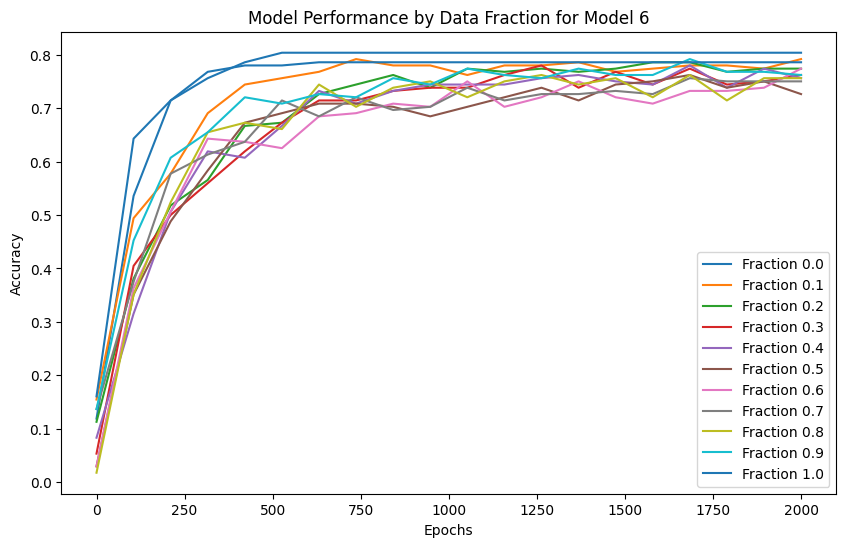

Model 7, Fraction 0.00, Epoch 1, Loss: 2.3056
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 1.7795
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.1907
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 0.8387
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 0.6062
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 0.5109
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.4675
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.4426
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.4257
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.4121
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.4031
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.3977
prediction shape 

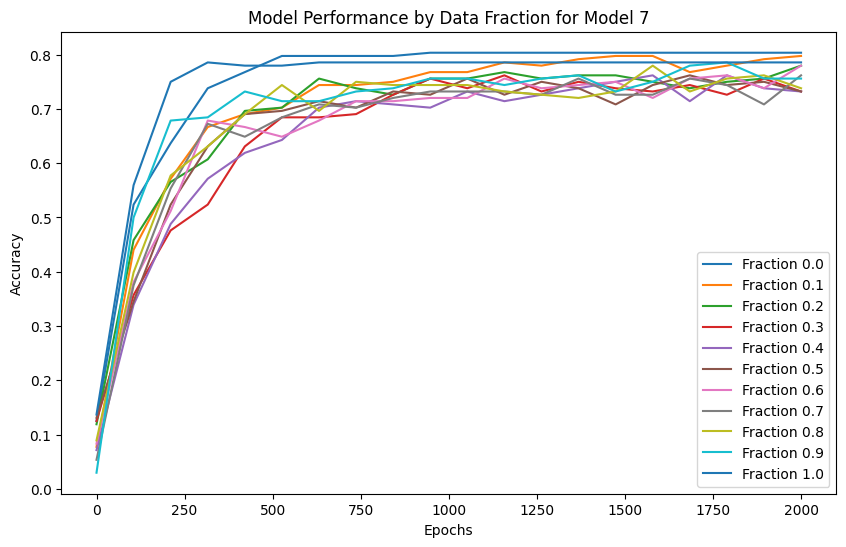

Model 8, Fraction 0.00, Epoch 1, Loss: 2.3393
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.6705
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.2093
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 0.8599
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 0.6462
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 0.5234
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.4668
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.4385
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.4209
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.4089
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.4012
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.3963
prediction shape 

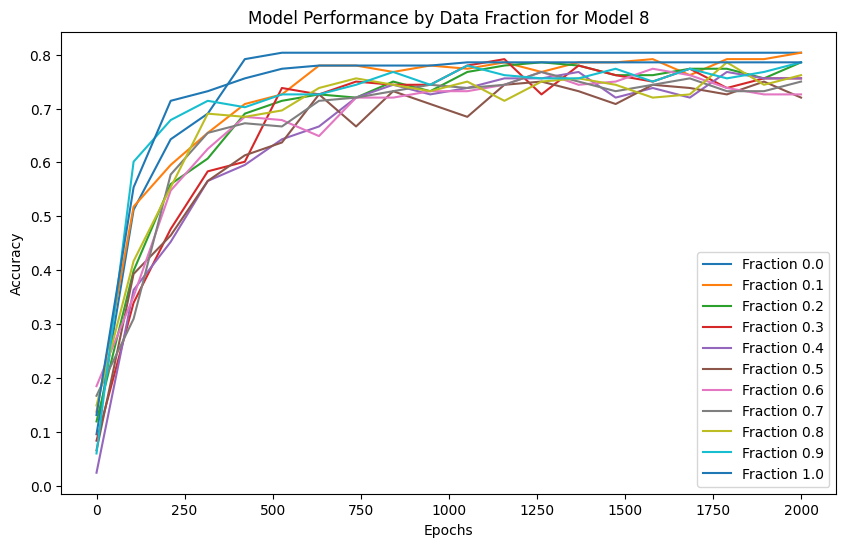

Model 9, Fraction 0.00, Epoch 1, Loss: 2.2943
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.7368
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.1795
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 0.7514
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 0.5847
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 0.4879
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 0.4437
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 0.4226
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.4099
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.4016
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.3964
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.3929
prediction shape 

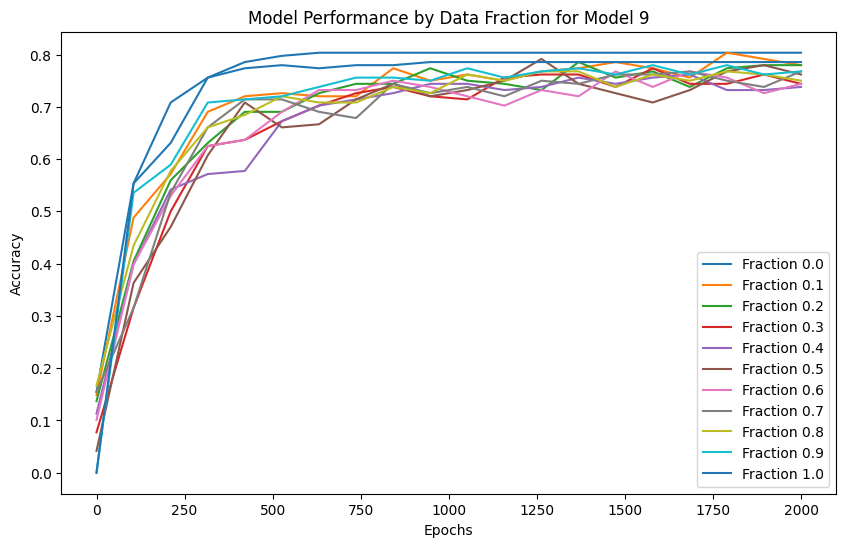

Model 10, Fraction 0.00, Epoch 1, Loss: 2.3039
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.6997
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.1337
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 0.7719
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 0.5705
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 0.4765
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 0.4364
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.4175
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.4066
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.4002
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.3953
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.3918
predi

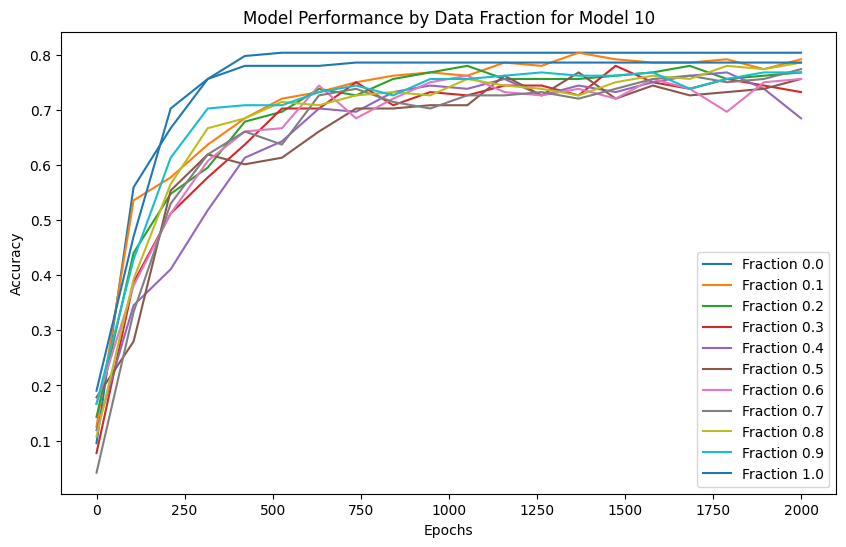

Model 11, Fraction 0.00, Epoch 1, Loss: 2.3084
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.7120
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.1833
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 0.7998
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 0.5903
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 0.4920
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.4448
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.4218
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.4093
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.4013
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.3963
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.3926
predi

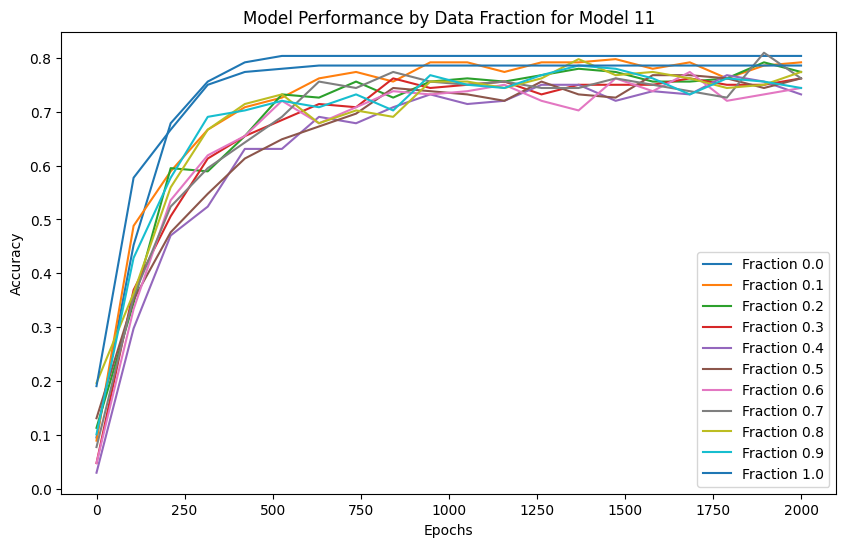

Model 12, Fraction 0.00, Epoch 1, Loss: 2.3007
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.6397
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.1100
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 0.7708
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 0.5657
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 0.4772
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.4363
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.4160
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.4051
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.3983
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.3940
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.3908
predi

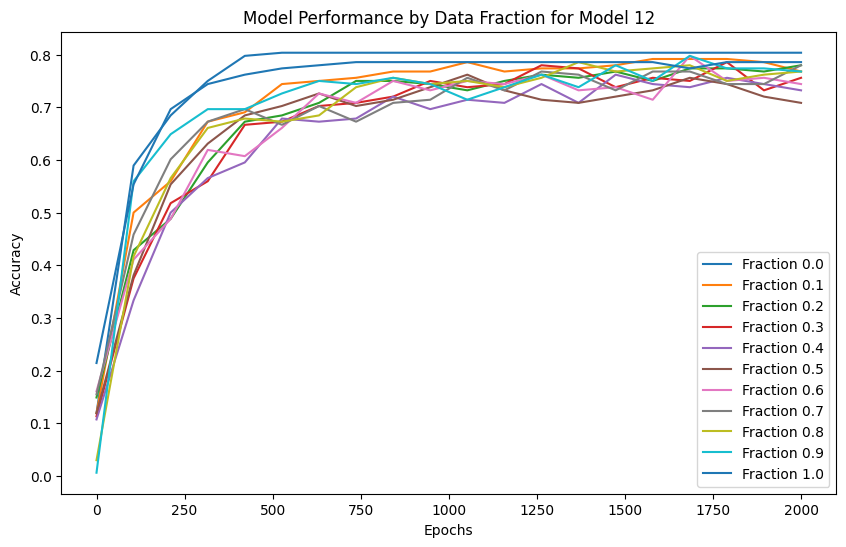

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2994
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 1.7355
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.1441
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 0.7605
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 0.5887
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.5065
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.4651
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.4395
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.4185
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.4077
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.4013
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.3965
predi

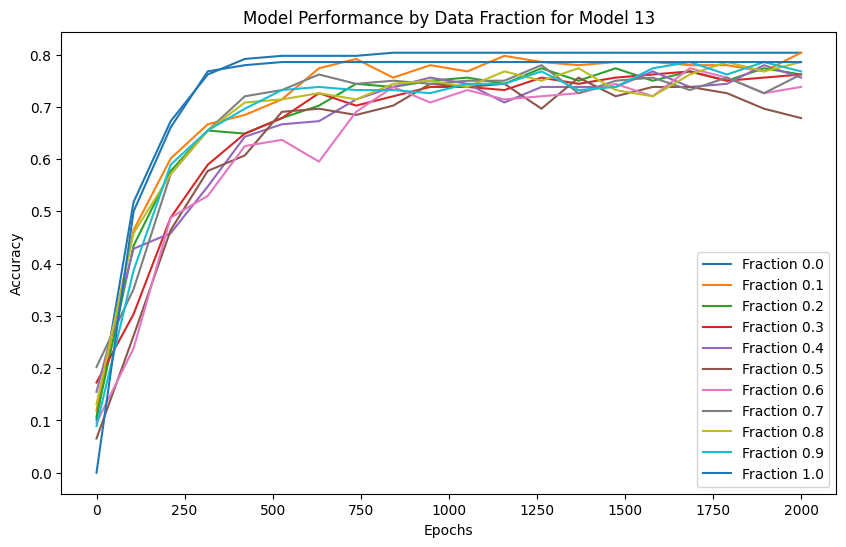

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2951
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.7072
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.1224
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 0.7528
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 0.5674
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 0.4741
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.4331
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.4147
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.4044
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.3983
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.3938
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.3909
predi

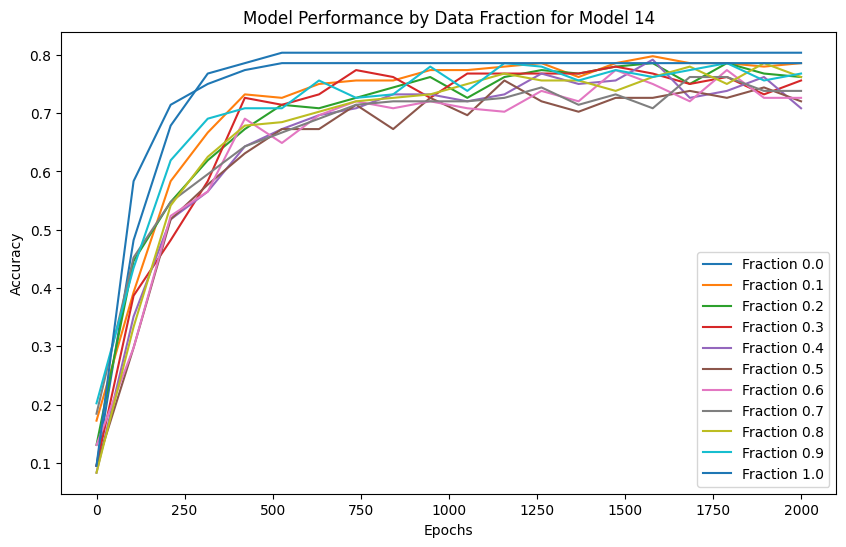

Model 15, Fraction 0.00, Epoch 1, Loss: 2.3161
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.6617
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.1503
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 0.8173
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 0.6084
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 0.5128
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.4600
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.4337
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.4144
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.4040
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.3975
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.4152
predi

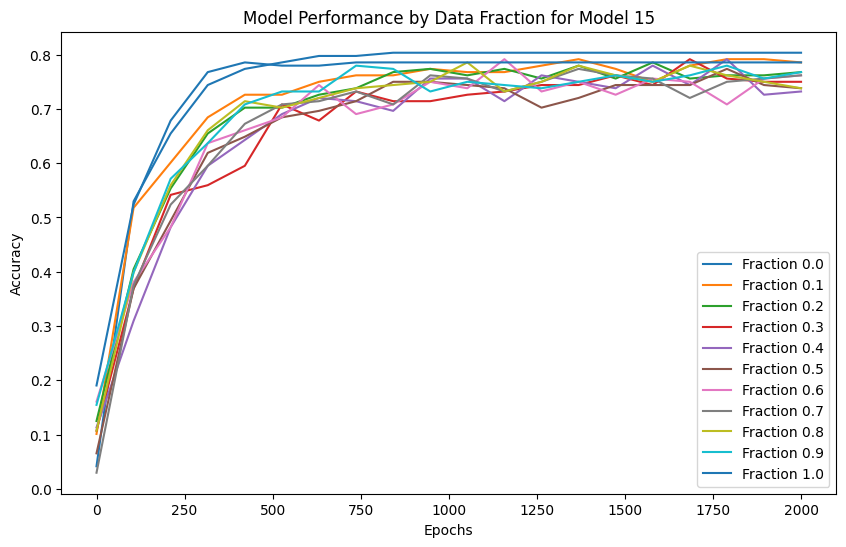

Model 16, Fraction 0.00, Epoch 1, Loss: 2.3059
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.8033
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.1488
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 0.7736
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 0.5888
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 0.4938
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 0.4455
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.4220
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.4094
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.4014
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.3962
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.3925
predi

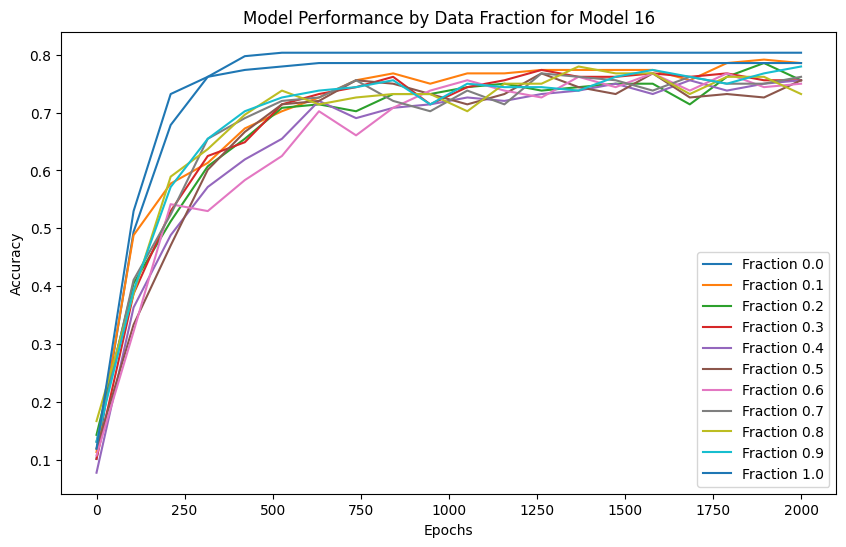

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2968
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.7102
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.1671
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 0.7736
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 0.5897
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 0.5040
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.4561
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.4293
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.4141
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.4043
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.3983
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.3942
predi

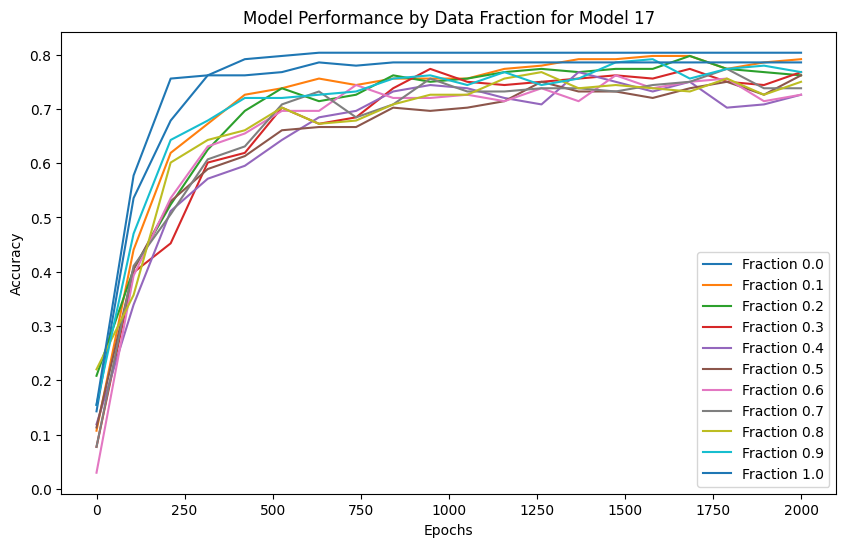

Model 18, Fraction 0.00, Epoch 1, Loss: 2.3165
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 1.7492
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.1278
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 0.7660
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 0.5768
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.4938
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.4529
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.4270
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.4115
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.4021
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.3964
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.3926
predi

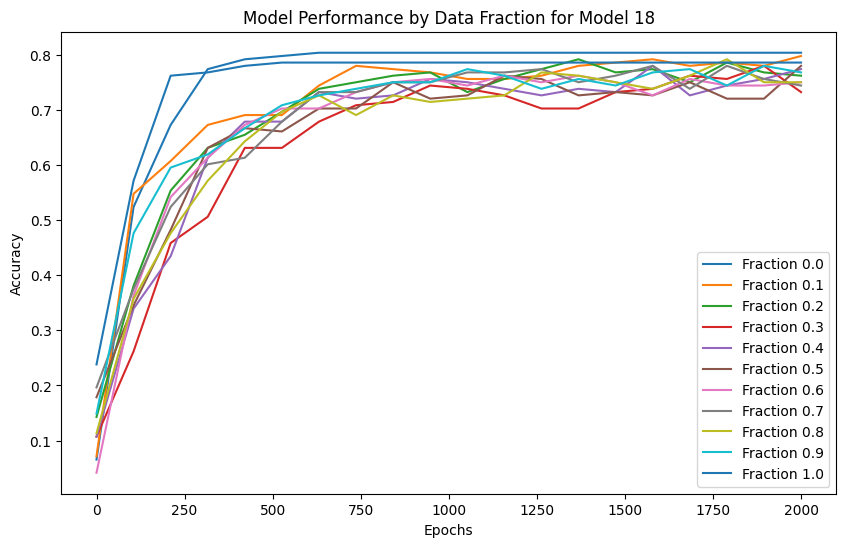

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2919
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.6524
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.1696
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 0.8296
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 0.6298
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 0.5230
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.4616
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.4299
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.4133
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.4033
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.3974
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.3938
predi

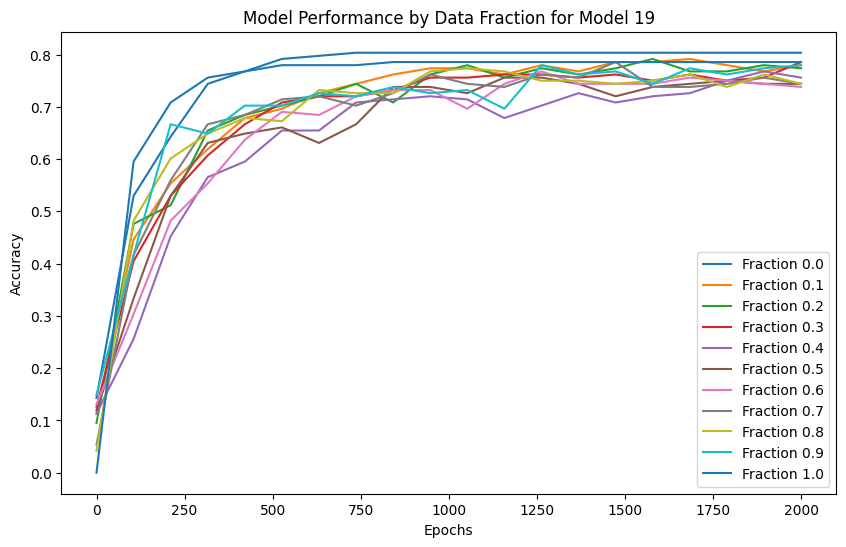

Model 20, Fraction 0.00, Epoch 1, Loss: 2.3242
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.7407
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.0976
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 0.7397
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 0.5874
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 0.5086
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.4635
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.4376
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.4196
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.4059
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.3996
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.3948
predi

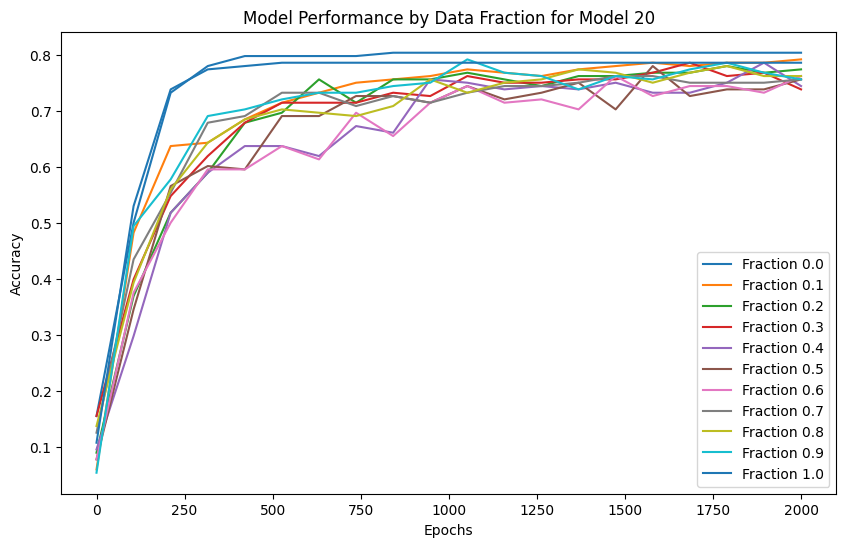

Model 21, Fraction 0.00, Epoch 1, Loss: 2.3232
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.6995
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.1908
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 0.8009
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 0.6036
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 0.5024
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.4498
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.4235
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.4101
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.4015
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.3965
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.3928
predi

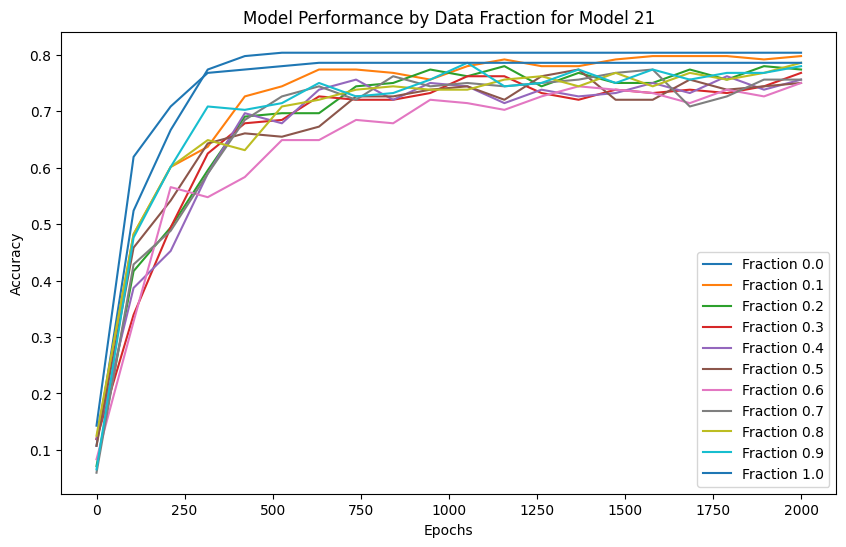

Model 22, Fraction 0.00, Epoch 1, Loss: 2.3049
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.6945
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.1540
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 0.8161
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 0.5781
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 0.4866
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 0.4447
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 0.4232
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.4094
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.4009
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.3954
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.3918
predi

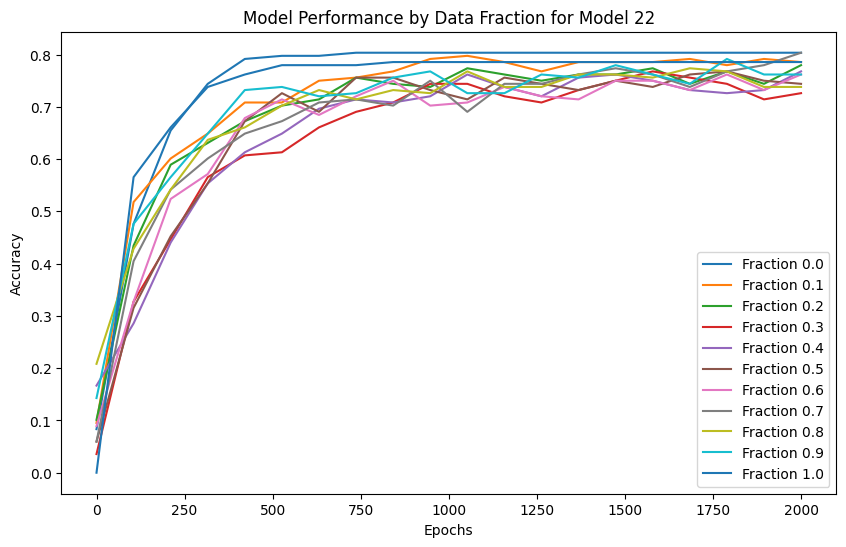

Model 23, Fraction 0.00, Epoch 1, Loss: 2.3194
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.6578
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.1242
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 0.8353
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 0.6464
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 0.5435
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.4756
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.4369
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.4165
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.4056
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.3987
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.3943
predi

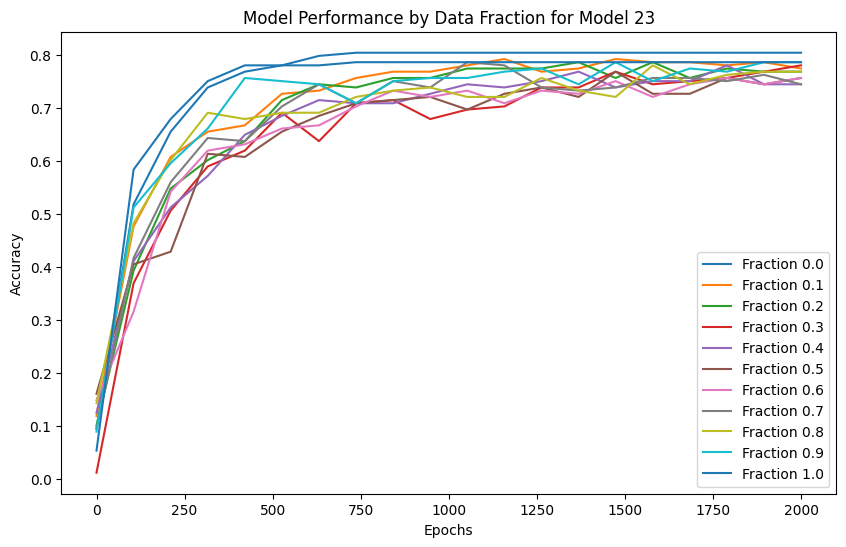

Model 24, Fraction 0.00, Epoch 1, Loss: 2.3043
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.6785
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.1730
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 0.7957
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 0.5882
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 0.4826
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.4386
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.4173
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.4059
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.3991
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.3944
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.3913
predi

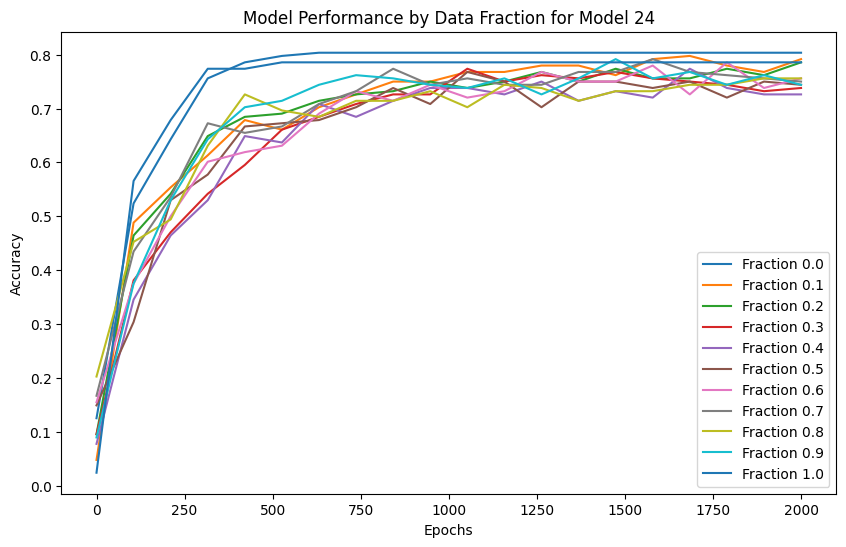

Model 25, Fraction 0.00, Epoch 1, Loss: 2.3137
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 1.7407
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.1638
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 0.7823
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 0.5803
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 0.4759
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 0.4331
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.4144
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.4039
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.3976
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.3934
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.3906
predi

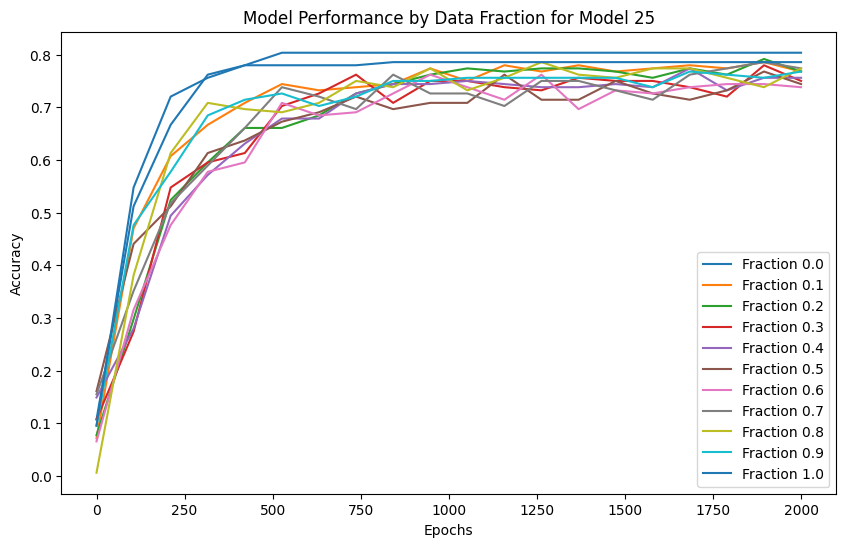

Model 26, Fraction 0.00, Epoch 1, Loss: 2.3142
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.6857
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.1342
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 0.8028
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 0.6321
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 0.5275
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.4706
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.4378
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.4191
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.4080
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.4007
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.3957
predi

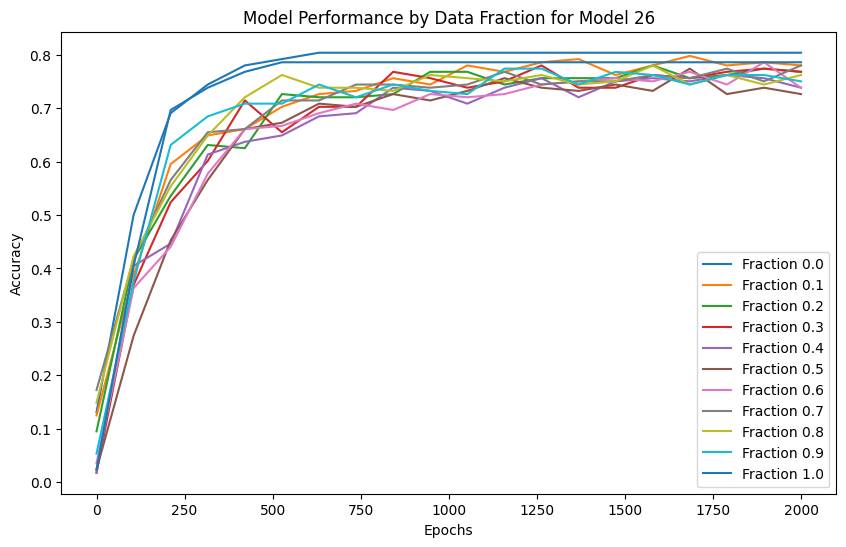

Model 27, Fraction 0.00, Epoch 1, Loss: 2.3252
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 1.7249
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.1549
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 0.7991
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 0.5995
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 0.4956
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.4450
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.4219
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.4093
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.3998
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.3949
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.3915
predi

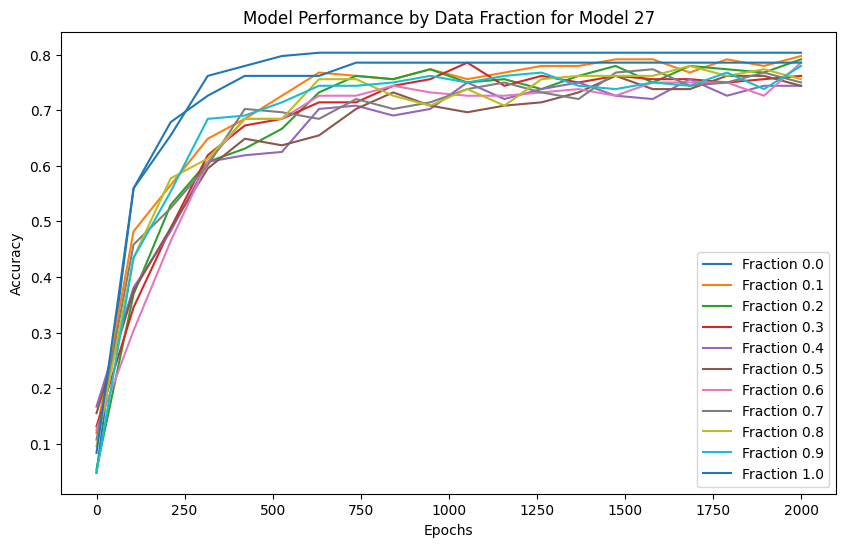

Model 28, Fraction 0.00, Epoch 1, Loss: 2.3023
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 1.6620
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.0879
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 0.7399
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 0.5517
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 0.4659
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 0.4317
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.4143
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.4045
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.3983
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.3940
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.3909
predi

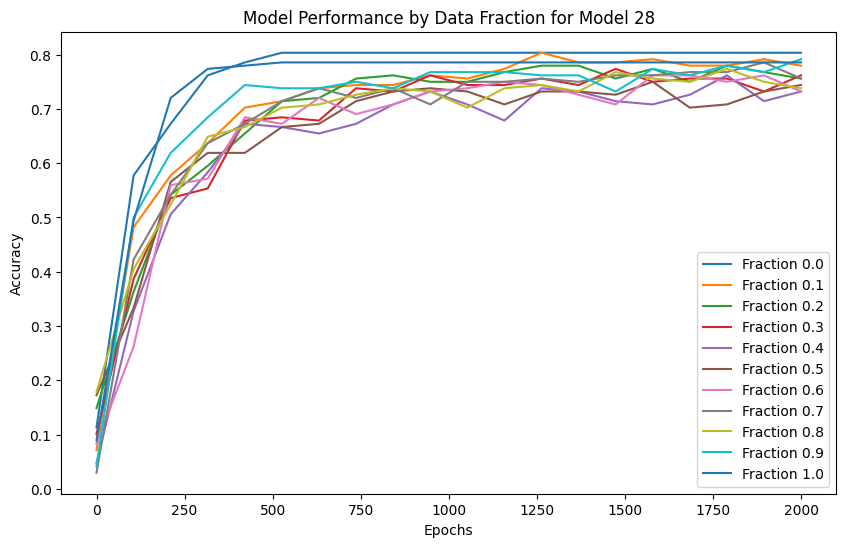

Model 29, Fraction 0.00, Epoch 1, Loss: 2.3225
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 1.7195
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.1207
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 0.7745
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 0.5766
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 0.4944
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.4533
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.4251
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.4094
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.4008
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.3957
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.3919
predi

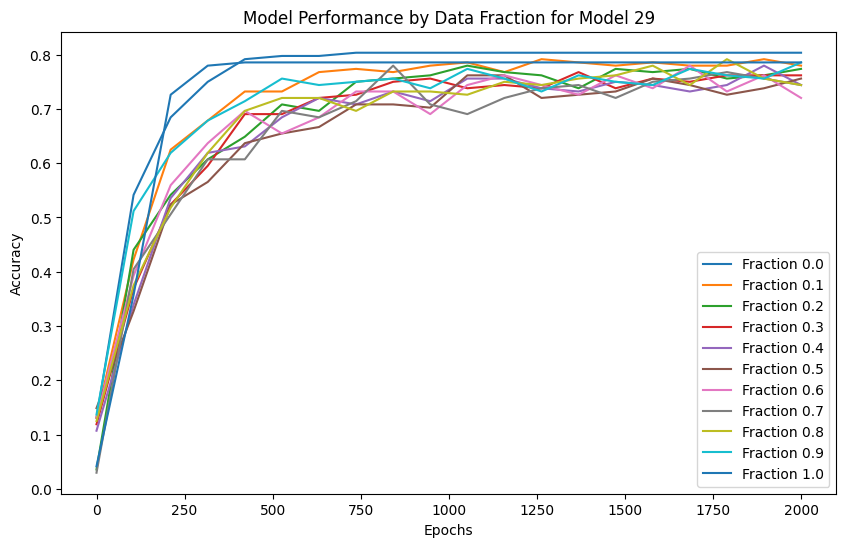

In [243]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 10
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIJBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_hard_daisy_5th_note/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


#### Testing

In [280]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 10
emsize = 8
nhead = 2
d_hid = 8
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_hard_daisy_5th_note"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIJBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0256
  Fraction 0.10, Average Accuracy: 0.6143
  Fraction 0.20, Average Accuracy: 0.6403
  Fraction 0.30, Average Accuracy: 0.6726
  Fraction 0.40, Average Accuracy: 0.7171
  Fraction 0.50, Average Accuracy: 0.7538
  Fraction 0.60, Average Accuracy: 0.7734
  Fraction 0.70, Average Accuracy: 0.7794
  Fraction 0.80, Average Accuracy: 0.7815
  Fraction 0.90, Average Accuracy: 0.7831
  Fraction 1.00, Average Accuracy: 0.7857
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.8036
  Fraction 0.10, Average Accuracy: 0.8018
  Fraction 0.20, Average Accuracy: 0.7984
  Fraction 0.30, Average Accuracy: 0.7857
  Fraction 0.40, Average Accuracy: 0.7562
  Fraction 0.50, Average Accuracy: 0.7256
  Fraction 0.60, Average Accuracy: 0.7052
  Fraction 0.70, Average Accuracy: 0.6950
  Fraction 0.80, Average Accuracy: 0.6716
  Fraction 0.90, Average Accuracy: 0.6327
  Fraction 1.00, Average Accuracy: 0.0530


#### plotting for transformers

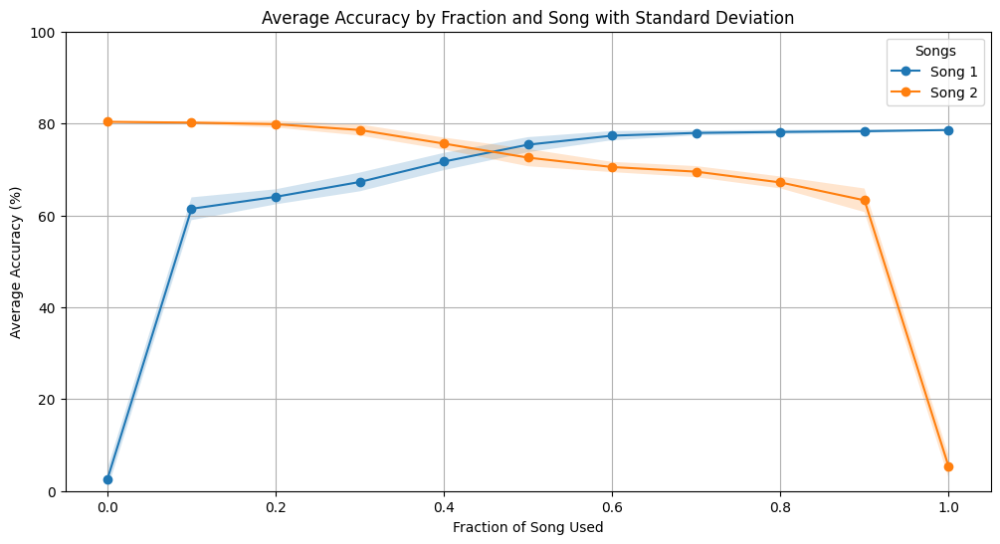

In [245]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()


#### plot for decision tree

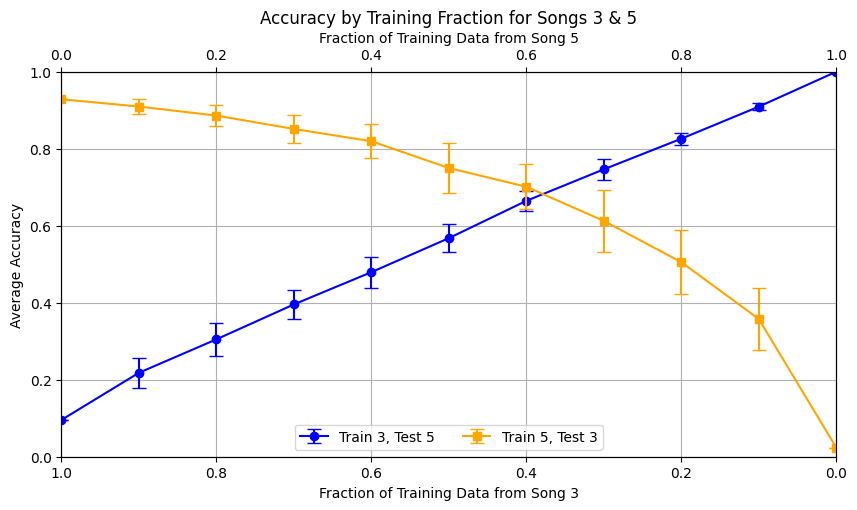

In [246]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data is already populated as in your previous script
# Define which song combinations you want to plot
desired_pairs = [(3, 5), (5, 3)]  # This will plot combinations of Song 1 and Song 2, both ways

# Plotting data for each unordered pair
for pair, data in plot_data.items():
    # Check if the current pair is in the list of desired pairs
    if pair in desired_pairs:
        fig, ax1 = plt.subplots(figsize=(10, 5))
        ax1.set_ylim([0, 1])  # Set the y-axis limit to [0, 1] for all plots

        # Initialize the secondary axis
        ax2 = ax1.twiny()

        # Sort data by fraction and plot for each training order within the pair
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))  # Sort data by fraction
            fractions, means, std_devs = zip(*sorted_data)

            # Plot with error bars
            if "Train " + str(pair[0]) in order_label:
                ax1.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
                ax1.set_xlabel(f'Fraction of Training Data from Song {pair[0]}')
                ax1.set_ylabel('Average Accuracy')
                ax1.set_xlim([1, 0])  # Inverts the x-axis for the first song
            else:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='orange', label=order_label, capsize=5)
                ax2.set_xlabel(f'Fraction of Training Data from Song {pair[1]}')
                ax2.set_xlim([0, 1])  # Regular order for the second song

        ax1.set_title(f'Accuracy by Training Fraction for Songs {pair[0]} & {pair[1]}')
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)
        ax1.grid(True)
        plt.show()


#### combined plot

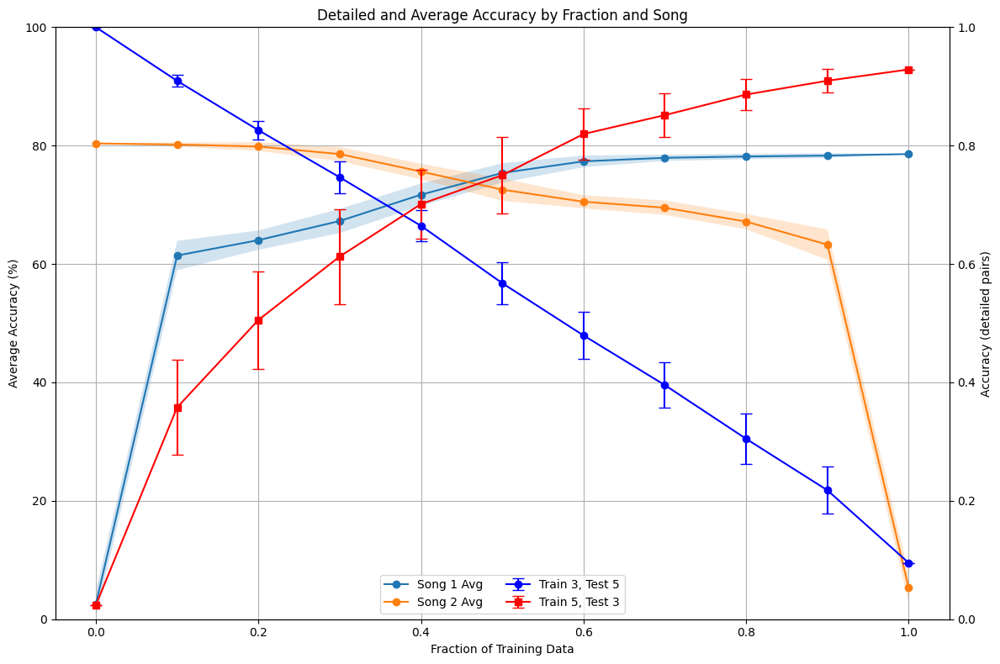

In [247]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming plot_data and accuracies are already populated as in your previous scripts

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Avg')
    ax1.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Detailed and Average Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction of Training Data')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(3, 5), (5, 3)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                # Mirror the x-values for the red line
                mirrored_fractions = [1 - f for f in fractions]
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately

# Combine legends from both axes
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines + lines2, labels + labels2, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


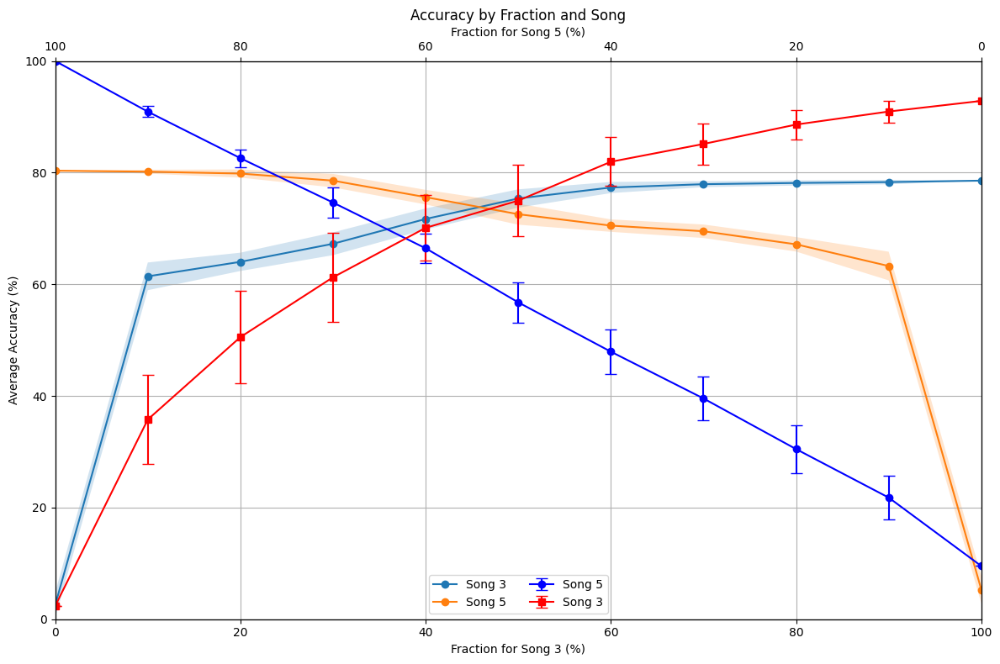

In [281]:
import matplotlib.pyplot as plt
import numpy as np

# Set up the figure and primary axis
fig, ax1 = plt.subplots(figsize=(12, 8))

# Plot the overall average accuracies in the primary axis
average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
std_dev_accuracies = accuracies.std(axis=2) * 100

for song_idx, song in enumerate(songStrings):
    x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]
    ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
    ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# Configure primary axis
ax1.set_title('Accuracy by Fraction and Song')
ax1.set_xlabel('Fraction for Song 3 (%)')
ax1.set_ylabel('Average Accuracy (%)')
ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
ax1.set_ylim(0, 100)
ax1.grid(True)

# Initialize the secondary axis on the same x-axis but different y-scale
ax2 = ax1.twinx()

# Plotting detailed pair data on the secondary axis
desired_pairs = [(5, 3), (3, 5)]  # Define which song combinations you want to plot
for pair, data in plot_data.items():
    if pair in desired_pairs:
        for order_label, (fractions, means, std_devs) in data.items():
            sorted_data = sorted(zip(fractions, means, std_devs))
            fractions, means, std_devs = zip(*sorted_data)
            fractions = np.array(fractions) * 100  # Convert to percentages for consistency

            if "Train " + str(pair[0]) in order_label:
                ax2.errorbar(fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
            else:
                mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages
                ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# Configure secondary axis
ax2.set_ylabel('Accuracy (detailed pairs)')
ax2.set_ylim(0, 1)  # Adjust the scale appropriately
ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# Configure secondary x-axis as before
ax3 = ax1.twiny()
ax3.set_xlabel('Fraction for Song 5 (%)')
ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# Extract lines and labels from the plots
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()

# Specify custom labels as required
custom_labels = ['Song 3', 'Song 5', 'Song 5', 'Song 3']

# Combine the lines and custom labels
combined_lines = lines + lines2

# Update the legend with custom labels
ax1.legend(combined_lines, custom_labels, loc='lower center', ncol=2)

plt.tight_layout()
plt.show()


In [249]:
# import matplotlib.pyplot as plt
# import numpy as np

# # Set up the figure and primary axis
# fig, ax1 = plt.subplots(figsize=(12, 8))

# # Plot the overall average accuracies in the primary axis
# average_accuracies = accuracies.mean(axis=2) * 100  # Assuming 'accuracies' is already calculated and available
# std_dev_accuracies = accuracies.std(axis=2) * 100

# for song_idx, song in enumerate(songStrings):
#     x_values = np.array(fractions)  # Ensure fractions are numpy array for operations
#     y_values = average_accuracies[:, song_idx]
#     y_err = std_dev_accuracies[:, song_idx]
#     ax1.plot(x_values * 100, y_values, marker='o', linestyle='-', label=f'Song {song_idx + 1} Transformers')
#     ax1.fill_between(x_values * 100, (y_values - y_err), (y_values + y_err), alpha=0.2)

# # Configure primary axis
# ax1.set_title('Accuracy by Fraction and Song')
# ax1.set_xlabel('Fraction for Song 3 (%)')
# ax1.set_ylabel('Average Accuracy (%)')
# ax1.set_xlim(0, 100)  # Set x-axis to start from 0 and scale fractions to percentages
# ax1.set_ylim(0, 100)
# ax1.grid(True)

# # Initialize the secondary axis on the same x-axis but different y-scale
# ax2 = ax1.twinx()

# # Plotting detailed pair data on the secondary axis
# desired_pairs = [(3, 5), (5, 3)]  # Define which song combinations you want to plot
# for pair, data in plot_data.items():
#     if pair in desired_pairs:
#         for order_label, (fractions, means, std_devs) in data.items():
#             sorted_data = sorted(zip(fractions, means, std_devs))
#             fractions, means, std_devs = zip(*sorted_data)
#             fractions = np.array(fractions) * 100  # Convert to percentages for consistency

#             if "Train " + str(pair[0]) in order_label:
#                 mirrored_fractions = 100 - np.array(fractions)  # Mirror the percentages for reversing the direction
#                 ax2.errorbar(mirrored_fractions, means, yerr=std_devs, fmt='o-', color='blue', label=order_label, capsize=5)
#             else:
#                 ax2.errorbar(fractions, means, yerr=std_devs, fmt='s-', color='red', label=order_label, capsize=5)

# # Configure secondary axis
# ax2.set_ylabel('Accuracy (detailed pairs)')
# ax2.set_ylim(0, 1)  # Adjust the scale appropriately
# ax2.yaxis.set_visible(False)  # Hide the secondary y-axis labels and ticks

# # Configure secondary x-axis as before
# ax3 = ax1.twiny()
# ax3.set_xlabel('Fraction for Song 5 (%)')
# ax3.set_xlim(100, 0)  # Set limits to invert the secondary x-axis starting from 100 to 0

# # Combine legends from both axes
# lines, labels = ax1.get_legend_handles_labels()
# lines2, labels2 = ax2.get_legend_handles_labels()
# lines3, labels3 = ax3.get_legend_handles_labels()
# ax1.legend(lines + lines2 + lines3, labels + labels2 + labels3, loc='lower center', ncol=2)

# plt.tight_layout()
# plt.show()


## Training and Testing for daisybells and 5th note Lower parameter

Model 0, Fraction 0.00, Epoch 1, Loss: 2.1989
prediction shape torch.Size([4, 42])


/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  source = torch.tensor(source, dtype=torch.long)
/var/folders/wn/f4cc27tx13g8w1qgpzb2bsrm0000gn/T/ipykernel_37700/2366339544.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  target = torch.tensor(target, dtype=torch.long)


Model 0, Fraction 0.00, Epoch 101, Loss: 2.0135
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 201, Loss: 1.5584
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 301, Loss: 1.3003
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 401, Loss: 1.1454
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 501, Loss: 1.0289
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 601, Loss: 0.9412
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 701, Loss: 0.8687
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 801, Loss: 0.8174
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 901, Loss: 0.7811
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1001, Loss: 0.7545
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1101, Loss: 0.7386
prediction shape torch.Size([4, 42])
Model 0, Fraction 0.00, Epoch 1201, Loss: 0.7183
prediction sha

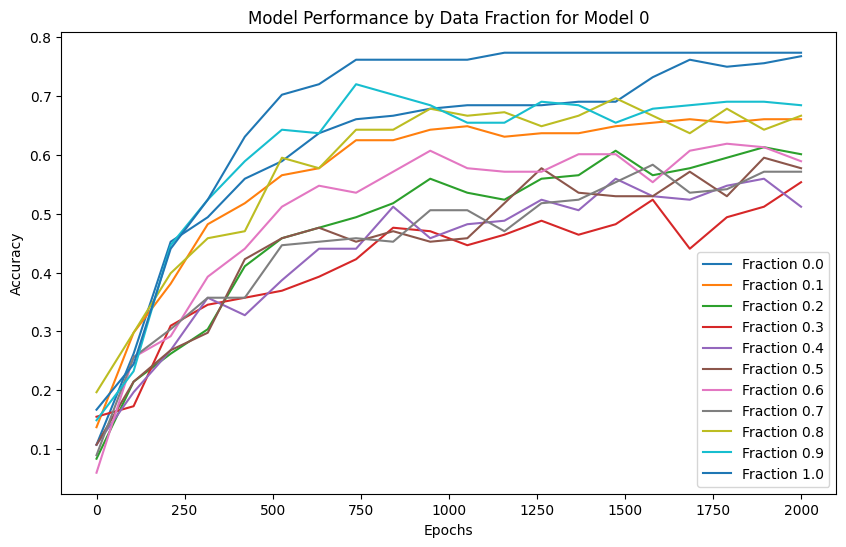

Model 1, Fraction 0.00, Epoch 1, Loss: 2.2062
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 101, Loss: 2.0370
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 201, Loss: 1.5813
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 301, Loss: 1.3391
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 401, Loss: 1.1794
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 501, Loss: 1.0651
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 601, Loss: 0.9838
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 701, Loss: 0.9131
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 801, Loss: 0.8589
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 901, Loss: 0.8004
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1001, Loss: 0.7650
prediction shape torch.Size([4, 42])
Model 1, Fraction 0.00, Epoch 1101, Loss: 0.7388
prediction shape 

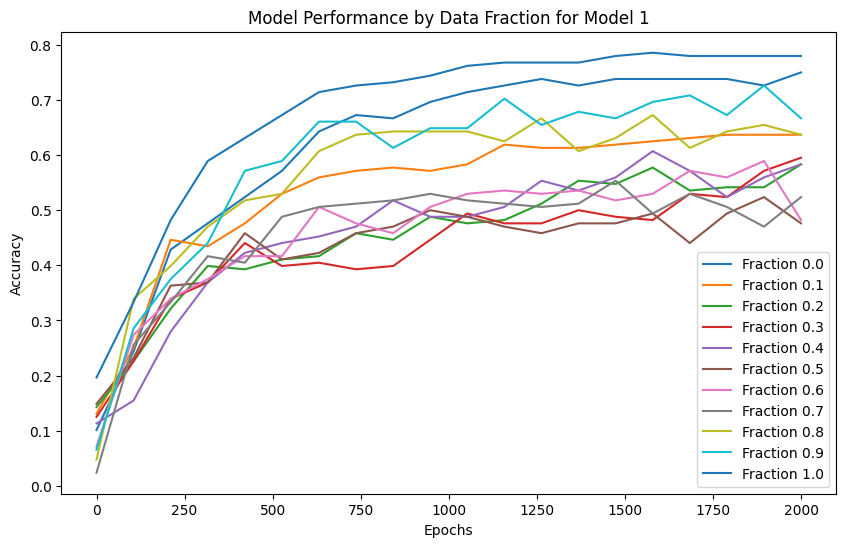

Model 2, Fraction 0.00, Epoch 1, Loss: 2.1919
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 101, Loss: 2.0077
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 201, Loss: 1.6579
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 301, Loss: 1.3754
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 401, Loss: 1.2431
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 501, Loss: 1.1574
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 601, Loss: 1.1023
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 701, Loss: 1.0540
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 801, Loss: 0.9913
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 901, Loss: 0.9383
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1001, Loss: 0.8812
prediction shape torch.Size([4, 42])
Model 2, Fraction 0.00, Epoch 1101, Loss: 0.8355
prediction shape 

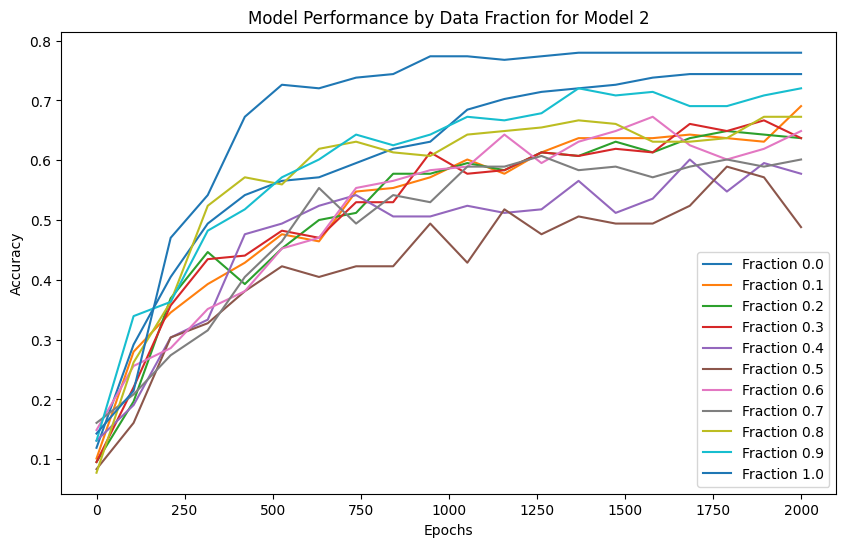

Model 3, Fraction 0.00, Epoch 1, Loss: 2.2059
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 101, Loss: 2.0326
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 201, Loss: 1.6444
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 301, Loss: 1.3916
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 401, Loss: 1.1823
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 501, Loss: 0.9959
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 601, Loss: 0.8944
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 701, Loss: 0.8157
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 801, Loss: 0.7703
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 901, Loss: 0.7370
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1001, Loss: 0.7145
prediction shape torch.Size([4, 42])
Model 3, Fraction 0.00, Epoch 1101, Loss: 0.7022
prediction shape 

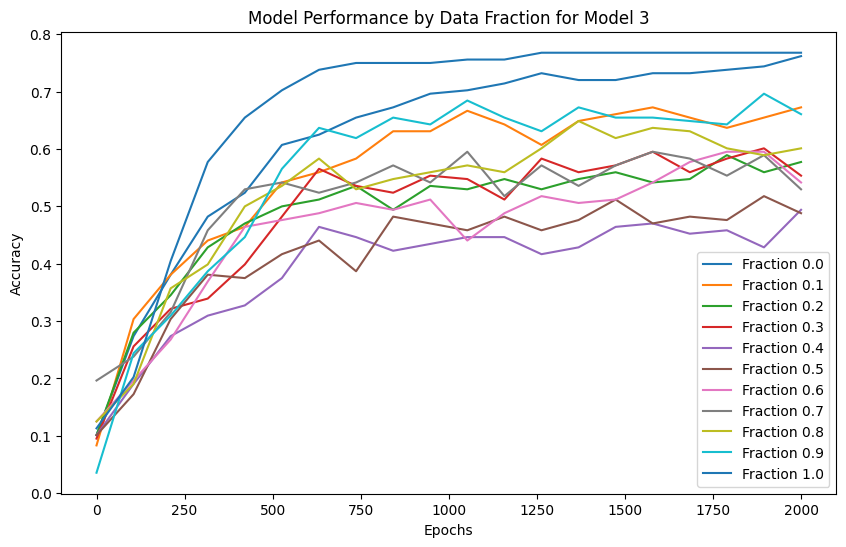

Model 4, Fraction 0.00, Epoch 1, Loss: 2.2079
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 101, Loss: 1.9928
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 201, Loss: 1.6496
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 301, Loss: 1.4257
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 401, Loss: 1.1836
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 501, Loss: 1.0165
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 601, Loss: 0.9317
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 701, Loss: 0.8793
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 801, Loss: 0.8500
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 901, Loss: 0.8241
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1001, Loss: 0.8162
prediction shape torch.Size([4, 42])
Model 4, Fraction 0.00, Epoch 1101, Loss: 0.7902
prediction shape 

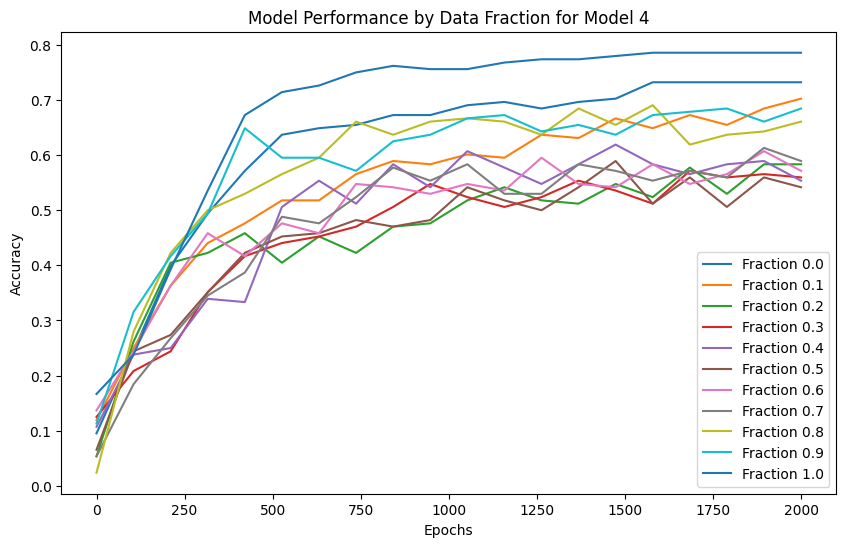

Model 5, Fraction 0.00, Epoch 1, Loss: 2.1993
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 101, Loss: 1.9641
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 201, Loss: 1.6273
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 301, Loss: 1.3790
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 401, Loss: 1.2112
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 501, Loss: 1.0981
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 601, Loss: 1.0019
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 701, Loss: 0.9196
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 801, Loss: 0.8722
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 901, Loss: 0.8424
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1001, Loss: 0.8041
prediction shape torch.Size([4, 42])
Model 5, Fraction 0.00, Epoch 1101, Loss: 0.7782
prediction shape 

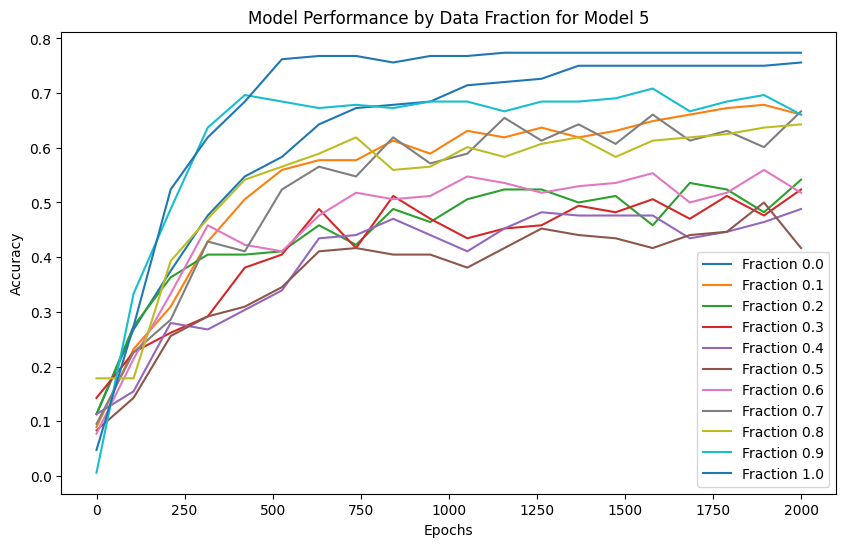

Model 6, Fraction 0.00, Epoch 1, Loss: 2.2304
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 101, Loss: 2.0160
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 201, Loss: 1.6973
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 301, Loss: 1.4658
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 401, Loss: 1.2004
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 501, Loss: 0.9723
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 601, Loss: 0.8351
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 701, Loss: 0.7515
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 801, Loss: 0.6921
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 901, Loss: 0.6519
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1001, Loss: 0.6184
prediction shape torch.Size([4, 42])
Model 6, Fraction 0.00, Epoch 1101, Loss: 0.5984
prediction shape 

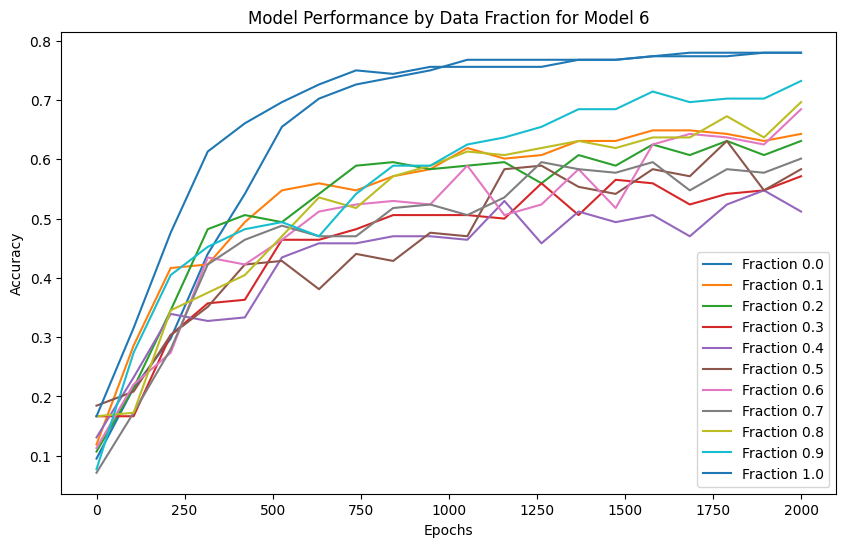

Model 7, Fraction 0.00, Epoch 1, Loss: 2.1951
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 101, Loss: 2.0072
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 201, Loss: 1.6558
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 301, Loss: 1.3723
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 401, Loss: 1.1859
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 501, Loss: 1.0642
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 601, Loss: 0.9639
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 701, Loss: 0.8930
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 801, Loss: 0.8422
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 901, Loss: 0.8036
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1001, Loss: 0.8379
prediction shape torch.Size([4, 42])
Model 7, Fraction 0.00, Epoch 1101, Loss: 0.7460
prediction shape 

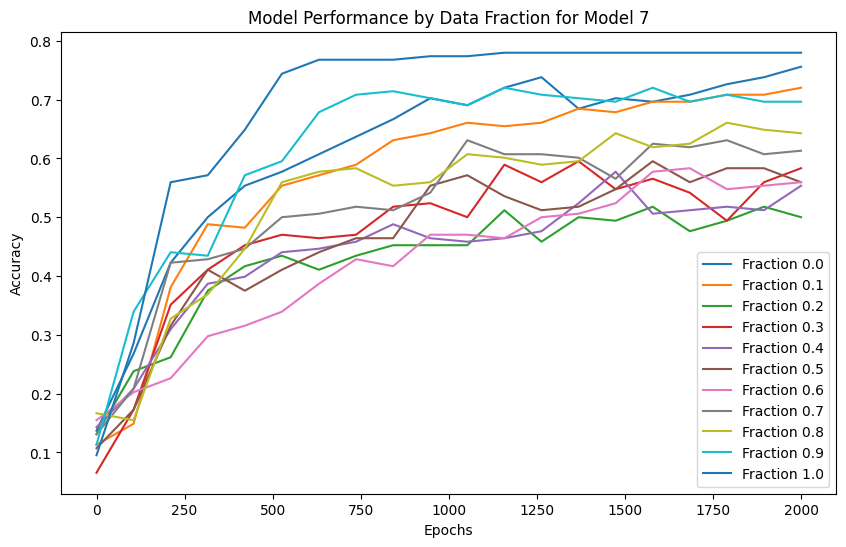

Model 8, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 101, Loss: 1.9591
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 201, Loss: 1.5717
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 301, Loss: 1.3353
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 401, Loss: 1.1523
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 501, Loss: 1.0355
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 601, Loss: 0.9615
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 701, Loss: 0.9081
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 801, Loss: 0.8587
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 901, Loss: 0.8150
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1001, Loss: 0.7801
prediction shape torch.Size([4, 42])
Model 8, Fraction 0.00, Epoch 1101, Loss: 0.7517
prediction shape 

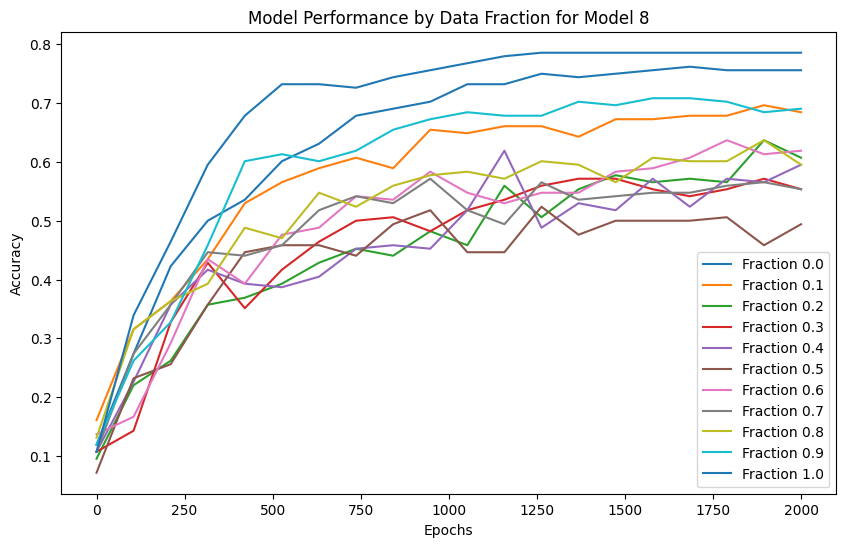

Model 9, Fraction 0.00, Epoch 1, Loss: 2.1930
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 101, Loss: 1.9688
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 201, Loss: 1.6541
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 301, Loss: 1.4153
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 401, Loss: 1.2421
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 501, Loss: 1.1280
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 601, Loss: 1.0522
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 701, Loss: 1.0073
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 801, Loss: 0.9822
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 901, Loss: 0.9627
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1001, Loss: 0.9458
prediction shape torch.Size([4, 42])
Model 9, Fraction 0.00, Epoch 1101, Loss: 0.9285
prediction shape 

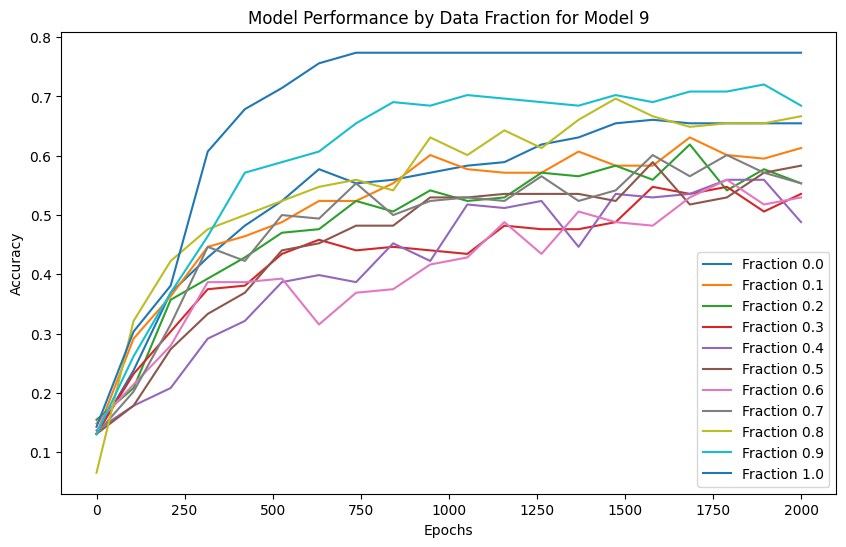

Model 10, Fraction 0.00, Epoch 1, Loss: 2.2056
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 101, Loss: 1.9002
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 201, Loss: 1.5822
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 301, Loss: 1.3858
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 401, Loss: 1.2479
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 501, Loss: 1.1186
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 601, Loss: 1.0228
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 701, Loss: 0.9148
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 801, Loss: 0.8414
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 901, Loss: 0.7888
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1001, Loss: 0.7553
prediction shape torch.Size([4, 42])
Model 10, Fraction 0.00, Epoch 1101, Loss: 0.7278
predi

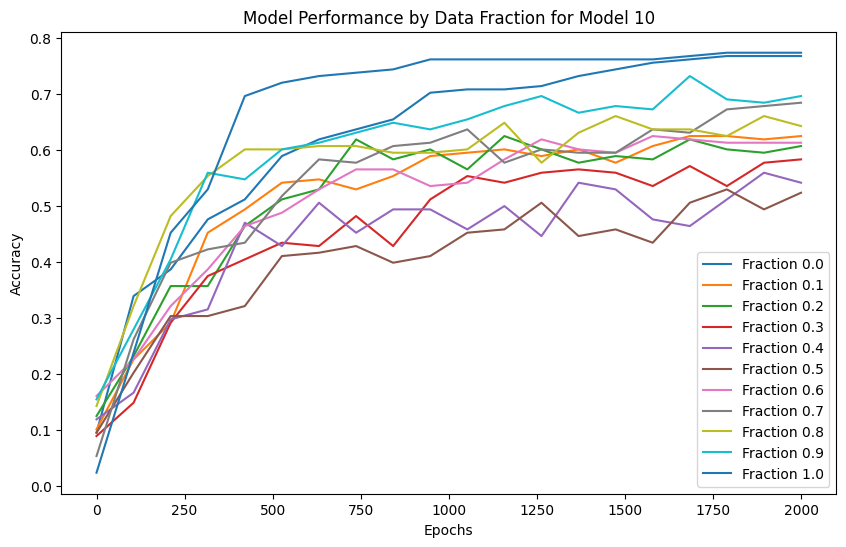

Model 11, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 101, Loss: 1.9042
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 201, Loss: 1.6541
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 301, Loss: 1.3790
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 401, Loss: 1.1866
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 501, Loss: 1.0017
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 601, Loss: 0.9176
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 701, Loss: 0.8725
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 801, Loss: 0.8280
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 901, Loss: 0.8059
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1001, Loss: 0.8100
prediction shape torch.Size([4, 42])
Model 11, Fraction 0.00, Epoch 1101, Loss: 0.7860
predi

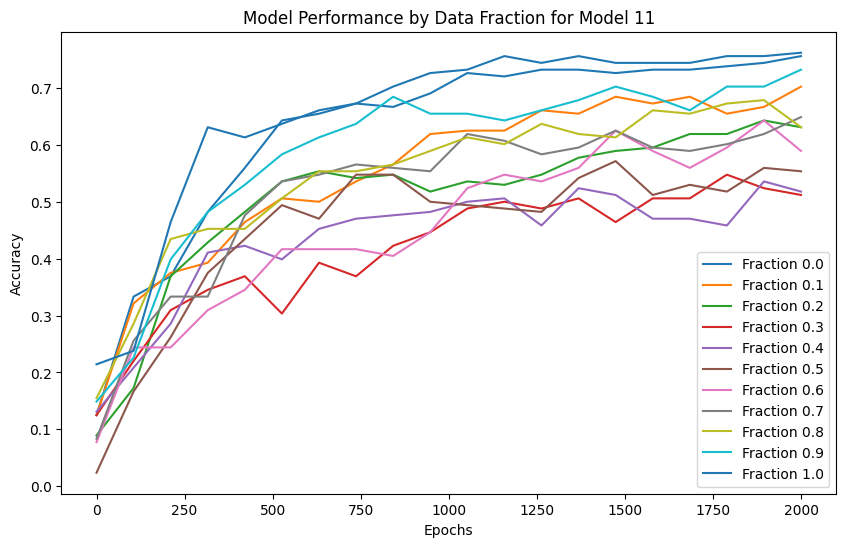

Model 12, Fraction 0.00, Epoch 1, Loss: 2.1928
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 101, Loss: 1.9671
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 201, Loss: 1.6285
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 301, Loss: 1.3903
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 401, Loss: 1.2151
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 501, Loss: 1.0879
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 601, Loss: 0.9799
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 701, Loss: 0.9011
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 801, Loss: 0.8270
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 901, Loss: 0.7714
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1001, Loss: 0.7346
prediction shape torch.Size([4, 42])
Model 12, Fraction 0.00, Epoch 1101, Loss: 0.7080
predi

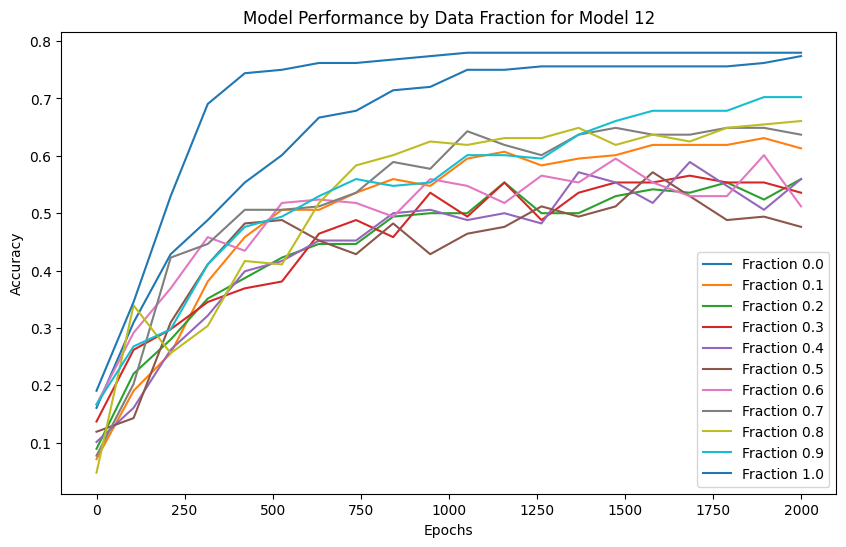

Model 13, Fraction 0.00, Epoch 1, Loss: 2.2091
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 101, Loss: 2.0396
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 201, Loss: 1.6148
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 301, Loss: 1.3394
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 401, Loss: 1.1024
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 501, Loss: 0.9296
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 601, Loss: 0.8378
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 701, Loss: 0.7826
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 801, Loss: 0.7442
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 901, Loss: 0.7157
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1001, Loss: 0.6949
prediction shape torch.Size([4, 42])
Model 13, Fraction 0.00, Epoch 1101, Loss: 0.6781
predi

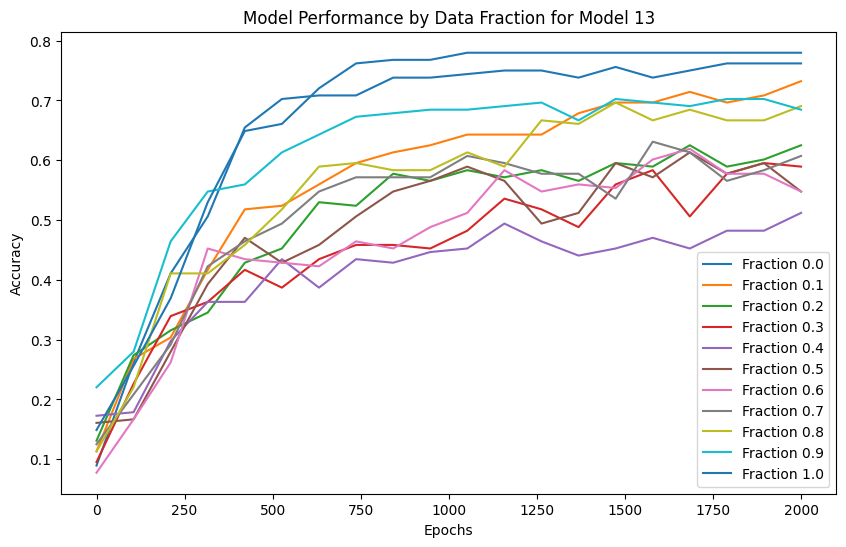

Model 14, Fraction 0.00, Epoch 1, Loss: 2.2058
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 101, Loss: 1.9630
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 201, Loss: 1.6122
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 301, Loss: 1.3258
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 401, Loss: 1.1494
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 501, Loss: 1.0264
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 601, Loss: 0.9337
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 701, Loss: 0.8568
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 801, Loss: 0.8038
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 901, Loss: 0.7609
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1001, Loss: 0.7264
prediction shape torch.Size([4, 42])
Model 14, Fraction 0.00, Epoch 1101, Loss: 0.6962
predi

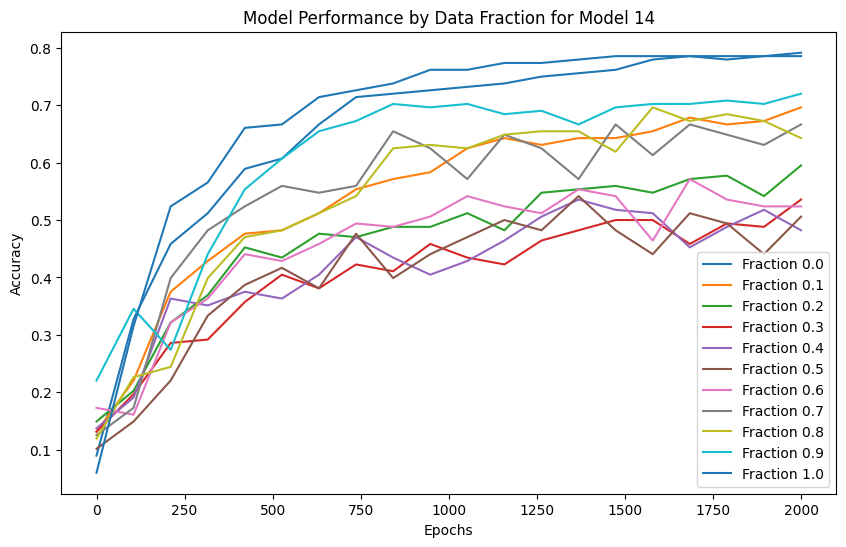

Model 15, Fraction 0.00, Epoch 1, Loss: 2.2006
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 101, Loss: 1.9863
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 201, Loss: 1.5966
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 301, Loss: 1.3514
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 401, Loss: 1.2203
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 501, Loss: 1.1033
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 601, Loss: 0.9981
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 701, Loss: 0.9139
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 801, Loss: 0.8546
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 901, Loss: 0.7975
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1001, Loss: 0.7578
prediction shape torch.Size([4, 42])
Model 15, Fraction 0.00, Epoch 1101, Loss: 0.7258
predi

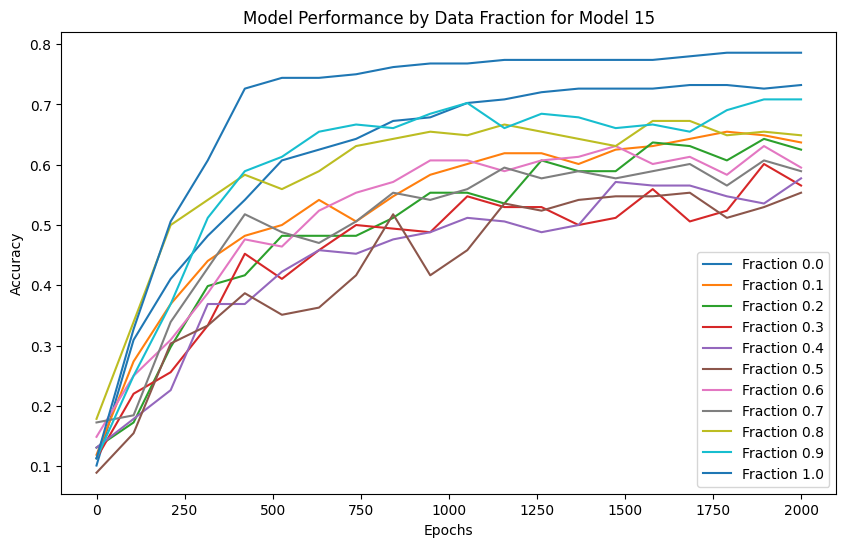

Model 16, Fraction 0.00, Epoch 1, Loss: 2.1985
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 101, Loss: 1.9658
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 201, Loss: 1.6683
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 301, Loss: 1.4089
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 401, Loss: 1.2337
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 501, Loss: 1.1130
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 601, Loss: 1.0278
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 701, Loss: 0.9463
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 801, Loss: 0.8824
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 901, Loss: 0.8185
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1001, Loss: 0.7538
prediction shape torch.Size([4, 42])
Model 16, Fraction 0.00, Epoch 1101, Loss: 0.7027
predi

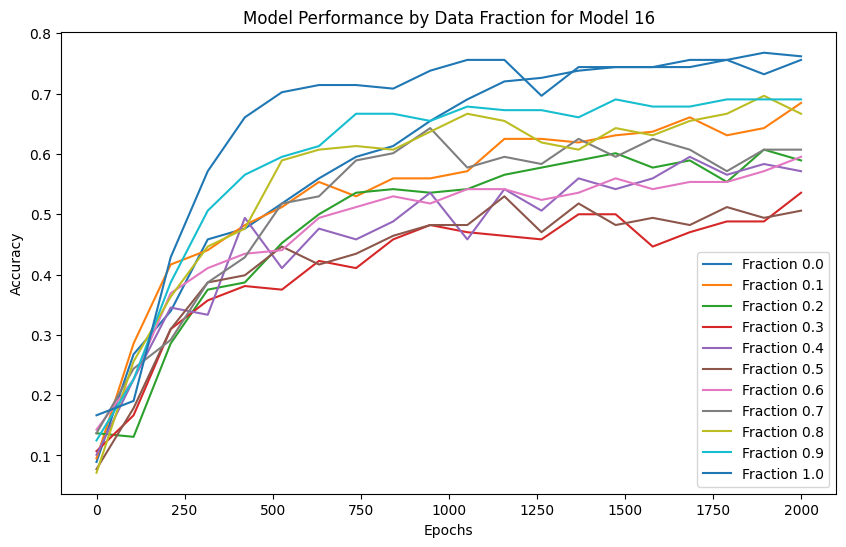

Model 17, Fraction 0.00, Epoch 1, Loss: 2.2065
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 101, Loss: 1.8806
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 201, Loss: 1.5494
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 301, Loss: 1.3361
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 401, Loss: 1.1881
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 501, Loss: 1.0685
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 601, Loss: 0.9663
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 701, Loss: 0.8932
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 801, Loss: 0.8285
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 901, Loss: 0.7782
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1001, Loss: 0.7288
prediction shape torch.Size([4, 42])
Model 17, Fraction 0.00, Epoch 1101, Loss: 0.6983
predi

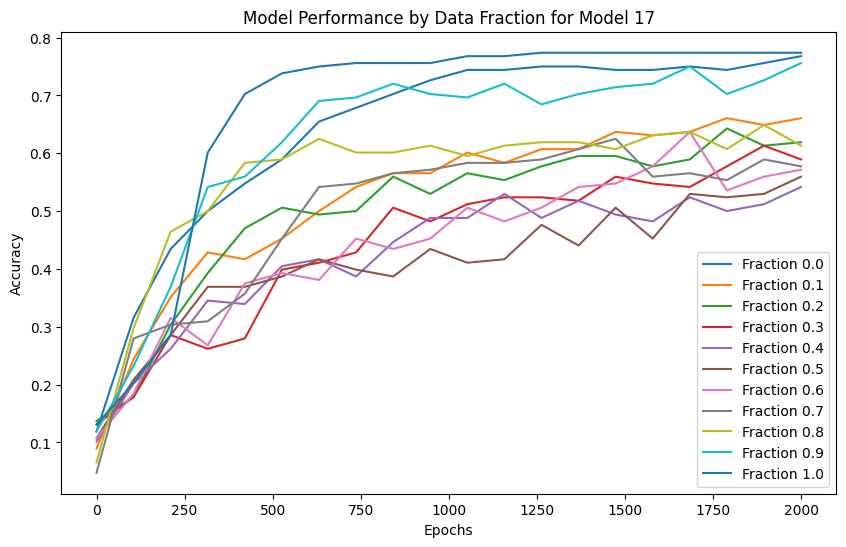

Model 18, Fraction 0.00, Epoch 1, Loss: 2.2090
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 101, Loss: 2.0190
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 201, Loss: 1.5709
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 301, Loss: 1.3232
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 401, Loss: 1.1170
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 501, Loss: 0.9996
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 601, Loss: 0.8857
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 701, Loss: 0.8188
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 801, Loss: 0.7730
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 901, Loss: 0.7270
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1001, Loss: 0.6932
prediction shape torch.Size([4, 42])
Model 18, Fraction 0.00, Epoch 1101, Loss: 0.6685
predi

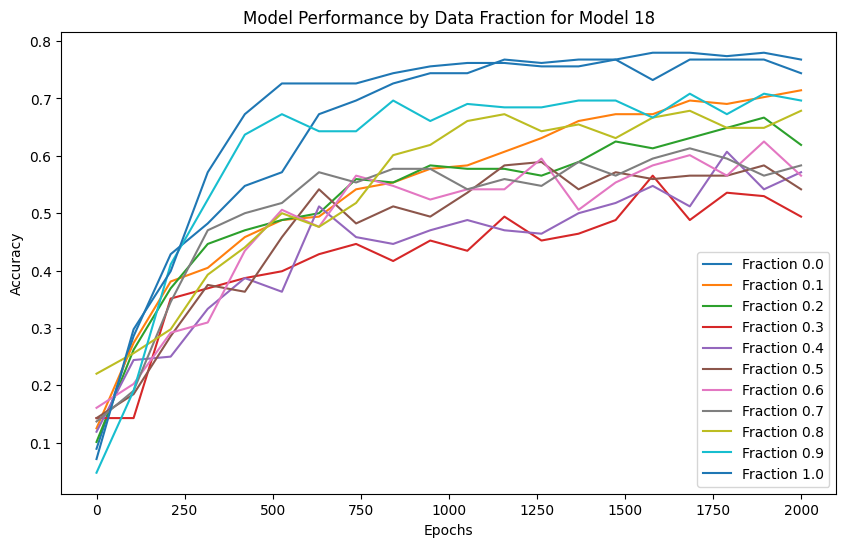

Model 19, Fraction 0.00, Epoch 1, Loss: 2.2010
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 101, Loss: 1.9842
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 201, Loss: 1.6519
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 301, Loss: 1.4613
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 401, Loss: 1.2901
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 501, Loss: 1.1048
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 601, Loss: 0.9799
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 701, Loss: 0.9045
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 801, Loss: 0.8491
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 901, Loss: 0.8078
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1001, Loss: 0.7598
prediction shape torch.Size([4, 42])
Model 19, Fraction 0.00, Epoch 1101, Loss: 0.7286
predi

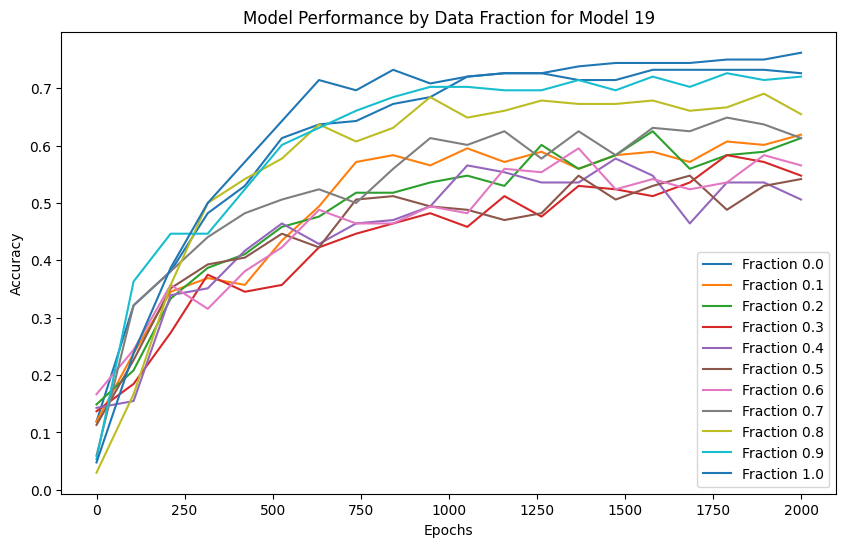

Model 20, Fraction 0.00, Epoch 1, Loss: 2.1962
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 101, Loss: 1.9337
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 201, Loss: 1.6040
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 301, Loss: 1.3488
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 401, Loss: 1.1759
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 501, Loss: 1.0321
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 601, Loss: 0.9425
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 701, Loss: 0.8795
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 801, Loss: 0.8238
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 901, Loss: 0.7827
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1001, Loss: 0.7483
prediction shape torch.Size([4, 42])
Model 20, Fraction 0.00, Epoch 1101, Loss: 0.7232
predi

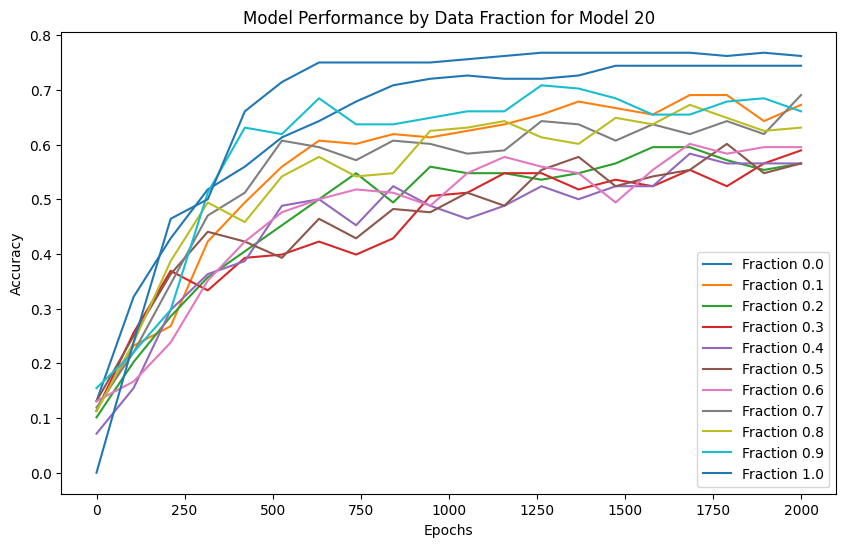

Model 21, Fraction 0.00, Epoch 1, Loss: 2.2053
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 101, Loss: 1.9338
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 201, Loss: 1.6349
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 301, Loss: 1.3438
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 401, Loss: 1.1351
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 501, Loss: 1.0036
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 601, Loss: 0.9254
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 701, Loss: 0.8697
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 801, Loss: 0.8303
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 901, Loss: 0.7929
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1001, Loss: 0.7585
prediction shape torch.Size([4, 42])
Model 21, Fraction 0.00, Epoch 1101, Loss: 0.7543
predi

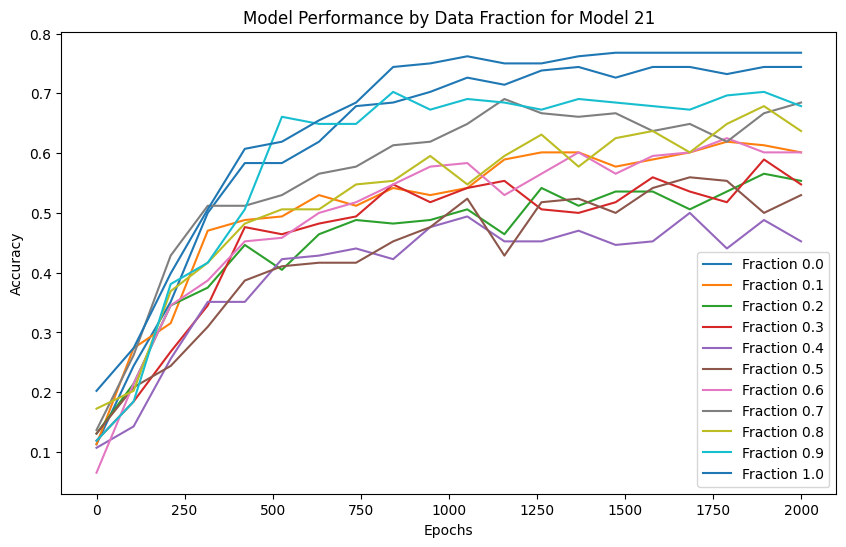

Model 22, Fraction 0.00, Epoch 1, Loss: 2.2142
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 101, Loss: 1.9642
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 201, Loss: 1.6085
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 301, Loss: 1.3677
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 401, Loss: 1.2036
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 501, Loss: 1.0958
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 601, Loss: 1.0455
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 701, Loss: 1.0017
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 801, Loss: 0.9786
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 901, Loss: 0.9467
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1001, Loss: 0.9222
prediction shape torch.Size([4, 42])
Model 22, Fraction 0.00, Epoch 1101, Loss: 0.9053
predi

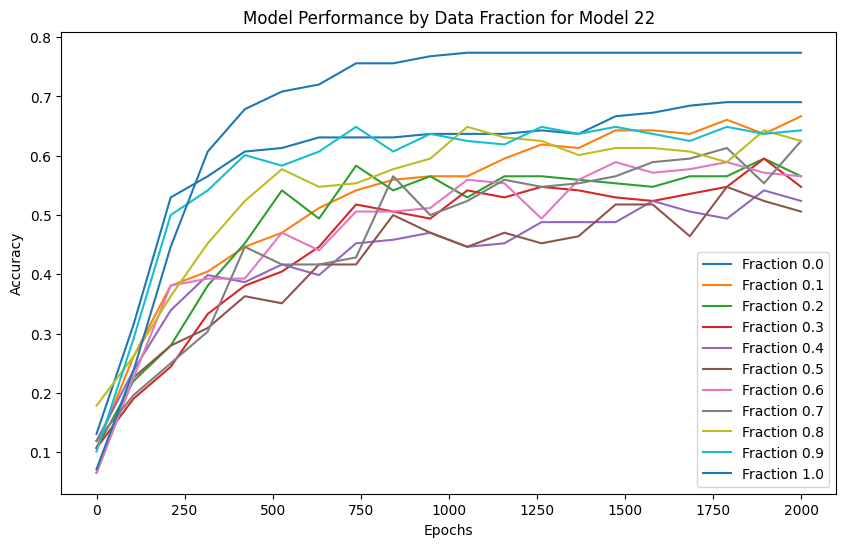

Model 23, Fraction 0.00, Epoch 1, Loss: 2.2065
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 101, Loss: 1.9270
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 201, Loss: 1.5415
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 301, Loss: 1.3156
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 401, Loss: 1.1395
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 501, Loss: 1.0095
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 601, Loss: 0.9199
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 701, Loss: 0.8569
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 801, Loss: 0.8081
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 901, Loss: 0.7646
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1001, Loss: 0.7559
prediction shape torch.Size([4, 42])
Model 23, Fraction 0.00, Epoch 1101, Loss: 0.6959
predi

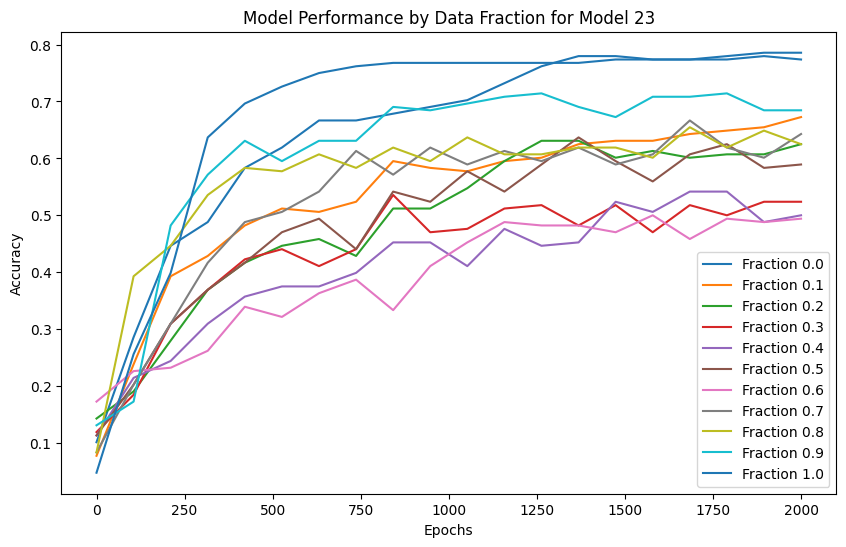

Model 24, Fraction 0.00, Epoch 1, Loss: 2.2008
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 101, Loss: 1.9982
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 201, Loss: 1.6148
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 301, Loss: 1.3800
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 401, Loss: 1.1583
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 501, Loss: 1.0000
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 601, Loss: 0.8965
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 701, Loss: 0.8305
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 801, Loss: 0.7868
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 901, Loss: 0.7312
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1001, Loss: 0.7027
prediction shape torch.Size([4, 42])
Model 24, Fraction 0.00, Epoch 1101, Loss: 0.6779
predi

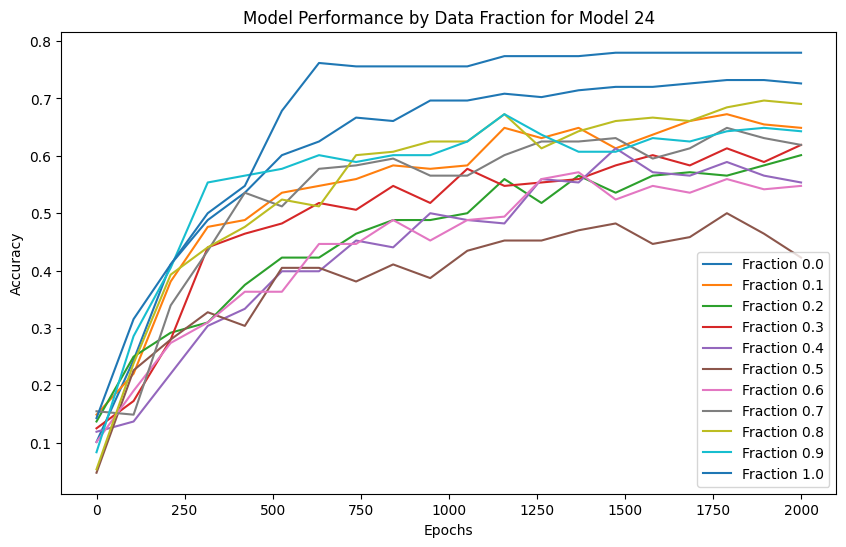

Model 25, Fraction 0.00, Epoch 1, Loss: 2.2130
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 101, Loss: 2.0315
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 201, Loss: 1.6129
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 301, Loss: 1.3835
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 401, Loss: 1.2448
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 501, Loss: 1.1383
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 601, Loss: 1.0555
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 701, Loss: 0.9914
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 801, Loss: 0.9405
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 901, Loss: 0.8923
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1001, Loss: 0.8579
prediction shape torch.Size([4, 42])
Model 25, Fraction 0.00, Epoch 1101, Loss: 0.8327
predi

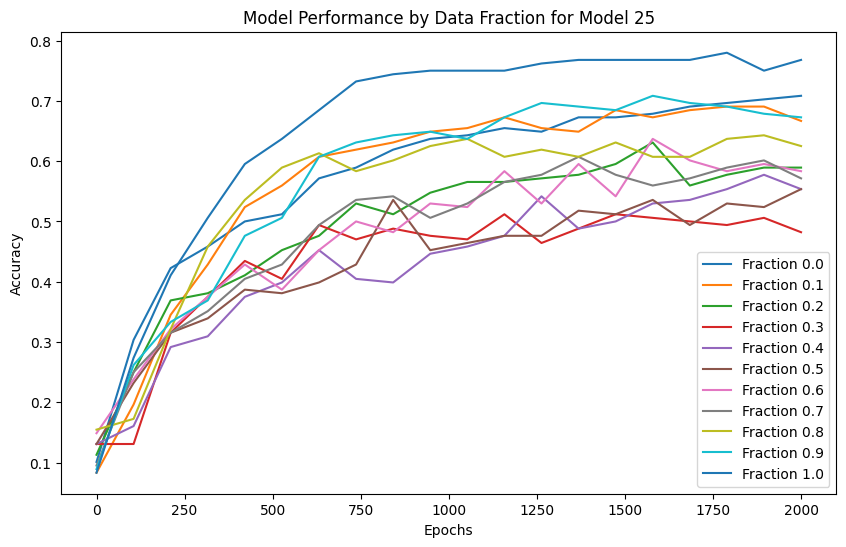

Model 26, Fraction 0.00, Epoch 1, Loss: 2.1849
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 101, Loss: 1.9151
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 201, Loss: 1.6431
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 301, Loss: 1.4592
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 401, Loss: 1.2615
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 501, Loss: 1.0845
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 601, Loss: 0.9589
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 701, Loss: 0.8838
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 801, Loss: 0.8348
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 901, Loss: 0.8003
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1001, Loss: 0.7876
prediction shape torch.Size([4, 42])
Model 26, Fraction 0.00, Epoch 1101, Loss: 0.7494
predi

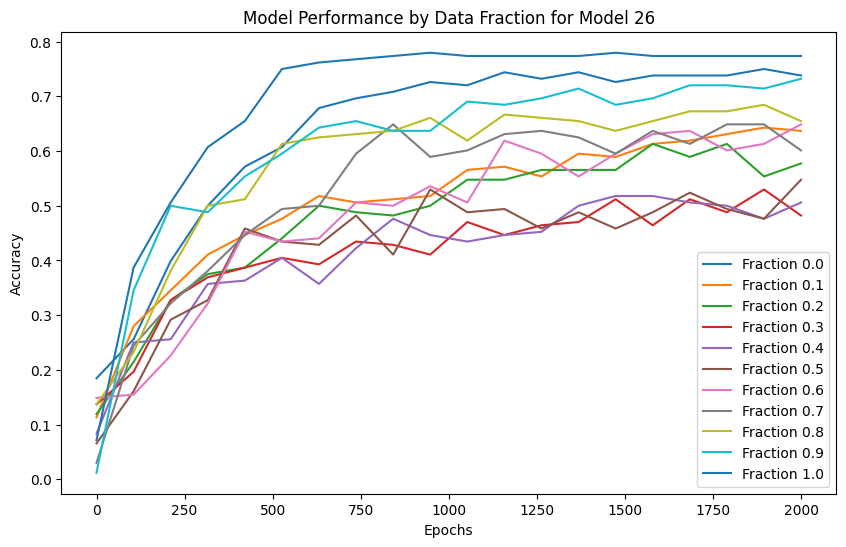

Model 27, Fraction 0.00, Epoch 1, Loss: 2.2084
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 101, Loss: 2.0280
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 201, Loss: 1.5927
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 301, Loss: 1.3604
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 401, Loss: 1.2063
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 501, Loss: 1.0814
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 601, Loss: 0.9471
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 701, Loss: 0.8131
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 801, Loss: 0.7364
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 901, Loss: 0.6923
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1001, Loss: 0.6646
prediction shape torch.Size([4, 42])
Model 27, Fraction 0.00, Epoch 1101, Loss: 0.6426
predi

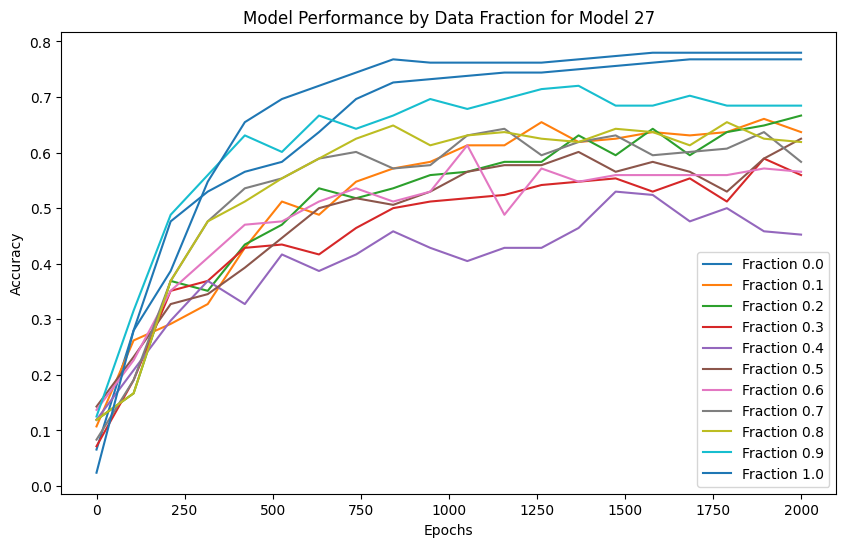

Model 28, Fraction 0.00, Epoch 1, Loss: 2.2063
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 101, Loss: 2.0252
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 201, Loss: 1.6485
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 301, Loss: 1.4087
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 401, Loss: 1.2554
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 501, Loss: 1.1144
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 601, Loss: 1.0157
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 701, Loss: 0.9547
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 801, Loss: 0.9113
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 901, Loss: 0.8800
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1001, Loss: 0.8501
prediction shape torch.Size([4, 42])
Model 28, Fraction 0.00, Epoch 1101, Loss: 0.8177
predi

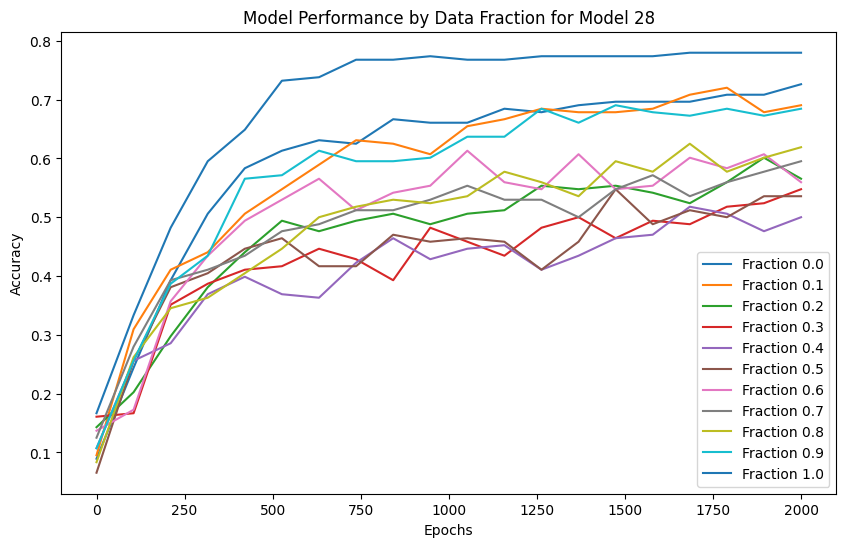

Model 29, Fraction 0.00, Epoch 1, Loss: 2.2156
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 101, Loss: 2.0236
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 201, Loss: 1.6519
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 301, Loss: 1.3776
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 401, Loss: 1.1610
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 501, Loss: 1.0077
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 601, Loss: 0.8858
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 701, Loss: 0.7985
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 801, Loss: 0.7364
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 901, Loss: 0.6957
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1001, Loss: 0.6731
prediction shape torch.Size([4, 42])
Model 29, Fraction 0.00, Epoch 1101, Loss: 0.6469
predi

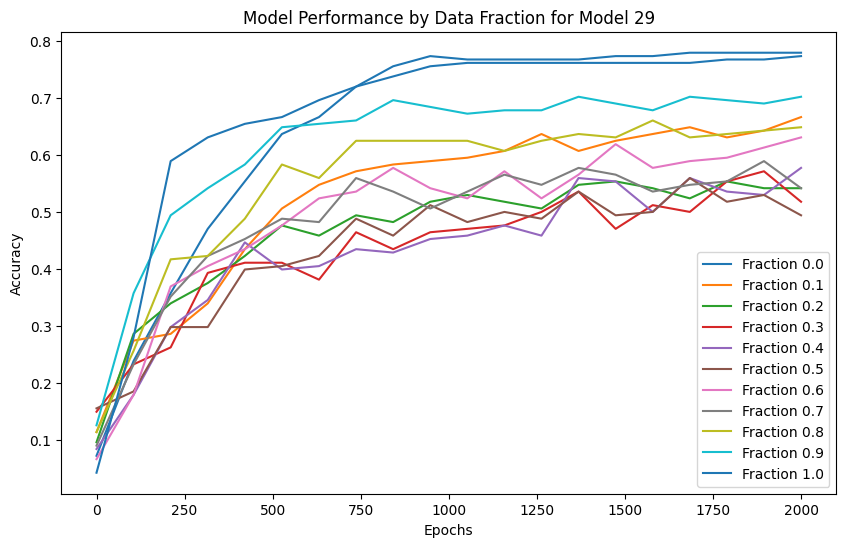

In [16]:
## import os
import numpy as np
import torch
from torch import nn, optim
import matplotlib.pyplot as plt

# Parameters
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 2
dropout = 0.03
learning_rate = 1e-3
num_epochs = 2000
fractions = np.arange(0, 101, 10) / 100
num_models = 30  # Train 30 different models

songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

for model_idx in range(num_models):
    model_dir = f"Songs_hard_daisy_5th_note_lower_parameter/model_{model_idx}"
    os.makedirs(model_dir, exist_ok=True)

    source, target = getTrainingData(songStrings, 2)
    fraction_accuracies = {}

    for fraction in fractions:
        model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
        W = []
        model.train()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

        input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        for epoch in range(num_epochs):
            optimizer.zero_grad()
            source_tensor = torch.tensor(input_list, dtype=torch.long)
            target_tensor = torch.tensor(output_list, dtype=torch.long)

            src = source_tensor.transpose(0, 1)
            tgt = target_tensor.transpose(0, 1)

            output = model(src)
            loss = criterion(output.view(-1, model.ntokens), tgt.reshape(-1))
            loss.backward()
            optimizer.step()

            if epoch % 100 == 0:
                avg_loss = loss.item()
                print(f'Model {model_idx}, Fraction {fraction:.2f}, Epoch {epoch+1}, Loss: {avg_loss:.4f}')
                acc = test(model, source_tensor, target_tensor)
                W.append(acc)
            
            input_list, output_list = split_and_shuffle_data_randomly_based_on_fraction(source, target, fraction)

        fraction_accuracies[fraction] = W
        model_save_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
        torch.save(model.state_dict(), model_save_path)

    # Optionally plot accuracies for each model or save the data for further analysis
    plt.figure(figsize=(10, 6))
    for fraction, accuracies in fraction_accuracies.items():
        epochs = np.linspace(0, num_epochs, len(accuracies))
        plt.plot(epochs, accuracies, label=f'Fraction {fraction}')

    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title(f'Model Performance by Data Fraction for Model {model_idx}')
    plt.legend()
    plt.show()


In [17]:
import os
import numpy as np
import torch

# Assuming TransformerModel and necessary data functions are properly defined
# Initialize the model parameters (keep these consistent with training)
ntokens = 9
emsize = 4
nhead = 2
d_hid = 4
nlayers = 2
dropout = 0.03

# Define the directory where models are saved
base_model_dir = "Songs_hard_daisy_5th_note_lower_parameter"

# Fractions and song strings for which models were trained
fractions = np.arange(0, 101, 10) / 100
songStrings = np.array([
    "CCGGAAGFFEEDDCGGFFEEDGGFFEEDCCGGAAGFFEEDDC",
    "ABCDAFGHIEBCDEAGHIAFCDEFIHIABADEFGCIABCBEF"
])

# Array to store accuracies
accuracies = np.zeros((len(fractions), len(songStrings), num_models))  # Added a dimension for models

# Load and test each model for each fraction and song
for model_idx in range(num_models):  # You trained 10 models
    for frac_idx, fraction in enumerate(fractions):
        for song_idx, song in enumerate(songStrings):
            model_dir = f"{base_model_dir}/model_{model_idx}"
            model_path = os.path.join(model_dir, f'model_at_fraction_{fraction:.2f}.pt')
            
            # Load model if it exists
            if os.path.exists(model_path):
                model = TransformerModel(ntokens, emsize, nhead, d_hid, nlayers, dropout)
                model.load_state_dict(torch.load(model_path))
                model.eval()

                source, target = getTrainingData(np.array([song]), 1)
                source_tensor = torch.tensor(source, dtype=torch.long)
                target_tensor = torch.tensor(target, dtype=torch.long)

                with torch.no_grad():
                    src = source_tensor.transpose(0, 1)
                    tgt = target_tensor.transpose(0, 1)
                    output = model(src)
                    predictions = output.argmax(dim=2)

                    correct = (predictions == tgt).sum().item()
                    total = tgt.numel()

                    accuracy = correct / total
                    accuracies[frac_idx, song_idx, model_idx] = accuracy
            else:
                print(f"Model not found: {model_path}")

# Optionally, average accuracies across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2)  # Average over the model dimension

# Print or process the average accuracies array as needed
for song_idx, song in enumerate(songStrings):
    print(f"Accuracies for Song {song_idx + 1}:")
    for frac_idx, fraction in enumerate(fractions):
        print(f"  Fraction {fraction:.2f}, Average Accuracy: {average_accuracies[frac_idx, song_idx]:.4f}")


Accuracies for Song 1:
  Fraction 0.00, Average Accuracy: 0.0429
  Fraction 0.10, Average Accuracy: 0.2161
  Fraction 0.20, Average Accuracy: 0.3308
  Fraction 0.30, Average Accuracy: 0.4359
  Fraction 0.40, Average Accuracy: 0.5198
  Fraction 0.50, Average Accuracy: 0.6218
  Fraction 0.60, Average Accuracy: 0.6873
  Fraction 0.70, Average Accuracy: 0.7103
  Fraction 0.80, Average Accuracy: 0.7357
  Fraction 0.90, Average Accuracy: 0.7502
  Fraction 1.00, Average Accuracy: 0.7766
Accuracies for Song 2:
  Fraction 0.00, Average Accuracy: 0.7474
  Fraction 0.10, Average Accuracy: 0.7083
  Fraction 0.20, Average Accuracy: 0.6562
  Fraction 0.30, Average Accuracy: 0.6016
  Fraction 0.40, Average Accuracy: 0.5442
  Fraction 0.50, Average Accuracy: 0.4440
  Fraction 0.60, Average Accuracy: 0.4276
  Fraction 0.70, Average Accuracy: 0.3786
  Fraction 0.80, Average Accuracy: 0.3399
  Fraction 0.90, Average Accuracy: 0.2665
  Fraction 1.00, Average Accuracy: 0.0702


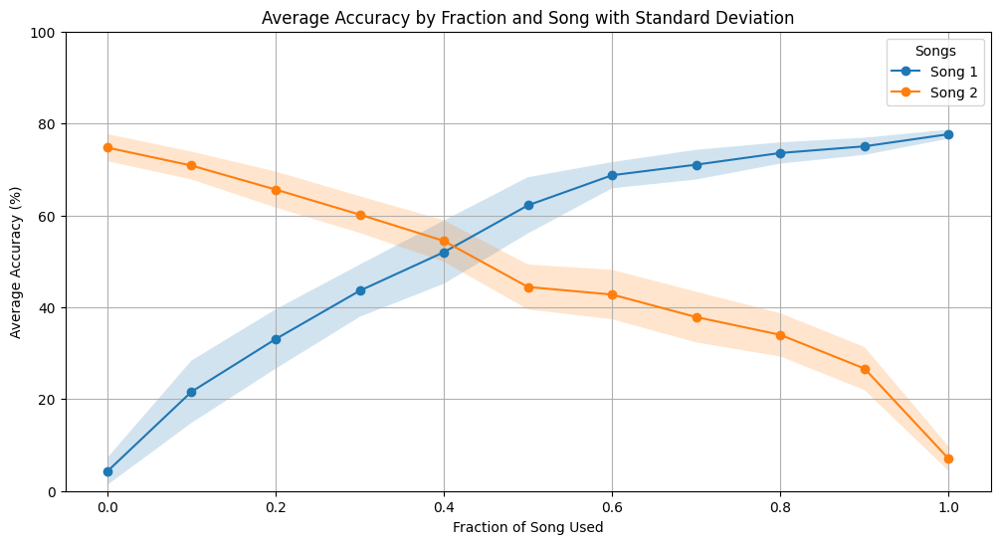

In [18]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming accuracies are already calculated and available
# Calculate the average accuracies and standard deviation across all models for each song and fraction
average_accuracies = accuracies.mean(axis=2) * 100  # Convert to percentages
std_dev_accuracies = accuracies.std(axis=2) * 100  # Convert to percentages

# Plotting the accuracies with standard deviation
plt.figure(figsize=(12, 6))
for song_idx, song in enumerate(songStrings):
    # Generate the x-values for the fractions
    x_values = fractions
    y_values = average_accuracies[:, song_idx]
    y_err = std_dev_accuracies[:, song_idx]

    plt.plot(x_values, y_values, marker='o', label=f'Song {song_idx + 1}')
    plt.fill_between(x_values, (y_values - y_err), (y_values + y_err), alpha=0.2)

plt.title('Average Accuracy by Fraction and Song with Standard Deviation')
plt.xlabel('Fraction of Song Used')
plt.ylabel('Average Accuracy (%)')  # Note the (%) for clarity
plt.ylim(0, 100)  # Set y-axis to range from 0 to 100
plt.legend(title="Songs")
plt.grid(True)
plt.show()
